<center><h1>1-ab: Introduction to Neural Networks</h1></center>

\
Students:
- **BOURZAG MOHAMED CHAKIB**
- **MISSOUM YOUCEF**

<center><h2><a href="https://rdfia.github.io/">Course link</a></h2></center>

# Warning :
# Do "File -> Save a copy in Drive" before you start modifying the notebook, otherwise your modifications will not be saved.


In [ ]:
!wget https://github.com/rdfia/rdfia.github.io/raw/master/data/2-ab.zip
!unzip -j 2-ab.zip
!wget https://github.com/rdfia/rdfia.github.io/raw/master/code/2-ab/utils-data.py

--2025-11-11 20:24:17--  https://github.com/rdfia/rdfia.github.io/raw/master/data/2-ab.zip
Resolving github.com (github.com)... 140.82.116.4
Connecting to github.com (github.com)|140.82.116.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/data/2-ab.zip [following]
--2025-11-11 20:24:17--  https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/data/2-ab.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13423991 (13M) [application/zip]
Saving to: ‘2-ab.zip.1’

2-ab.zip.1          100%[===================>]  12.80M  --.-KB/s    in 0.08s   

2025-11-11 20:24:17 (167 MB/s) - ‘2-ab.zip.1’ saved [13423991/13423991]

Archive:  2-ab.zip
replace ._2-ab? [y]es, [n]o

In [ ]:
import math
import torch
from torch.autograd import Variable
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
%run 'utils-data.py'
torch.manual_seed(0)
np.random.seed(0)

<Figure size 640x480 with 0 Axes>

# Part 1 : Forward and backward passes "by hands"

In [ ]:
import torch
import numpy as np

def init_params(nx, nh, ny):
    params = {}
    params["Wh"] = torch.randn(nh, nx) * 0.3
    params["Wy"] = torch.randn(ny, nh) * 0.3
    params["bh"] = torch.zeros(1, nh)
    params["by"] = torch.zeros(1, ny)
    return params


def forward(params, X):
    bsize = X.size(0)
    nh = params['Wh'].size(0)
    ny = params['Wy'].size(0)
    outputs = {}
    outputs["X"] = X
    outputs["htilde"] = torch.mm(X, params["Wh"].t()) + params["bh"]
    outputs["h"] = torch.tanh(outputs["htilde"])
    outputs["ytilde"] = torch.mm(outputs["h"], params["Wy"].t()) + params["by"]
    exp_ytilde = torch.exp(outputs["ytilde"])
    outputs["yhat"] = exp_ytilde / torch.sum(exp_ytilde, dim=1, keepdim=True)
    return outputs['yhat'], outputs


def loss_accuracy(Yhat, Y):
    L = -torch.mean(torch.sum(Y * torch.log(Yhat + 1e-10), dim=1))
    _, pred_labels = torch.max(Yhat, 1)
    _, true_labels = torch.max(Y, 1)
    acc = 100.0 * torch.sum(pred_labels == true_labels).float() / Y.size(0)
    return L, acc


def backward(params, outputs, Y):
    bsize = Y.shape[0]
    grads = {}
    delta_y = outputs["yhat"] - Y
    grads["Wy"] = torch.mm(delta_y.t(), outputs["h"]) / bsize
    grads["by"] = torch.sum(delta_y, dim=0, keepdim=True) / bsize
    delta_h = torch.mm(delta_y, params["Wy"]) * (1 - outputs["h"]**2)
    grads["Wh"] = torch.mm(delta_h.t(), outputs["X"]) / bsize
    grads["bh"] = torch.sum(delta_h, dim=0, keepdim=True) / bsize
    return grads


def sgd(params, grads, eta):
    params["Wh"] = params["Wh"] - eta * grads["Wh"]
    params["Wy"] = params["Wy"] - eta * grads["Wy"]
    params["bh"] = params["bh"] - eta * grads["bh"]
    params["by"] = params["by"] - eta * grads["by"]
    return params

## Global learning procedure "by hands"

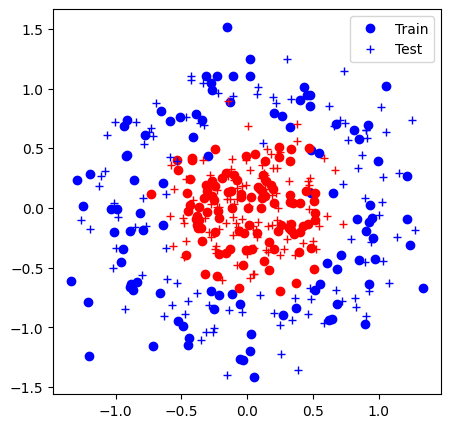

Iter 0: Acc train 50.5% (0.70), acc test 51.0% (0.70)


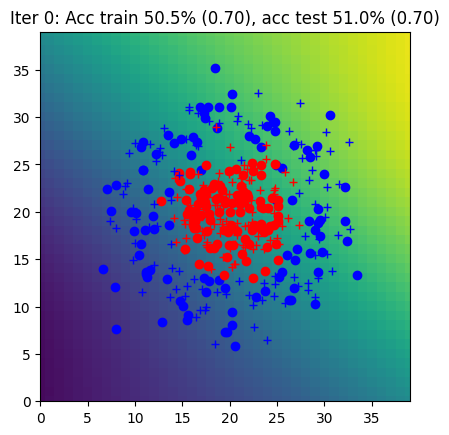

Iter 1: Acc train 49.5% (0.70), acc test 52.5% (0.70)


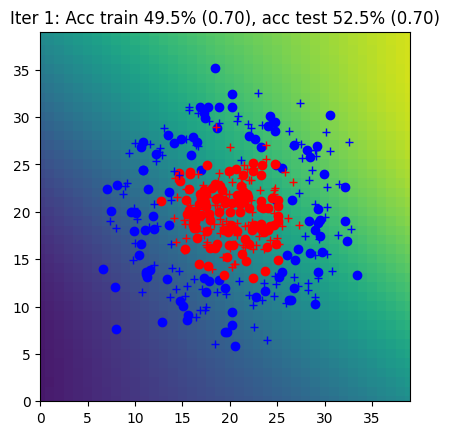

Iter 2: Acc train 50.5% (0.69), acc test 53.5% (0.70)


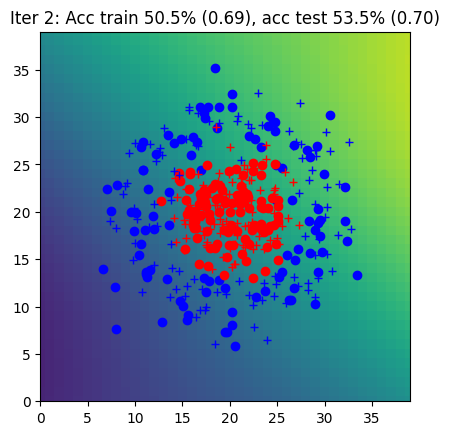

Iter 3: Acc train 49.0% (0.69), acc test 52.5% (0.70)


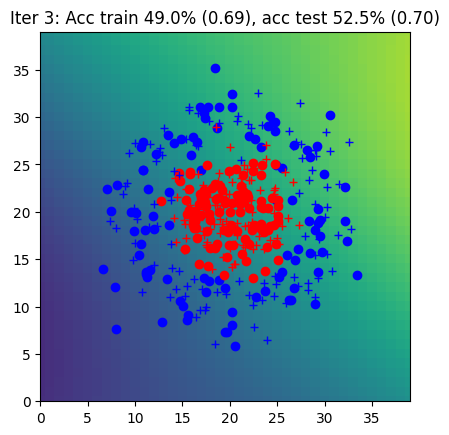

Iter 4: Acc train 53.0% (0.69), acc test 57.0% (0.69)


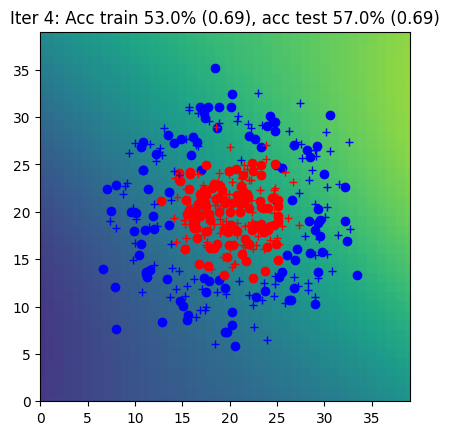

Iter 5: Acc train 52.5% (0.69), acc test 57.5% (0.69)


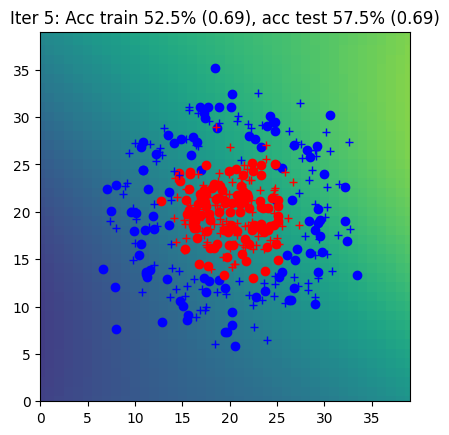

Iter 6: Acc train 53.5% (0.69), acc test 58.0% (0.69)


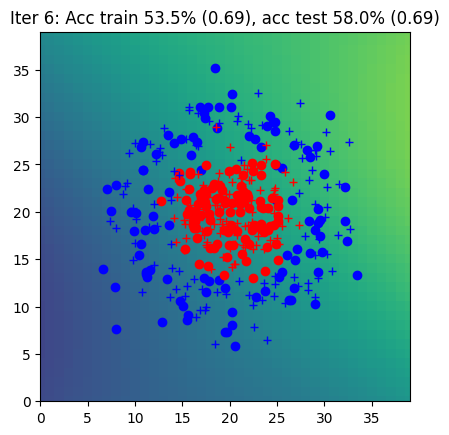

Iter 7: Acc train 51.5% (0.69), acc test 57.0% (0.69)


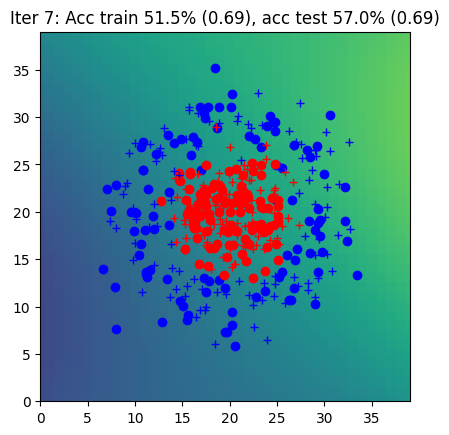

Iter 8: Acc train 51.0% (0.69), acc test 57.0% (0.69)


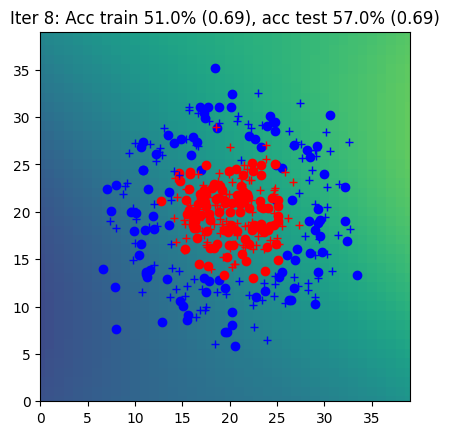

Iter 9: Acc train 51.5% (0.69), acc test 57.0% (0.69)


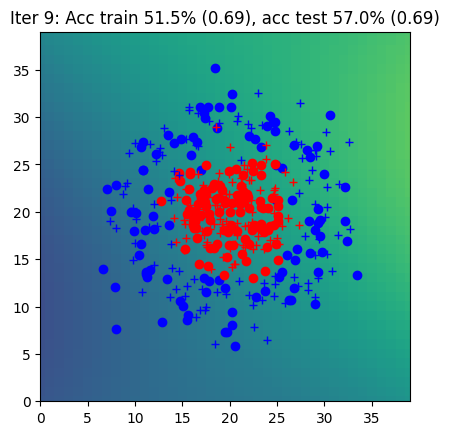

Iter 10: Acc train 55.0% (0.69), acc test 58.0% (0.69)


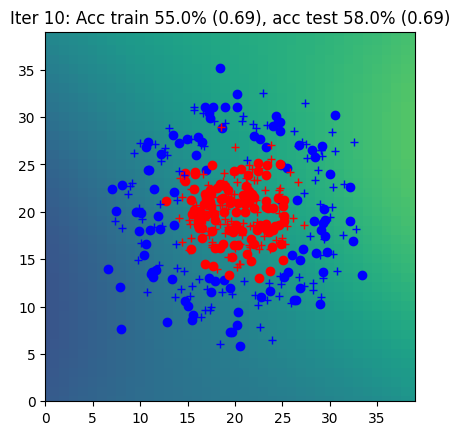

Iter 11: Acc train 53.5% (0.69), acc test 57.5% (0.69)


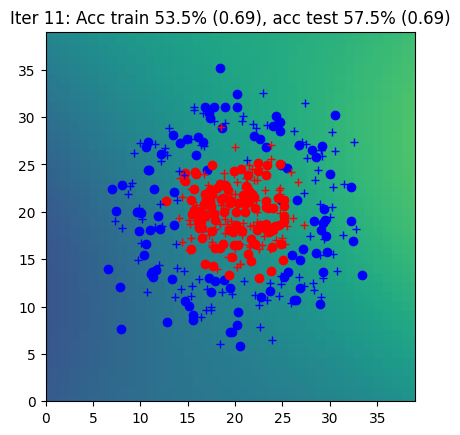

Iter 12: Acc train 58.5% (0.69), acc test 61.5% (0.69)


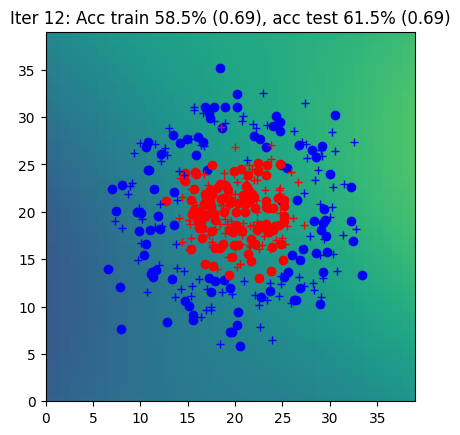

Iter 13: Acc train 54.5% (0.69), acc test 58.5% (0.69)


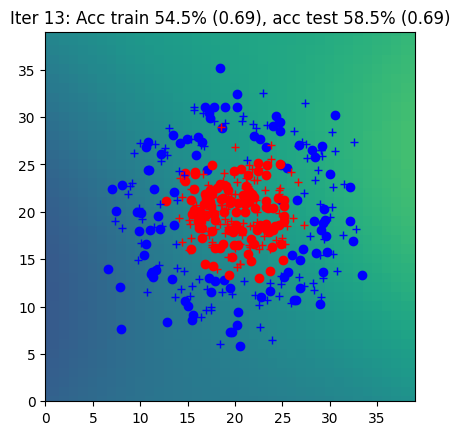

Iter 14: Acc train 55.0% (0.69), acc test 58.5% (0.69)


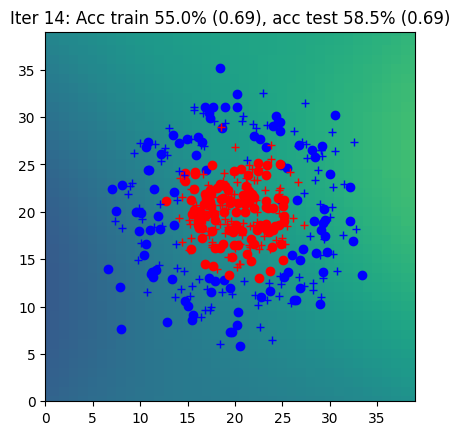

Iter 15: Acc train 57.0% (0.69), acc test 60.0% (0.69)


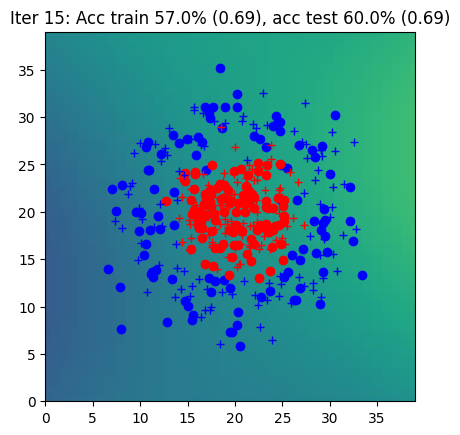

Iter 16: Acc train 58.5% (0.69), acc test 62.5% (0.69)


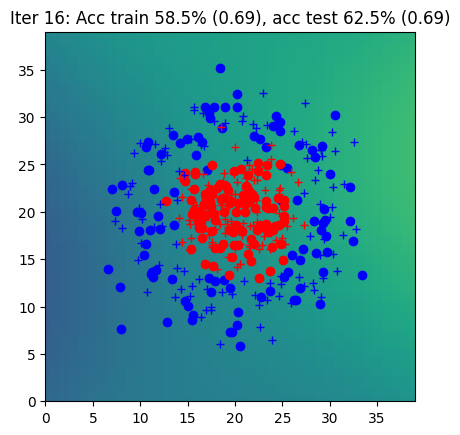

Iter 17: Acc train 58.5% (0.69), acc test 62.0% (0.69)


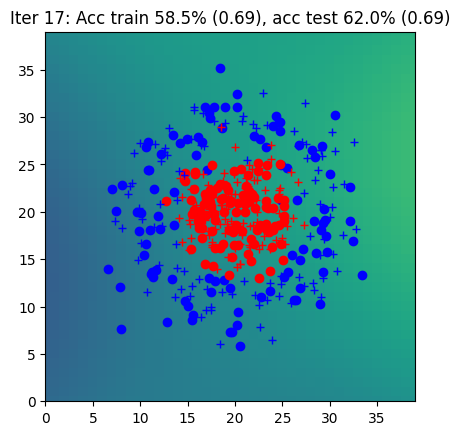

Iter 18: Acc train 59.0% (0.69), acc test 63.0% (0.69)


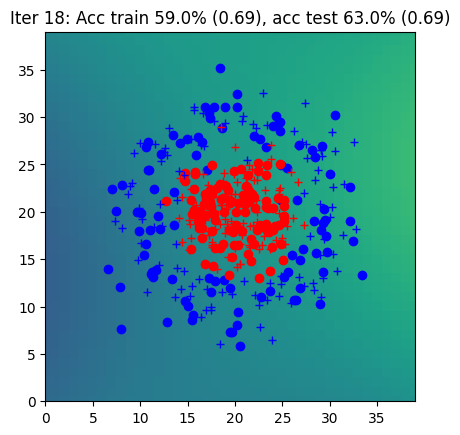

Iter 19: Acc train 59.0% (0.69), acc test 62.0% (0.69)


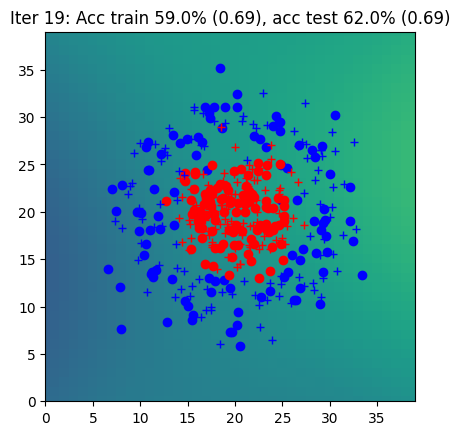

Iter 20: Acc train 56.0% (0.69), acc test 60.5% (0.69)


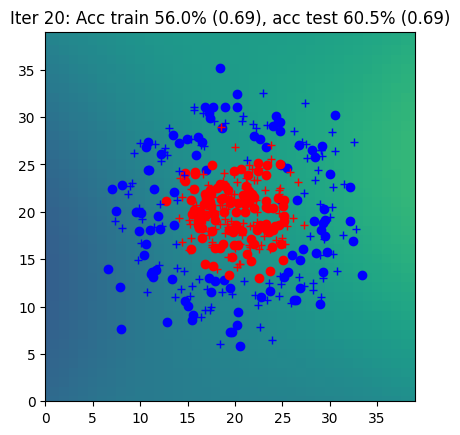

Iter 21: Acc train 60.0% (0.69), acc test 63.0% (0.69)


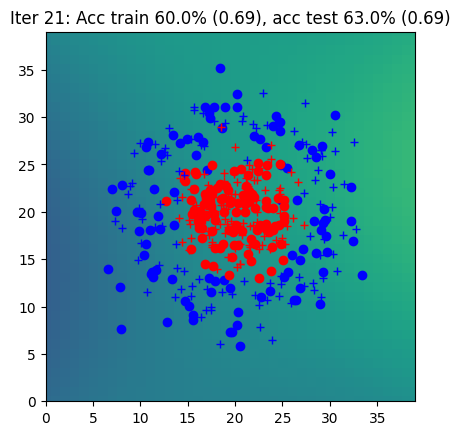

Iter 22: Acc train 61.0% (0.69), acc test 62.5% (0.69)


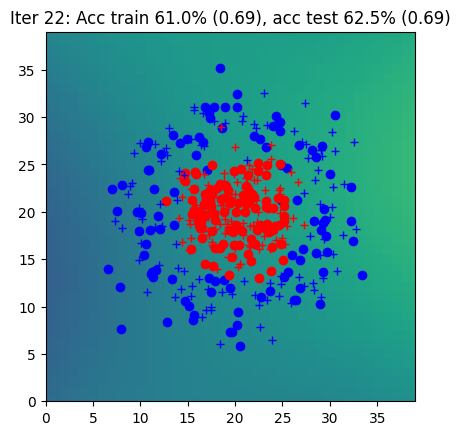

Iter 23: Acc train 60.0% (0.69), acc test 63.0% (0.69)


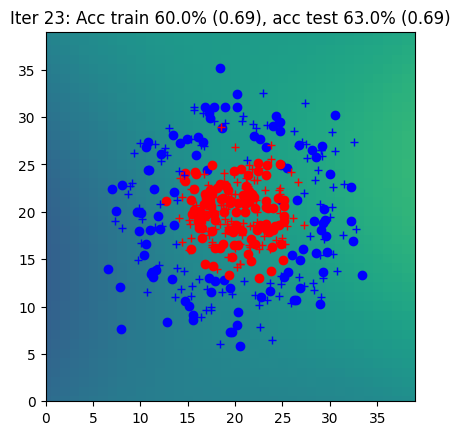

Iter 24: Acc train 60.5% (0.69), acc test 63.0% (0.69)


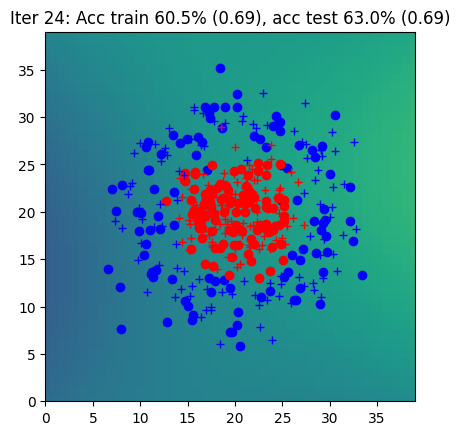

Iter 25: Acc train 60.5% (0.69), acc test 63.0% (0.69)


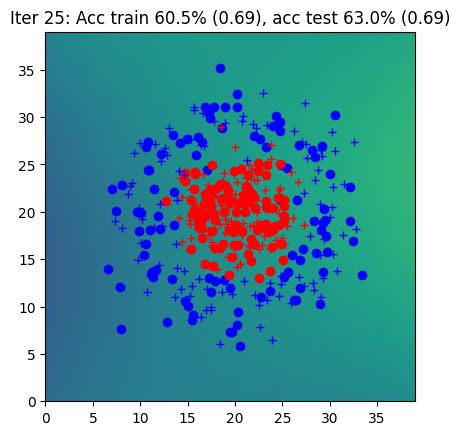

Iter 26: Acc train 60.0% (0.69), acc test 63.0% (0.69)


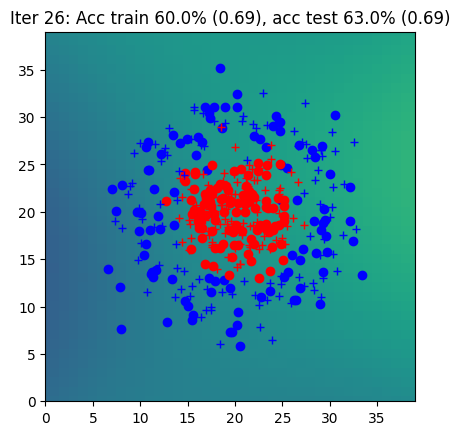

Iter 27: Acc train 60.5% (0.69), acc test 63.0% (0.69)


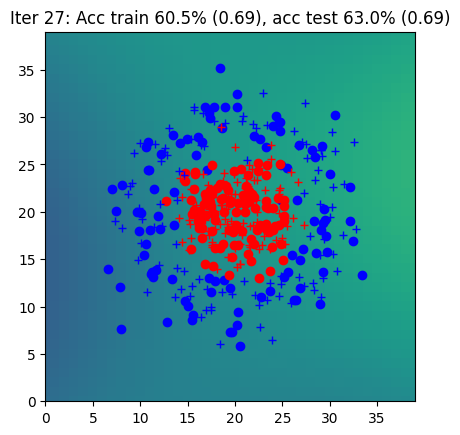

Iter 28: Acc train 63.0% (0.69), acc test 64.5% (0.69)


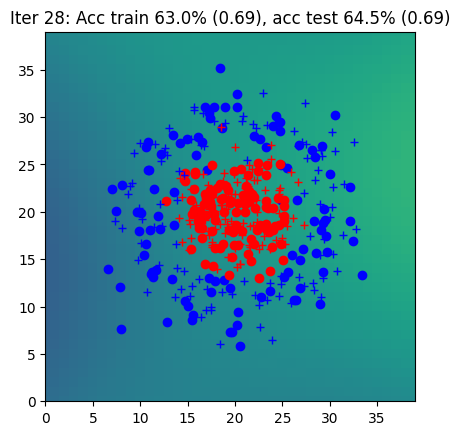

Iter 29: Acc train 62.0% (0.69), acc test 63.5% (0.69)


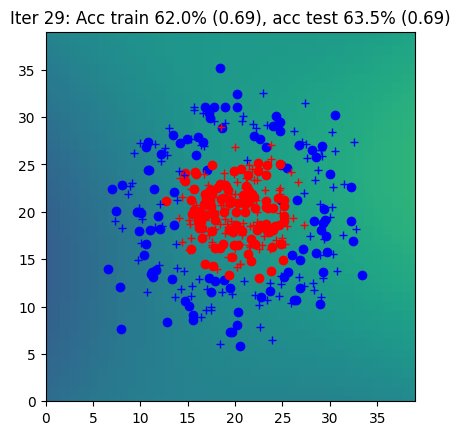

Iter 30: Acc train 60.5% (0.69), acc test 63.0% (0.69)


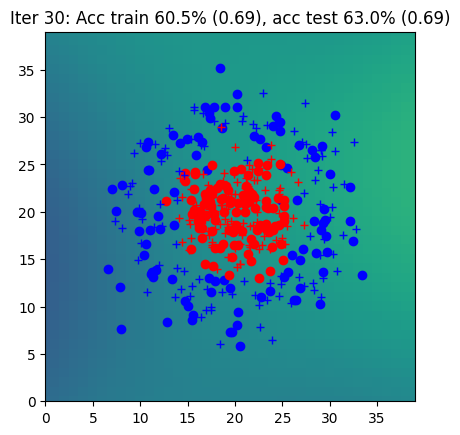

Iter 31: Acc train 62.0% (0.69), acc test 63.0% (0.69)


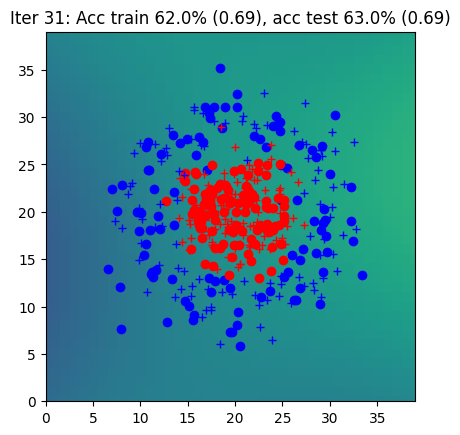

Iter 32: Acc train 62.0% (0.69), acc test 63.0% (0.69)


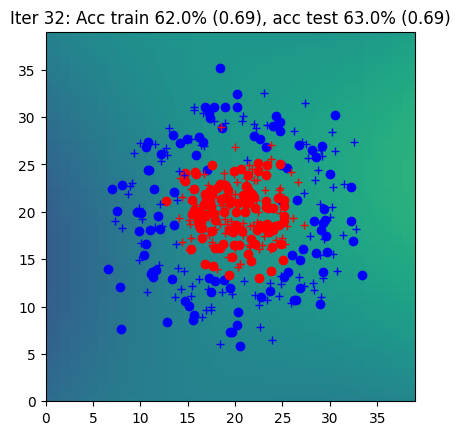

Iter 33: Acc train 62.0% (0.69), acc test 62.5% (0.69)


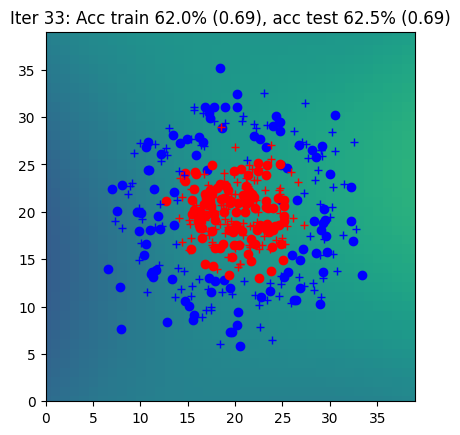

Iter 34: Acc train 62.0% (0.69), acc test 62.5% (0.69)


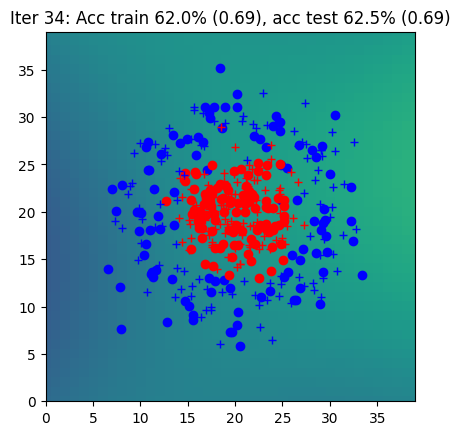

Iter 35: Acc train 64.0% (0.69), acc test 66.0% (0.69)


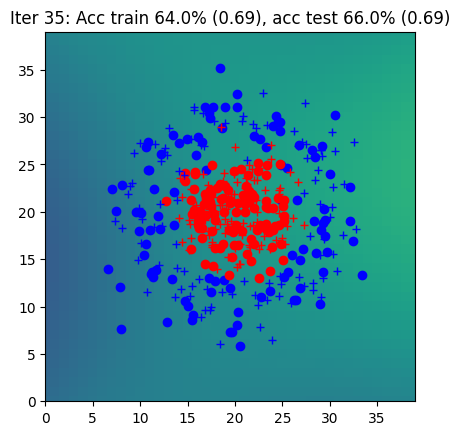

Iter 36: Acc train 66.0% (0.69), acc test 67.5% (0.69)


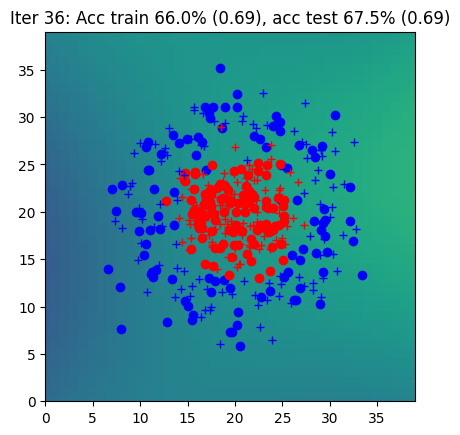

Iter 37: Acc train 63.5% (0.69), acc test 66.0% (0.69)


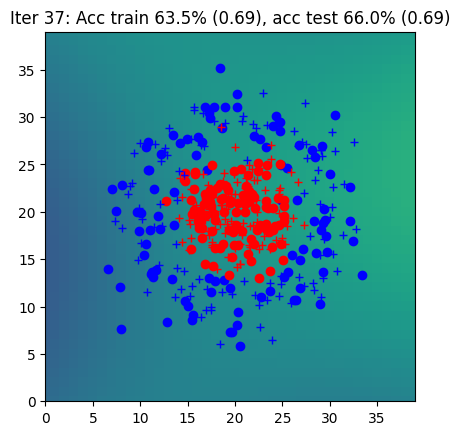

Iter 38: Acc train 69.0% (0.69), acc test 66.5% (0.69)


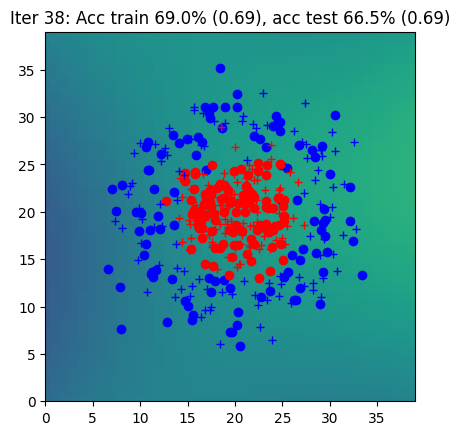

Iter 39: Acc train 64.0% (0.69), acc test 66.0% (0.69)


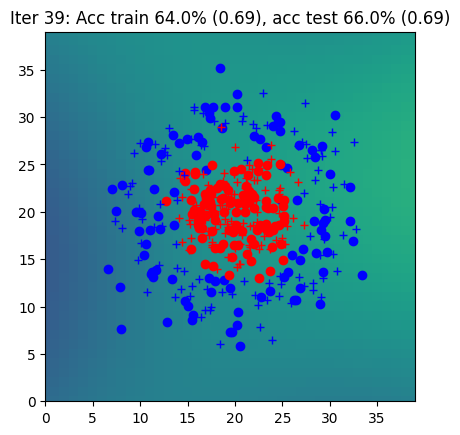

Iter 40: Acc train 64.0% (0.69), acc test 66.0% (0.69)


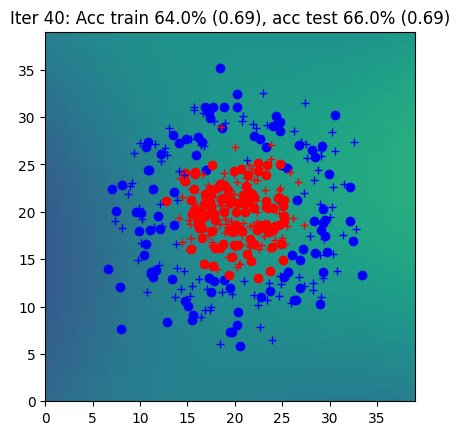

Iter 41: Acc train 65.5% (0.68), acc test 67.5% (0.69)


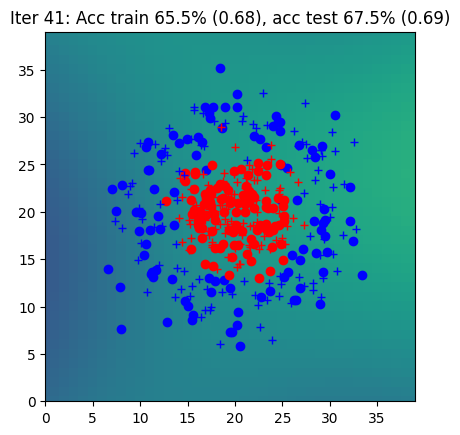

Iter 42: Acc train 65.5% (0.68), acc test 67.0% (0.69)


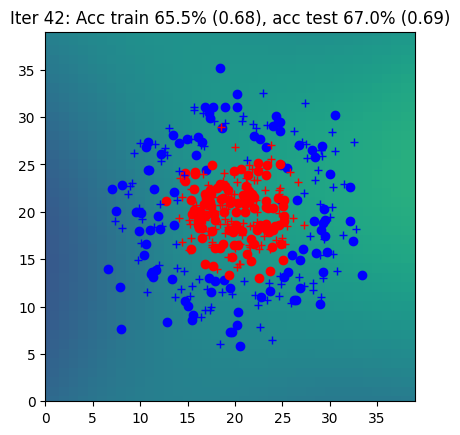

Iter 43: Acc train 64.0% (0.68), acc test 66.5% (0.69)


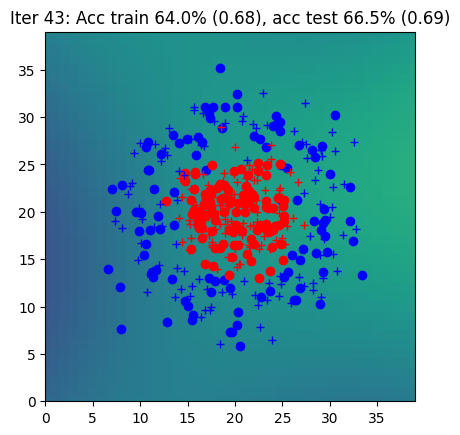

Iter 44: Acc train 64.0% (0.68), acc test 66.5% (0.68)


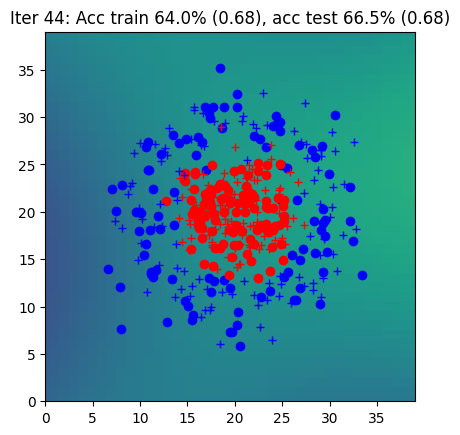

Iter 45: Acc train 63.0% (0.68), acc test 65.5% (0.68)


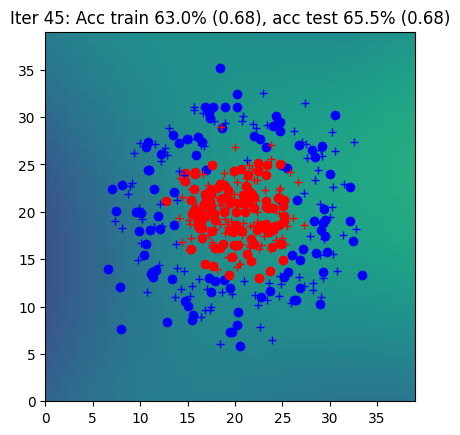

Iter 46: Acc train 66.0% (0.68), acc test 67.0% (0.68)


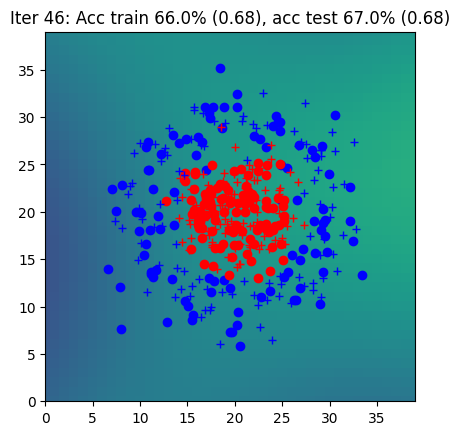

Iter 47: Acc train 65.5% (0.68), acc test 67.5% (0.68)


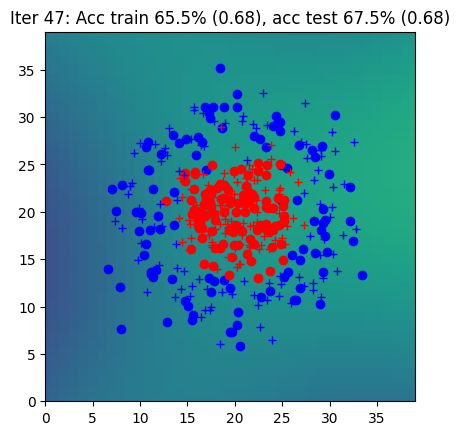

Iter 48: Acc train 68.0% (0.68), acc test 67.0% (0.68)


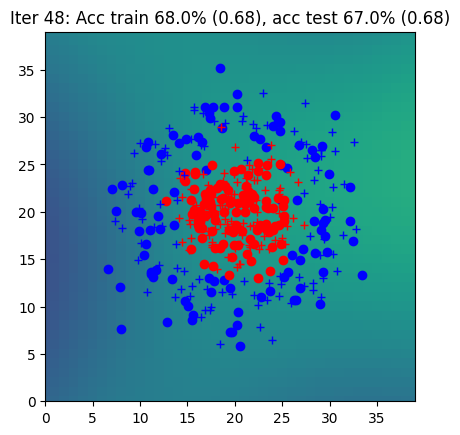

Iter 49: Acc train 64.5% (0.68), acc test 67.5% (0.68)


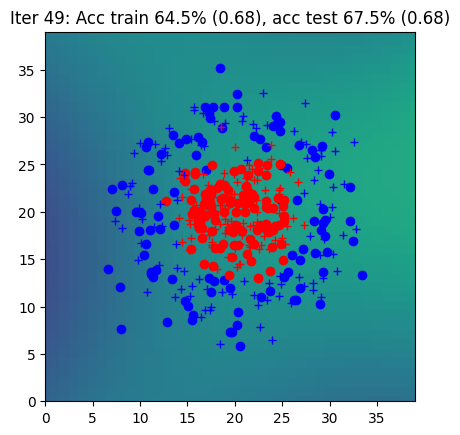

Iter 50: Acc train 67.5% (0.68), acc test 67.5% (0.68)


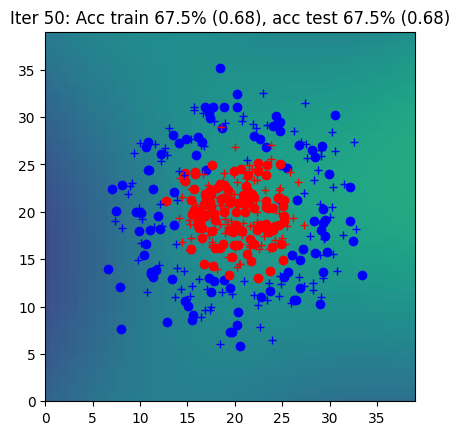

Iter 51: Acc train 66.0% (0.68), acc test 69.5% (0.68)


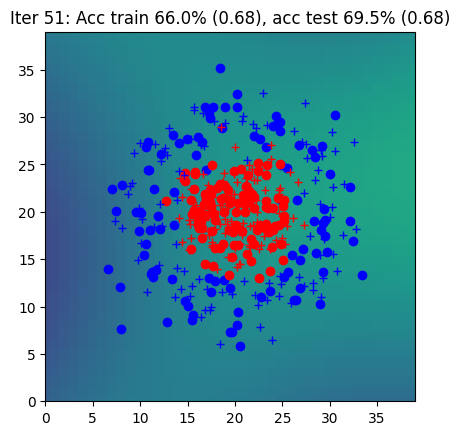

Iter 52: Acc train 66.0% (0.68), acc test 68.0% (0.68)


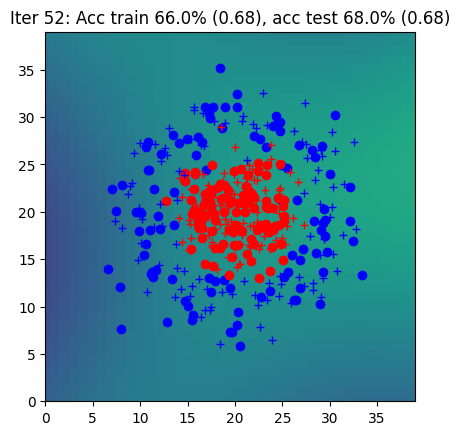

Iter 53: Acc train 68.0% (0.68), acc test 68.0% (0.68)


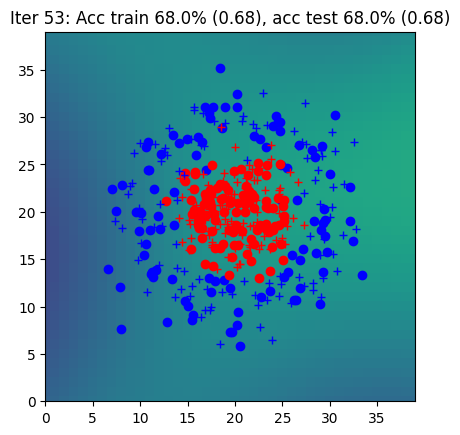

Iter 54: Acc train 68.5% (0.68), acc test 69.5% (0.68)


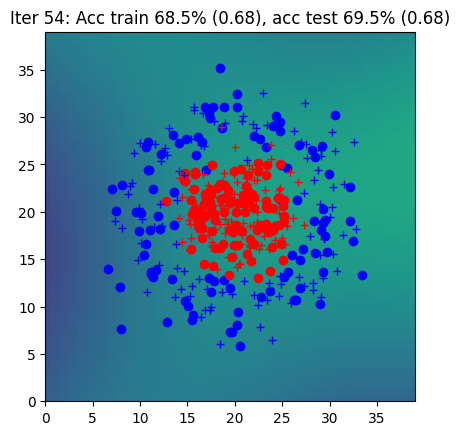

Iter 55: Acc train 68.5% (0.68), acc test 67.5% (0.68)


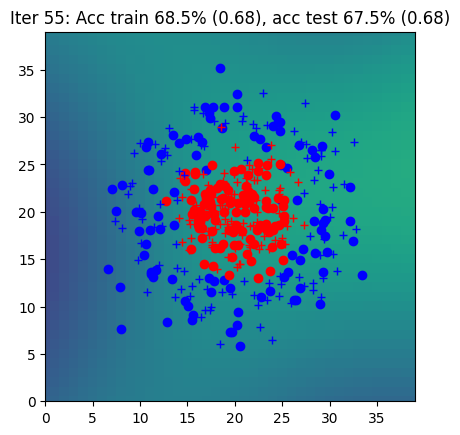

Iter 56: Acc train 68.0% (0.68), acc test 67.5% (0.68)


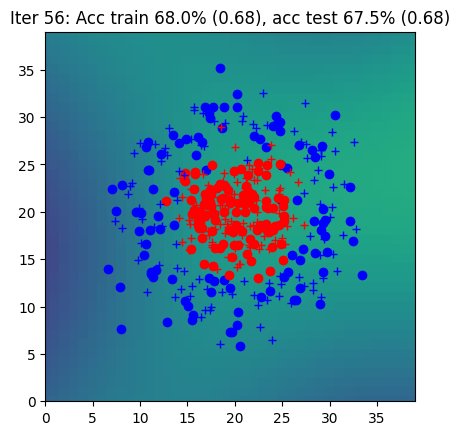

Iter 57: Acc train 68.0% (0.68), acc test 67.5% (0.68)


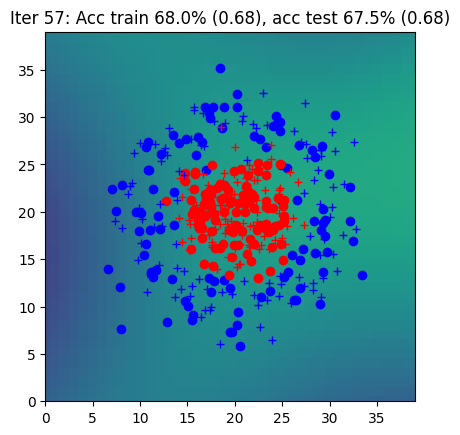

Iter 58: Acc train 68.0% (0.68), acc test 67.5% (0.68)


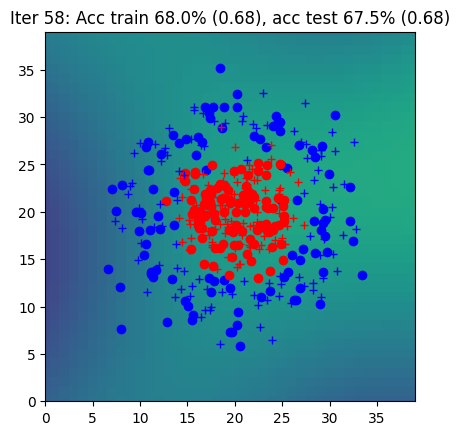

Iter 59: Acc train 68.5% (0.67), acc test 67.5% (0.68)


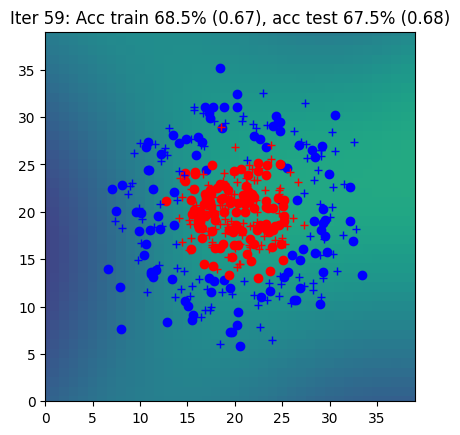

Iter 60: Acc train 68.5% (0.67), acc test 67.0% (0.68)


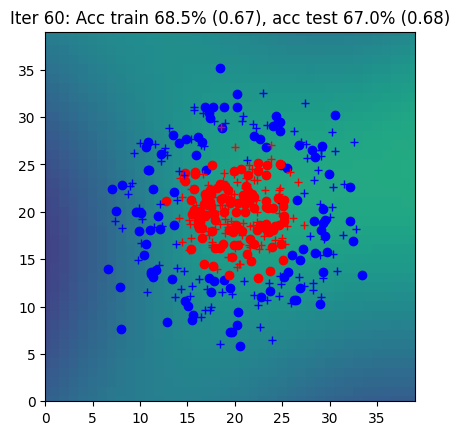

Iter 61: Acc train 69.0% (0.67), acc test 67.5% (0.67)


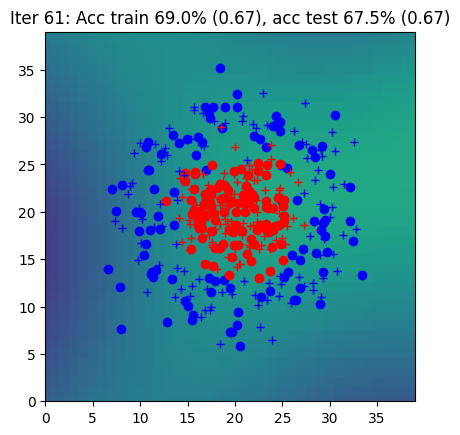

Iter 62: Acc train 69.0% (0.67), acc test 67.0% (0.67)


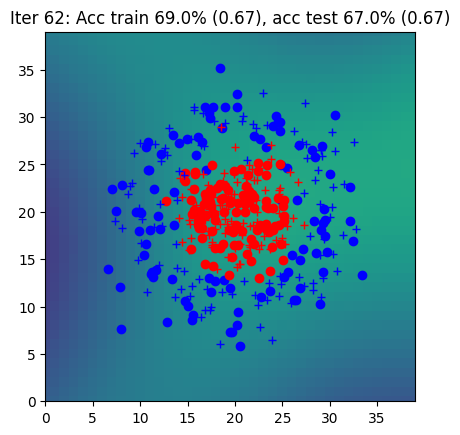

Iter 63: Acc train 71.0% (0.67), acc test 69.5% (0.67)


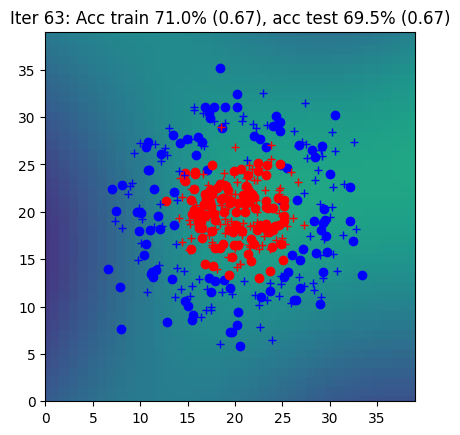

Iter 64: Acc train 69.0% (0.67), acc test 67.5% (0.67)


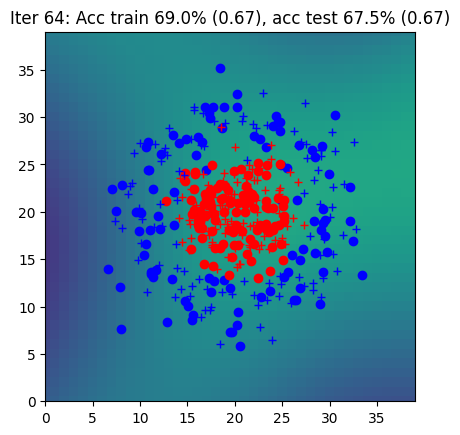

Iter 65: Acc train 69.0% (0.67), acc test 67.5% (0.67)


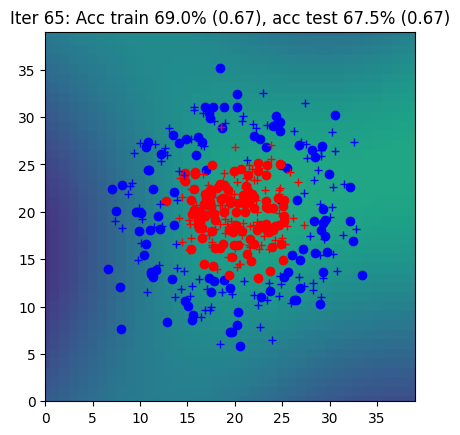

Iter 66: Acc train 70.0% (0.67), acc test 67.5% (0.67)


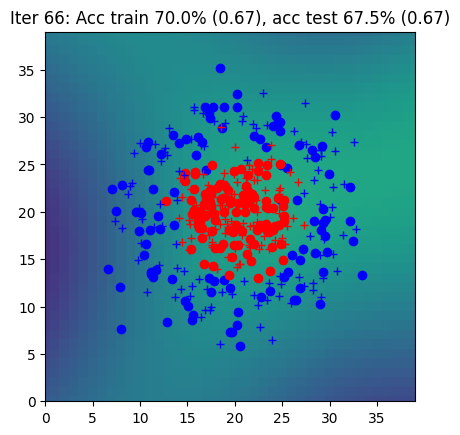

Iter 67: Acc train 70.5% (0.67), acc test 66.5% (0.67)


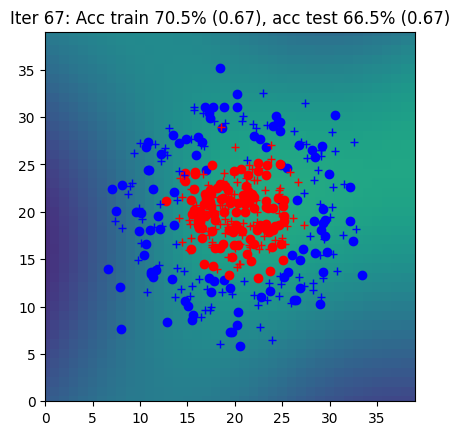

Iter 68: Acc train 69.0% (0.67), acc test 65.5% (0.67)


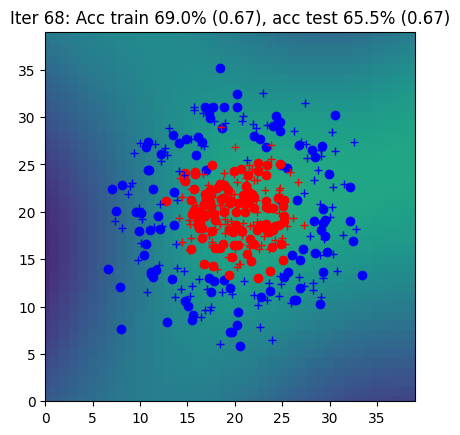

Iter 69: Acc train 71.5% (0.66), acc test 71.0% (0.66)


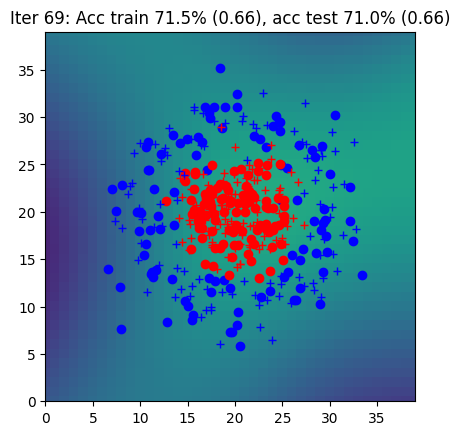

Iter 70: Acc train 71.5% (0.66), acc test 68.5% (0.66)


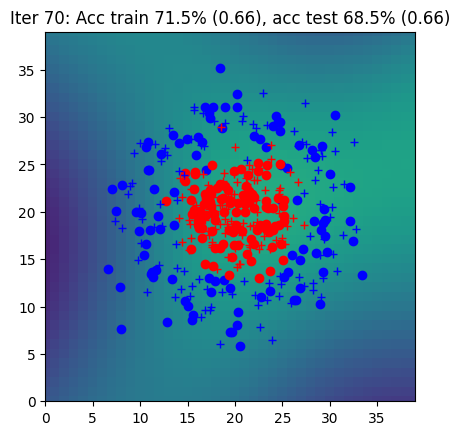

Iter 71: Acc train 72.0% (0.66), acc test 69.0% (0.66)


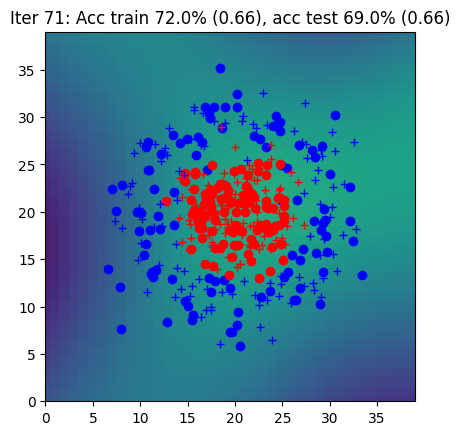

Iter 72: Acc train 76.5% (0.66), acc test 74.5% (0.66)


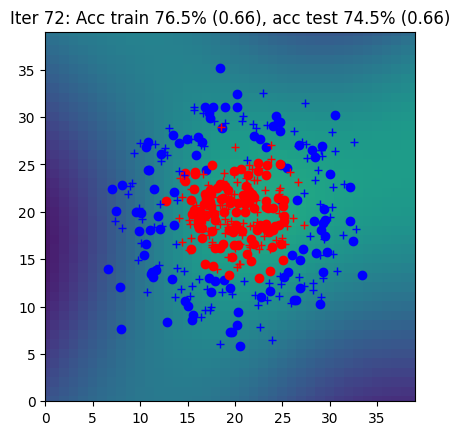

Iter 73: Acc train 71.5% (0.66), acc test 68.0% (0.66)


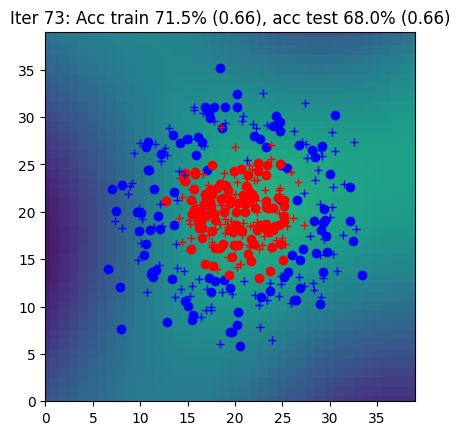

Iter 74: Acc train 76.0% (0.66), acc test 72.0% (0.66)


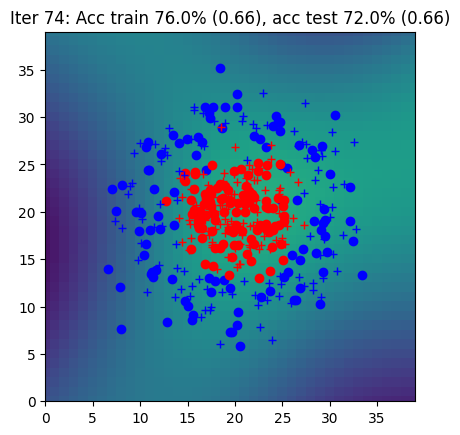

Iter 75: Acc train 70.5% (0.65), acc test 68.5% (0.65)


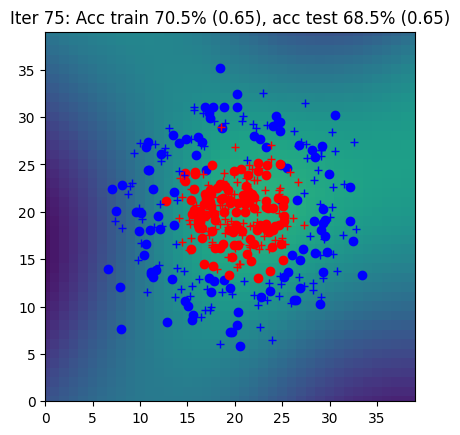

Iter 76: Acc train 76.0% (0.65), acc test 72.5% (0.65)


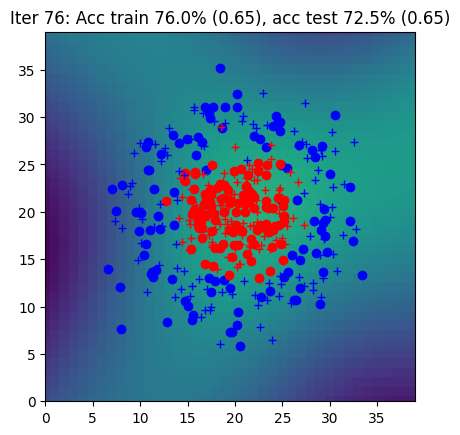

Iter 77: Acc train 77.0% (0.65), acc test 73.0% (0.65)


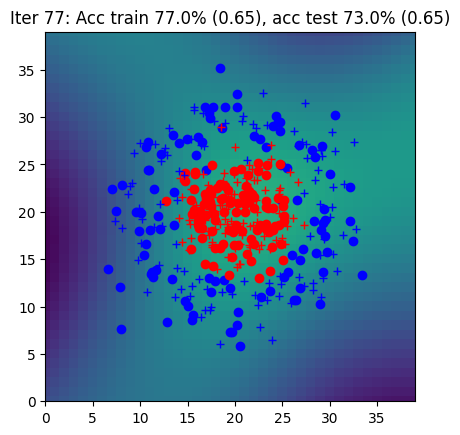

Iter 78: Acc train 77.5% (0.65), acc test 71.5% (0.65)


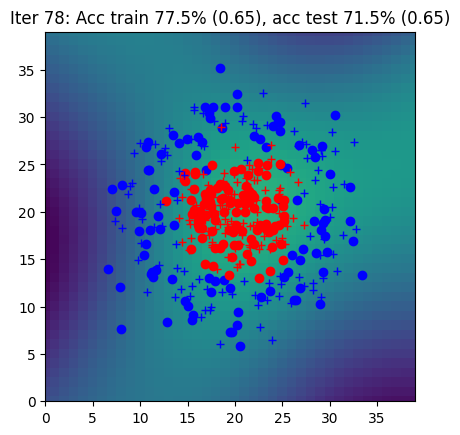

Iter 79: Acc train 77.5% (0.65), acc test 72.0% (0.65)


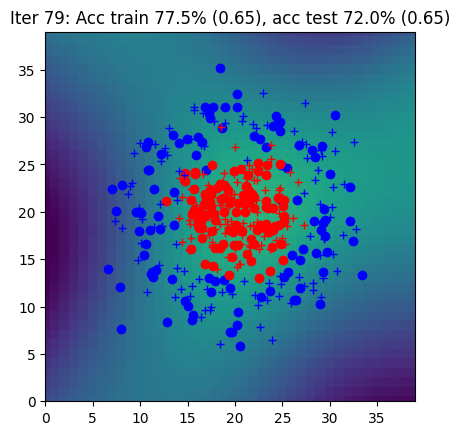

Iter 80: Acc train 74.0% (0.64), acc test 69.0% (0.64)


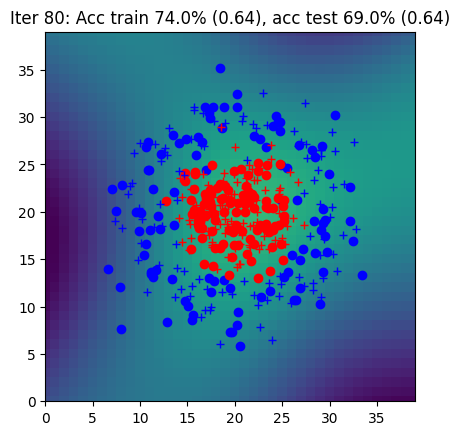

Iter 81: Acc train 75.5% (0.64), acc test 71.0% (0.64)


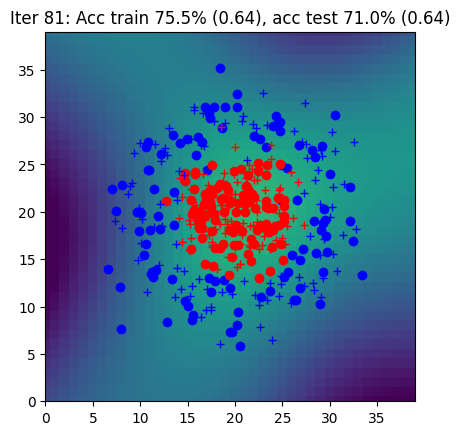

Iter 82: Acc train 77.5% (0.64), acc test 74.0% (0.64)


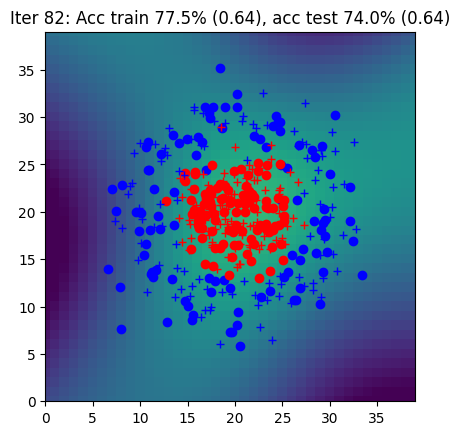

Iter 83: Acc train 77.5% (0.63), acc test 76.0% (0.64)


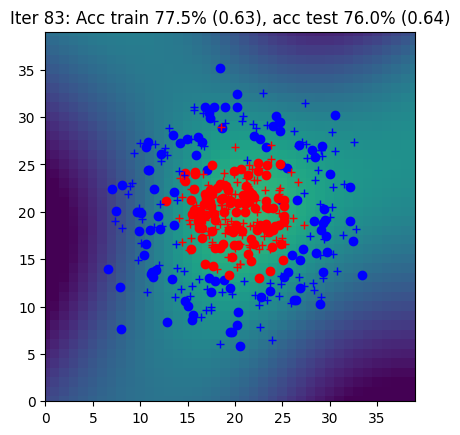

Iter 84: Acc train 79.5% (0.63), acc test 78.0% (0.63)


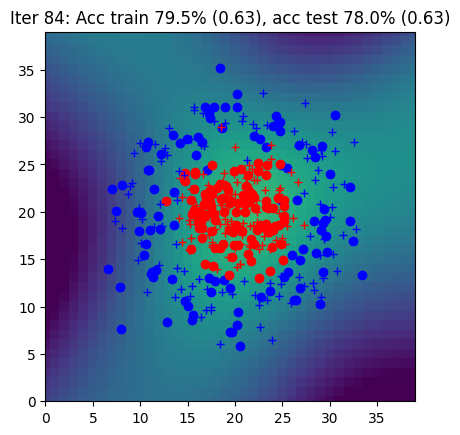

Iter 85: Acc train 80.5% (0.63), acc test 78.5% (0.63)


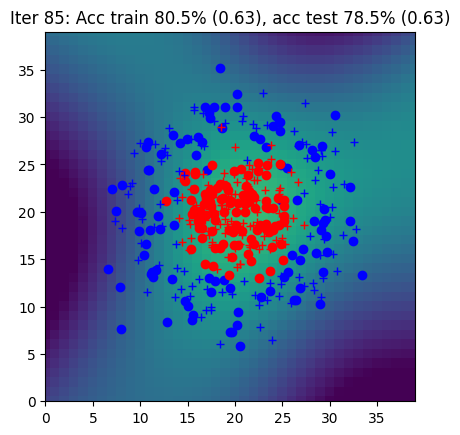

Iter 86: Acc train 76.0% (0.63), acc test 73.5% (0.63)


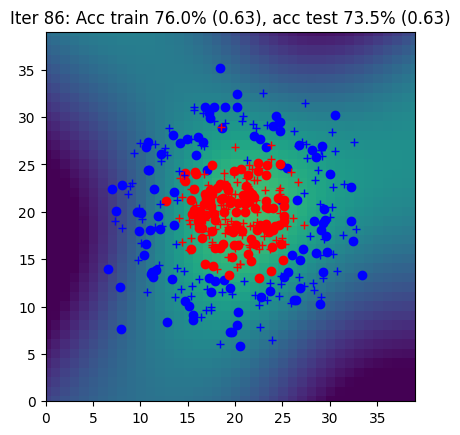

Iter 87: Acc train 76.5% (0.62), acc test 73.5% (0.62)


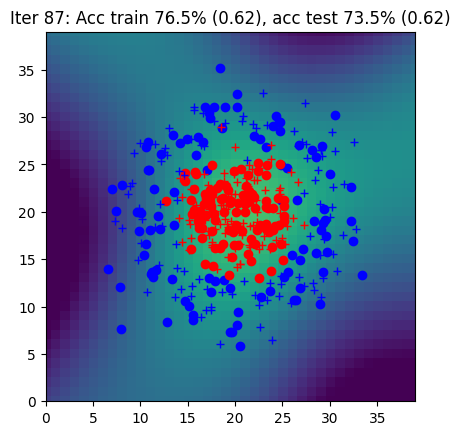

Iter 88: Acc train 78.5% (0.62), acc test 76.5% (0.62)


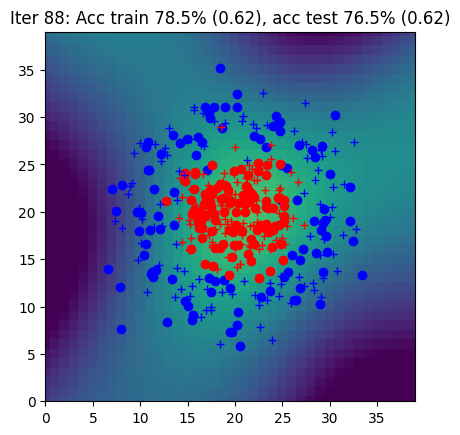

Iter 89: Acc train 82.5% (0.62), acc test 79.5% (0.62)


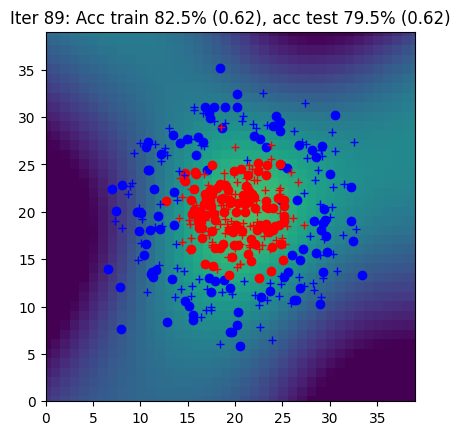

Iter 90: Acc train 81.0% (0.61), acc test 80.5% (0.61)


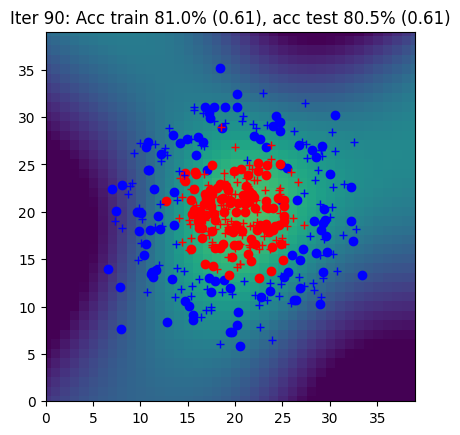

Iter 91: Acc train 81.0% (0.61), acc test 79.5% (0.61)


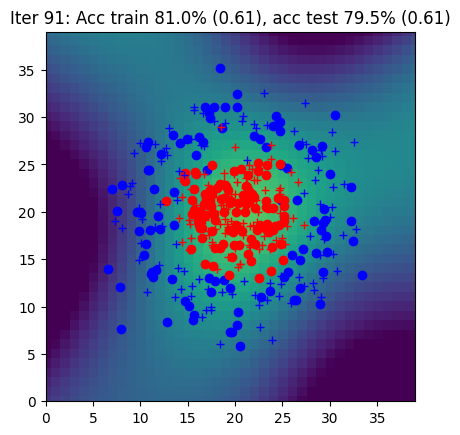

Iter 92: Acc train 79.0% (0.60), acc test 77.5% (0.61)


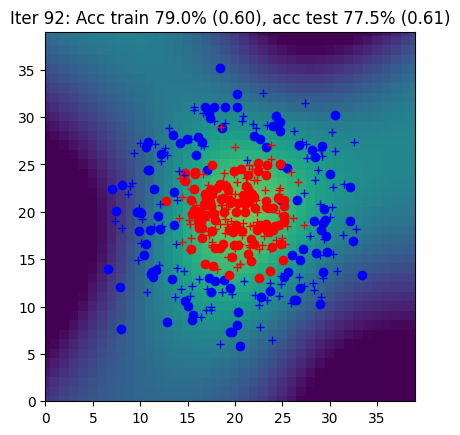

Iter 93: Acc train 79.5% (0.60), acc test 77.5% (0.60)


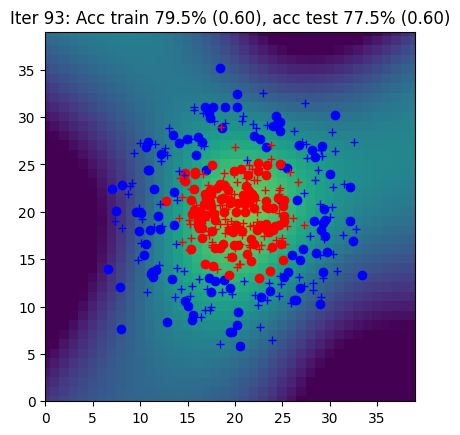

Iter 94: Acc train 79.5% (0.60), acc test 77.5% (0.60)


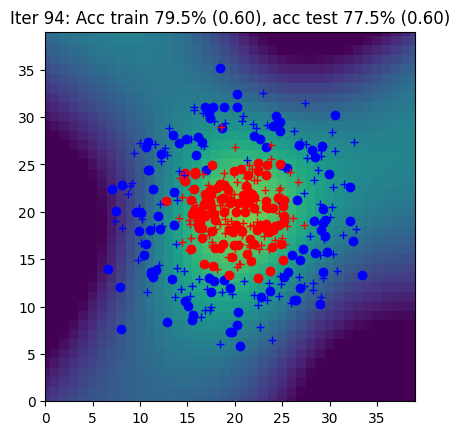

Iter 95: Acc train 86.5% (0.59), acc test 84.5% (0.59)


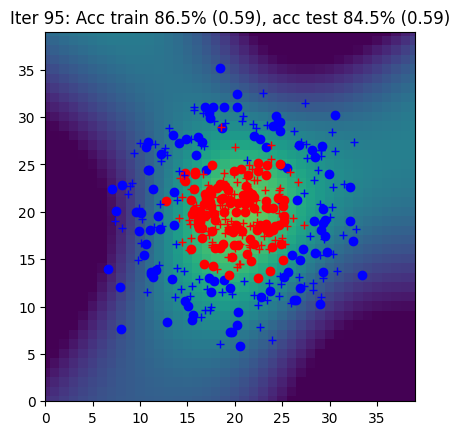

Iter 96: Acc train 86.5% (0.59), acc test 85.0% (0.59)


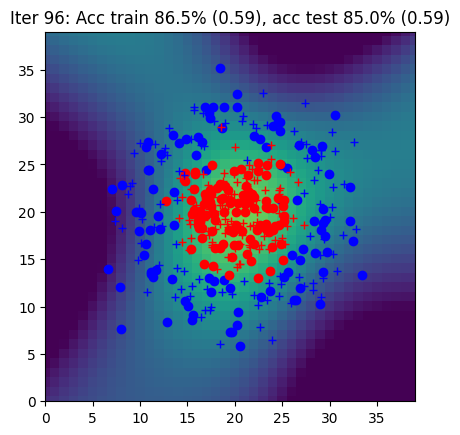

Iter 97: Acc train 88.5% (0.58), acc test 85.5% (0.58)


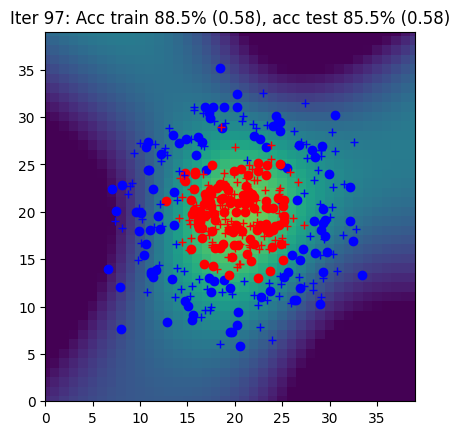

Iter 98: Acc train 90.0% (0.58), acc test 86.0% (0.58)


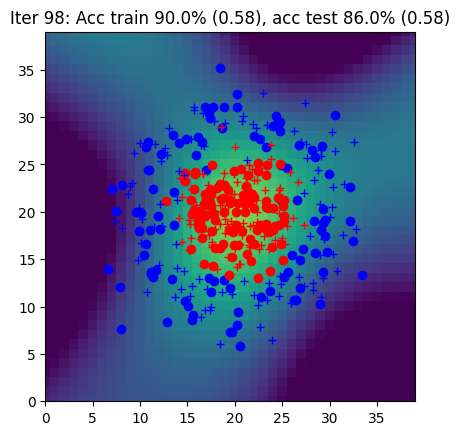

Iter 99: Acc train 90.0% (0.57), acc test 86.0% (0.58)


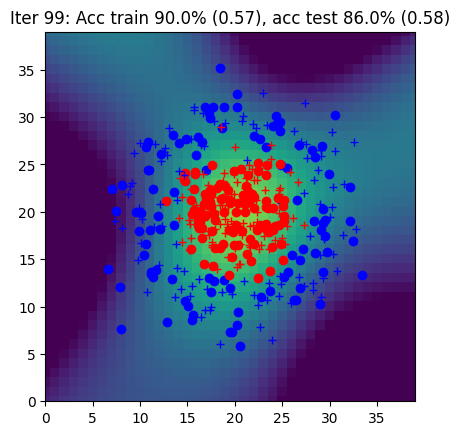

Iter 100: Acc train 90.5% (0.57), acc test 88.0% (0.57)


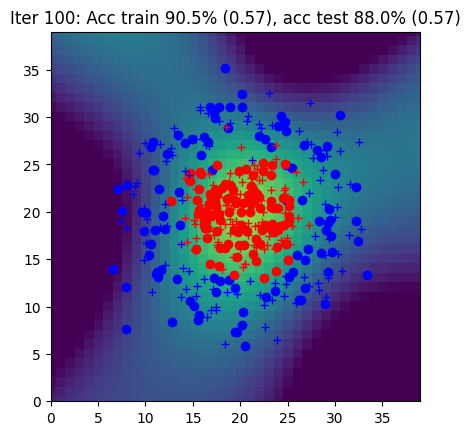

Iter 101: Acc train 92.5% (0.56), acc test 90.5% (0.57)


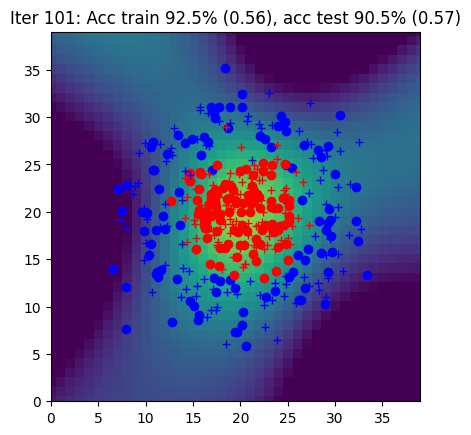

Iter 102: Acc train 90.0% (0.56), acc test 87.0% (0.56)


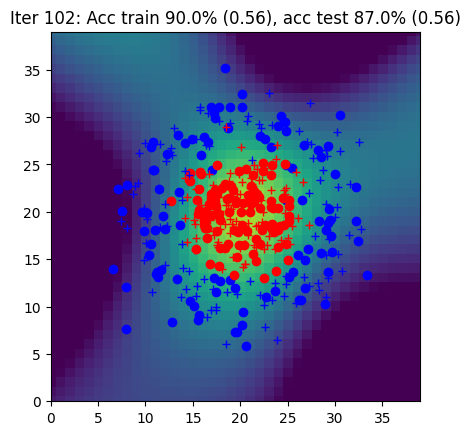

Iter 103: Acc train 90.0% (0.55), acc test 87.0% (0.56)


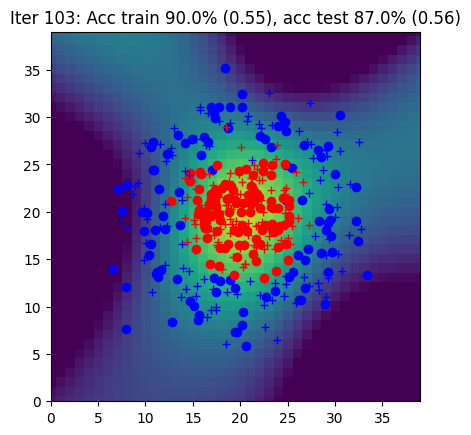

Iter 104: Acc train 87.0% (0.55), acc test 85.0% (0.55)


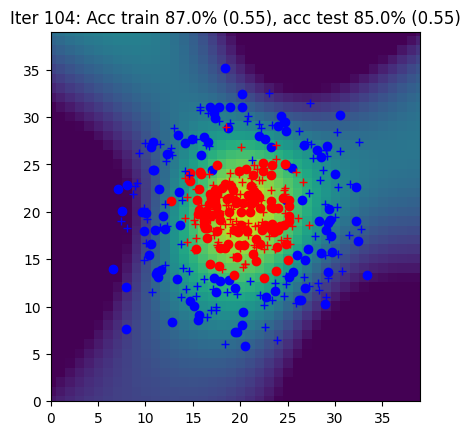

Iter 105: Acc train 89.0% (0.54), acc test 86.0% (0.55)


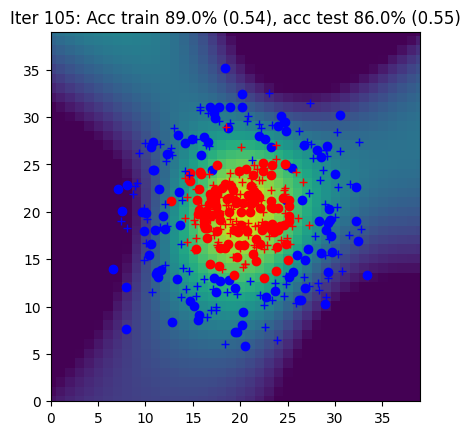

Iter 106: Acc train 91.0% (0.54), acc test 89.0% (0.54)


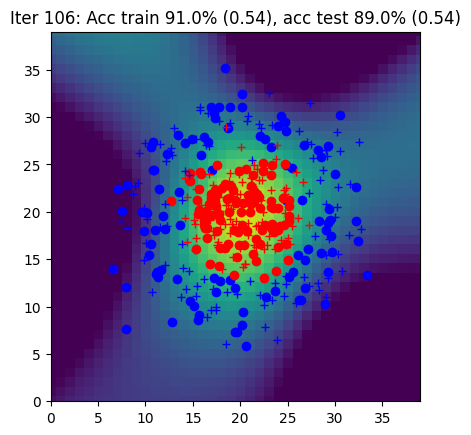

Iter 107: Acc train 92.5% (0.53), acc test 90.0% (0.54)


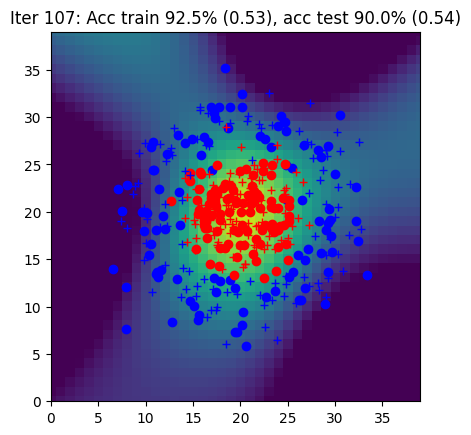

Iter 108: Acc train 93.0% (0.53), acc test 90.0% (0.53)


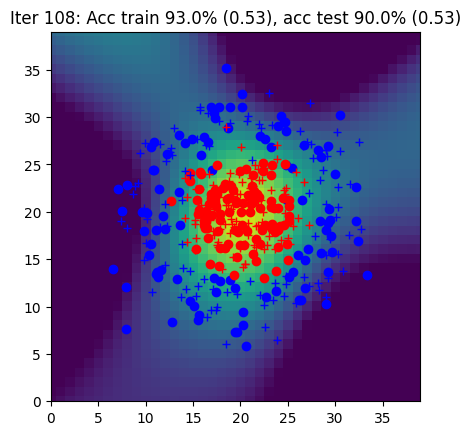

Iter 109: Acc train 92.0% (0.52), acc test 90.5% (0.52)


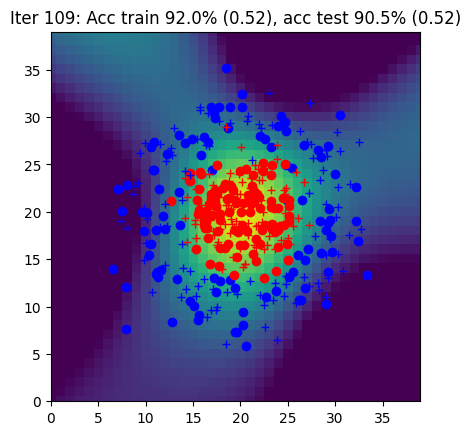

Iter 110: Acc train 92.0% (0.52), acc test 90.0% (0.52)


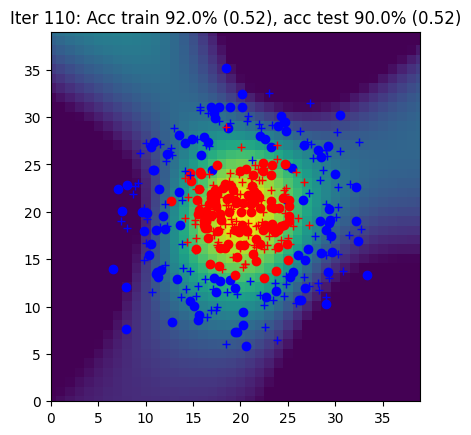

Iter 111: Acc train 92.0% (0.51), acc test 90.5% (0.51)


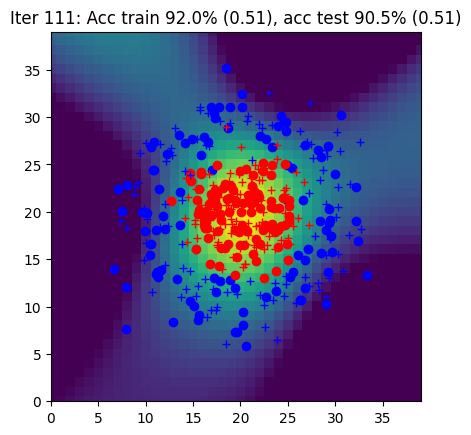

Iter 112: Acc train 92.0% (0.50), acc test 90.5% (0.51)


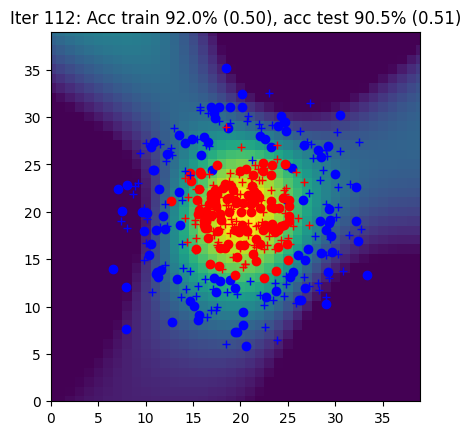

Iter 113: Acc train 92.0% (0.50), acc test 90.0% (0.50)


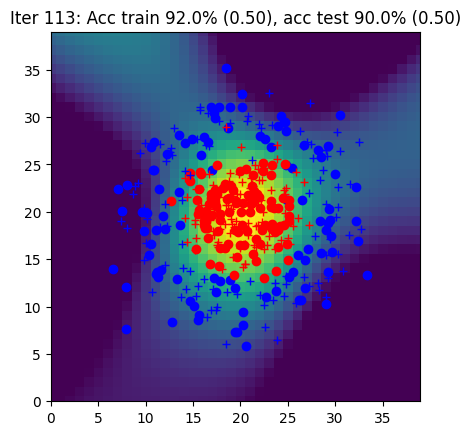

Iter 114: Acc train 92.0% (0.49), acc test 90.5% (0.50)


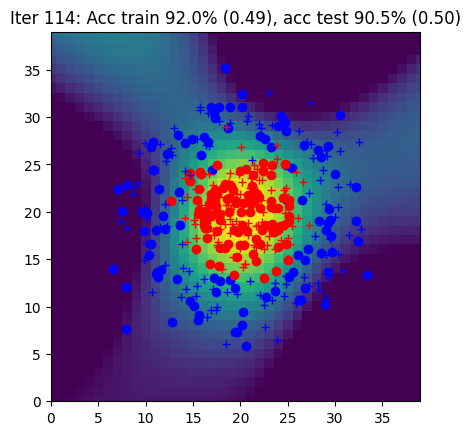

Iter 115: Acc train 93.0% (0.49), acc test 91.0% (0.49)


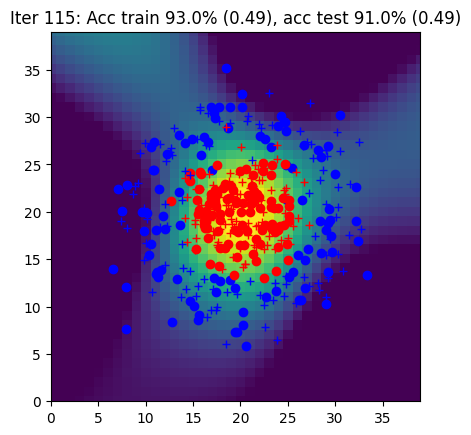

Iter 116: Acc train 92.0% (0.48), acc test 90.5% (0.49)


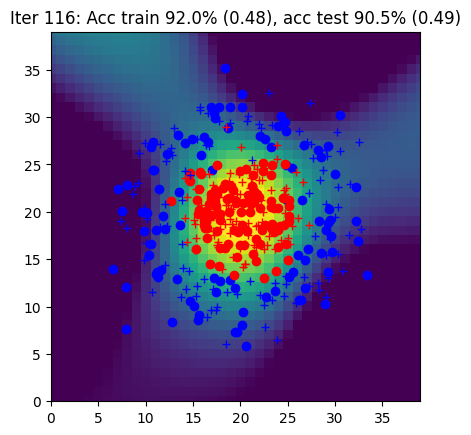

Iter 117: Acc train 92.5% (0.48), acc test 91.5% (0.48)


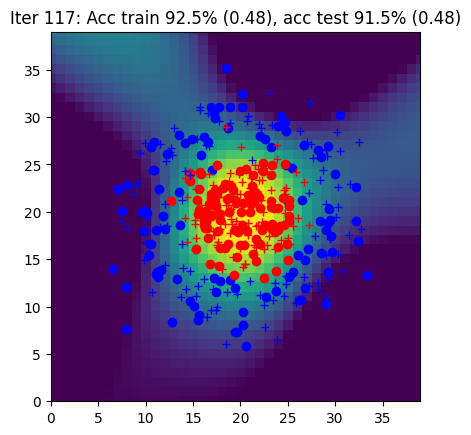

Iter 118: Acc train 93.0% (0.47), acc test 91.5% (0.48)


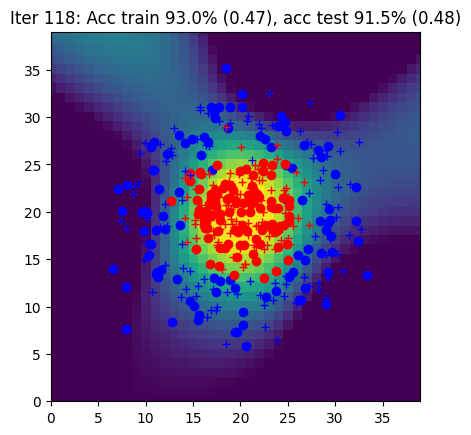

Iter 119: Acc train 93.5% (0.47), acc test 91.5% (0.47)


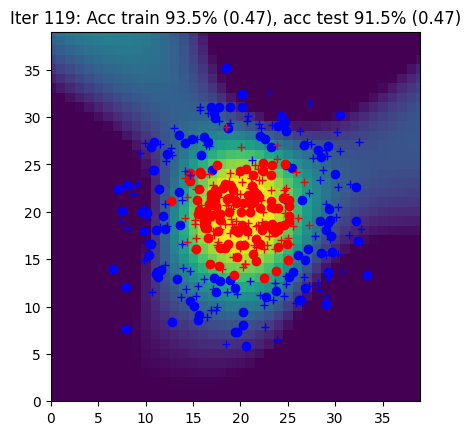

Iter 120: Acc train 94.0% (0.46), acc test 91.5% (0.46)


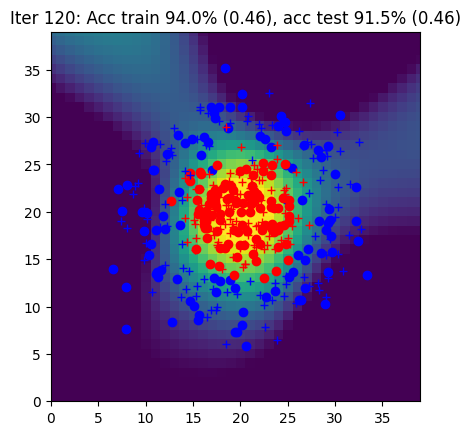

Iter 121: Acc train 94.0% (0.45), acc test 92.0% (0.46)


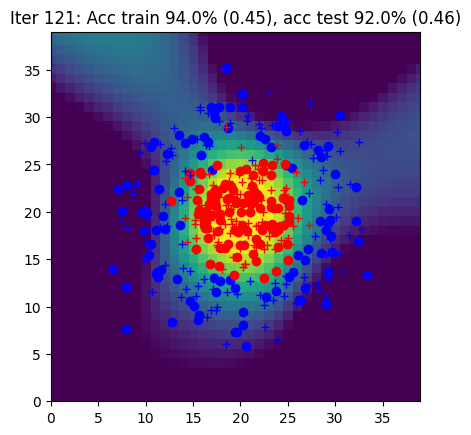

Iter 122: Acc train 92.0% (0.45), acc test 91.0% (0.45)


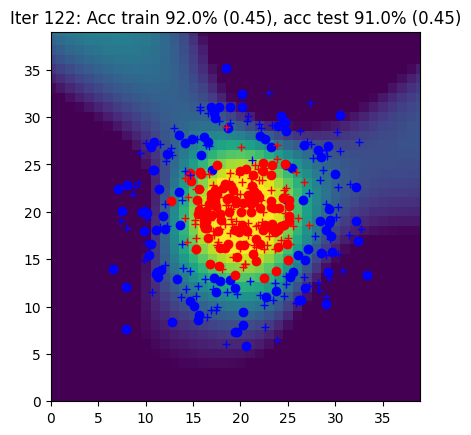

Iter 123: Acc train 94.0% (0.44), acc test 92.0% (0.45)


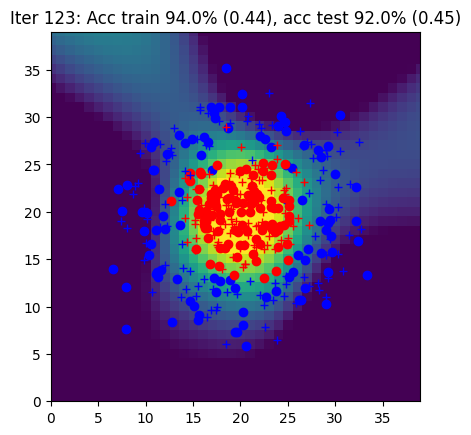

Iter 124: Acc train 94.0% (0.44), acc test 93.5% (0.44)


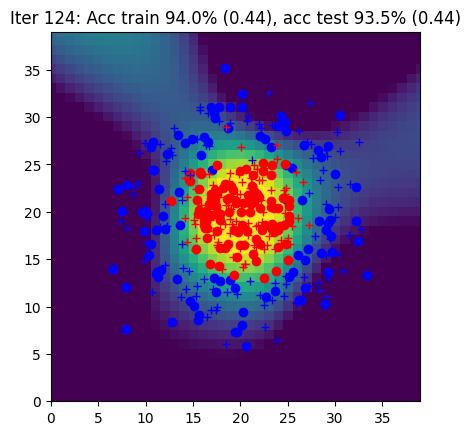

Iter 125: Acc train 94.0% (0.43), acc test 94.5% (0.44)


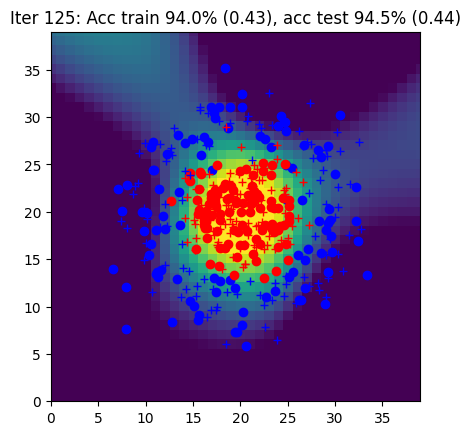

Iter 126: Acc train 94.0% (0.43), acc test 94.5% (0.43)


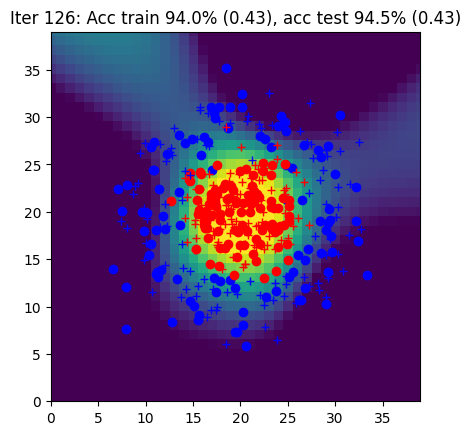

Iter 127: Acc train 94.0% (0.42), acc test 95.0% (0.43)


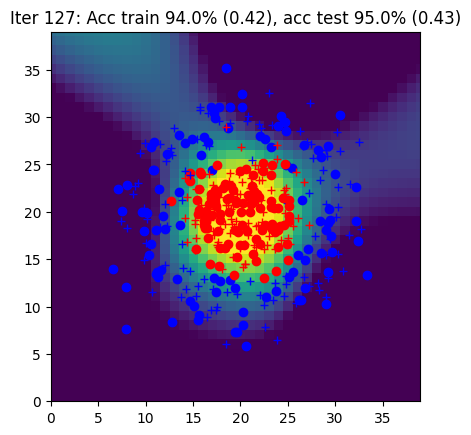

Iter 128: Acc train 94.0% (0.42), acc test 94.5% (0.42)


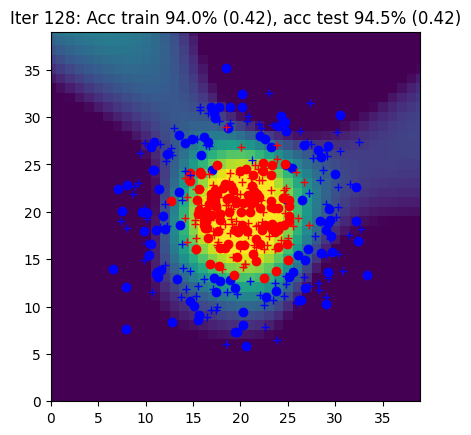

Iter 129: Acc train 93.0% (0.41), acc test 93.0% (0.42)


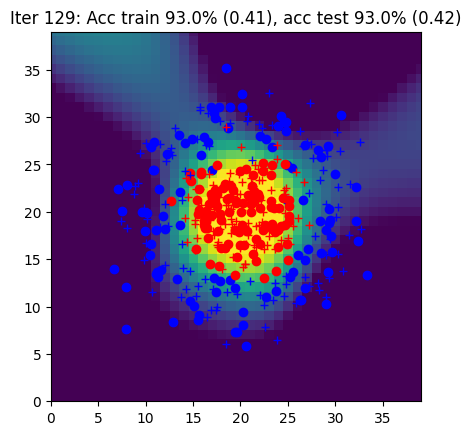

Iter 130: Acc train 94.0% (0.40), acc test 95.0% (0.41)


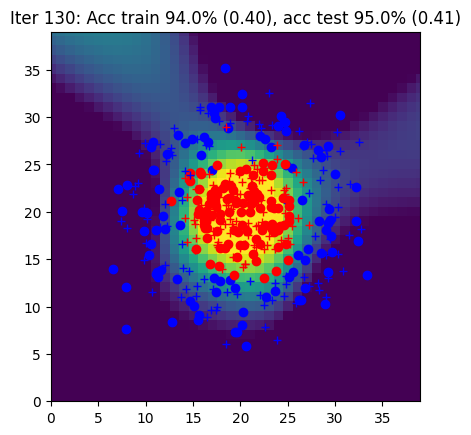

Iter 131: Acc train 94.0% (0.40), acc test 95.5% (0.41)


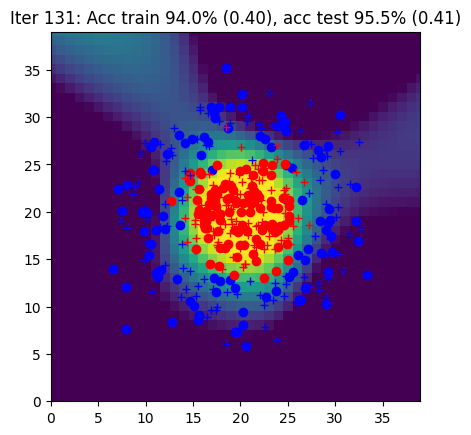

Iter 132: Acc train 94.0% (0.39), acc test 95.0% (0.40)


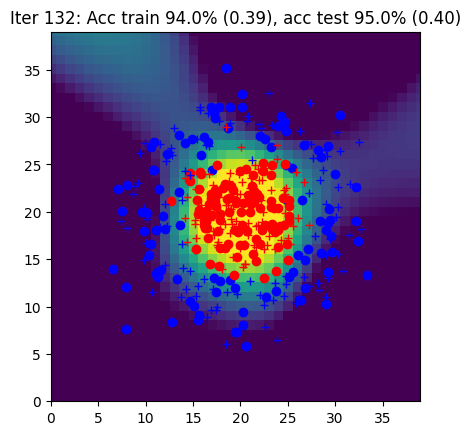

Iter 133: Acc train 93.5% (0.39), acc test 95.0% (0.40)


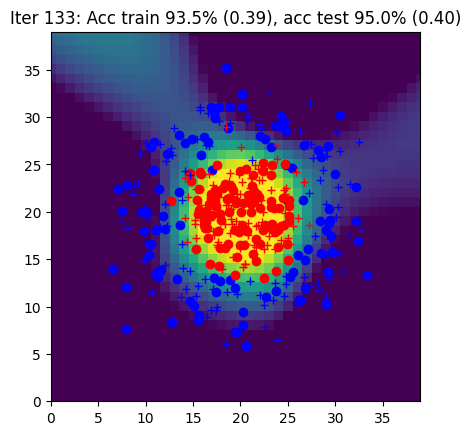

Iter 134: Acc train 94.0% (0.38), acc test 95.0% (0.39)


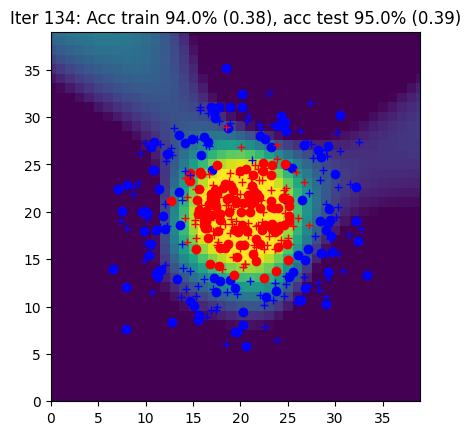

Iter 135: Acc train 94.5% (0.38), acc test 95.5% (0.39)


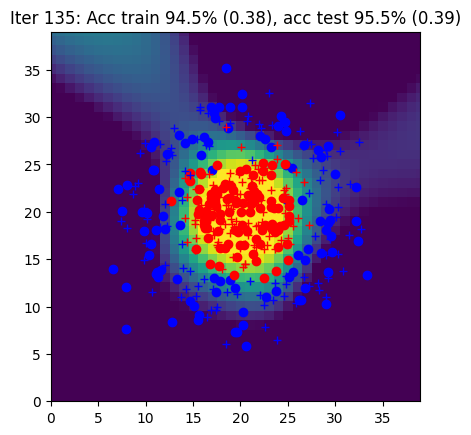

Iter 136: Acc train 95.5% (0.38), acc test 95.0% (0.38)


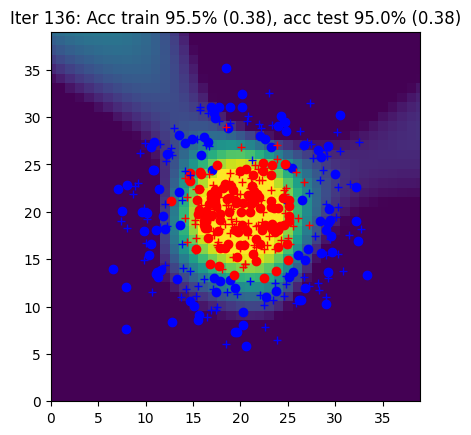

Iter 137: Acc train 94.5% (0.37), acc test 95.5% (0.38)


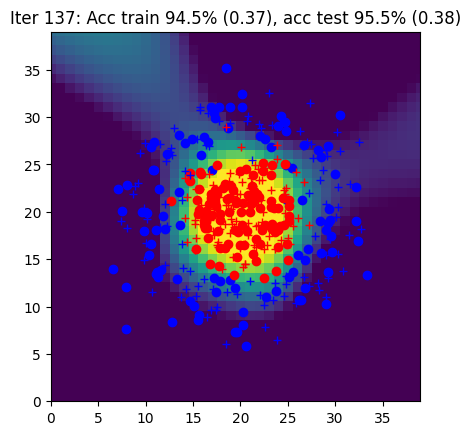

Iter 138: Acc train 95.0% (0.37), acc test 95.5% (0.38)


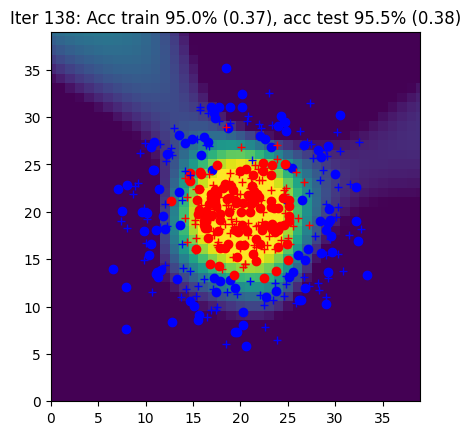

Iter 139: Acc train 96.0% (0.36), acc test 95.0% (0.37)


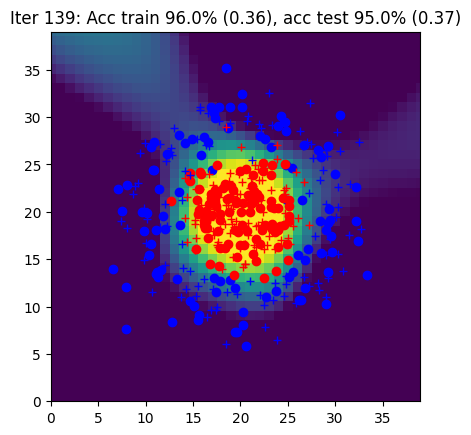

Iter 140: Acc train 96.0% (0.36), acc test 93.5% (0.37)


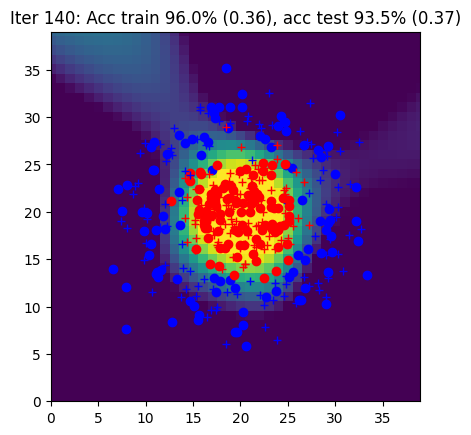

Iter 141: Acc train 96.0% (0.35), acc test 95.0% (0.36)


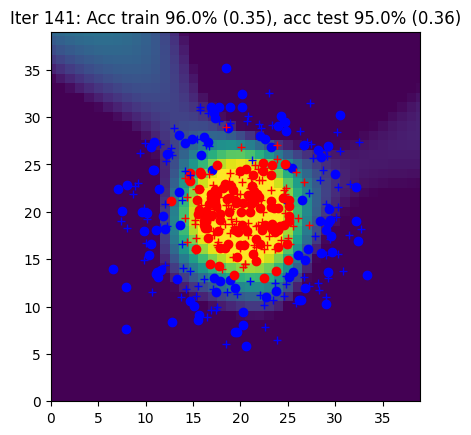

Iter 142: Acc train 95.5% (0.35), acc test 94.5% (0.36)


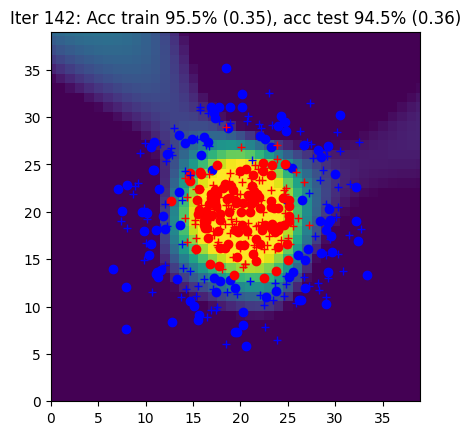

Iter 143: Acc train 96.0% (0.34), acc test 94.0% (0.36)


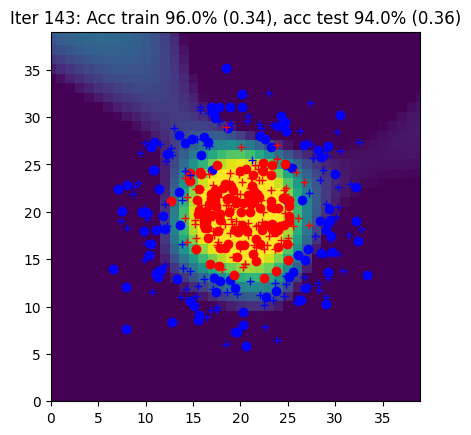

Iter 144: Acc train 95.5% (0.34), acc test 95.0% (0.35)


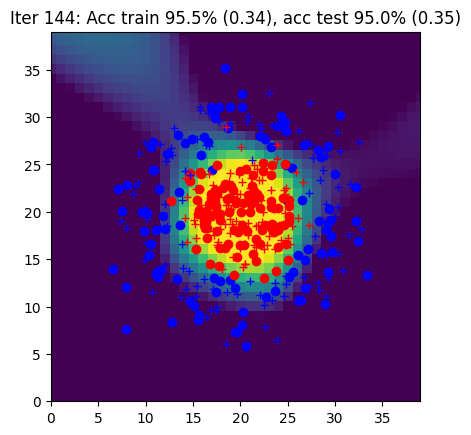

Iter 145: Acc train 95.5% (0.34), acc test 95.0% (0.35)


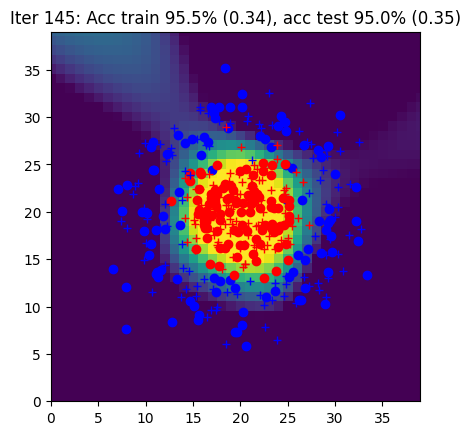

Iter 146: Acc train 96.0% (0.33), acc test 94.5% (0.34)


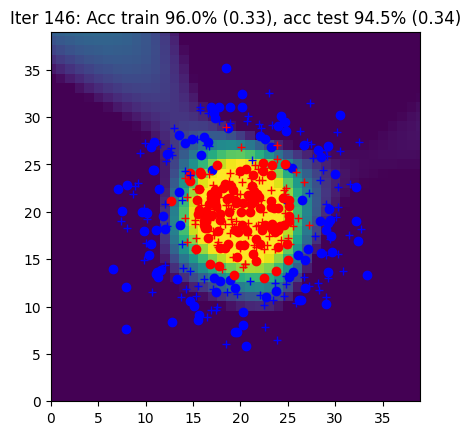

Iter 147: Acc train 95.5% (0.33), acc test 94.5% (0.34)


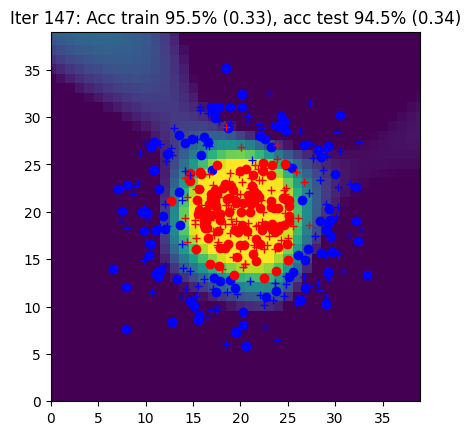

Iter 148: Acc train 95.5% (0.32), acc test 95.0% (0.34)


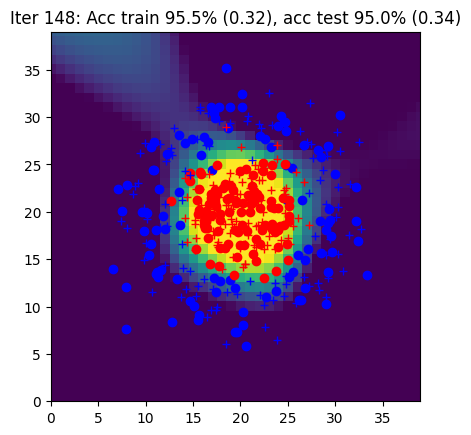

Iter 149: Acc train 96.0% (0.32), acc test 94.5% (0.33)


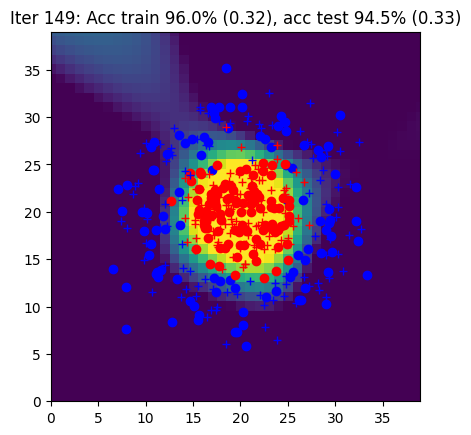

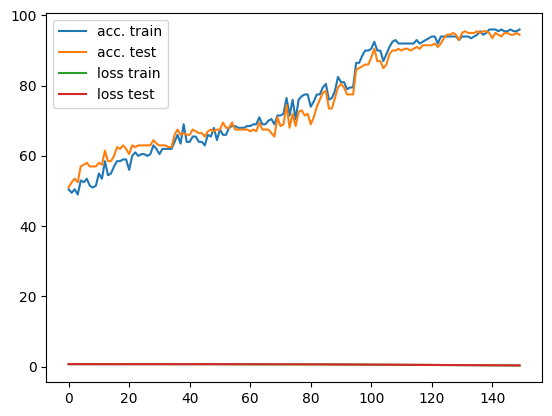

In [ ]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

params = init_params(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: forward, loss_accuracy, backward, sgd
        Yhat, outputs = forward(params, X)
        L, acc = loss_accuracy(Yhat, Y)
        grads = backward(params, outputs, Y)
        params = sgd(params, grads, eta)


    ####################
    ##      END        #
    ####################


    Yhat_train, _ = forward(params, data.Xtrain)
    Yhat_test, _ = forward(params, data.Xtest)
    Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(Yhat_test.detach(), data.Ytest)
    Ygrid, _ = forward(params, data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(Ygrid, title)
    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 2 : Simplification of the backward pass with `torch.autograd`



In [ ]:
import torch
def init_params_autograd(nx, nh, ny):
    params = {}
    params["Wh"] = torch.randn(nh, nx) * 0.3
    params["Wh"].requires_grad_()
    params["Wy"] = torch.randn(ny, nh) * 0.3
    params["Wy"].requires_grad_()
    params["bh"] = torch.zeros(1, nh)
    params["bh"].requires_grad_()
    params["by"] = torch.zeros(1, ny)
    params["by"].requires_grad_()
    return params


def sgd_autograd(params, eta):

    with torch.no_grad():
        params["Wh"] -= eta * params["Wh"].grad
        params["Wy"] -= eta * params["Wy"].grad
        params["bh"] -= eta * params["bh"].grad
        params["by"] -= eta * params["by"].grad
        params["Wh"].grad.zero_()
        params["Wy"].grad.zero_()
        params["bh"].grad.zero_()
        params["by"].grad.zero_()

    return params

## Global learning procedure with autograd

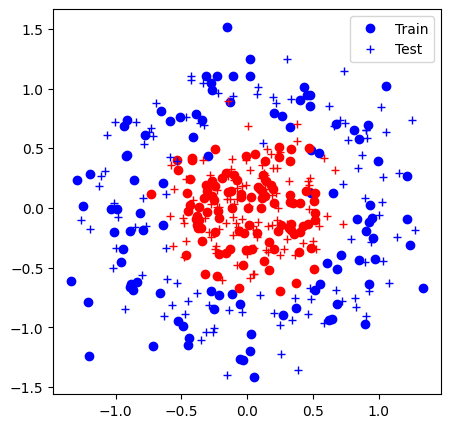

Iter 0: Acc train 56.5% (0.70), acc test 57.0% (0.70)


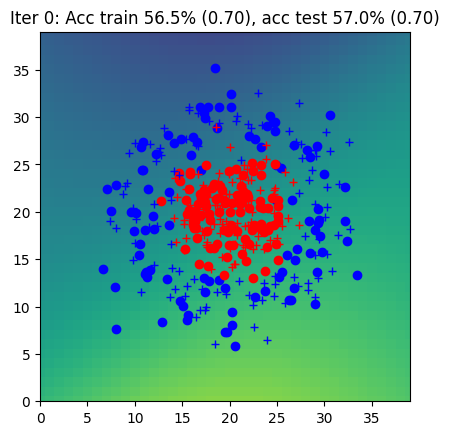

Iter 1: Acc train 56.5% (0.69), acc test 54.0% (0.70)


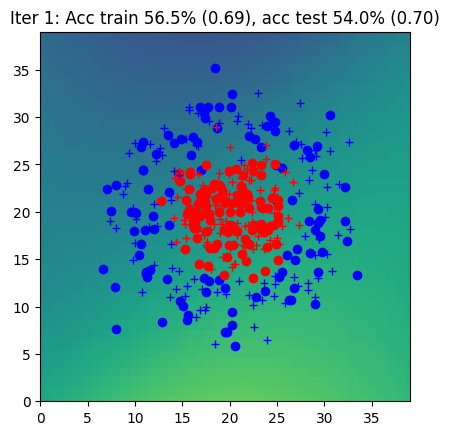

Iter 2: Acc train 58.0% (0.69), acc test 57.0% (0.69)


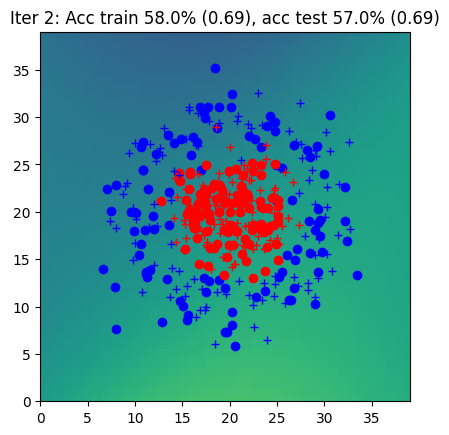

Iter 3: Acc train 56.5% (0.69), acc test 57.5% (0.69)


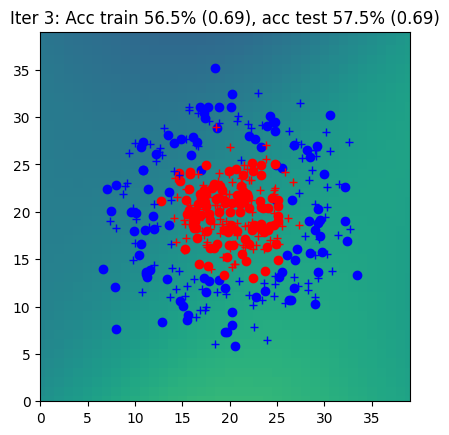

Iter 4: Acc train 63.5% (0.69), acc test 62.5% (0.69)


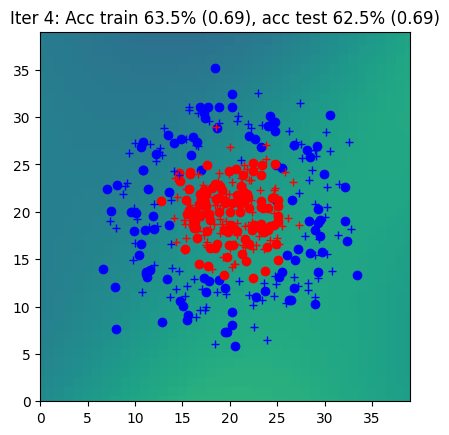

Iter 5: Acc train 56.0% (0.69), acc test 58.5% (0.69)


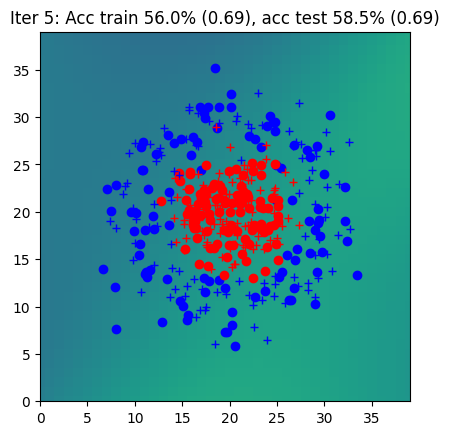

Iter 6: Acc train 56.5% (0.69), acc test 60.5% (0.69)


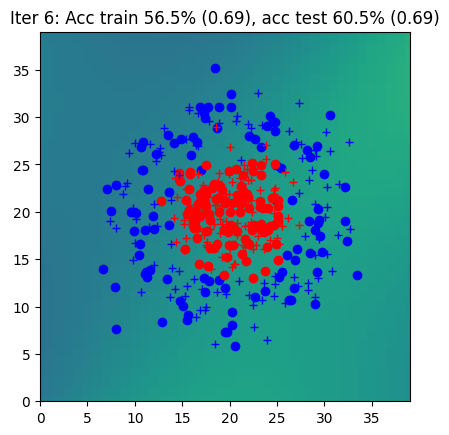

Iter 7: Acc train 61.5% (0.69), acc test 63.0% (0.69)


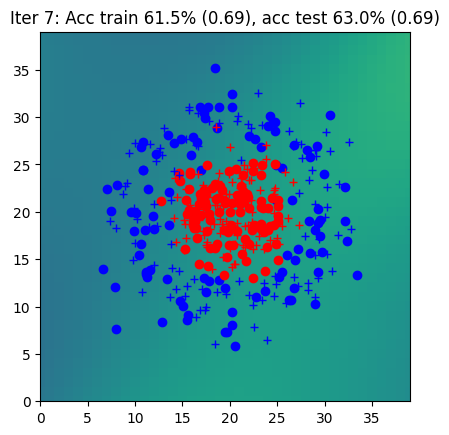

Iter 8: Acc train 61.0% (0.69), acc test 63.0% (0.69)


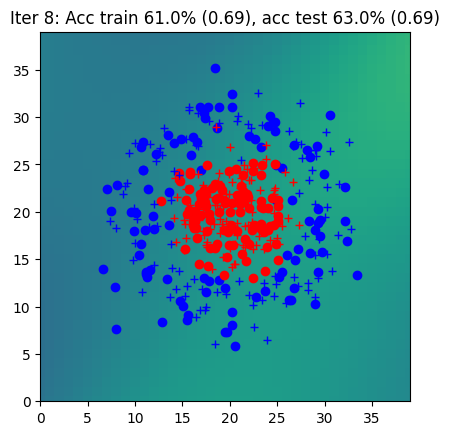

Iter 9: Acc train 58.0% (0.69), acc test 59.0% (0.69)


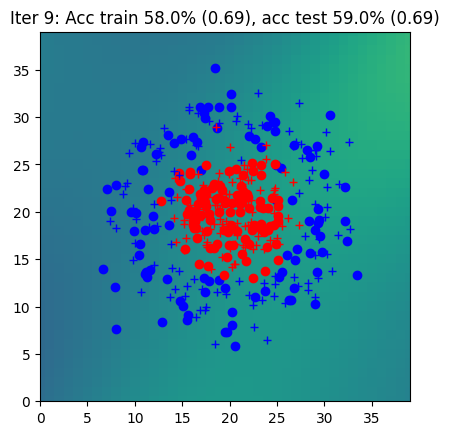

Iter 10: Acc train 59.5% (0.69), acc test 61.0% (0.69)


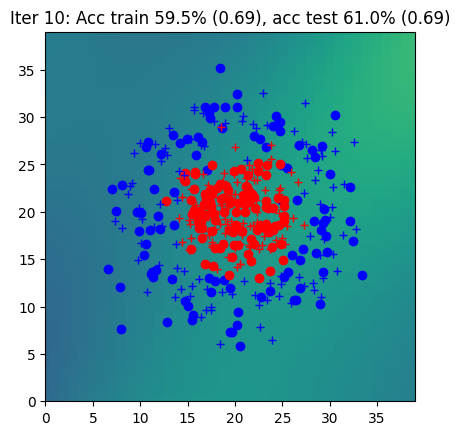

Iter 11: Acc train 60.0% (0.69), acc test 62.5% (0.69)


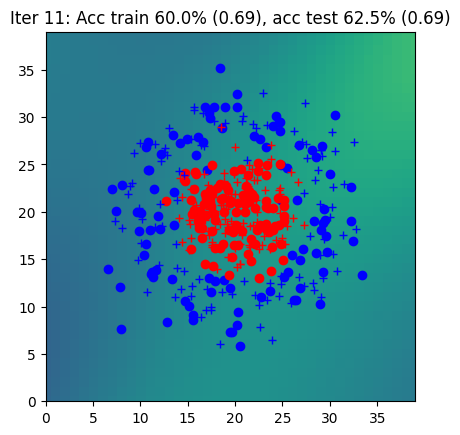

Iter 12: Acc train 67.5% (0.69), acc test 63.0% (0.69)


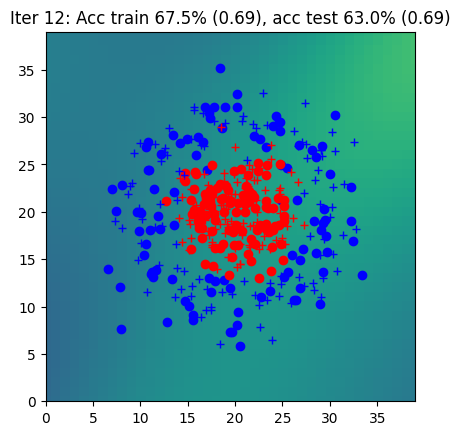

Iter 13: Acc train 66.0% (0.68), acc test 64.0% (0.69)


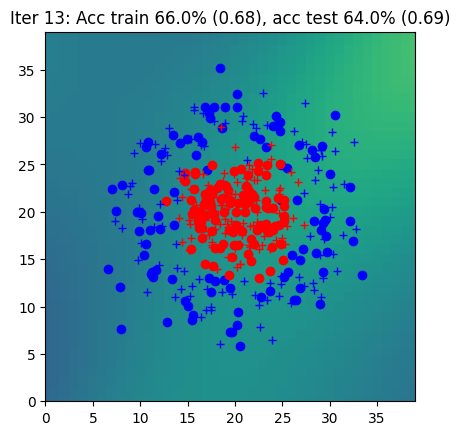

Iter 14: Acc train 65.0% (0.68), acc test 66.5% (0.69)


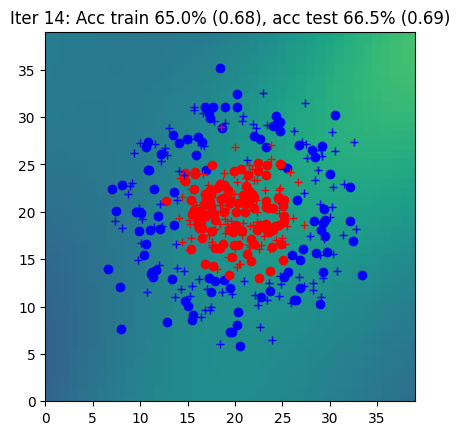

Iter 15: Acc train 67.0% (0.68), acc test 65.5% (0.69)


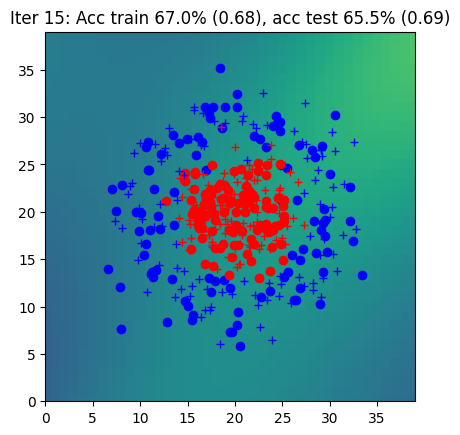

Iter 16: Acc train 68.5% (0.68), acc test 65.5% (0.68)


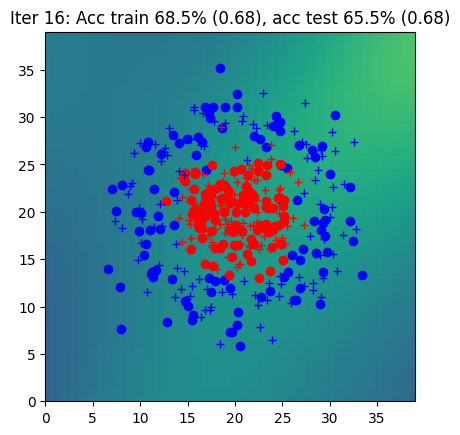

Iter 17: Acc train 68.5% (0.68), acc test 66.5% (0.68)


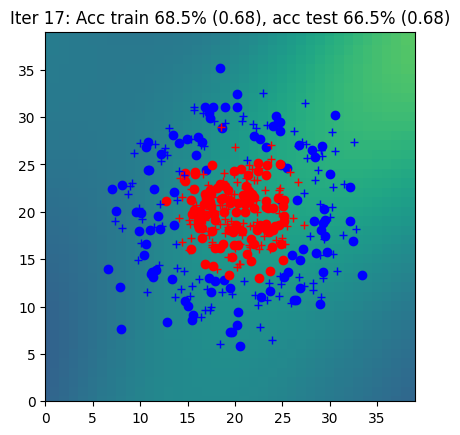

Iter 18: Acc train 70.5% (0.68), acc test 66.5% (0.68)


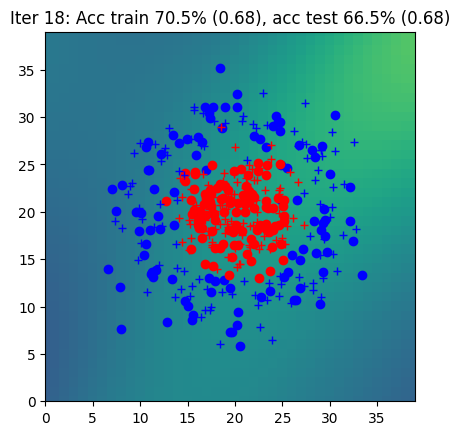

Iter 19: Acc train 71.0% (0.68), acc test 66.5% (0.68)


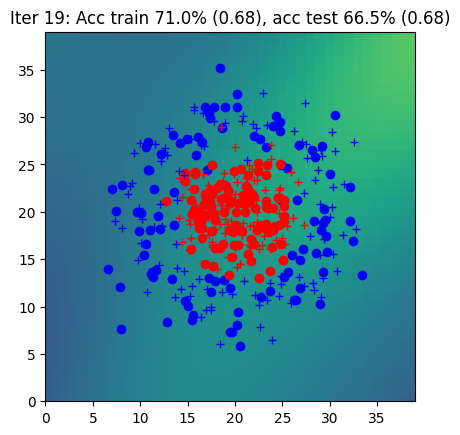

Iter 20: Acc train 69.0% (0.68), acc test 66.0% (0.68)


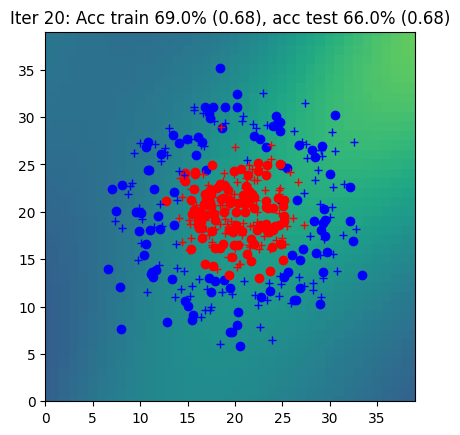

Iter 21: Acc train 70.0% (0.68), acc test 66.5% (0.68)


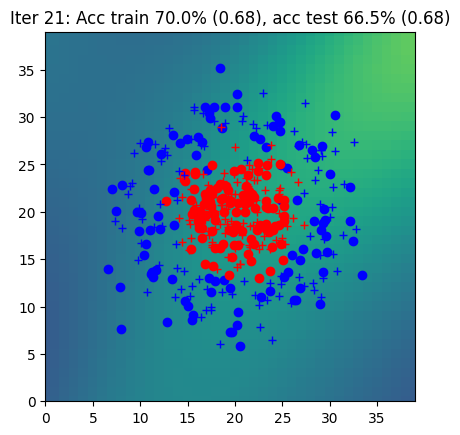

Iter 22: Acc train 71.5% (0.68), acc test 67.5% (0.68)


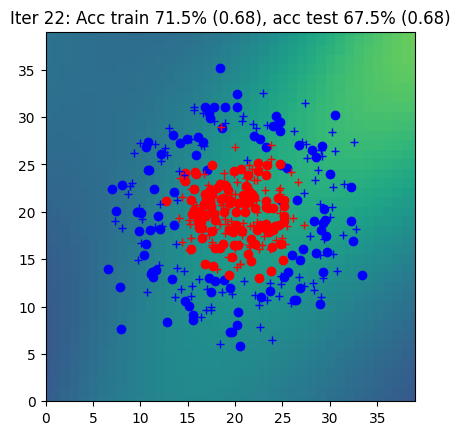

Iter 23: Acc train 69.5% (0.68), acc test 67.5% (0.68)


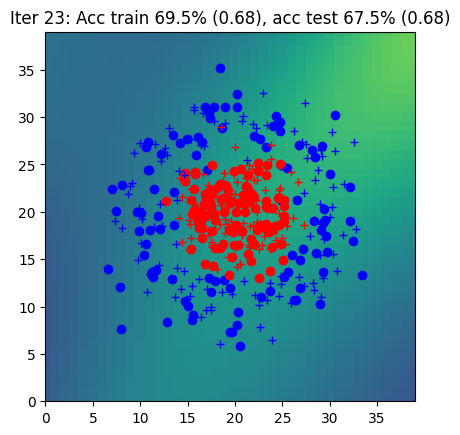

Iter 24: Acc train 73.5% (0.68), acc test 70.0% (0.68)


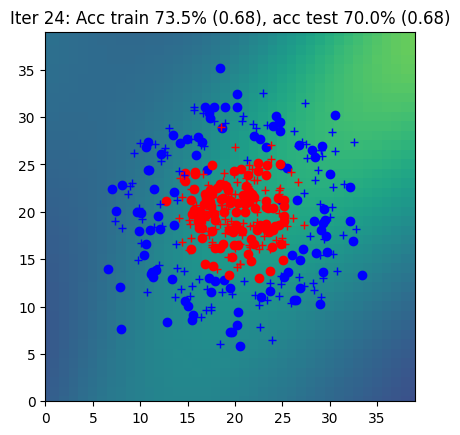

Iter 25: Acc train 70.5% (0.67), acc test 69.5% (0.68)


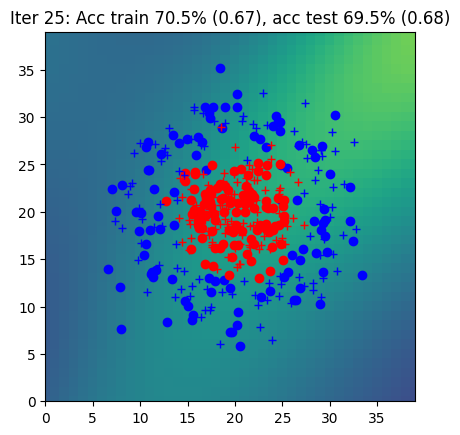

Iter 26: Acc train 70.5% (0.67), acc test 68.5% (0.67)


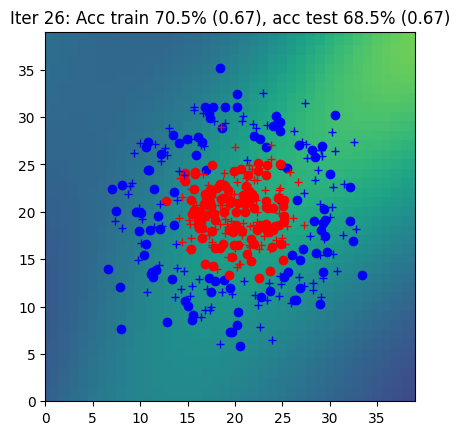

Iter 27: Acc train 70.0% (0.67), acc test 68.5% (0.67)


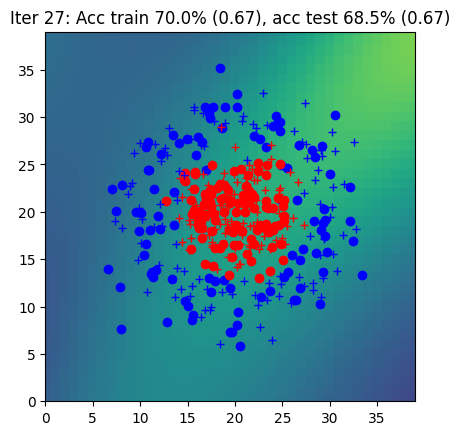

Iter 28: Acc train 70.5% (0.67), acc test 69.5% (0.67)


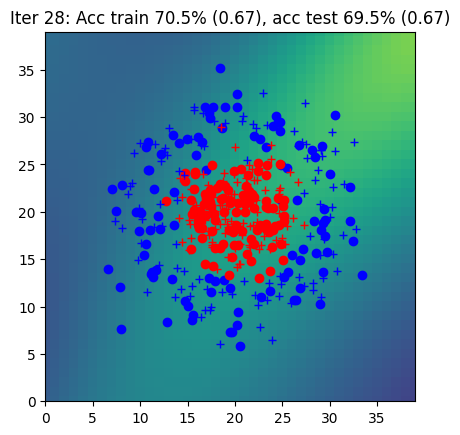

Iter 29: Acc train 73.0% (0.67), acc test 69.5% (0.67)


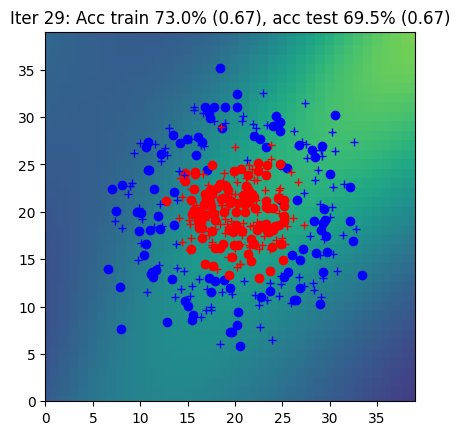

Iter 30: Acc train 73.5% (0.67), acc test 70.0% (0.67)


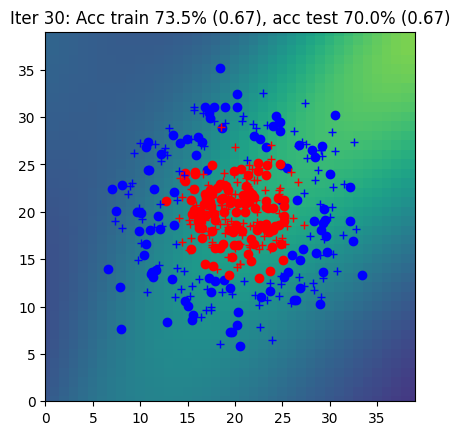

Iter 31: Acc train 73.0% (0.67), acc test 69.5% (0.67)


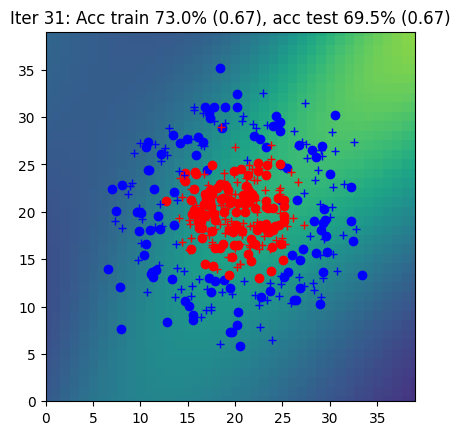

Iter 32: Acc train 73.5% (0.66), acc test 71.5% (0.67)


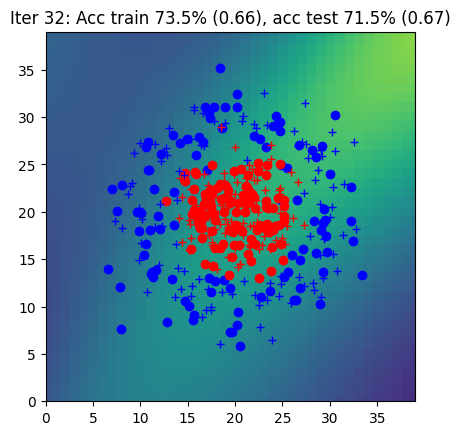

Iter 33: Acc train 73.5% (0.66), acc test 71.0% (0.66)


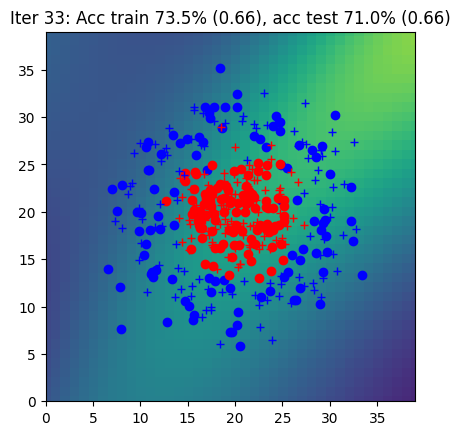

Iter 34: Acc train 73.5% (0.66), acc test 71.0% (0.66)


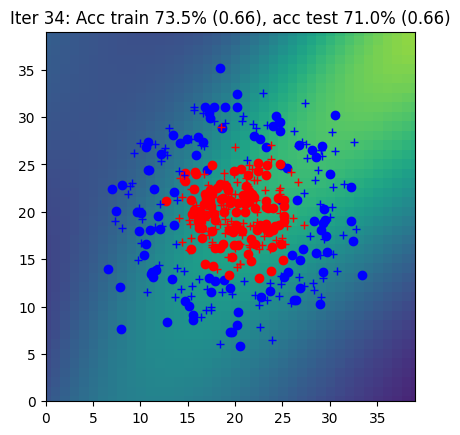

Iter 35: Acc train 74.0% (0.66), acc test 72.5% (0.66)


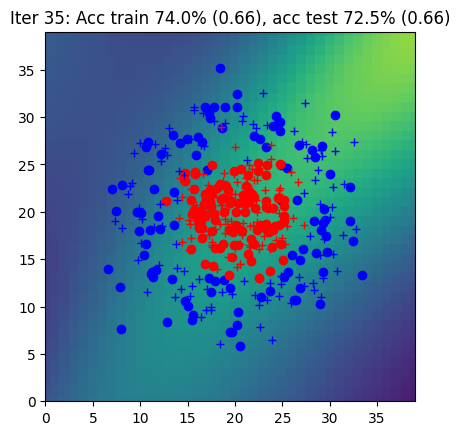

Iter 36: Acc train 74.0% (0.66), acc test 72.5% (0.66)


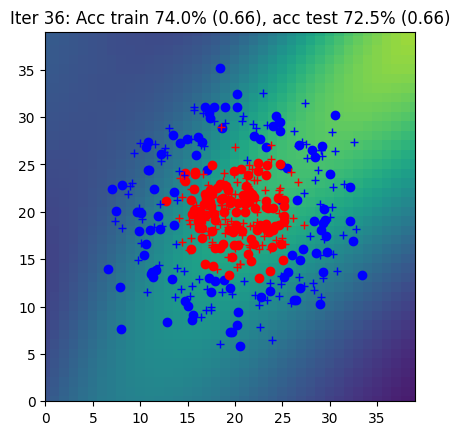

Iter 37: Acc train 76.5% (0.66), acc test 72.5% (0.66)


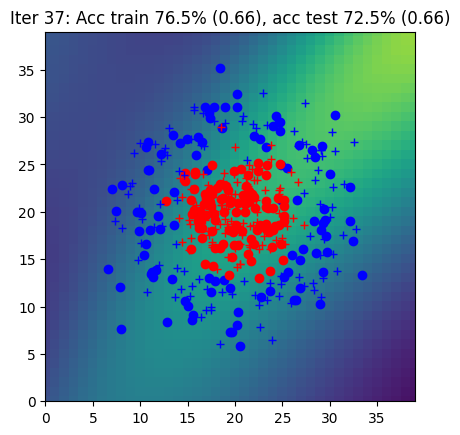

Iter 38: Acc train 76.5% (0.65), acc test 72.5% (0.65)


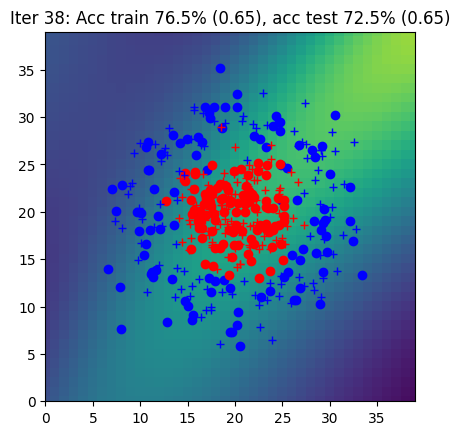

Iter 39: Acc train 78.0% (0.65), acc test 76.0% (0.65)


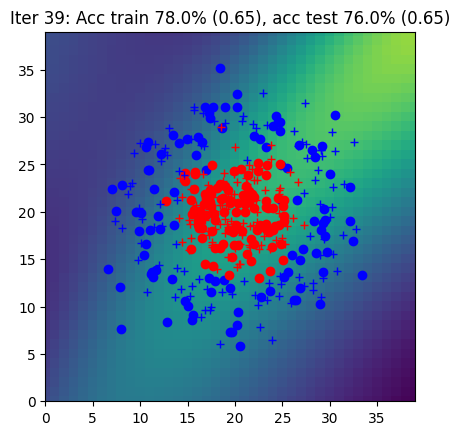

Iter 40: Acc train 77.5% (0.65), acc test 74.5% (0.65)


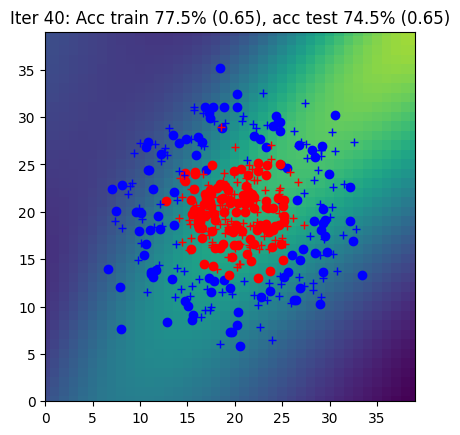

Iter 41: Acc train 78.0% (0.65), acc test 74.5% (0.65)


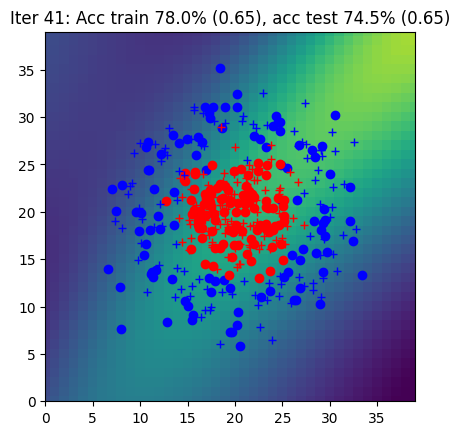

Iter 42: Acc train 77.5% (0.64), acc test 75.0% (0.65)


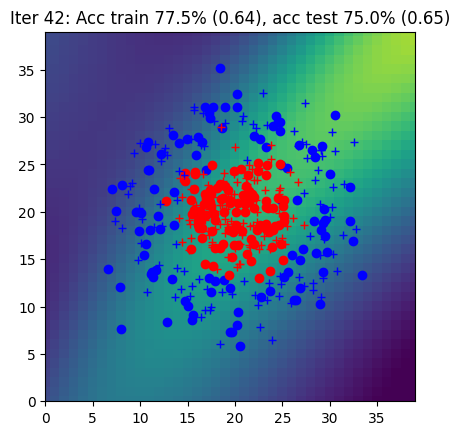

Iter 43: Acc train 77.5% (0.64), acc test 75.0% (0.64)


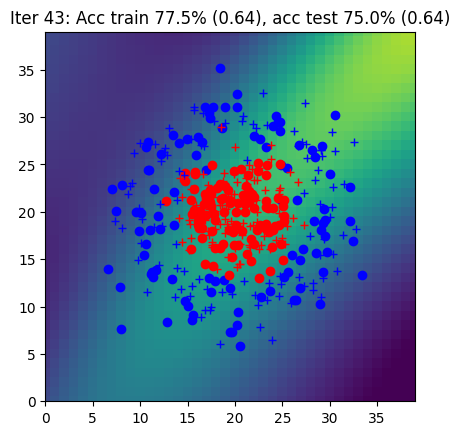

Iter 44: Acc train 78.0% (0.64), acc test 75.5% (0.64)


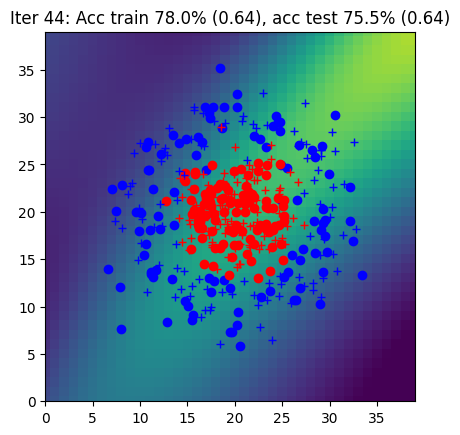

Iter 45: Acc train 78.0% (0.64), acc test 75.0% (0.64)


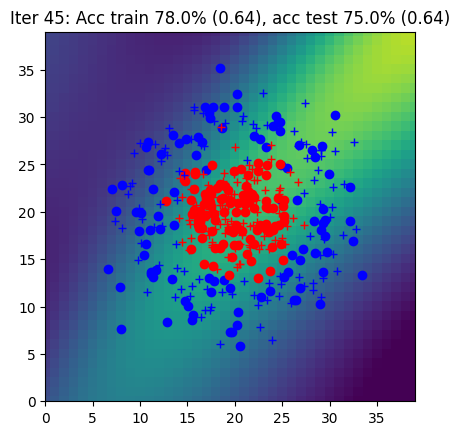

Iter 46: Acc train 78.5% (0.63), acc test 75.5% (0.64)


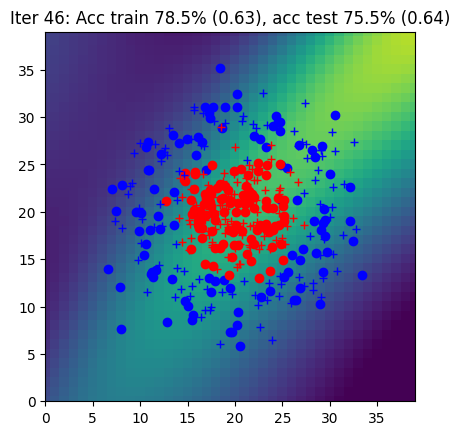

Iter 47: Acc train 79.5% (0.63), acc test 75.5% (0.63)


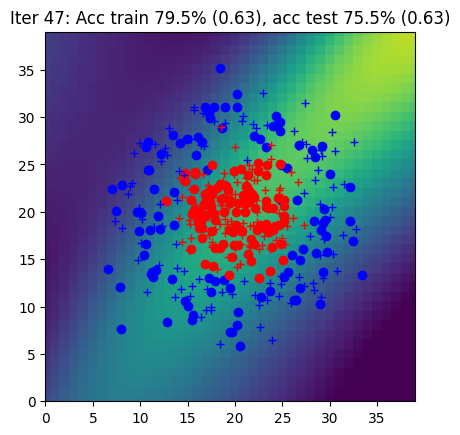

Iter 48: Acc train 77.0% (0.63), acc test 75.0% (0.63)


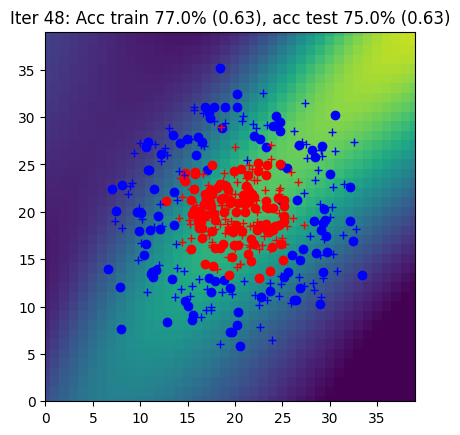

Iter 49: Acc train 77.5% (0.63), acc test 75.5% (0.63)


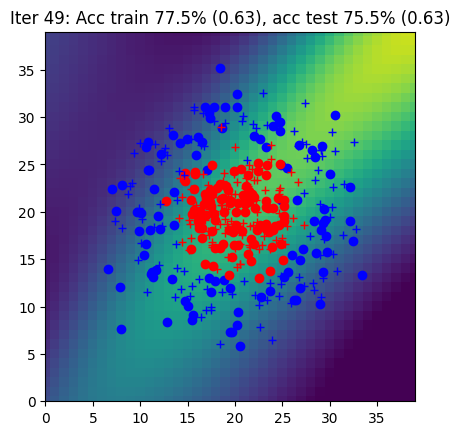

Iter 50: Acc train 77.5% (0.62), acc test 76.5% (0.62)


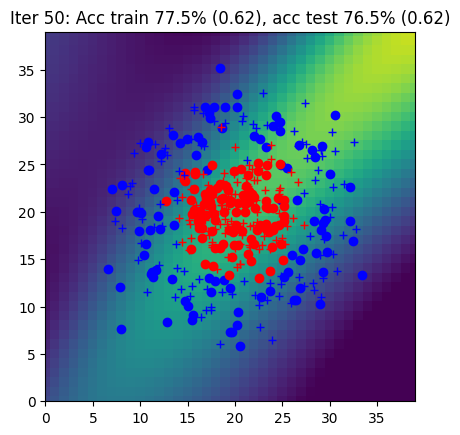

Iter 51: Acc train 78.5% (0.62), acc test 78.0% (0.62)


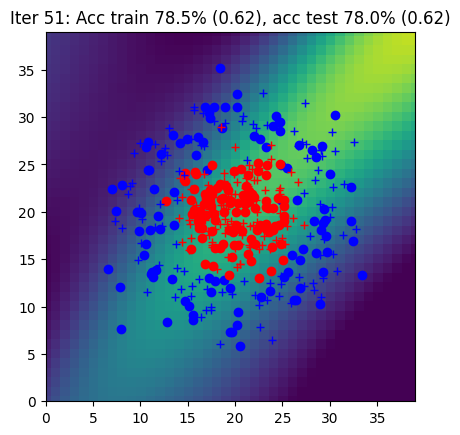

Iter 52: Acc train 77.0% (0.62), acc test 76.5% (0.62)


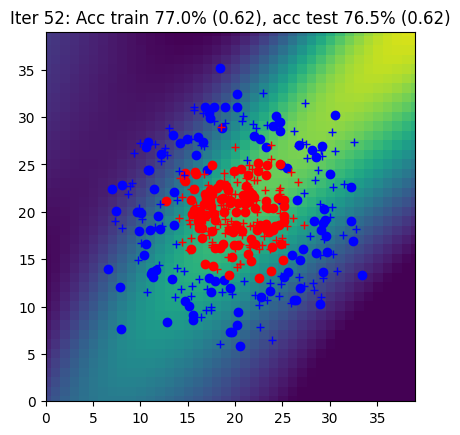

Iter 53: Acc train 77.0% (0.62), acc test 76.5% (0.61)


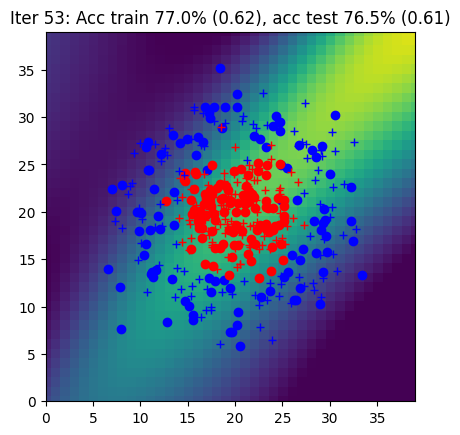

Iter 54: Acc train 77.0% (0.61), acc test 77.5% (0.61)


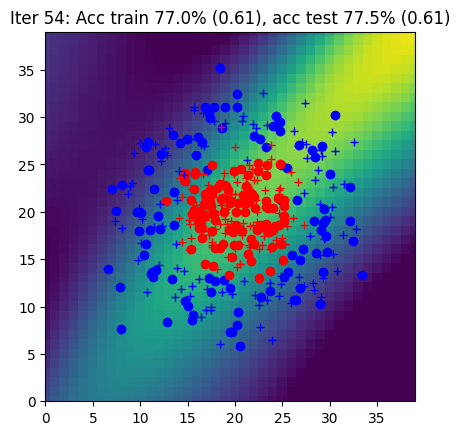

Iter 55: Acc train 77.0% (0.61), acc test 76.5% (0.61)


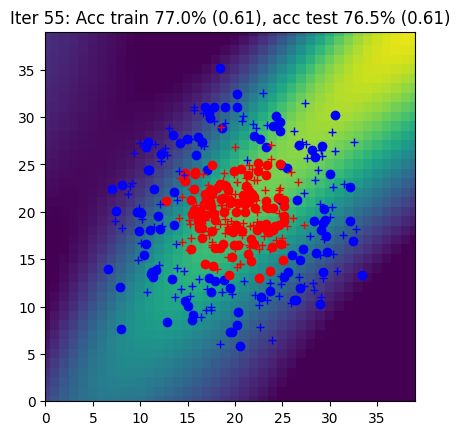

Iter 56: Acc train 77.0% (0.61), acc test 77.5% (0.61)


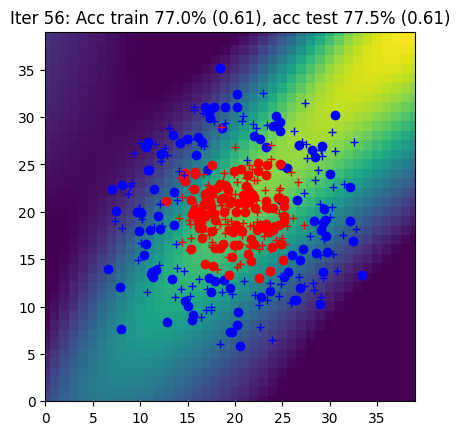

Iter 57: Acc train 77.0% (0.60), acc test 77.0% (0.60)


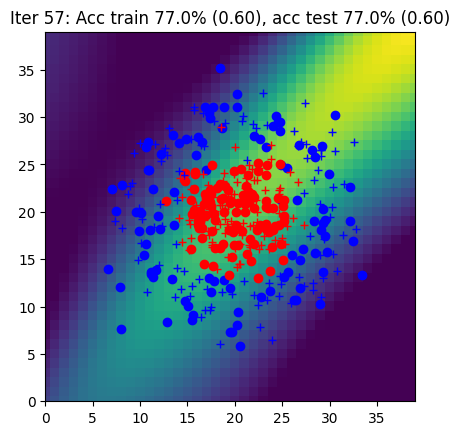

Iter 58: Acc train 76.5% (0.60), acc test 76.5% (0.60)


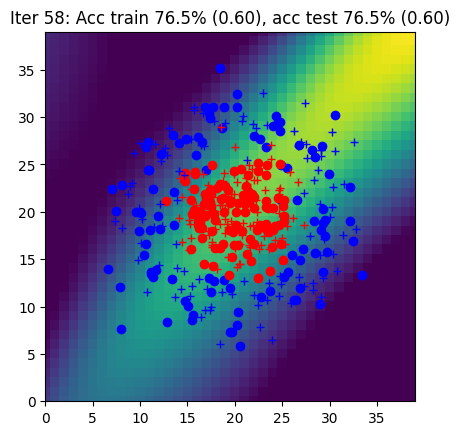

Iter 59: Acc train 76.5% (0.60), acc test 77.0% (0.60)


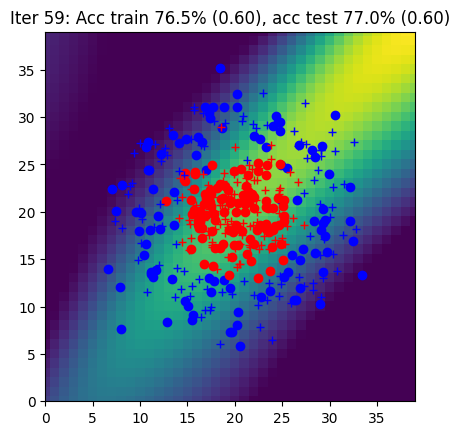

Iter 60: Acc train 77.0% (0.59), acc test 79.0% (0.59)


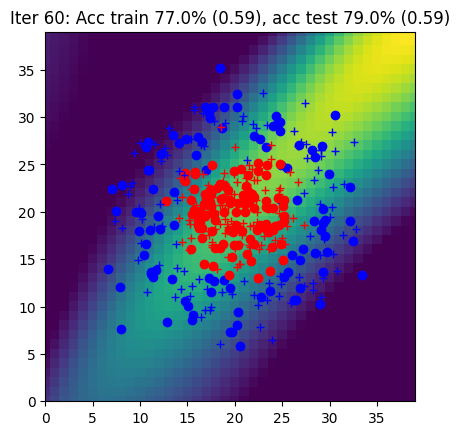

Iter 61: Acc train 77.0% (0.59), acc test 79.0% (0.59)


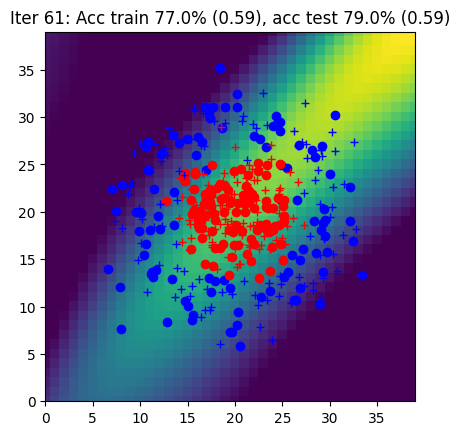

Iter 62: Acc train 77.0% (0.59), acc test 78.5% (0.59)


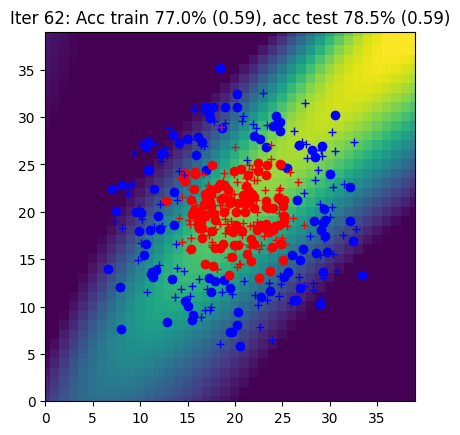

Iter 63: Acc train 76.5% (0.58), acc test 77.5% (0.58)


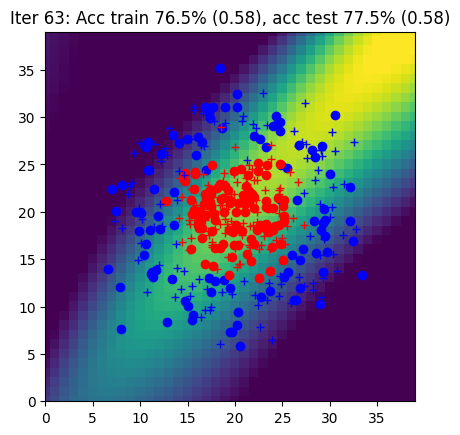

Iter 64: Acc train 77.0% (0.58), acc test 77.5% (0.58)


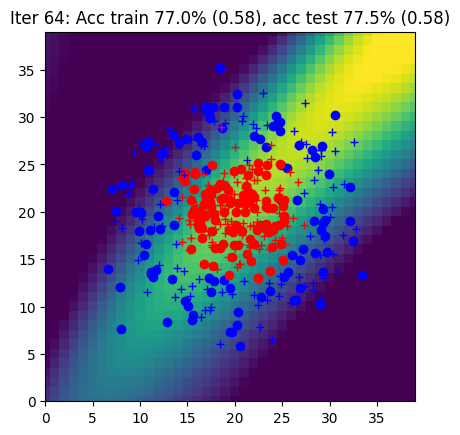

Iter 65: Acc train 77.5% (0.58), acc test 78.0% (0.58)


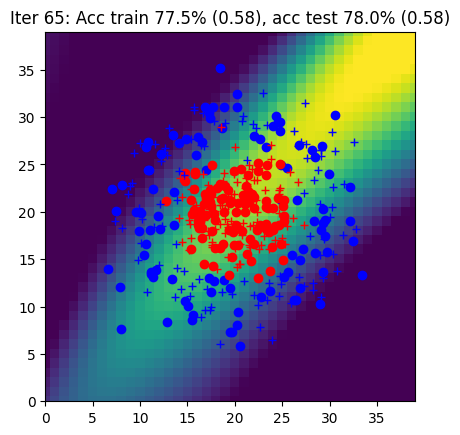

Iter 66: Acc train 77.0% (0.58), acc test 78.5% (0.57)


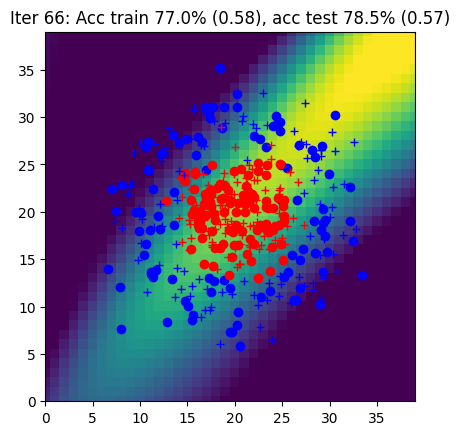

Iter 67: Acc train 77.0% (0.57), acc test 78.0% (0.57)


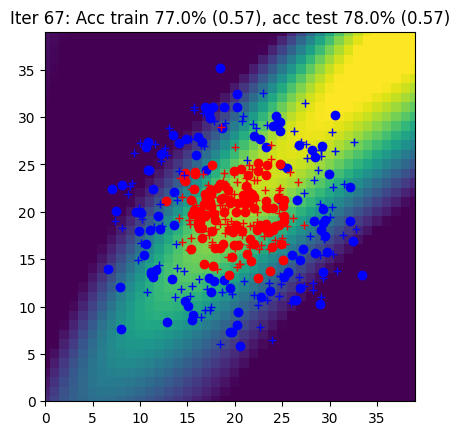

Iter 68: Acc train 78.5% (0.57), acc test 79.0% (0.57)


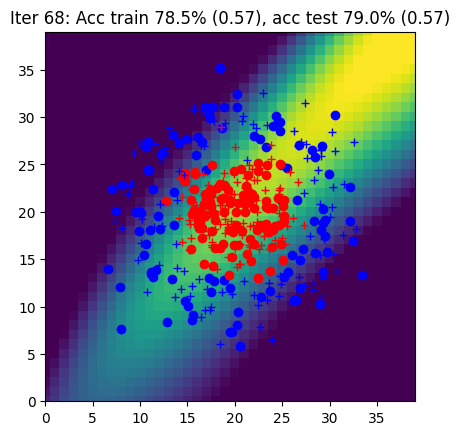

Iter 69: Acc train 78.5% (0.57), acc test 79.0% (0.56)


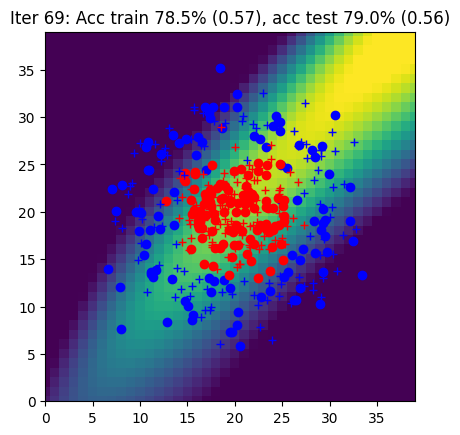

Iter 70: Acc train 78.5% (0.56), acc test 79.0% (0.56)


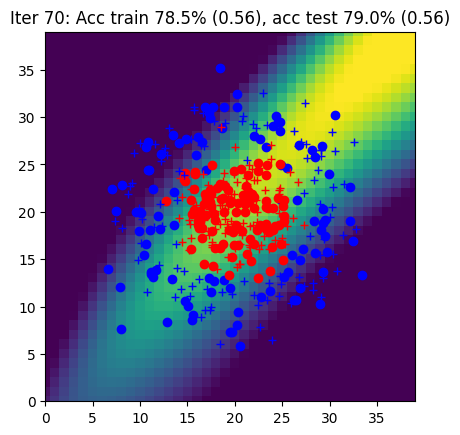

Iter 71: Acc train 78.5% (0.56), acc test 79.0% (0.56)


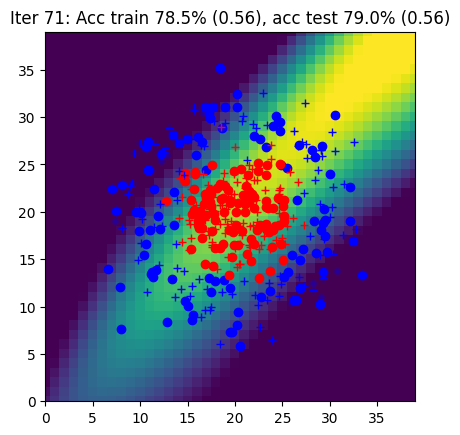

Iter 72: Acc train 78.5% (0.56), acc test 79.0% (0.55)


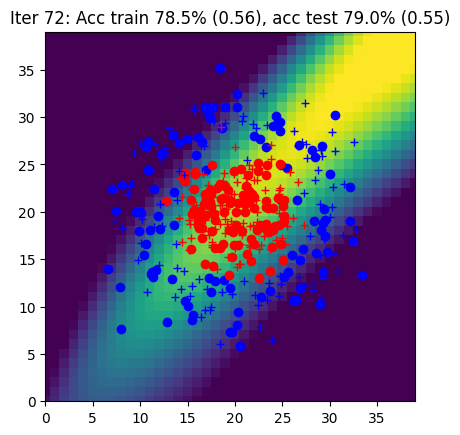

Iter 73: Acc train 78.0% (0.55), acc test 79.0% (0.55)


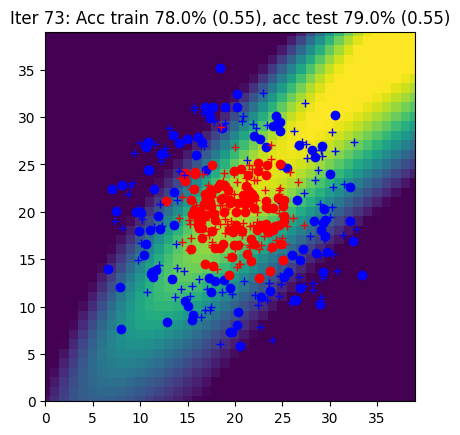

Iter 74: Acc train 78.5% (0.55), acc test 79.0% (0.55)


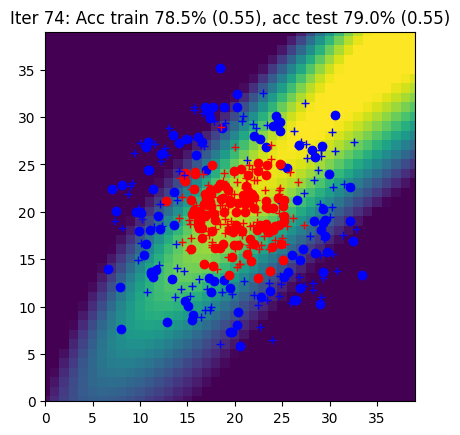

Iter 75: Acc train 78.5% (0.55), acc test 79.0% (0.55)


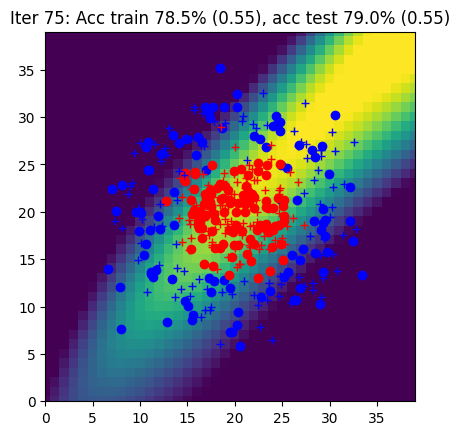

Iter 76: Acc train 78.5% (0.55), acc test 79.0% (0.54)


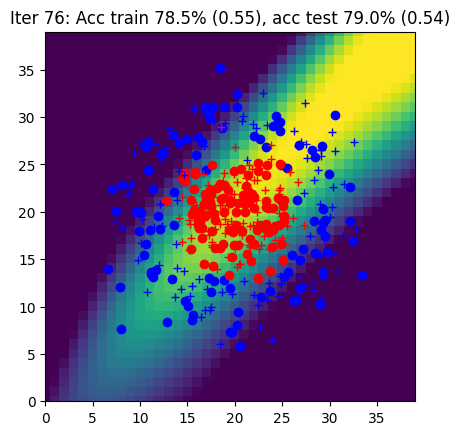

Iter 77: Acc train 78.0% (0.54), acc test 79.5% (0.54)


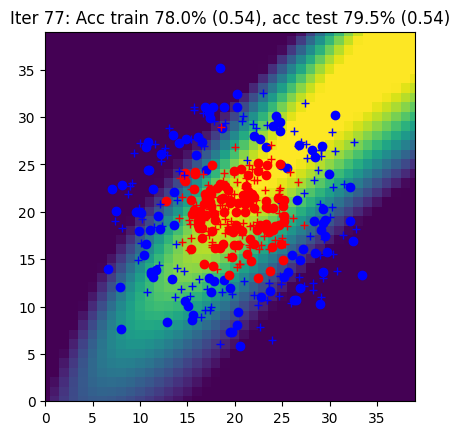

Iter 78: Acc train 78.5% (0.54), acc test 79.5% (0.54)


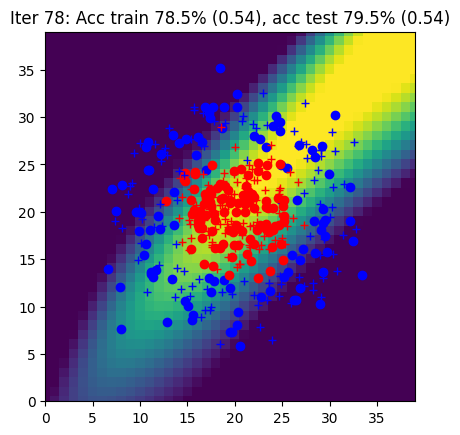

Iter 79: Acc train 78.5% (0.54), acc test 80.0% (0.53)


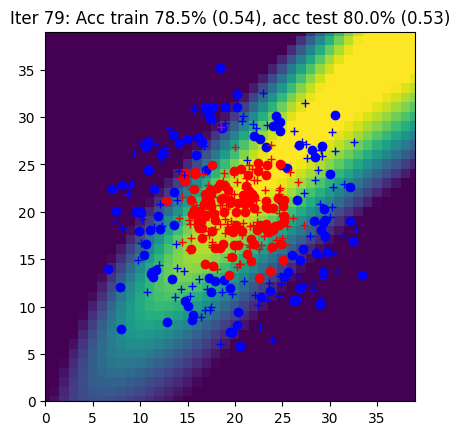

Iter 80: Acc train 79.0% (0.53), acc test 80.0% (0.53)


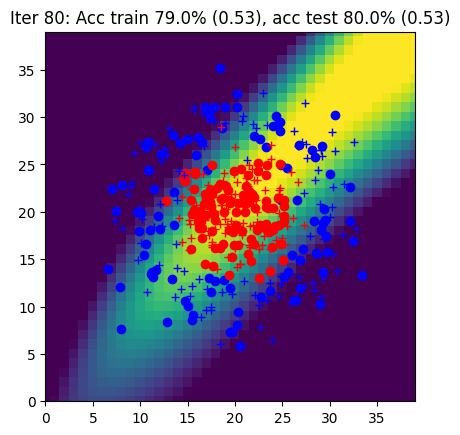

Iter 81: Acc train 79.0% (0.53), acc test 79.0% (0.53)


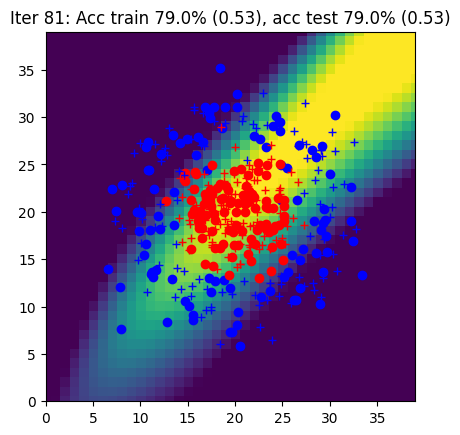

Iter 82: Acc train 79.0% (0.53), acc test 79.5% (0.53)


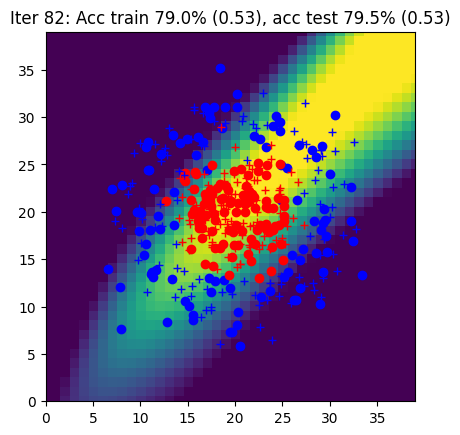

Iter 83: Acc train 79.5% (0.53), acc test 80.5% (0.52)


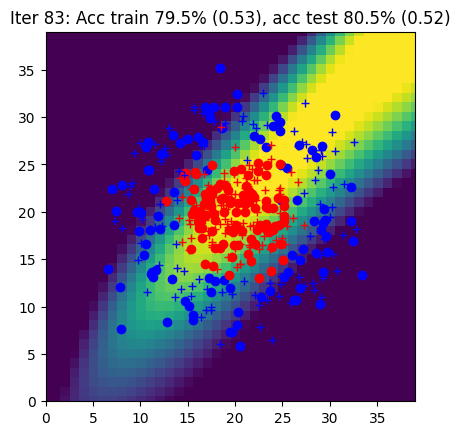

Iter 84: Acc train 79.5% (0.52), acc test 80.0% (0.52)


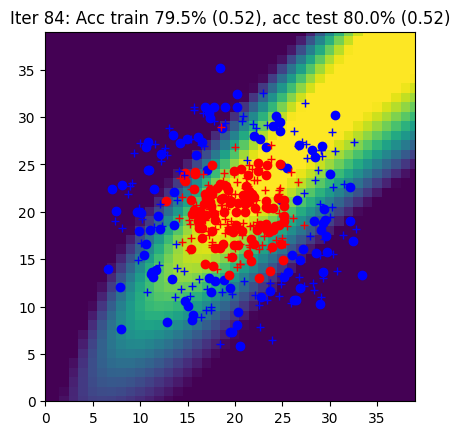

Iter 85: Acc train 78.5% (0.52), acc test 79.5% (0.52)


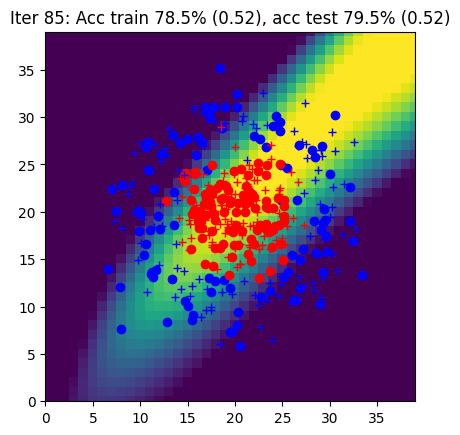

Iter 86: Acc train 78.5% (0.52), acc test 79.5% (0.51)


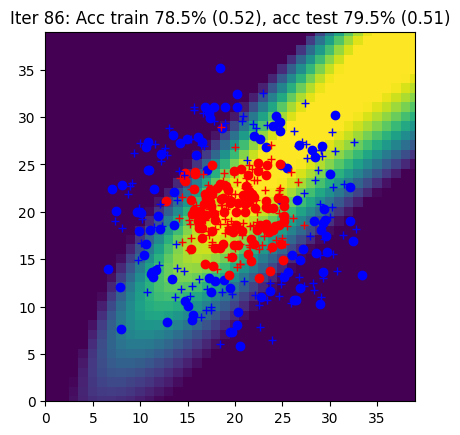

Iter 87: Acc train 79.5% (0.51), acc test 80.5% (0.51)


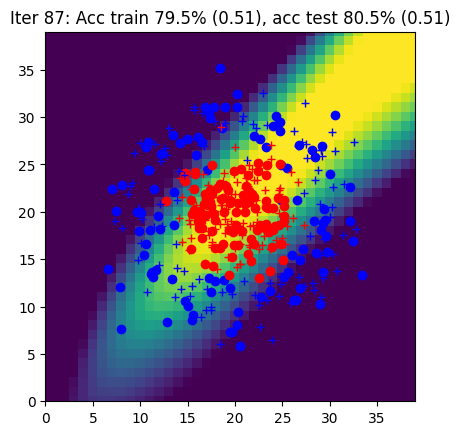

Iter 88: Acc train 78.5% (0.51), acc test 79.5% (0.51)


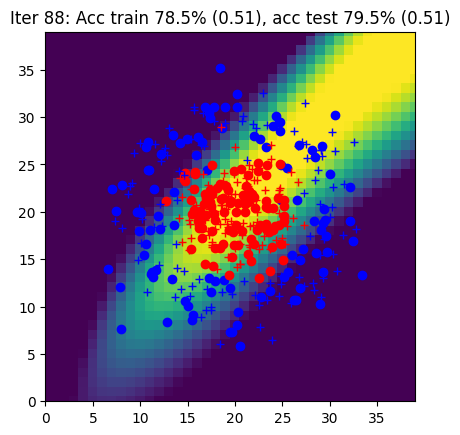

Iter 89: Acc train 78.5% (0.51), acc test 80.0% (0.51)


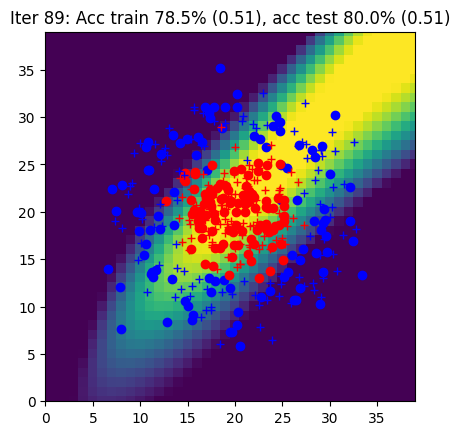

Iter 90: Acc train 78.5% (0.51), acc test 79.5% (0.50)


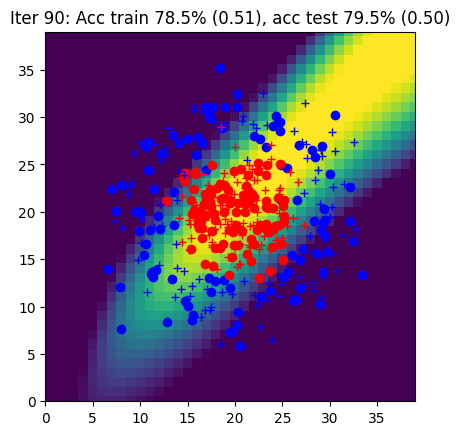

Iter 91: Acc train 78.5% (0.50), acc test 79.5% (0.50)


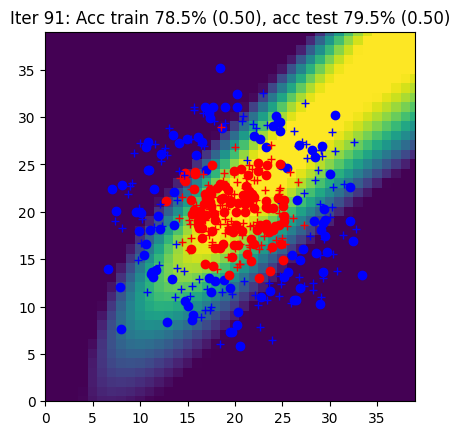

Iter 92: Acc train 78.5% (0.50), acc test 79.5% (0.50)


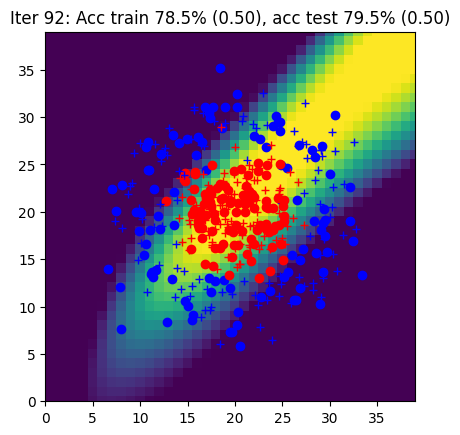

Iter 93: Acc train 79.0% (0.50), acc test 79.5% (0.49)


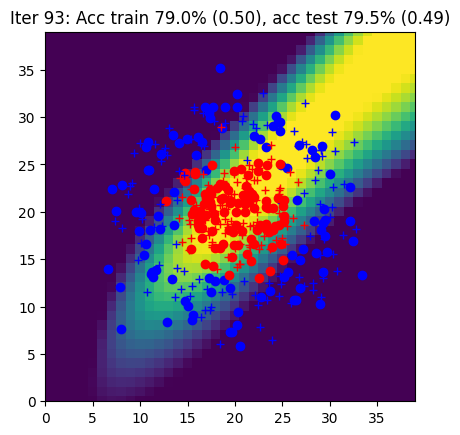

Iter 94: Acc train 79.0% (0.49), acc test 79.5% (0.49)


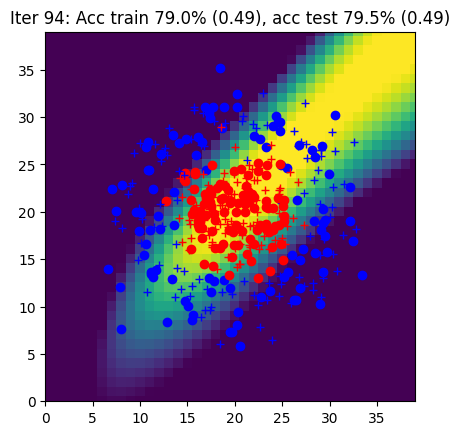

Iter 95: Acc train 79.5% (0.49), acc test 80.0% (0.49)


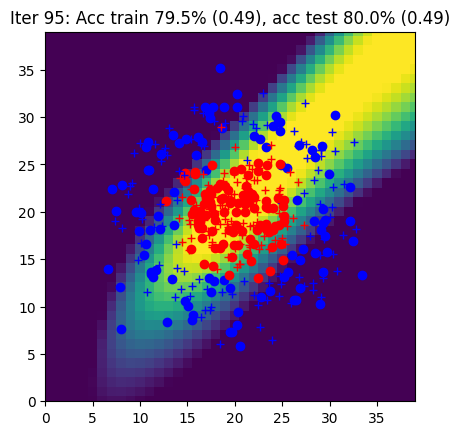

Iter 96: Acc train 79.5% (0.49), acc test 80.0% (0.48)


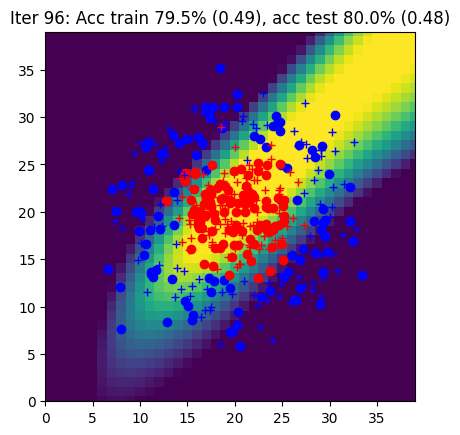

Iter 97: Acc train 79.5% (0.48), acc test 80.0% (0.48)


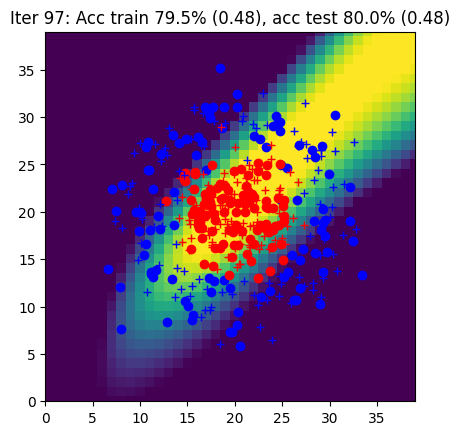

Iter 98: Acc train 79.0% (0.48), acc test 80.5% (0.48)


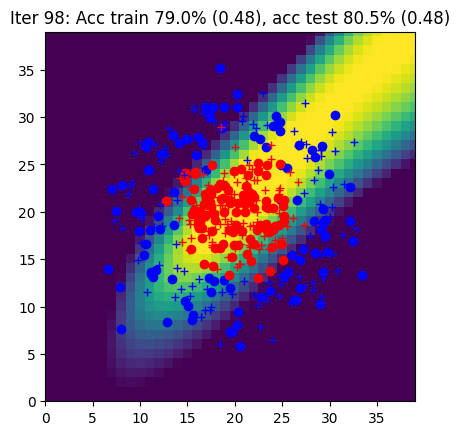

Iter 99: Acc train 79.5% (0.48), acc test 80.0% (0.47)


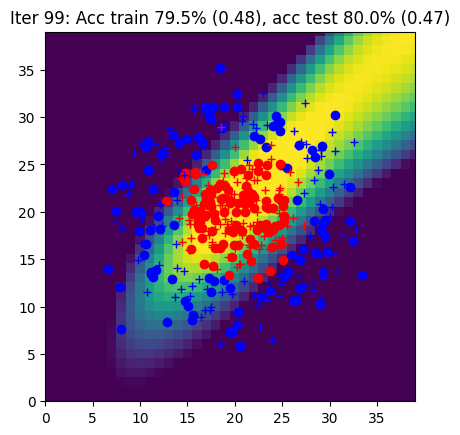

Iter 100: Acc train 79.0% (0.47), acc test 81.0% (0.47)


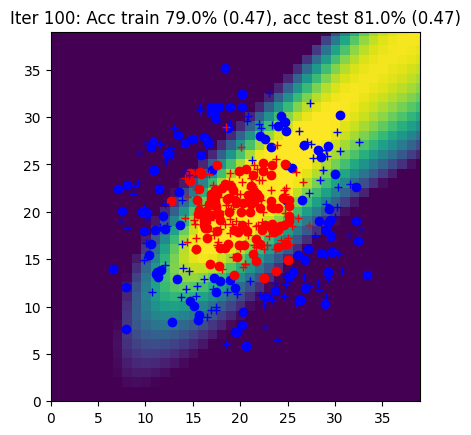

Iter 101: Acc train 79.5% (0.47), acc test 80.5% (0.47)


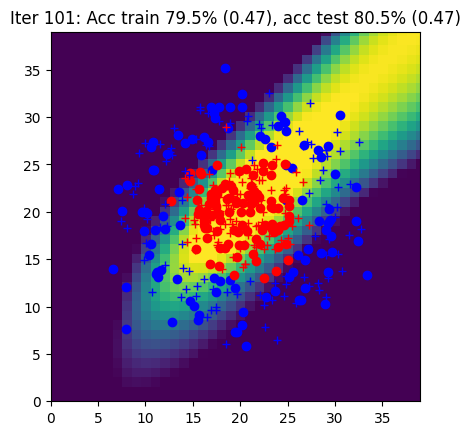

Iter 102: Acc train 80.0% (0.47), acc test 81.5% (0.46)


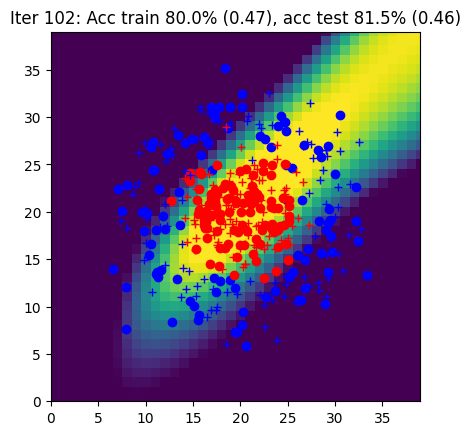

Iter 103: Acc train 80.0% (0.46), acc test 81.5% (0.46)


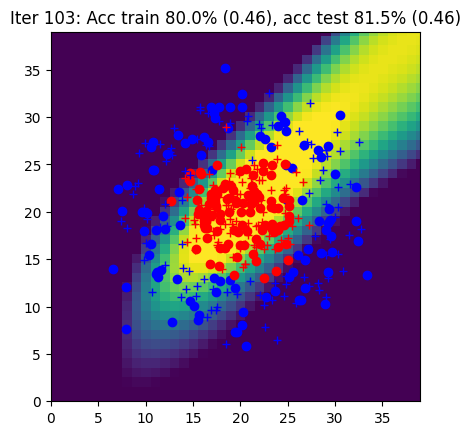

Iter 104: Acc train 79.5% (0.46), acc test 81.5% (0.46)


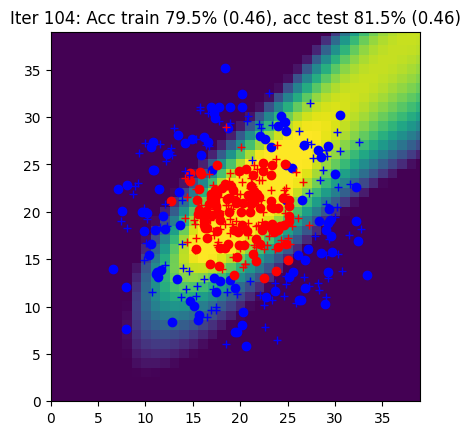

Iter 105: Acc train 80.0% (0.45), acc test 81.5% (0.45)


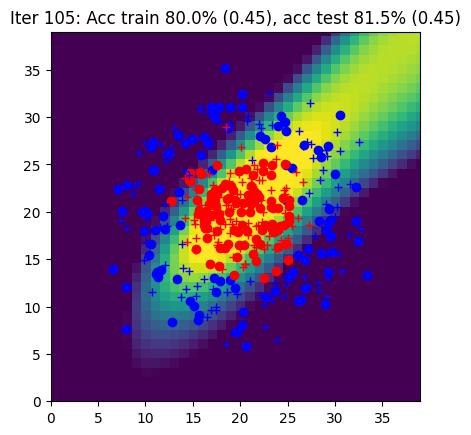

Iter 106: Acc train 81.0% (0.45), acc test 81.5% (0.45)


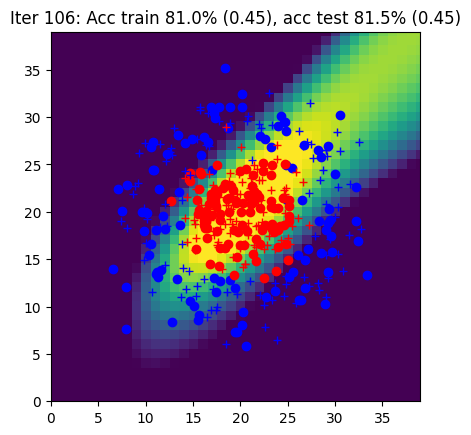

Iter 107: Acc train 81.5% (0.45), acc test 81.5% (0.45)


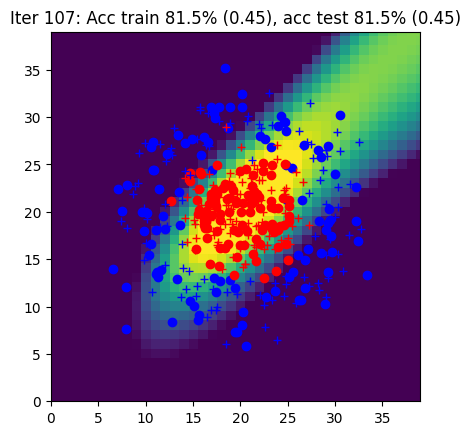

Iter 108: Acc train 81.0% (0.44), acc test 81.5% (0.44)


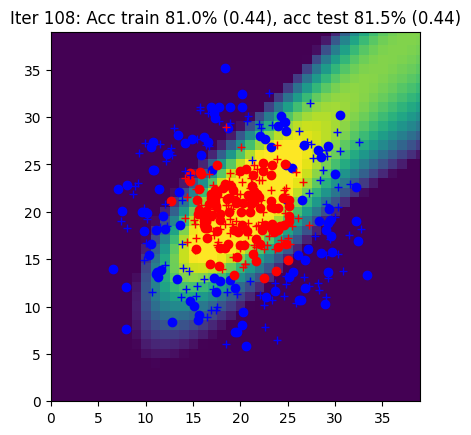

Iter 109: Acc train 81.5% (0.44), acc test 81.5% (0.44)


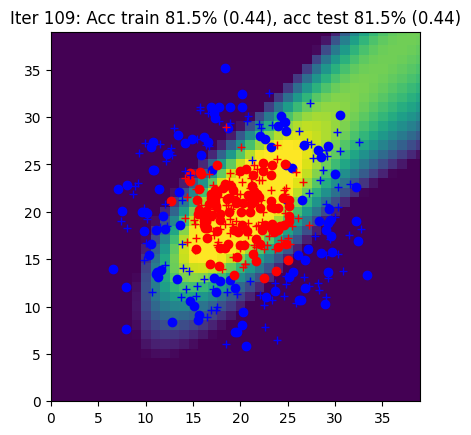

Iter 110: Acc train 82.0% (0.43), acc test 82.0% (0.43)


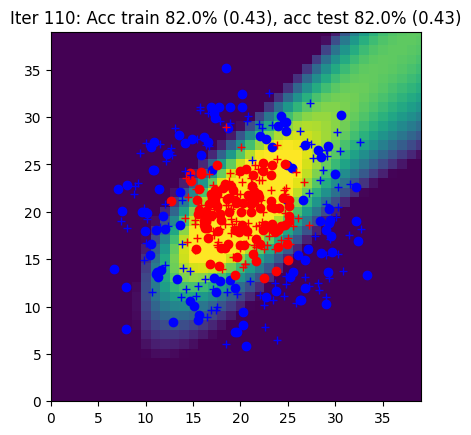

Iter 111: Acc train 82.0% (0.43), acc test 82.0% (0.43)


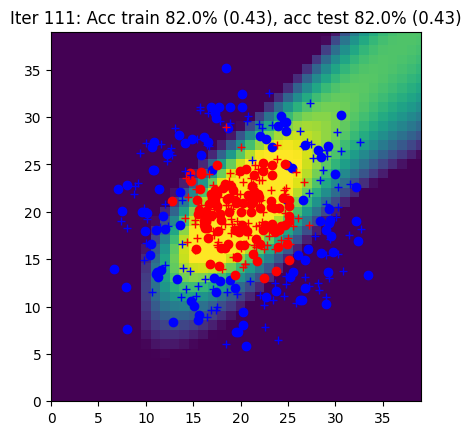

Iter 112: Acc train 81.5% (0.42), acc test 83.0% (0.42)


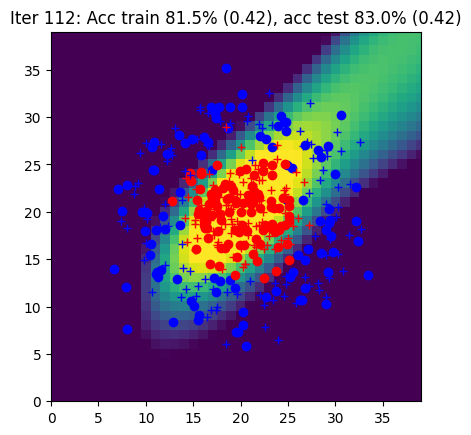

Iter 113: Acc train 82.5% (0.42), acc test 84.0% (0.42)


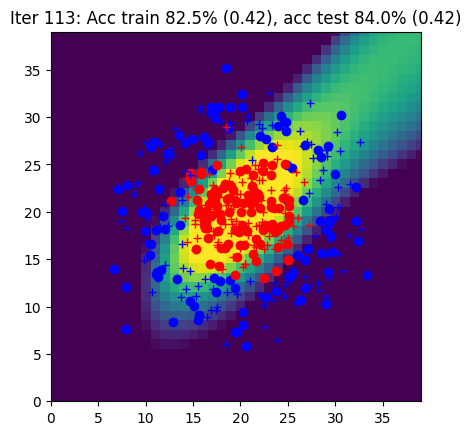

Iter 114: Acc train 83.0% (0.41), acc test 83.5% (0.41)


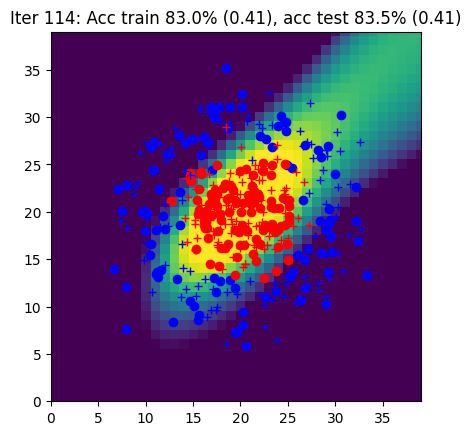

Iter 115: Acc train 84.0% (0.41), acc test 83.5% (0.41)


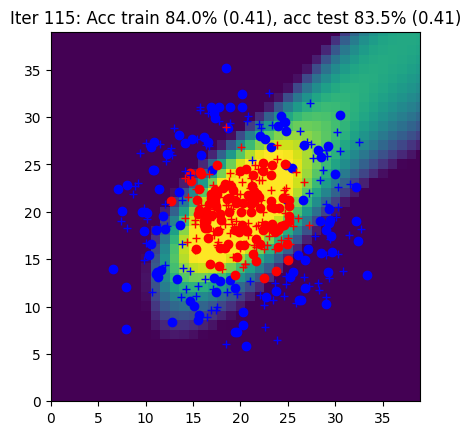

Iter 116: Acc train 83.5% (0.40), acc test 84.0% (0.40)


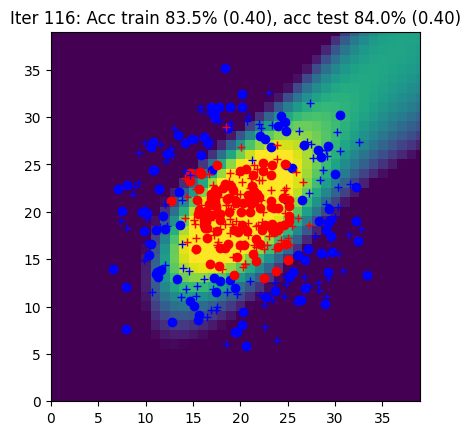

Iter 117: Acc train 83.0% (0.40), acc test 85.0% (0.40)


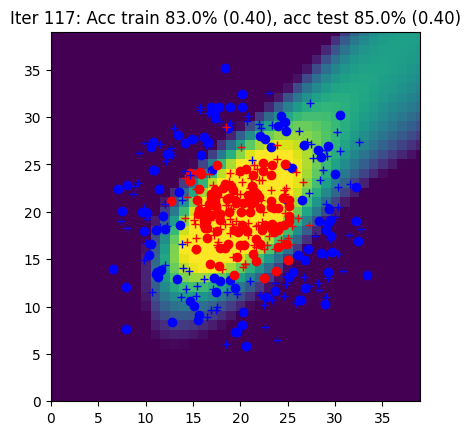

Iter 118: Acc train 84.5% (0.39), acc test 85.0% (0.39)


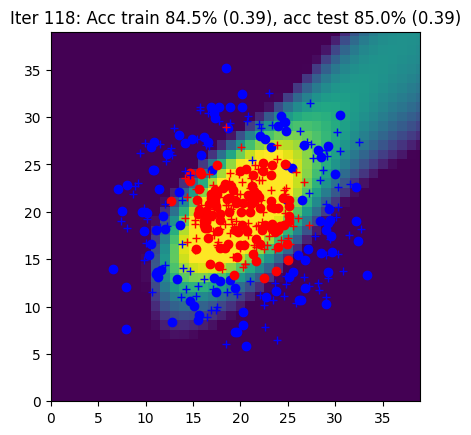

Iter 119: Acc train 84.5% (0.39), acc test 86.5% (0.39)


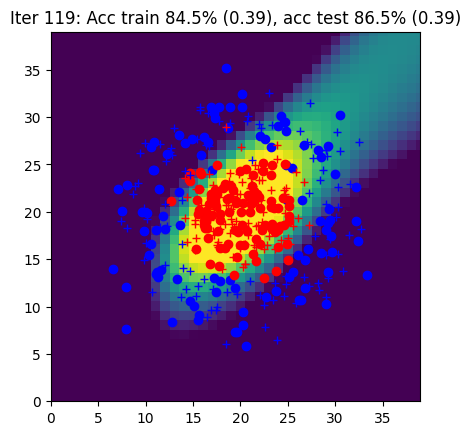

Iter 120: Acc train 84.5% (0.38), acc test 87.5% (0.38)


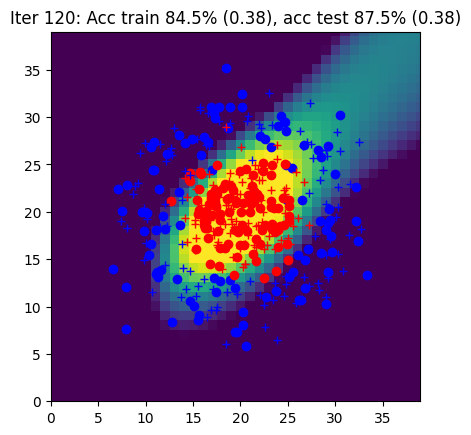

Iter 121: Acc train 84.5% (0.38), acc test 88.0% (0.38)


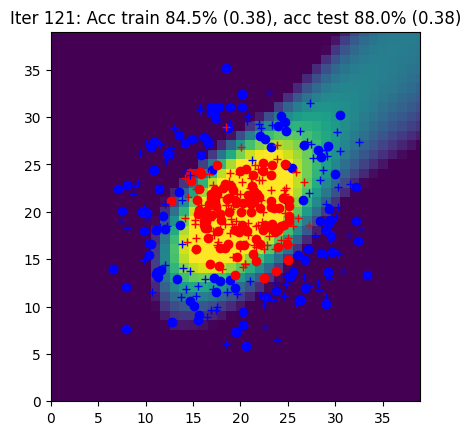

Iter 122: Acc train 85.0% (0.37), acc test 88.5% (0.37)


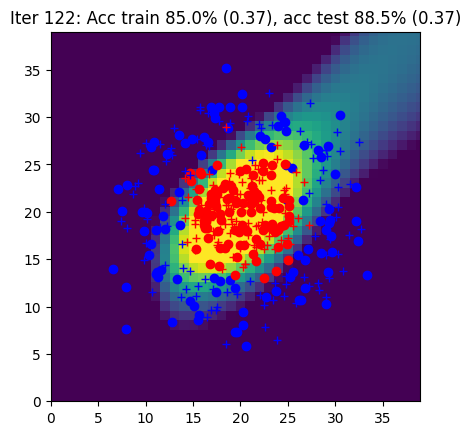

Iter 123: Acc train 86.5% (0.37), acc test 88.5% (0.37)


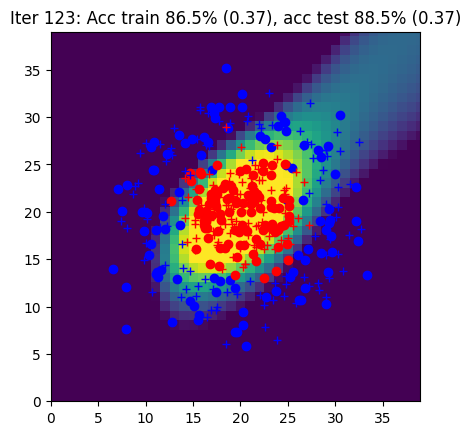

Iter 124: Acc train 87.5% (0.36), acc test 91.5% (0.36)


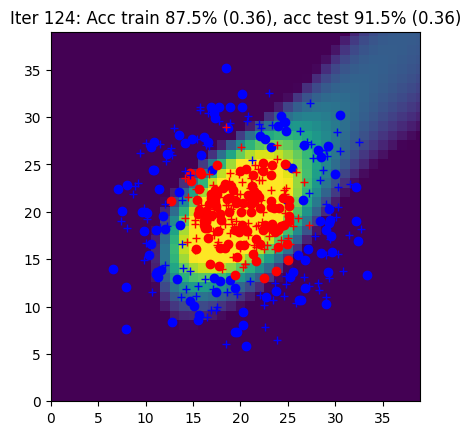

Iter 125: Acc train 87.5% (0.36), acc test 92.0% (0.36)


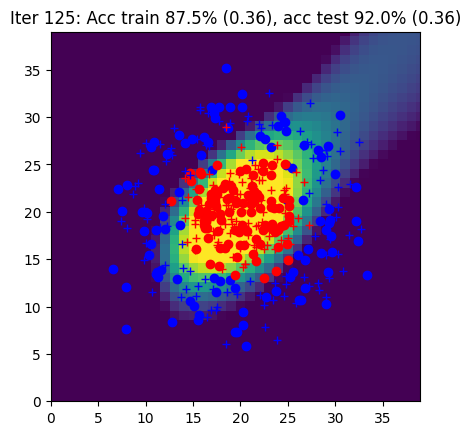

Iter 126: Acc train 89.5% (0.35), acc test 92.0% (0.36)


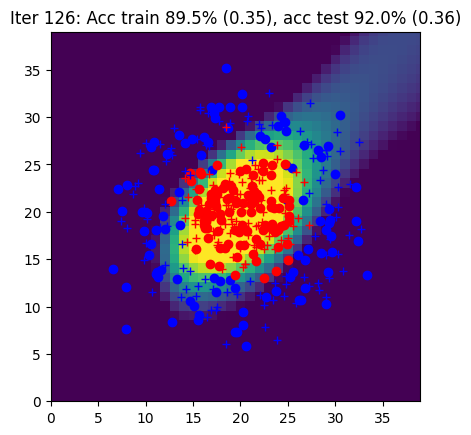

Iter 127: Acc train 89.5% (0.35), acc test 92.5% (0.35)


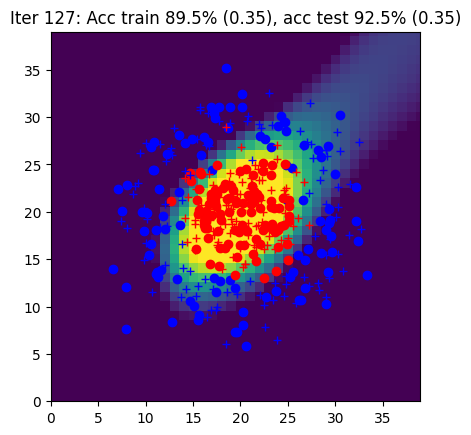

Iter 128: Acc train 90.0% (0.34), acc test 93.0% (0.35)


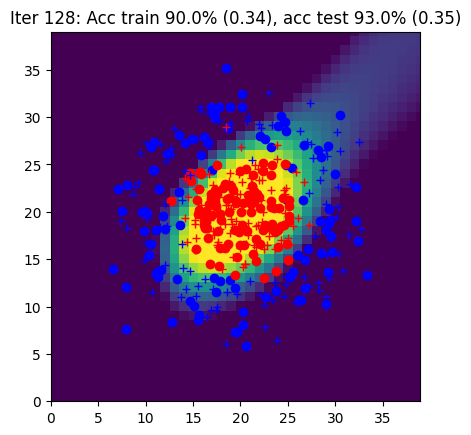

Iter 129: Acc train 90.0% (0.34), acc test 94.0% (0.34)


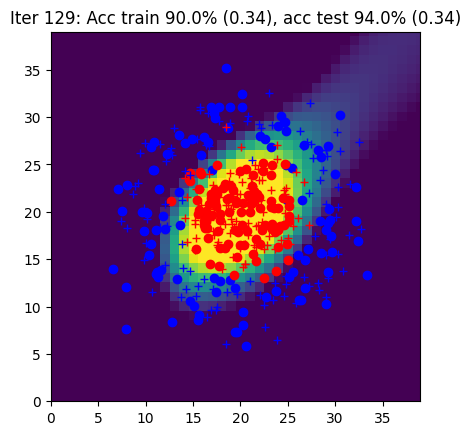

Iter 130: Acc train 90.5% (0.33), acc test 95.0% (0.34)


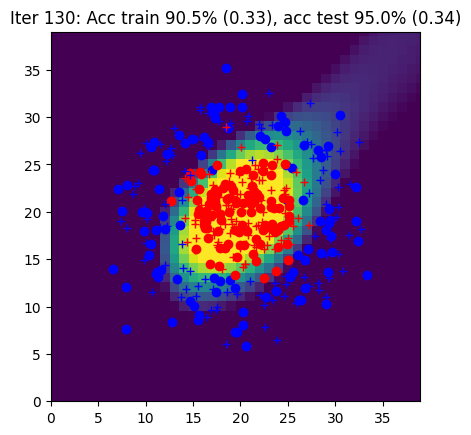

Iter 131: Acc train 90.5% (0.33), acc test 94.5% (0.33)


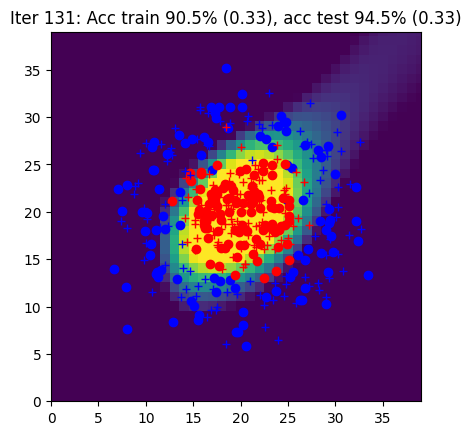

Iter 132: Acc train 90.5% (0.32), acc test 95.5% (0.33)


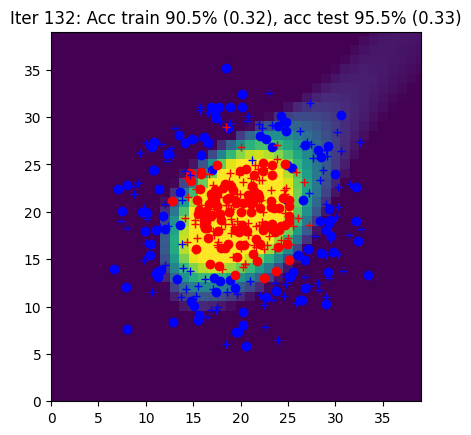

Iter 133: Acc train 90.5% (0.32), acc test 95.5% (0.32)


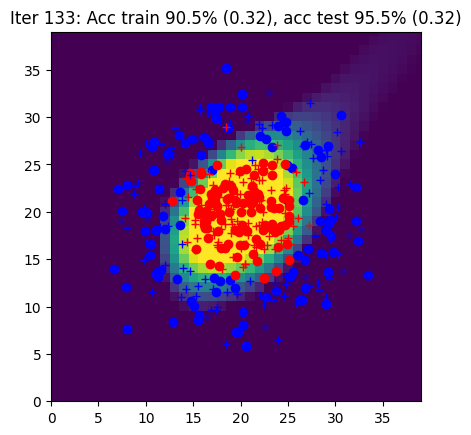

Iter 134: Acc train 90.5% (0.32), acc test 96.0% (0.32)


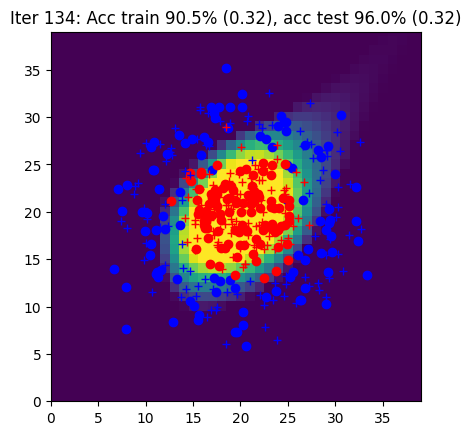

Iter 135: Acc train 91.0% (0.31), acc test 95.5% (0.32)


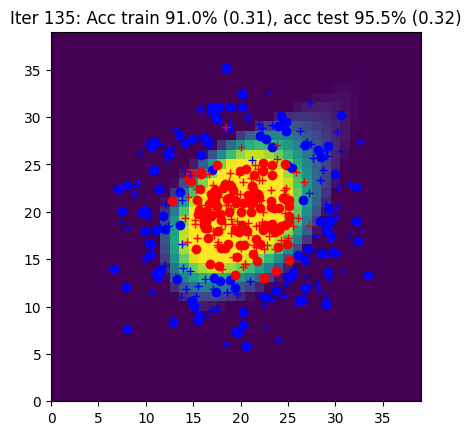

Iter 136: Acc train 91.0% (0.31), acc test 95.5% (0.31)


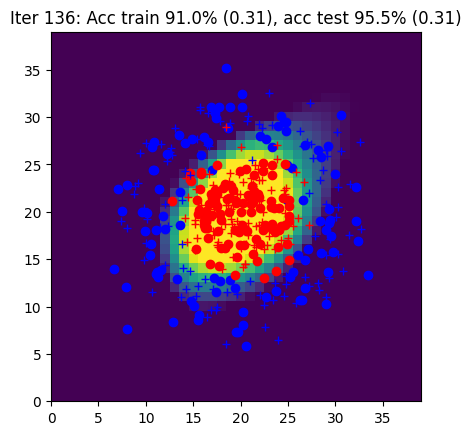

Iter 137: Acc train 91.5% (0.30), acc test 95.5% (0.31)


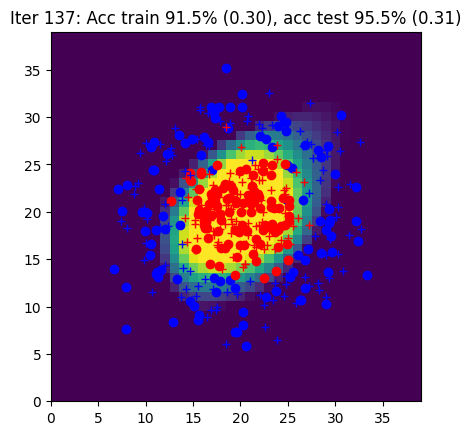

Iter 138: Acc train 91.5% (0.30), acc test 95.5% (0.30)


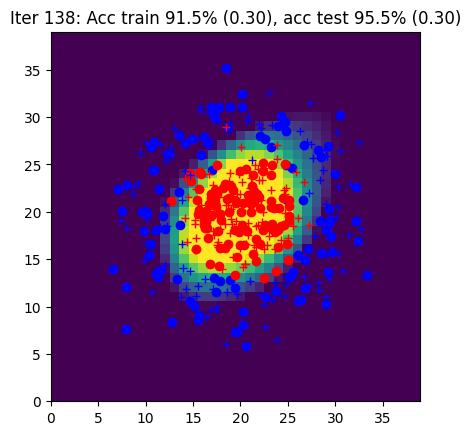

Iter 139: Acc train 92.0% (0.30), acc test 95.0% (0.30)


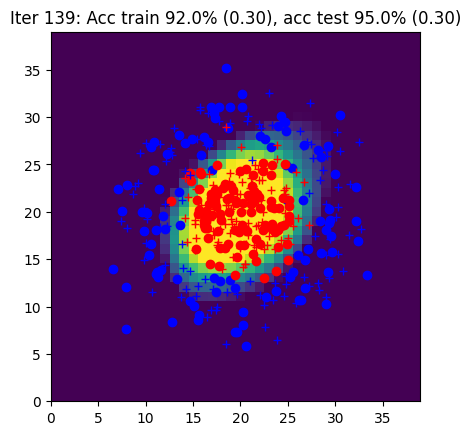

Iter 140: Acc train 91.5% (0.29), acc test 95.0% (0.30)


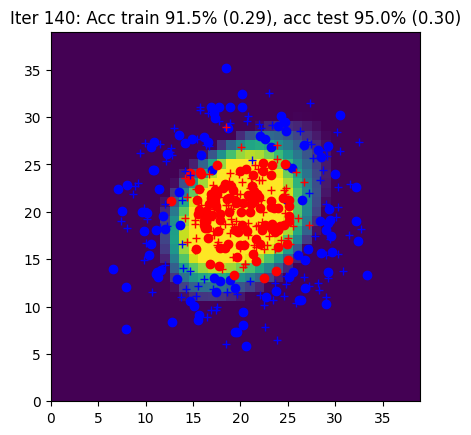

Iter 141: Acc train 92.0% (0.29), acc test 95.5% (0.29)


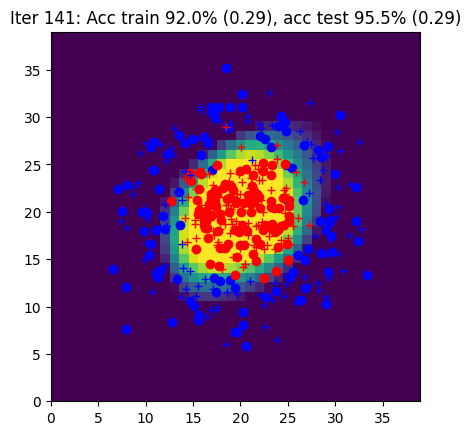

Iter 142: Acc train 92.0% (0.29), acc test 94.5% (0.29)


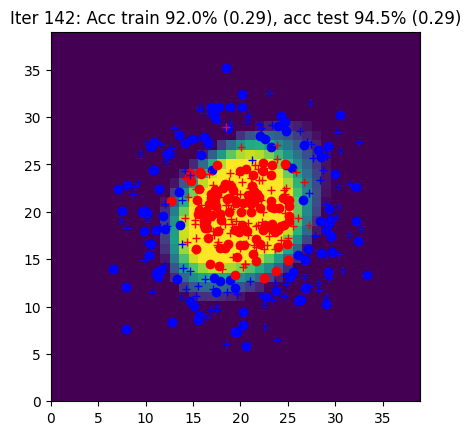

Iter 143: Acc train 92.0% (0.28), acc test 94.5% (0.29)


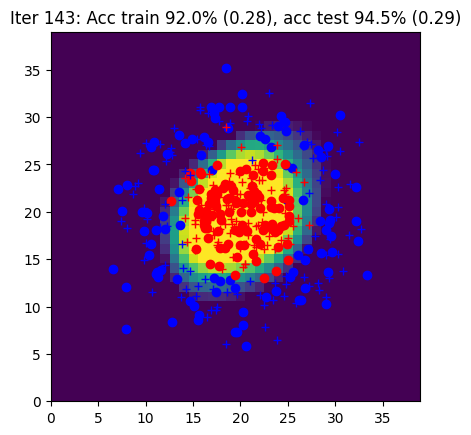

Iter 144: Acc train 92.0% (0.28), acc test 94.5% (0.28)


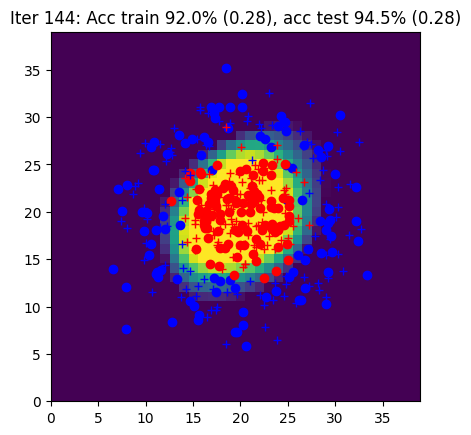

Iter 145: Acc train 93.0% (0.28), acc test 95.0% (0.28)


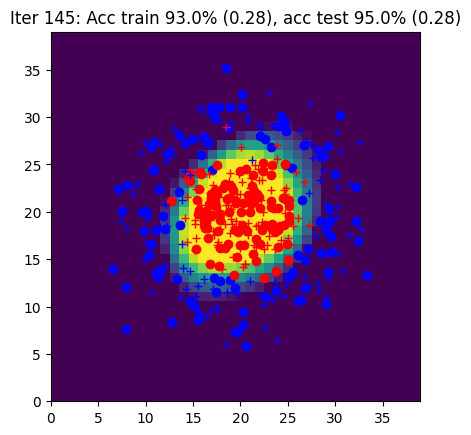

Iter 146: Acc train 93.5% (0.27), acc test 95.0% (0.28)


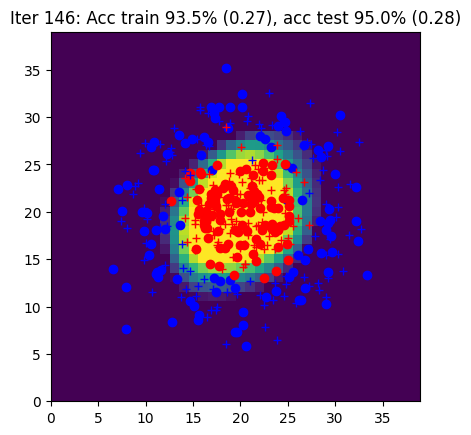

Iter 147: Acc train 94.0% (0.27), acc test 95.5% (0.28)


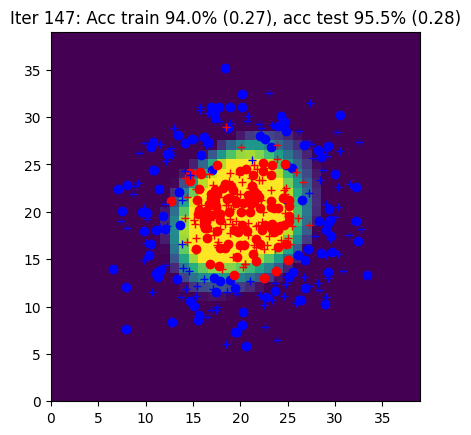

Iter 148: Acc train 94.0% (0.27), acc test 95.0% (0.27)


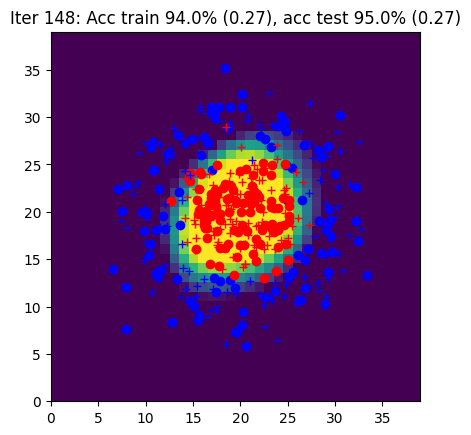

Iter 149: Acc train 93.5% (0.26), acc test 95.0% (0.27)


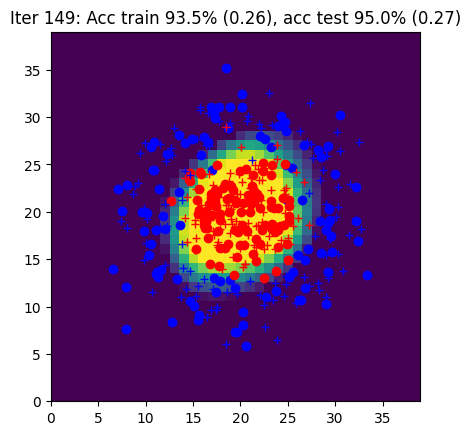

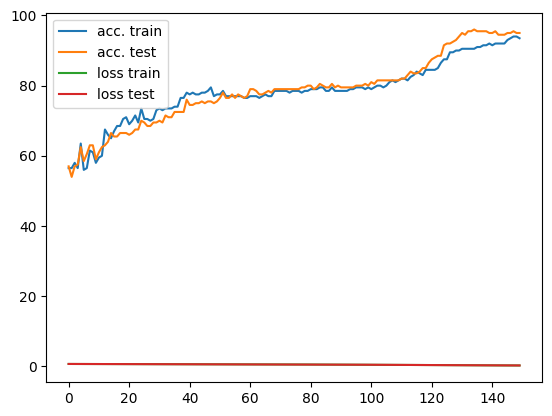

In [ ]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

params = init_params_autograd(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: forward, loss_accuracy, sgd
        # and the backward function with autograd
        Yhat, outputs = forward(params, X)
        L, acc = loss_accuracy(Yhat, Y)
        L.backward() # Perform backward pass on the loss tensor
        params = sgd_autograd(params, eta)

    ####################
    ##      END        #
    ####################


    Yhat_train, _ = forward(params, data.Xtrain)
    Yhat_test, _ = forward(params, data.Xtest)
    Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(Yhat_test.detach(), data.Ytest)
    Ygrid, _ = forward(params, data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(Ygrid.detach(), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain.item()) # Convert to float for plotting
    curves[3].append(Ltest.item()) # Convert to float for plotting

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 3 : Simplification of the forward pass with `torch.nn`

`init_params` and `forward` are replaced by the `init_model` function which defines the network architecture and the loss.

In [ ]:
def init_model(nx, nh, ny):
    model = torch.nn.Sequential(
        torch.nn.Linear(nx, nh),
        torch.nn.Tanh(),
        torch.nn.Linear(nh, ny)
    )
    loss = torch.nn.CrossEntropyLoss()
    return model, loss

In [ ]:
def loss_accuracy(loss_fn, Yhat, Y):
    targets = Y.argmax(1)
    L = loss_fn(Yhat, targets)
    acc = (Yhat.argmax(1) == targets).float().mean()*100.0
    return L.item(), acc.item()

In [ ]:
def sgd(model, eta):
    with torch.no_grad():
        for p in model.parameters():
            p -= eta * p.grad
            p.grad.zero_()
    return model

## Global learning procedure with autograd and `torch.nn`

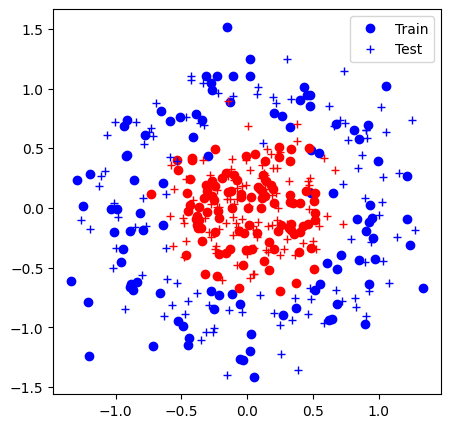

Iter 0: Acc train 50.0% (0.68), acc test 50.0% (0.69)


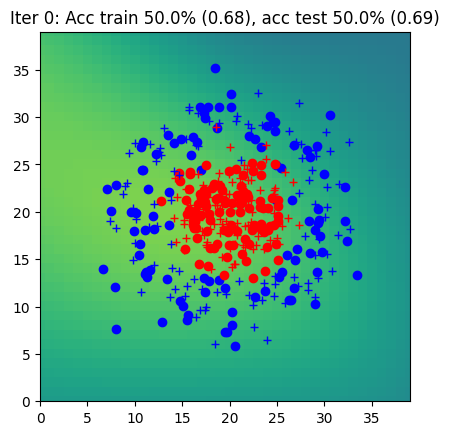

Iter 1: Acc train 55.0% (0.67), acc test 56.0% (0.67)


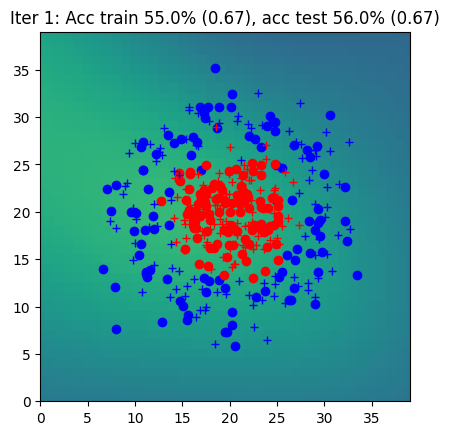

Iter 2: Acc train 59.0% (0.67), acc test 59.5% (0.67)


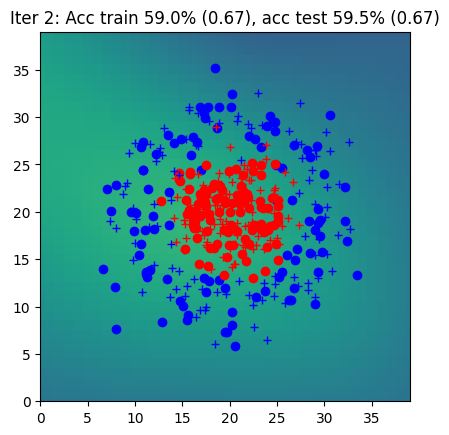

Iter 3: Acc train 66.0% (0.67), acc test 66.0% (0.67)


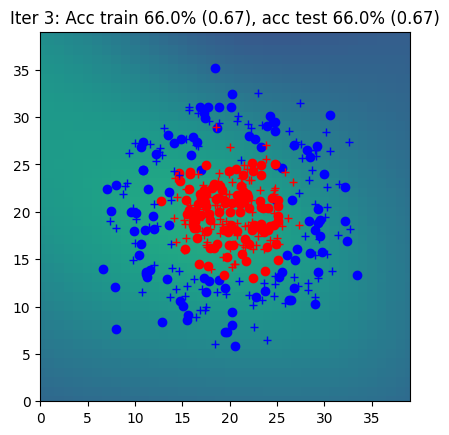

Iter 4: Acc train 66.0% (0.67), acc test 65.5% (0.67)


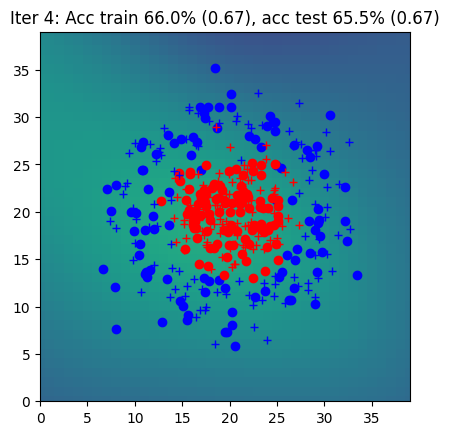

Iter 5: Acc train 64.5% (0.66), acc test 63.5% (0.67)


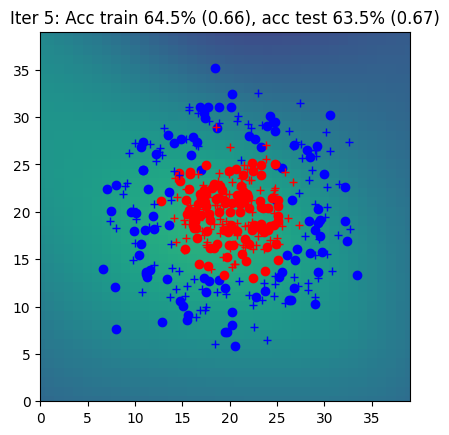

Iter 6: Acc train 65.0% (0.66), acc test 65.5% (0.66)


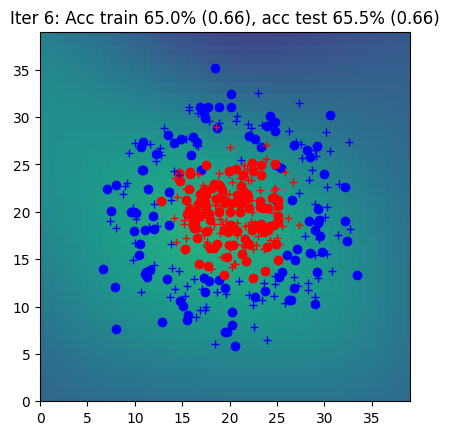

Iter 7: Acc train 70.5% (0.66), acc test 67.0% (0.66)


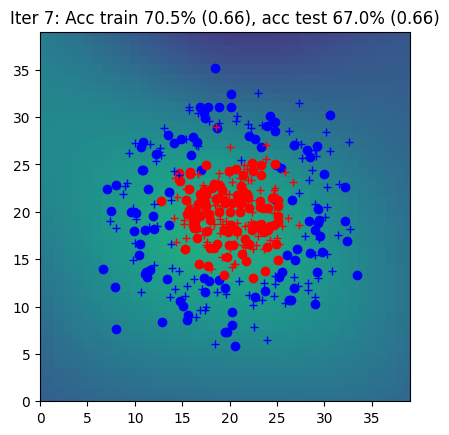

Iter 8: Acc train 71.0% (0.66), acc test 67.0% (0.66)


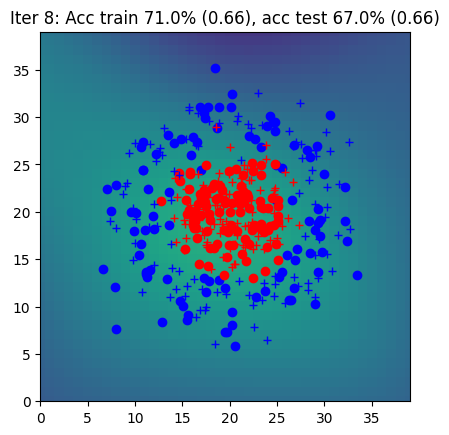

Iter 9: Acc train 70.5% (0.65), acc test 67.5% (0.66)


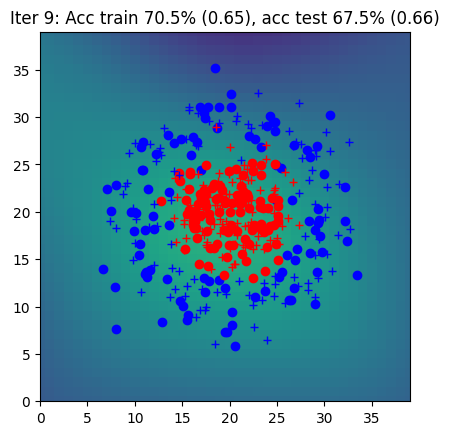

Iter 10: Acc train 71.0% (0.65), acc test 68.0% (0.66)


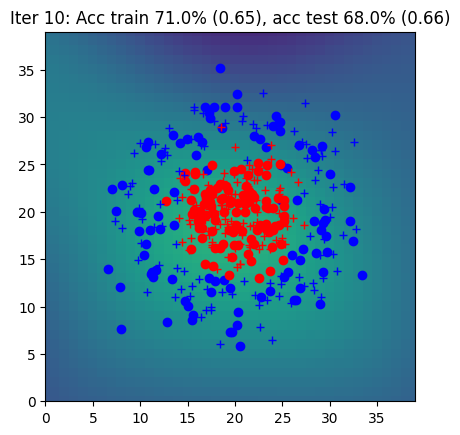

Iter 11: Acc train 69.0% (0.65), acc test 66.0% (0.65)


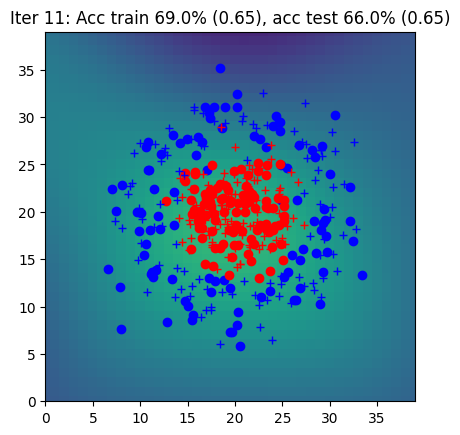

Iter 12: Acc train 72.0% (0.65), acc test 68.5% (0.65)


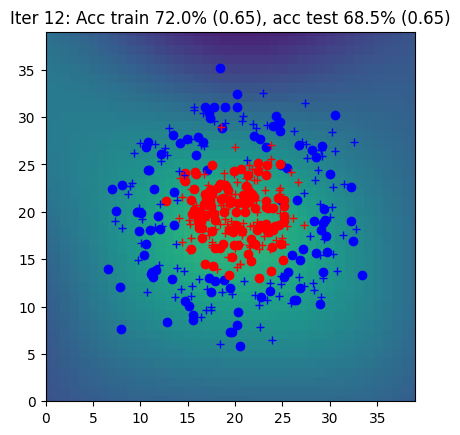

Iter 13: Acc train 69.5% (0.65), acc test 66.5% (0.65)


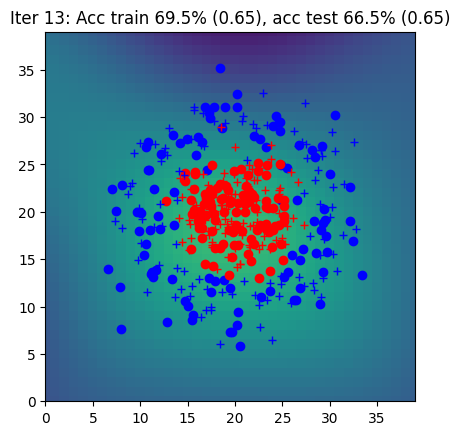

Iter 14: Acc train 70.0% (0.64), acc test 67.5% (0.65)


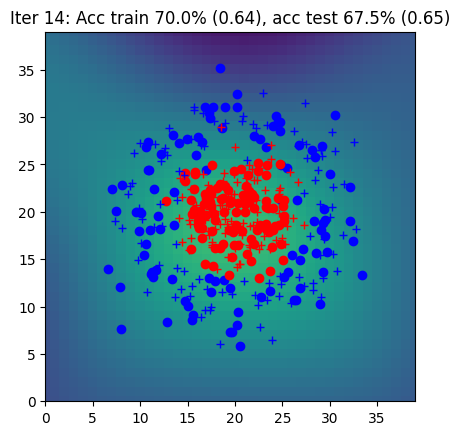

Iter 15: Acc train 72.5% (0.64), acc test 68.5% (0.64)


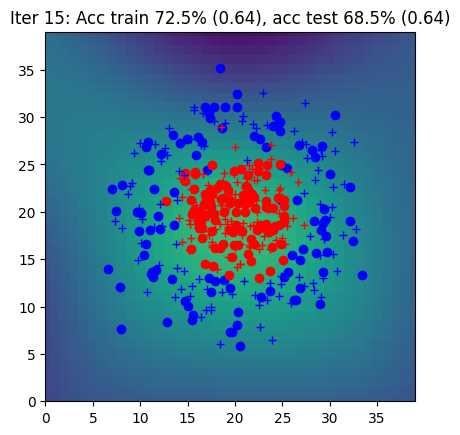

Iter 16: Acc train 75.5% (0.64), acc test 75.0% (0.64)


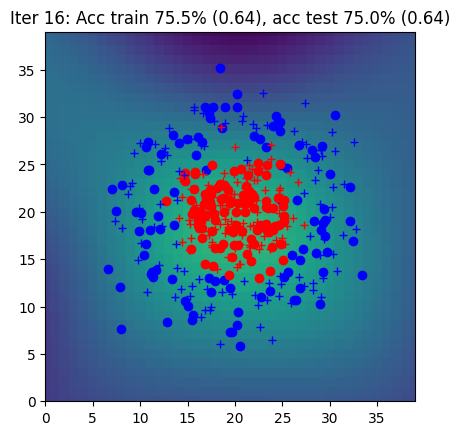

Iter 17: Acc train 77.5% (0.63), acc test 76.5% (0.64)


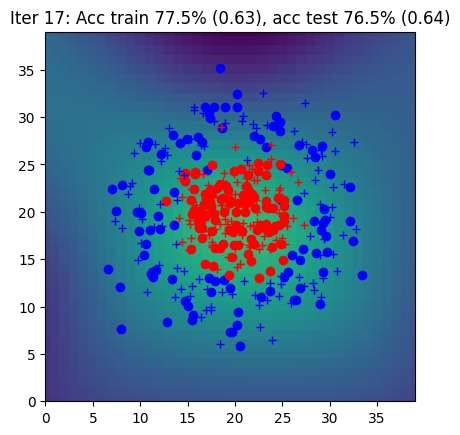

Iter 18: Acc train 75.5% (0.63), acc test 73.0% (0.64)


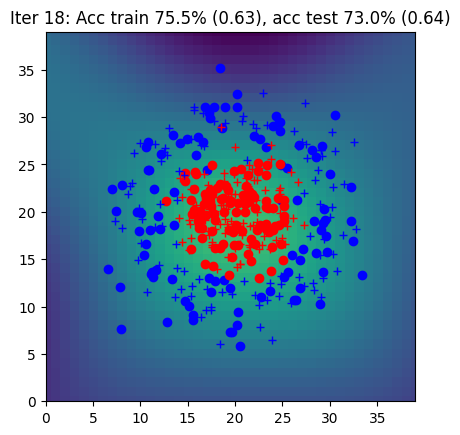

Iter 19: Acc train 81.5% (0.63), acc test 78.5% (0.63)


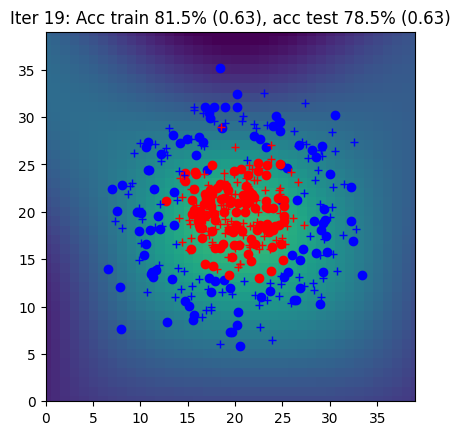

Iter 20: Acc train 82.5% (0.62), acc test 80.0% (0.63)


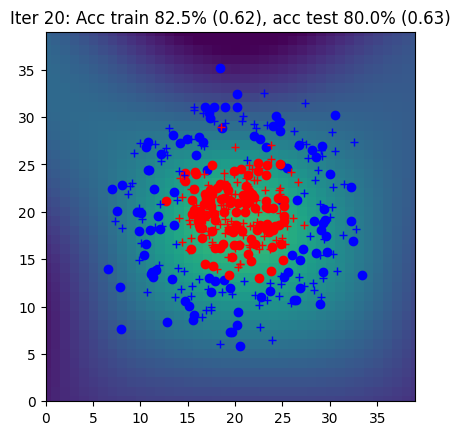

Iter 21: Acc train 84.0% (0.62), acc test 83.0% (0.63)


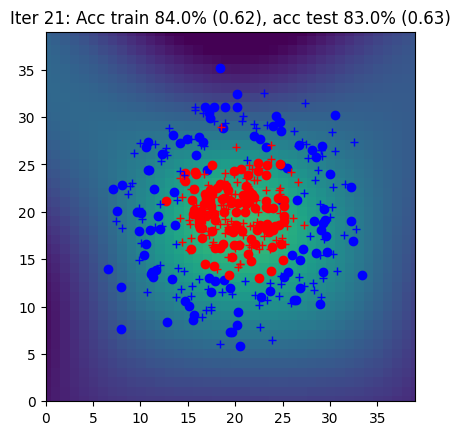

Iter 22: Acc train 84.0% (0.62), acc test 83.0% (0.62)


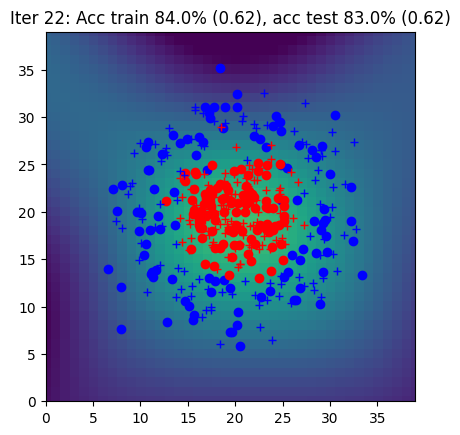

Iter 23: Acc train 82.0% (0.61), acc test 79.0% (0.62)


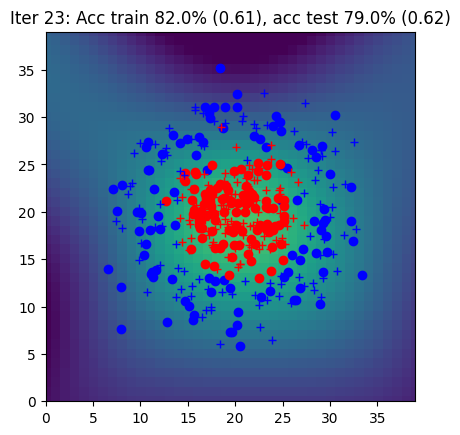

Iter 24: Acc train 85.0% (0.61), acc test 84.0% (0.62)


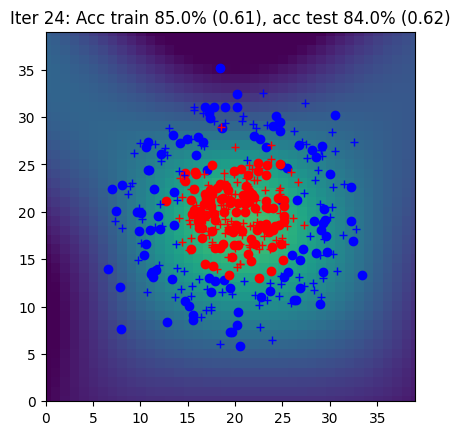

Iter 25: Acc train 81.5% (0.61), acc test 78.5% (0.61)


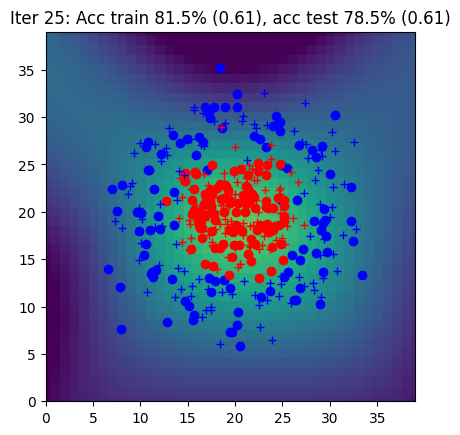

Iter 26: Acc train 83.0% (0.60), acc test 81.0% (0.61)


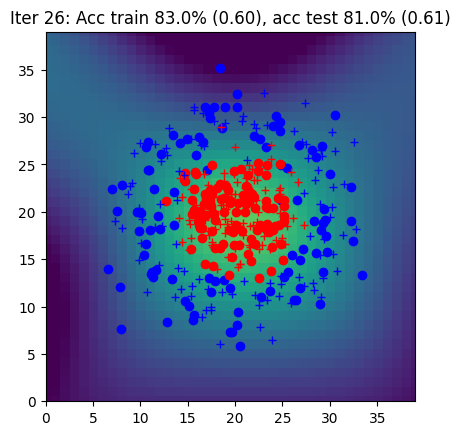

Iter 27: Acc train 83.5% (0.60), acc test 81.5% (0.60)


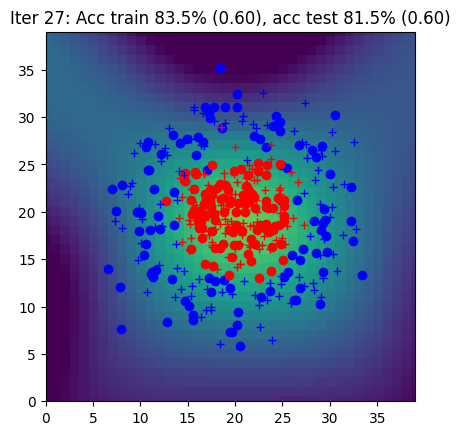

Iter 28: Acc train 84.5% (0.59), acc test 83.5% (0.60)


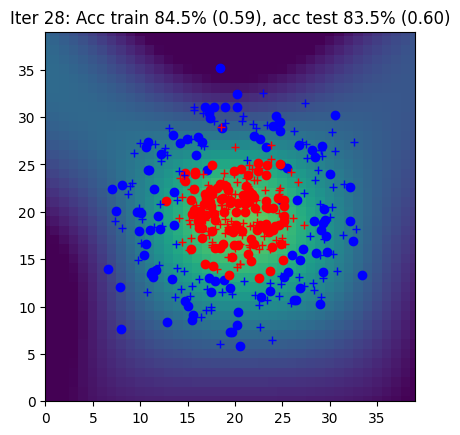

Iter 29: Acc train 85.0% (0.59), acc test 84.5% (0.60)


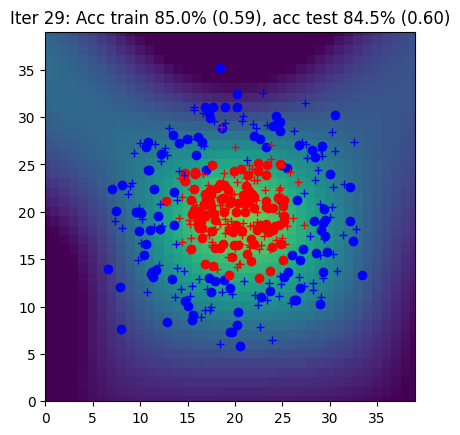

Iter 30: Acc train 83.5% (0.59), acc test 82.0% (0.59)


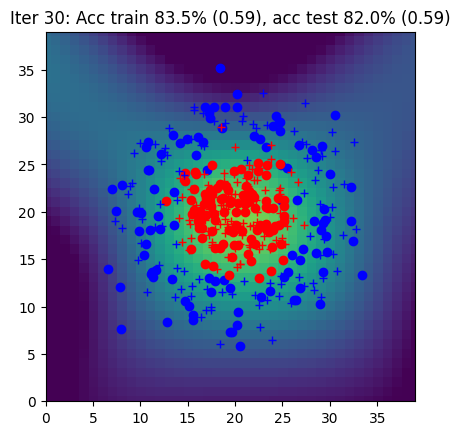

Iter 31: Acc train 85.0% (0.58), acc test 84.5% (0.59)


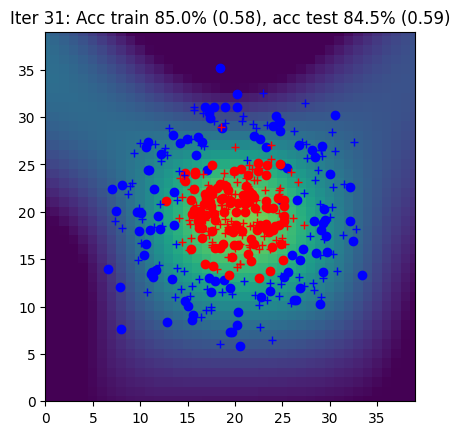

Iter 32: Acc train 90.0% (0.58), acc test 89.5% (0.58)


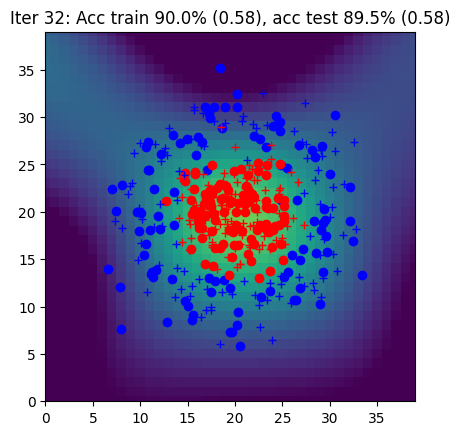

Iter 33: Acc train 87.0% (0.57), acc test 86.5% (0.58)


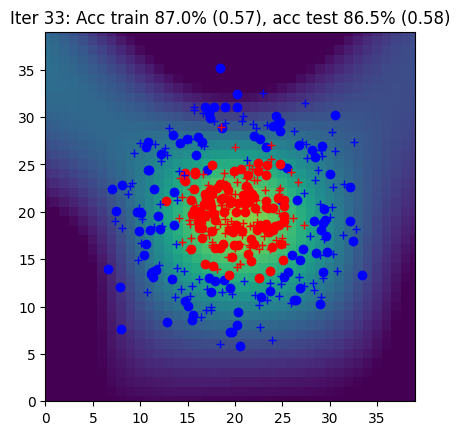

Iter 34: Acc train 87.0% (0.57), acc test 86.5% (0.57)


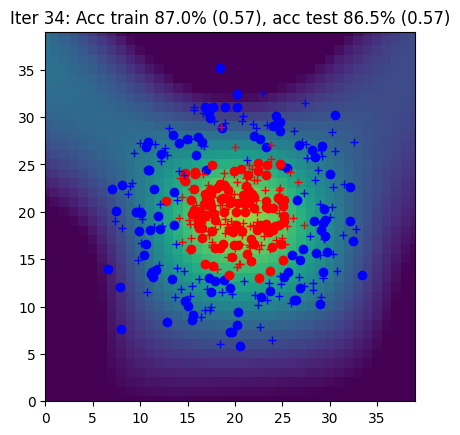

Iter 35: Acc train 87.0% (0.56), acc test 87.0% (0.57)


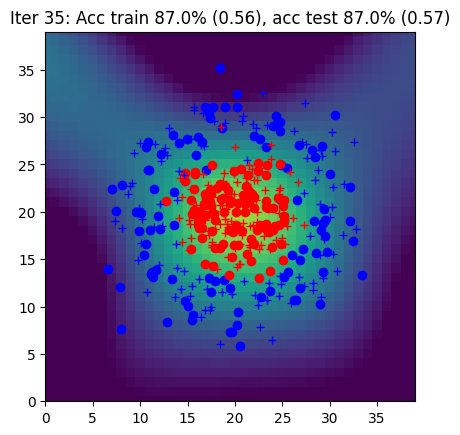

Iter 36: Acc train 87.0% (0.56), acc test 87.0% (0.56)


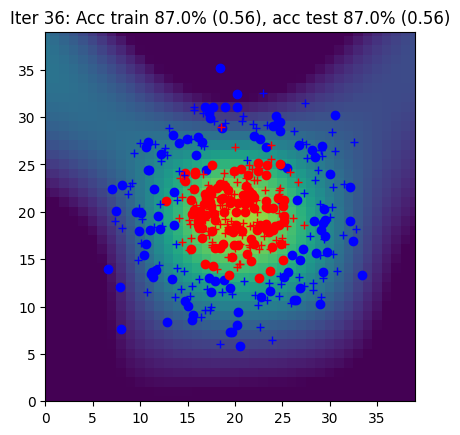

Iter 37: Acc train 88.0% (0.55), acc test 87.5% (0.56)


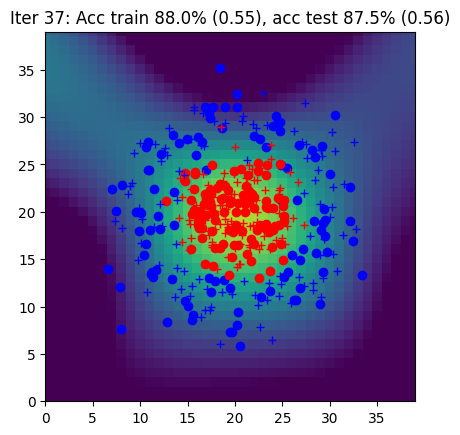

Iter 38: Acc train 91.0% (0.54), acc test 89.5% (0.55)


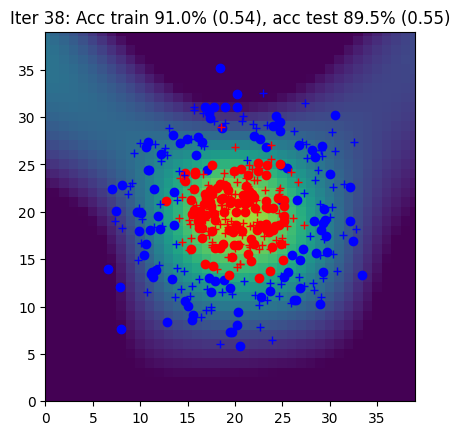

Iter 39: Acc train 87.5% (0.54), acc test 87.5% (0.55)


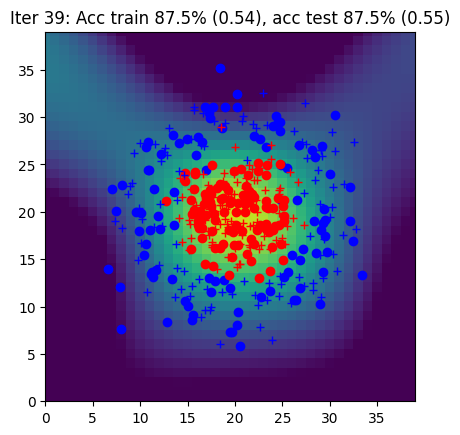

Iter 40: Acc train 91.0% (0.53), acc test 92.0% (0.54)


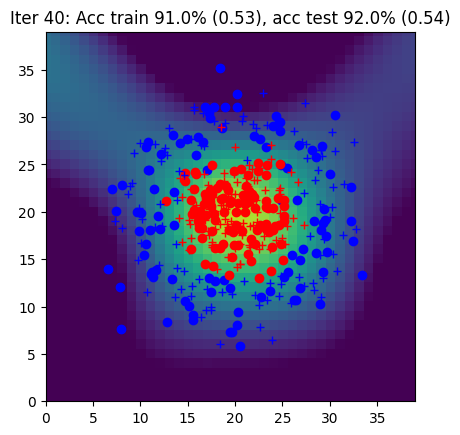

Iter 41: Acc train 91.0% (0.53), acc test 92.0% (0.54)


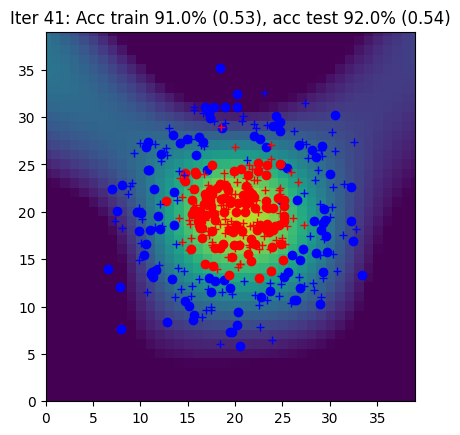

Iter 42: Acc train 91.0% (0.52), acc test 92.0% (0.53)


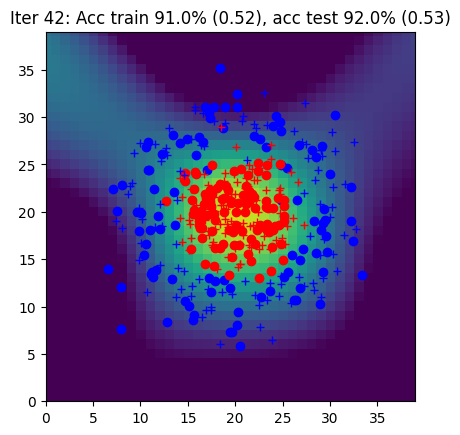

Iter 43: Acc train 91.0% (0.52), acc test 91.0% (0.53)


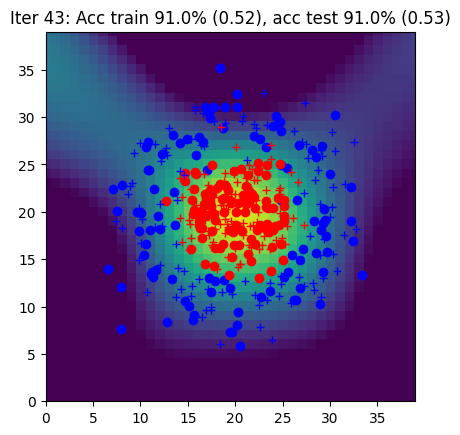

Iter 44: Acc train 91.5% (0.51), acc test 92.5% (0.52)


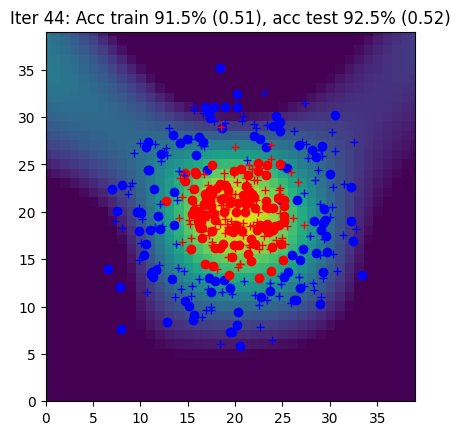

Iter 45: Acc train 91.5% (0.51), acc test 93.0% (0.52)


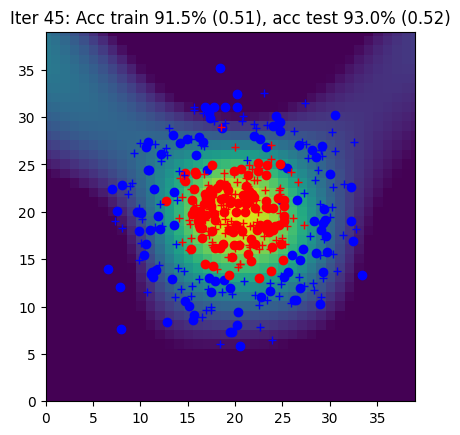

Iter 46: Acc train 91.5% (0.50), acc test 93.0% (0.51)


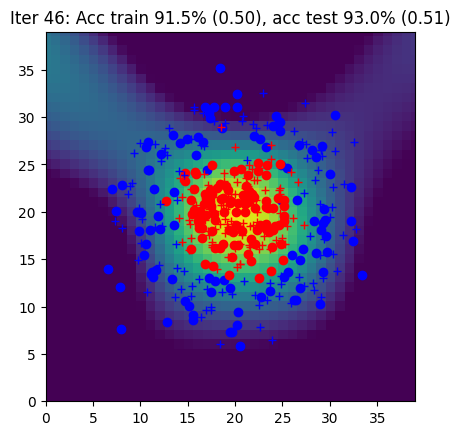

Iter 47: Acc train 93.0% (0.49), acc test 95.0% (0.50)


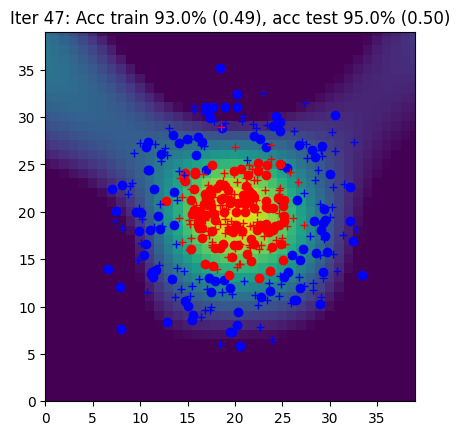

Iter 48: Acc train 92.0% (0.49), acc test 93.0% (0.50)


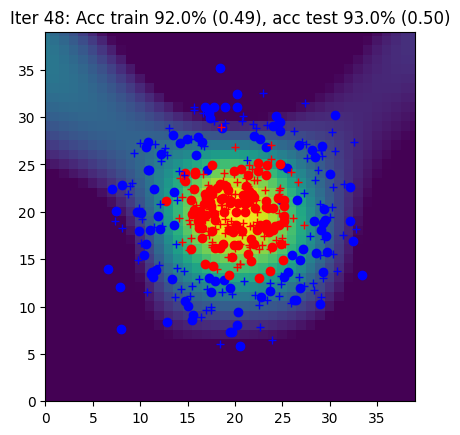

Iter 49: Acc train 93.0% (0.48), acc test 95.0% (0.49)


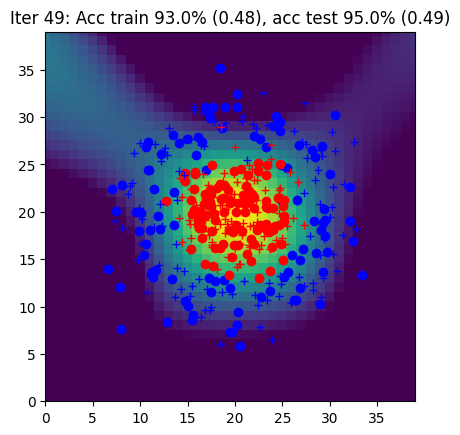

Iter 50: Acc train 92.0% (0.48), acc test 93.0% (0.49)


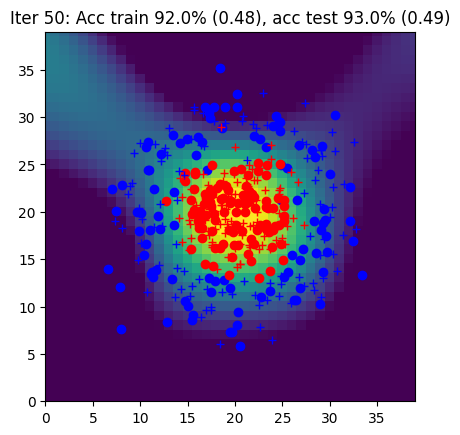

Iter 51: Acc train 92.0% (0.47), acc test 93.0% (0.48)


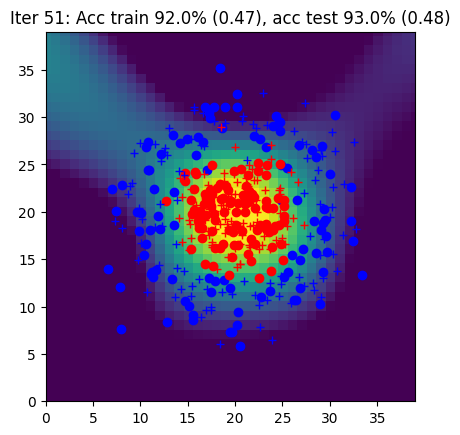

Iter 52: Acc train 94.0% (0.46), acc test 95.0% (0.48)


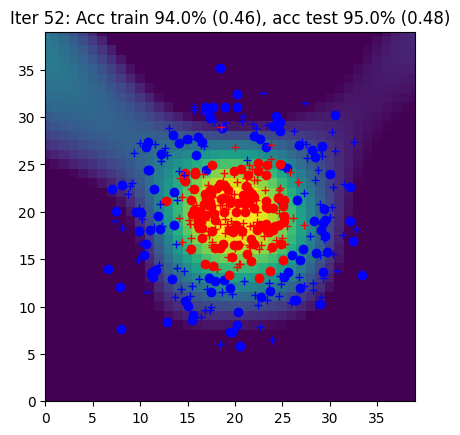

Iter 53: Acc train 92.5% (0.46), acc test 94.0% (0.47)


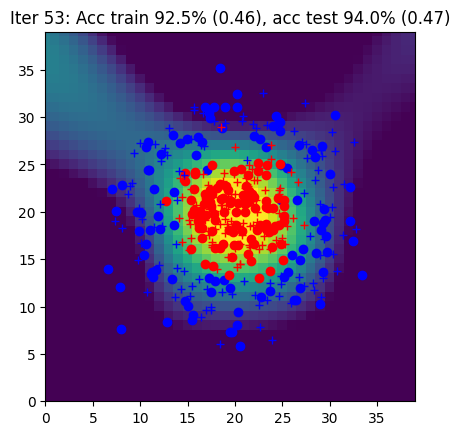

Iter 54: Acc train 93.5% (0.45), acc test 94.5% (0.46)


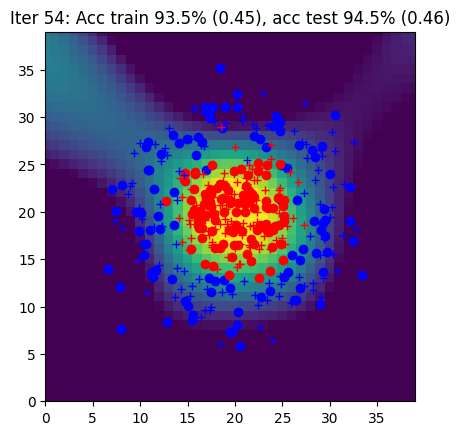

Iter 55: Acc train 93.0% (0.45), acc test 95.0% (0.46)


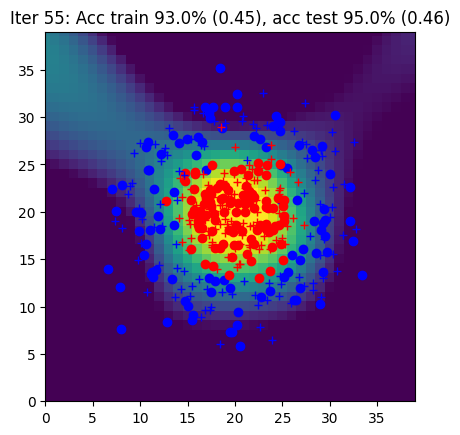

Iter 56: Acc train 93.0% (0.44), acc test 94.5% (0.45)


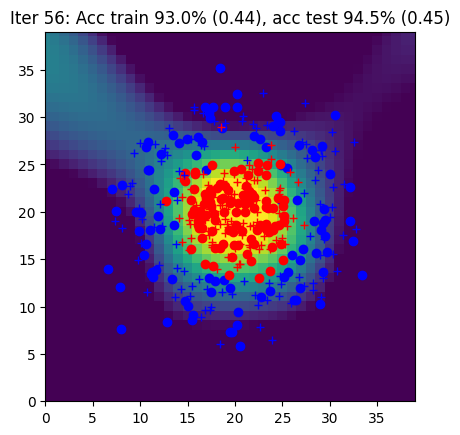

Iter 57: Acc train 94.5% (0.43), acc test 94.0% (0.45)


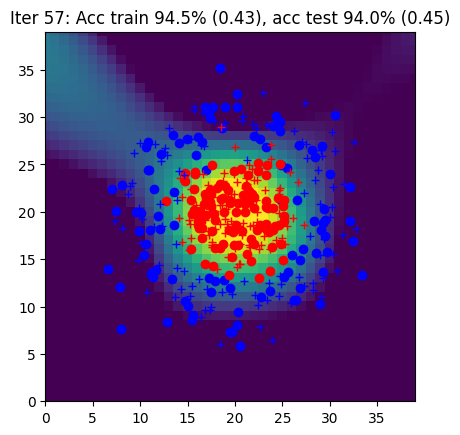

Iter 58: Acc train 94.0% (0.43), acc test 94.0% (0.44)


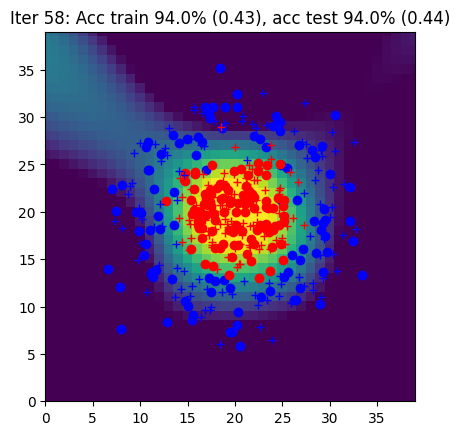

Iter 59: Acc train 94.0% (0.42), acc test 94.0% (0.44)


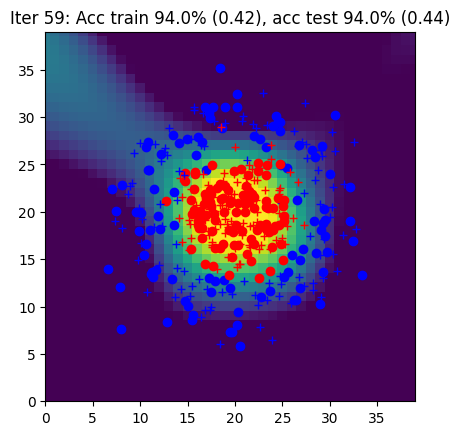

Iter 60: Acc train 92.5% (0.42), acc test 94.0% (0.43)


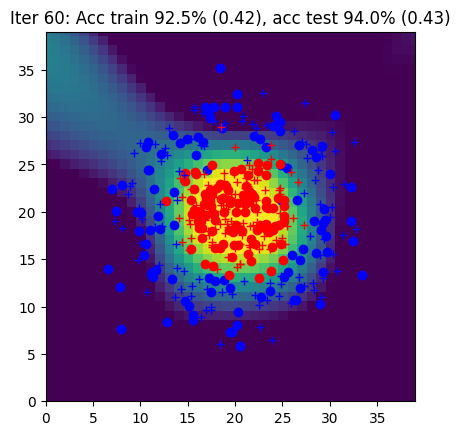

Iter 61: Acc train 94.0% (0.41), acc test 94.0% (0.42)


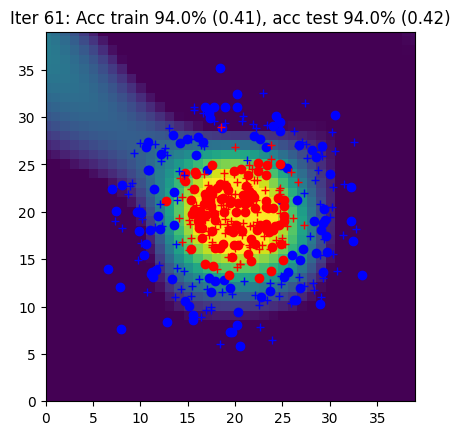

Iter 62: Acc train 94.5% (0.41), acc test 94.5% (0.42)


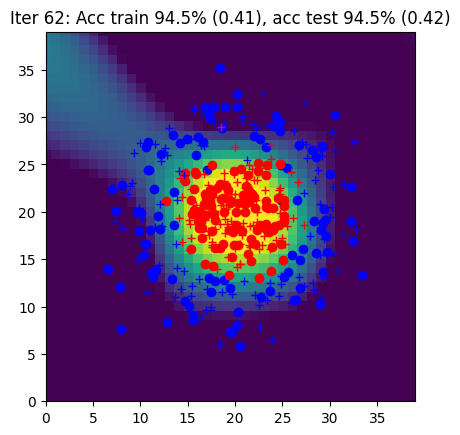

Iter 63: Acc train 94.5% (0.40), acc test 94.5% (0.41)


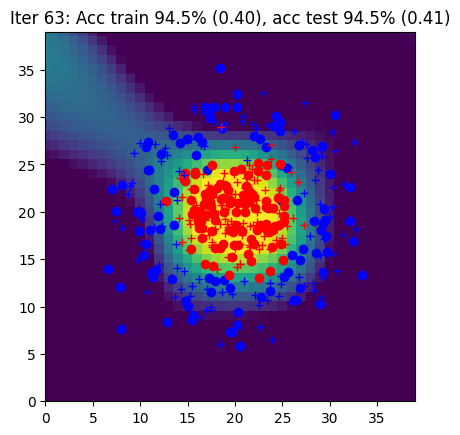

Iter 64: Acc train 93.5% (0.40), acc test 94.0% (0.41)


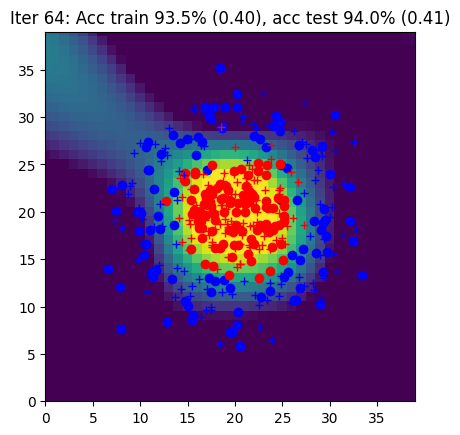

Iter 65: Acc train 95.0% (0.39), acc test 94.5% (0.40)


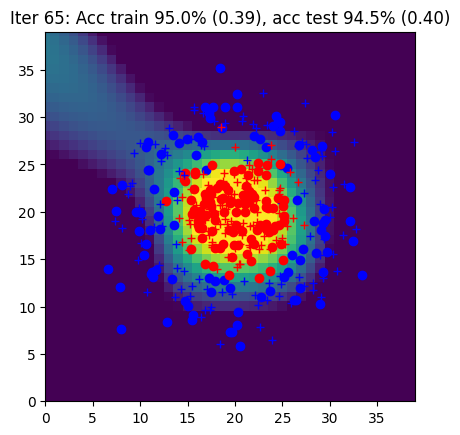

Iter 66: Acc train 95.0% (0.38), acc test 93.5% (0.40)


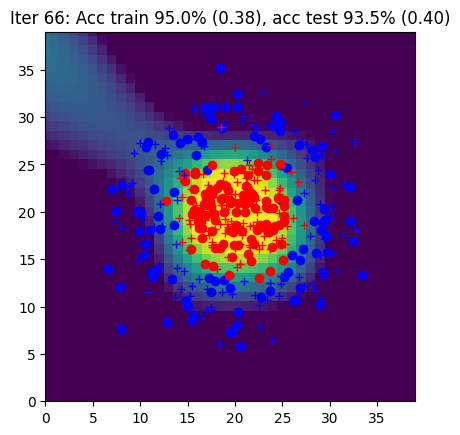

Iter 67: Acc train 95.0% (0.38), acc test 94.5% (0.39)


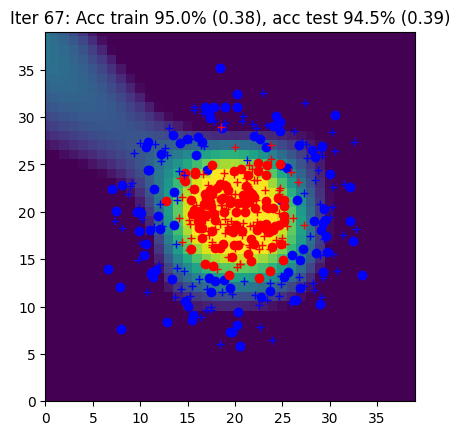

Iter 68: Acc train 94.5% (0.37), acc test 93.5% (0.39)


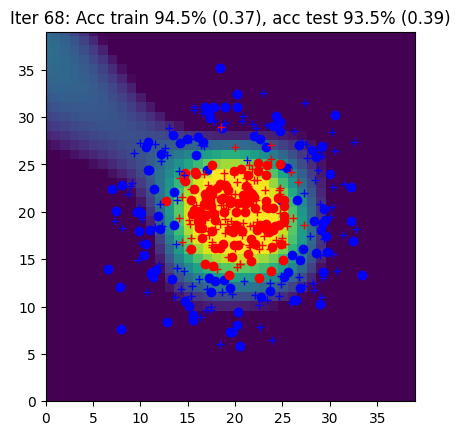

Iter 69: Acc train 96.0% (0.37), acc test 94.0% (0.38)


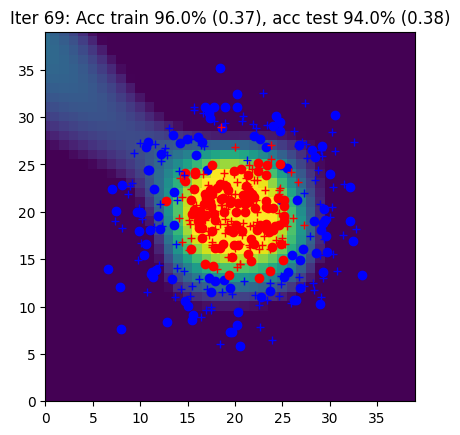

Iter 70: Acc train 96.0% (0.36), acc test 94.0% (0.38)


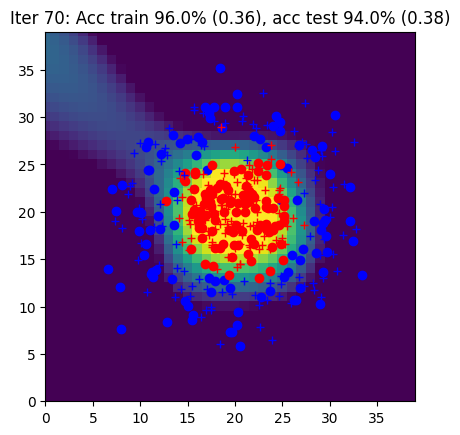

Iter 71: Acc train 95.0% (0.36), acc test 94.5% (0.37)


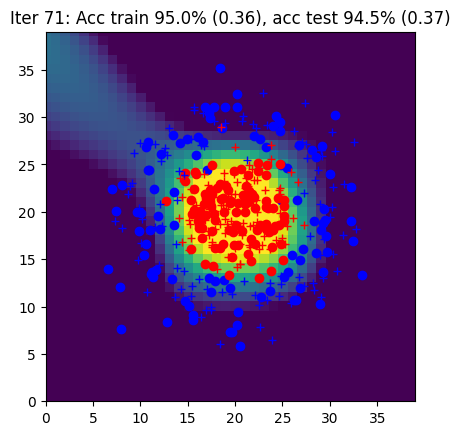

Iter 72: Acc train 94.5% (0.35), acc test 93.5% (0.37)


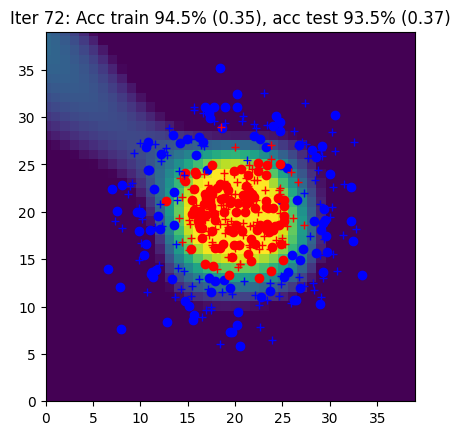

Iter 73: Acc train 96.0% (0.35), acc test 94.0% (0.36)


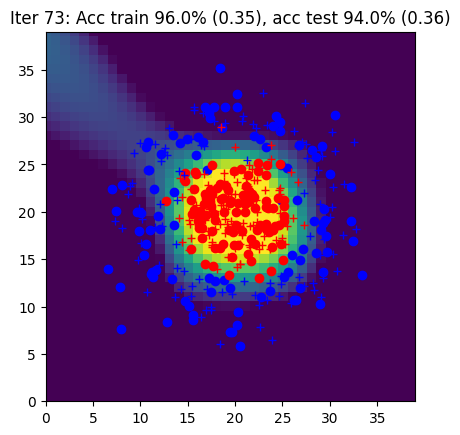

Iter 74: Acc train 96.0% (0.35), acc test 94.0% (0.36)


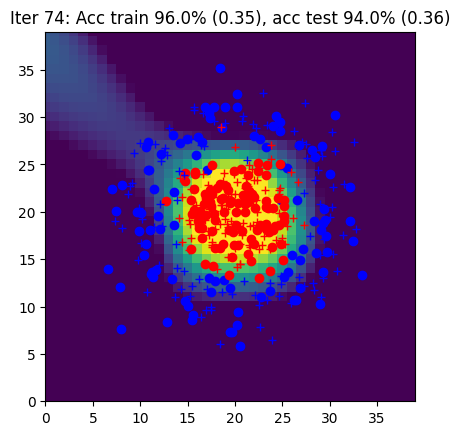

Iter 75: Acc train 96.0% (0.34), acc test 94.0% (0.36)


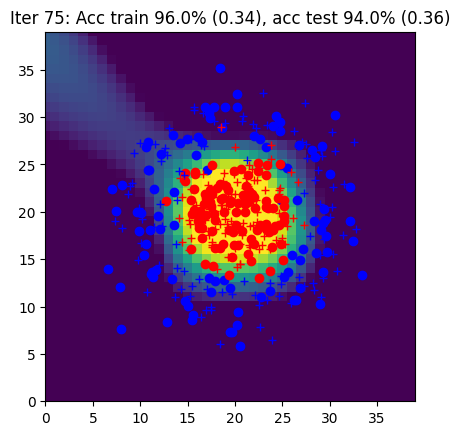

Iter 76: Acc train 95.0% (0.34), acc test 94.0% (0.35)


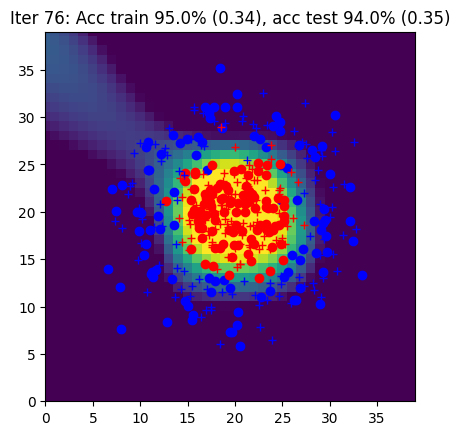

Iter 77: Acc train 94.5% (0.33), acc test 93.5% (0.35)


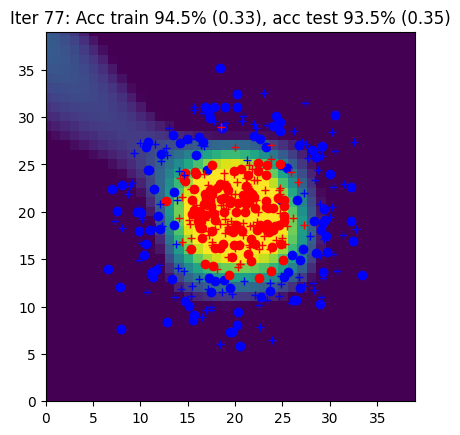

Iter 78: Acc train 96.0% (0.33), acc test 94.0% (0.34)


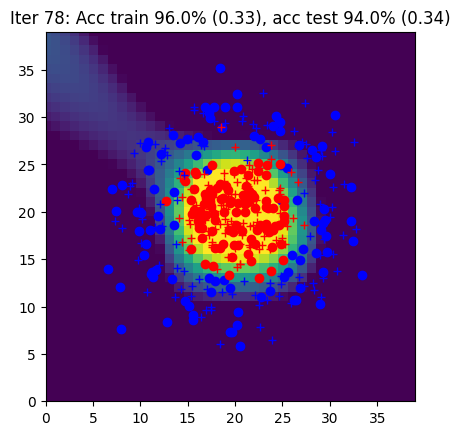

Iter 79: Acc train 96.0% (0.33), acc test 94.0% (0.34)


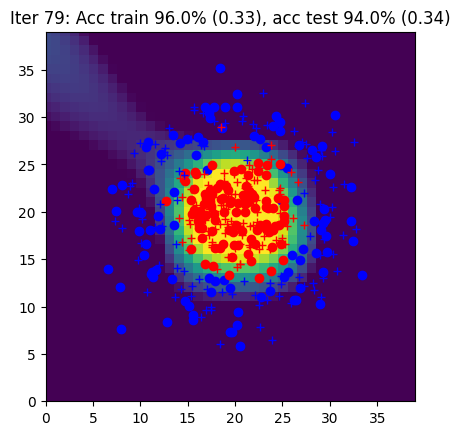

Iter 80: Acc train 96.5% (0.32), acc test 94.0% (0.34)


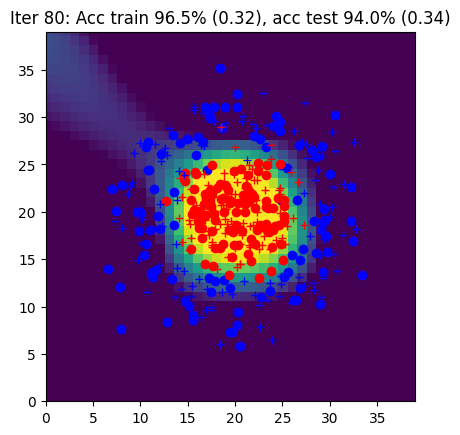

Iter 81: Acc train 96.5% (0.32), acc test 94.0% (0.33)


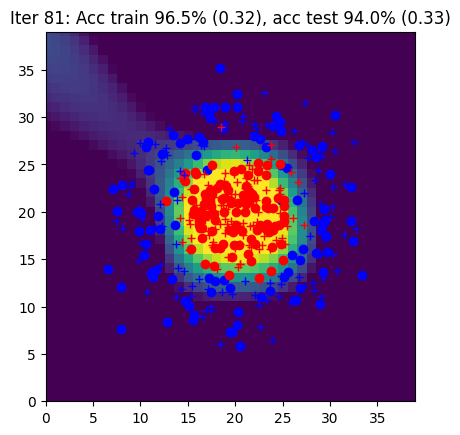

Iter 82: Acc train 96.0% (0.31), acc test 94.0% (0.33)


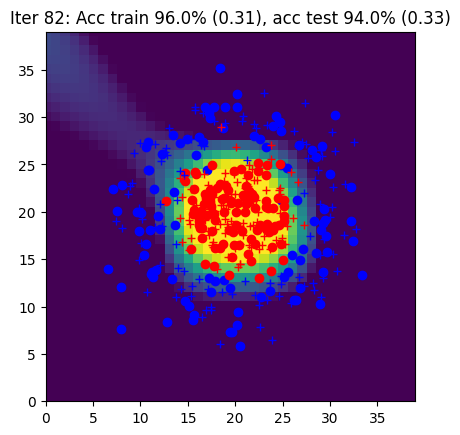

Iter 83: Acc train 96.0% (0.31), acc test 94.0% (0.32)


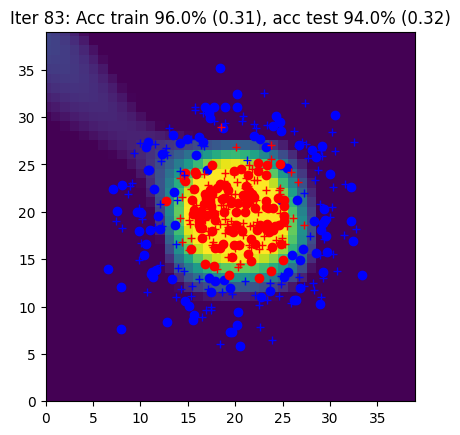

Iter 84: Acc train 96.0% (0.31), acc test 94.0% (0.32)


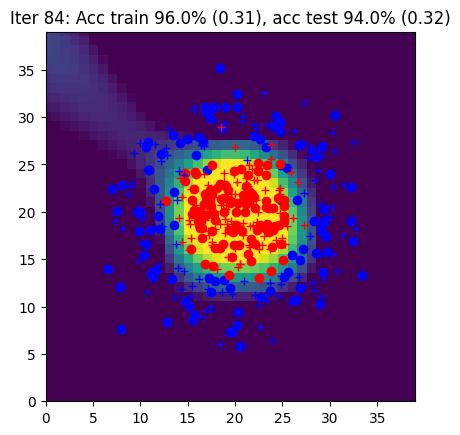

Iter 85: Acc train 96.5% (0.30), acc test 94.0% (0.32)


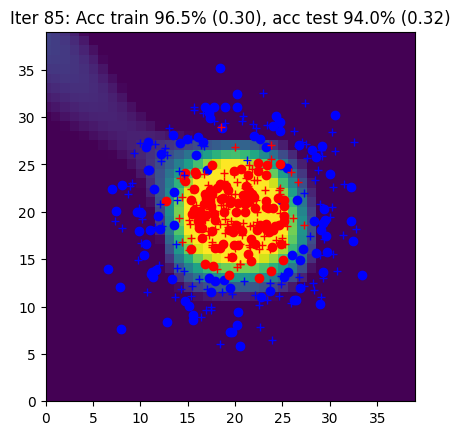

Iter 86: Acc train 96.5% (0.30), acc test 94.0% (0.31)


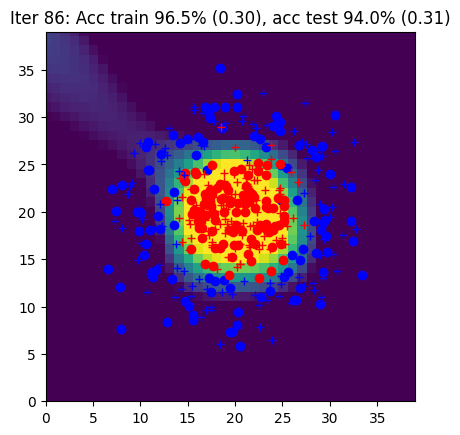

Iter 87: Acc train 96.0% (0.30), acc test 94.0% (0.31)


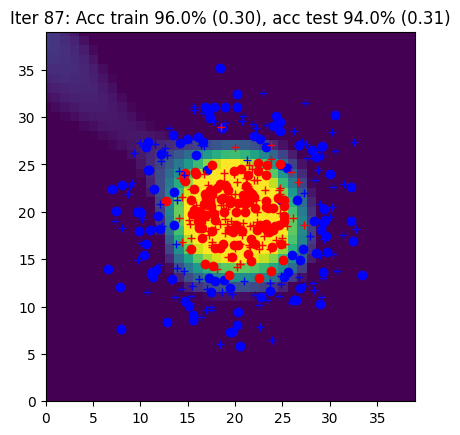

Iter 88: Acc train 96.0% (0.29), acc test 95.0% (0.31)


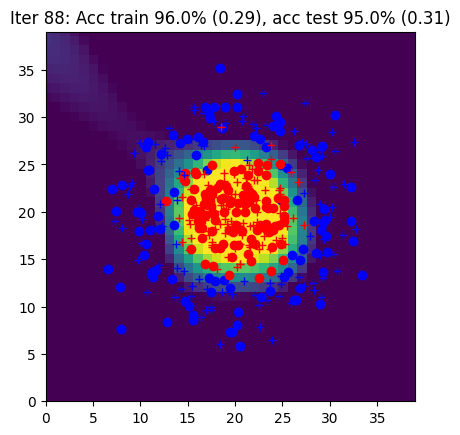

Iter 89: Acc train 96.5% (0.29), acc test 94.0% (0.30)


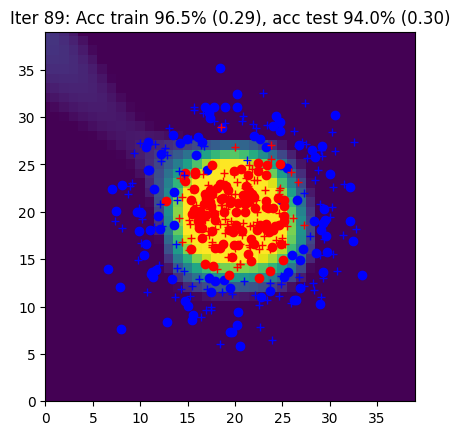

Iter 90: Acc train 96.0% (0.29), acc test 94.0% (0.30)


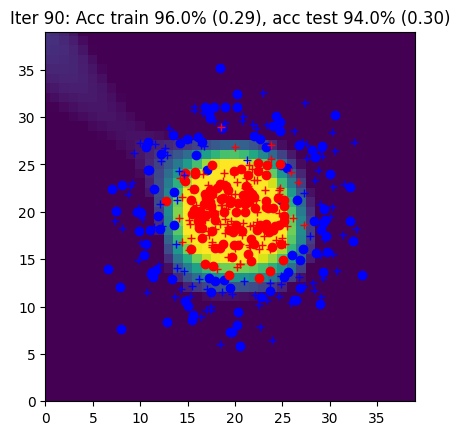

Iter 91: Acc train 96.0% (0.28), acc test 94.0% (0.30)


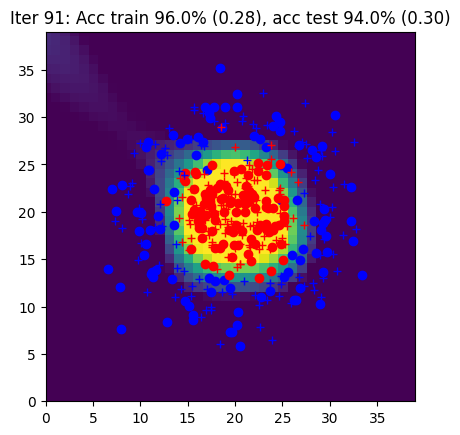

Iter 92: Acc train 96.0% (0.28), acc test 94.0% (0.30)


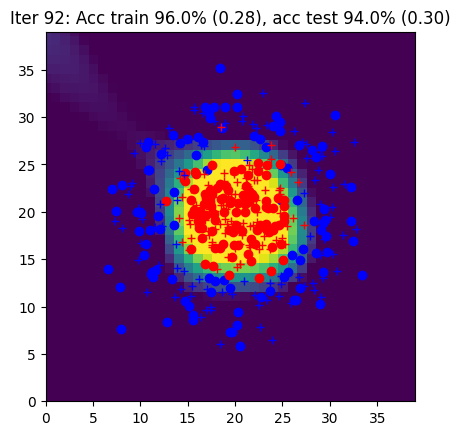

Iter 93: Acc train 96.0% (0.28), acc test 94.0% (0.29)


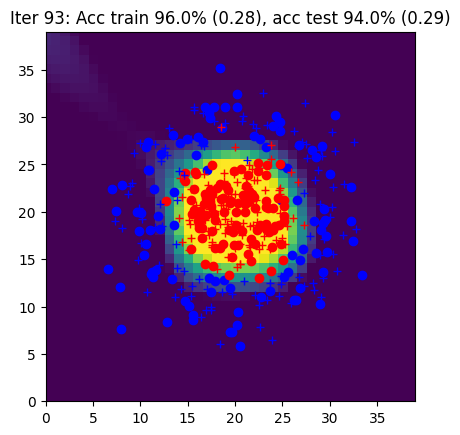

Iter 94: Acc train 96.0% (0.27), acc test 94.5% (0.29)


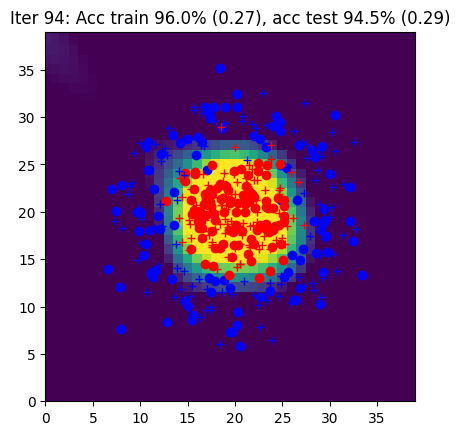

Iter 95: Acc train 96.0% (0.27), acc test 94.5% (0.29)


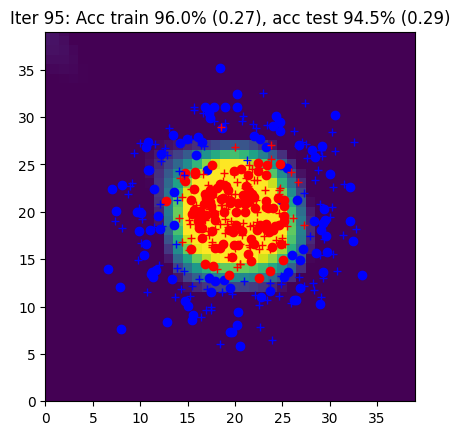

Iter 96: Acc train 96.0% (0.27), acc test 94.5% (0.28)


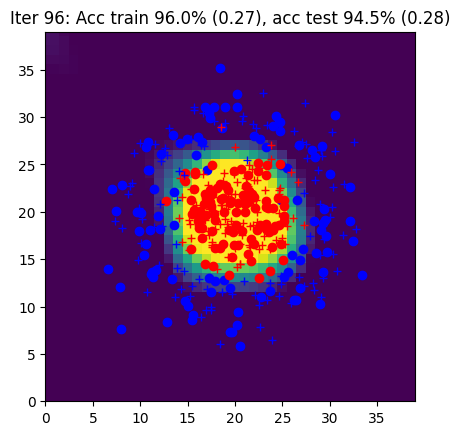

Iter 97: Acc train 96.0% (0.27), acc test 94.5% (0.28)


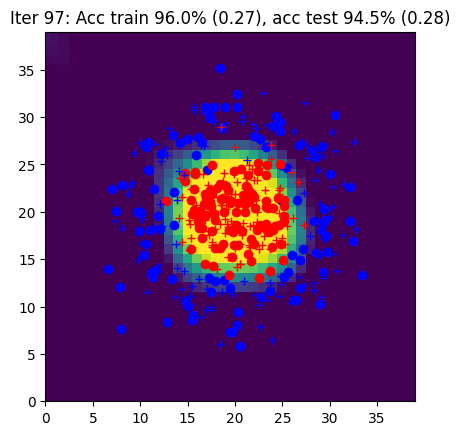

Iter 98: Acc train 96.0% (0.26), acc test 95.0% (0.28)


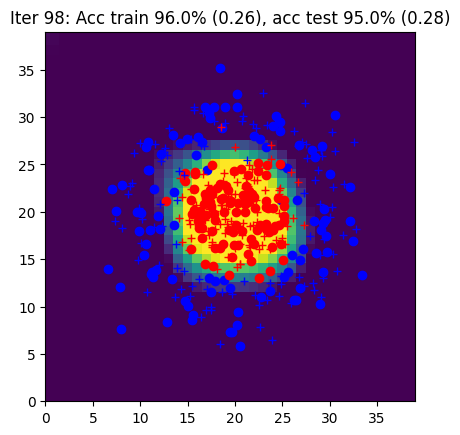

Iter 99: Acc train 96.0% (0.26), acc test 94.5% (0.28)


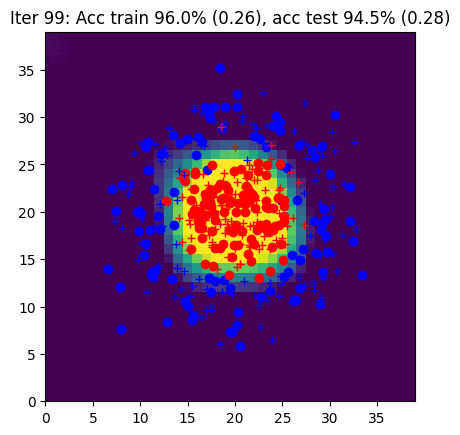

Iter 100: Acc train 96.0% (0.26), acc test 94.5% (0.27)


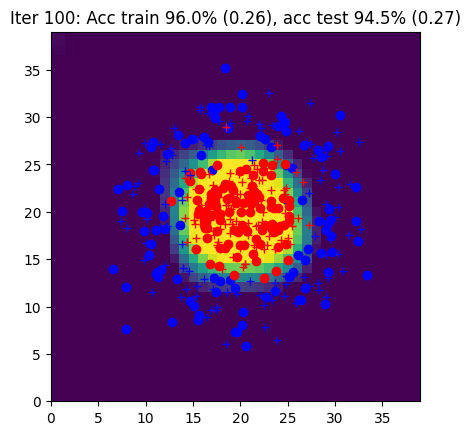

Iter 101: Acc train 96.0% (0.26), acc test 94.5% (0.27)


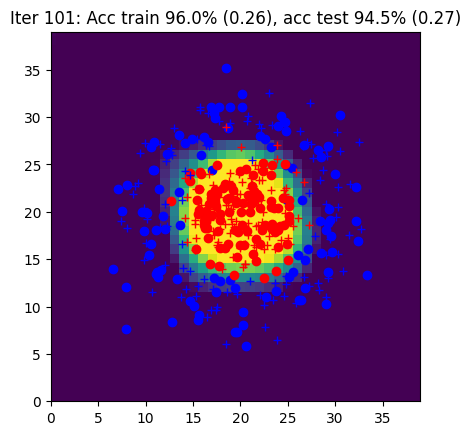

Iter 102: Acc train 96.0% (0.25), acc test 94.5% (0.27)


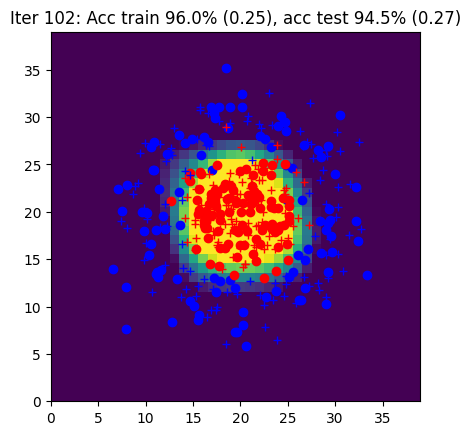

Iter 103: Acc train 96.0% (0.25), acc test 94.5% (0.27)


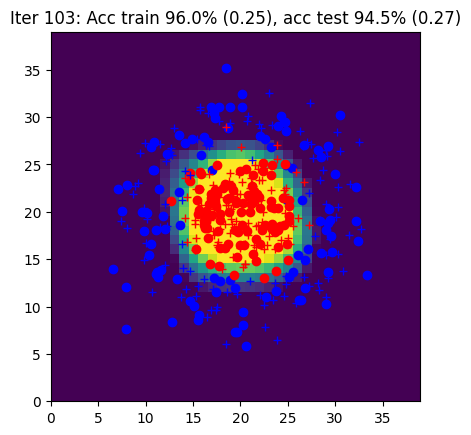

Iter 104: Acc train 96.0% (0.25), acc test 94.5% (0.26)


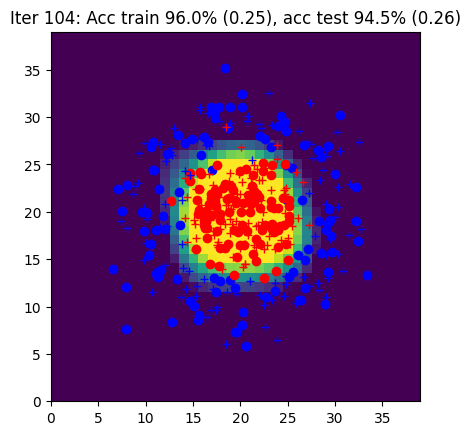

Iter 105: Acc train 96.0% (0.25), acc test 94.5% (0.26)


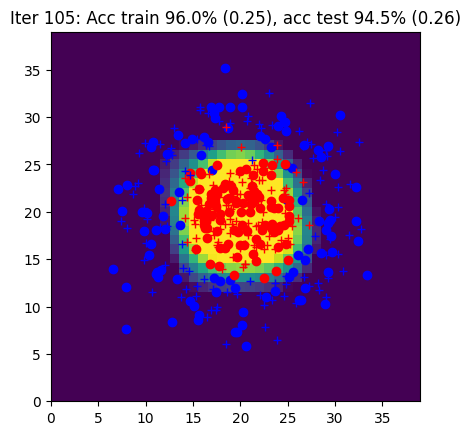

Iter 106: Acc train 96.0% (0.24), acc test 94.5% (0.26)


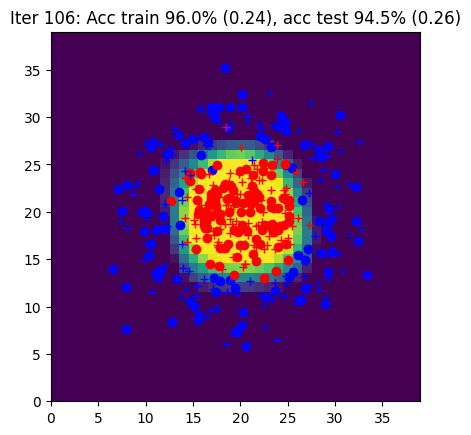

Iter 107: Acc train 96.0% (0.24), acc test 94.5% (0.26)


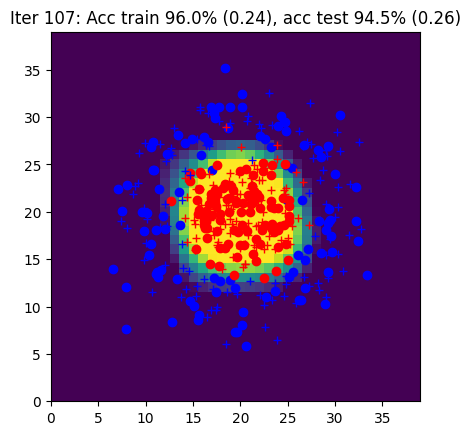

Iter 108: Acc train 96.0% (0.24), acc test 94.5% (0.26)


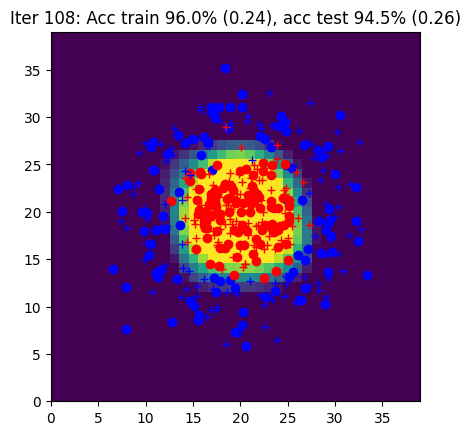

Iter 109: Acc train 96.0% (0.24), acc test 94.5% (0.25)


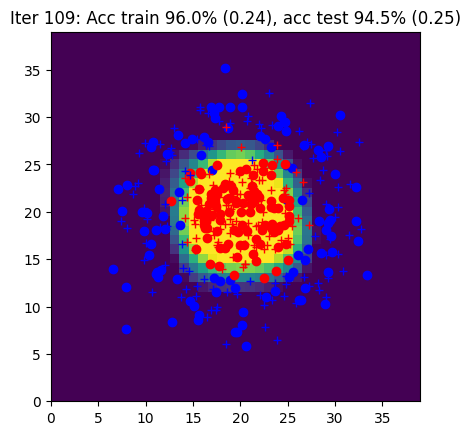

Iter 110: Acc train 96.0% (0.24), acc test 94.5% (0.25)


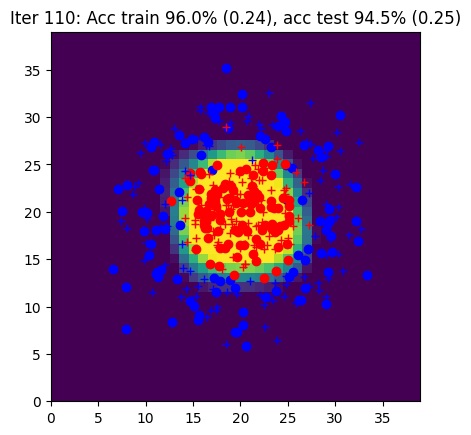

Iter 111: Acc train 96.0% (0.23), acc test 94.5% (0.25)


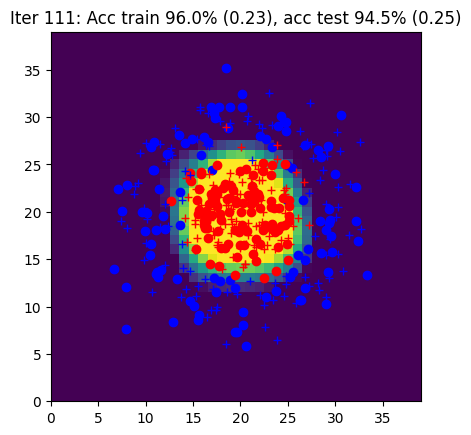

Iter 112: Acc train 96.0% (0.23), acc test 94.5% (0.25)


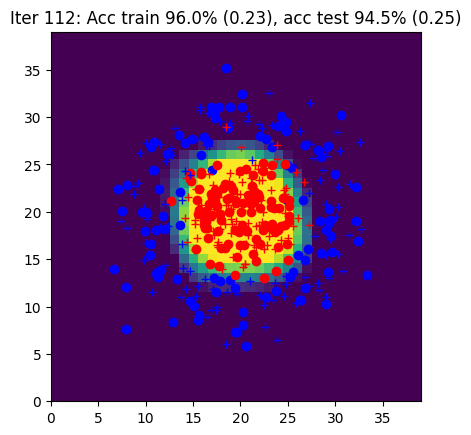

Iter 113: Acc train 96.0% (0.23), acc test 94.5% (0.25)


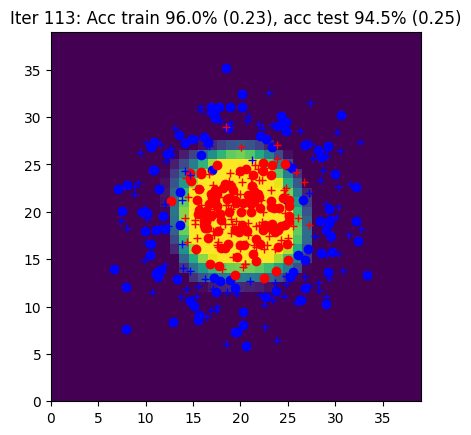

Iter 114: Acc train 96.5% (0.23), acc test 94.5% (0.25)


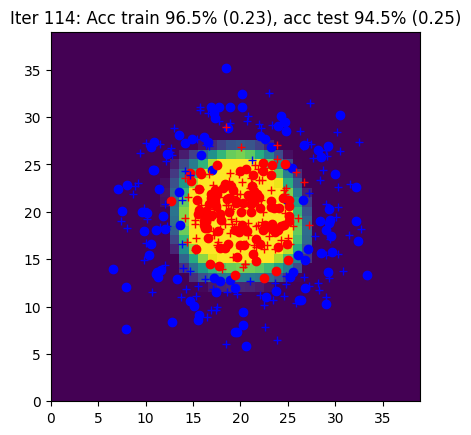

Iter 115: Acc train 96.0% (0.23), acc test 94.5% (0.24)


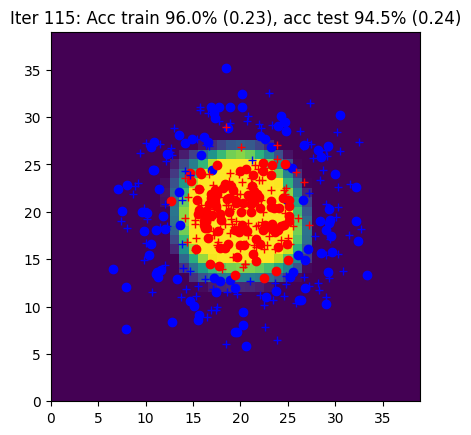

Iter 116: Acc train 96.0% (0.22), acc test 94.5% (0.24)


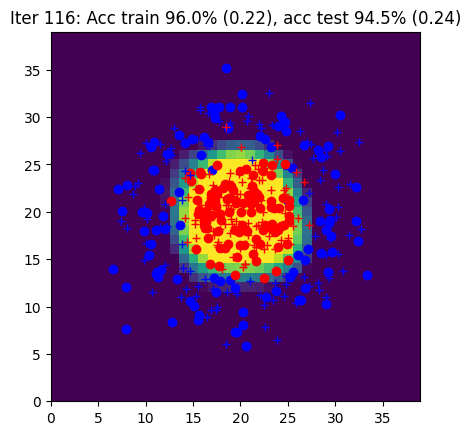

Iter 117: Acc train 96.0% (0.22), acc test 94.5% (0.24)


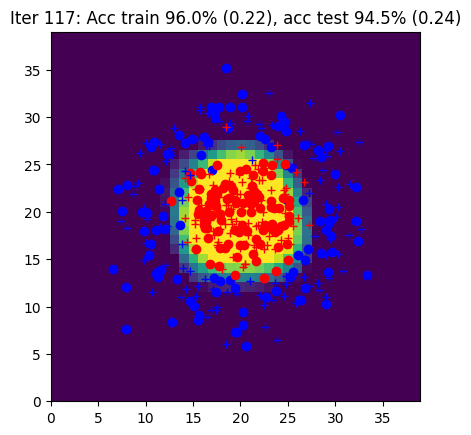

Iter 118: Acc train 96.5% (0.22), acc test 94.0% (0.24)


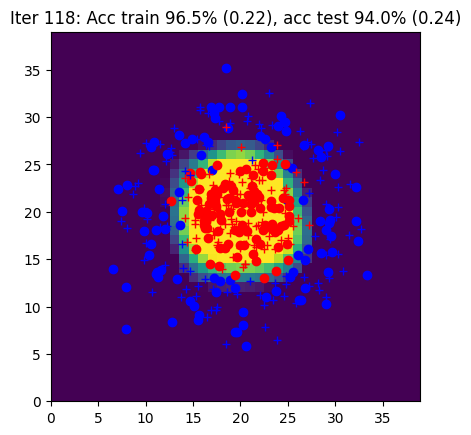

Iter 119: Acc train 96.5% (0.22), acc test 94.0% (0.24)


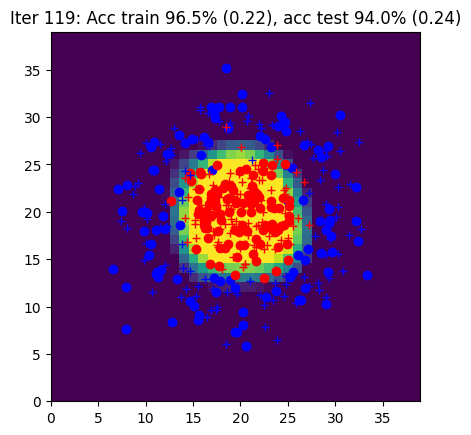

Iter 120: Acc train 97.0% (0.22), acc test 94.0% (0.24)


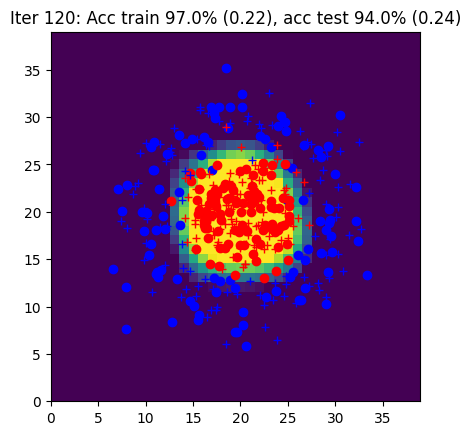

Iter 121: Acc train 96.5% (0.22), acc test 94.0% (0.23)


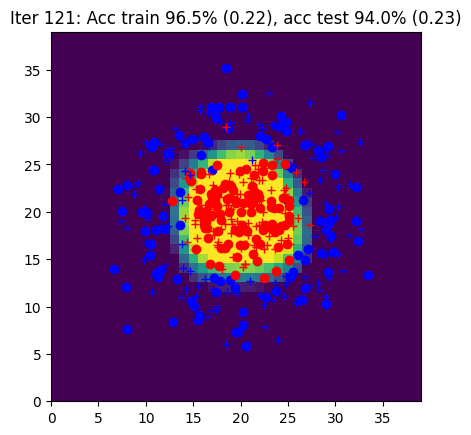

Iter 122: Acc train 96.5% (0.21), acc test 94.0% (0.23)


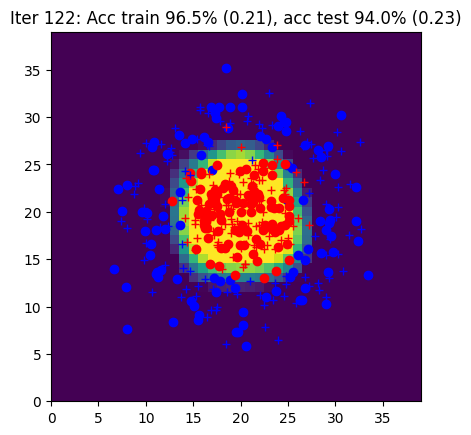

Iter 123: Acc train 97.0% (0.21), acc test 94.0% (0.23)


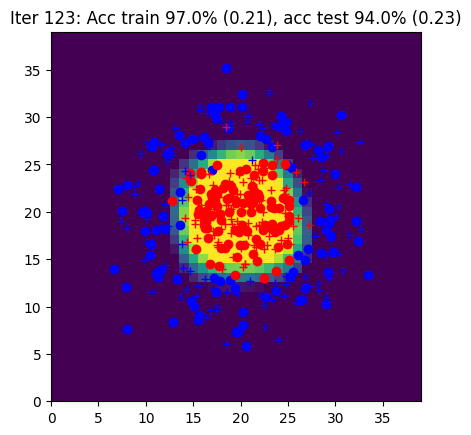

Iter 124: Acc train 96.5% (0.21), acc test 94.0% (0.23)


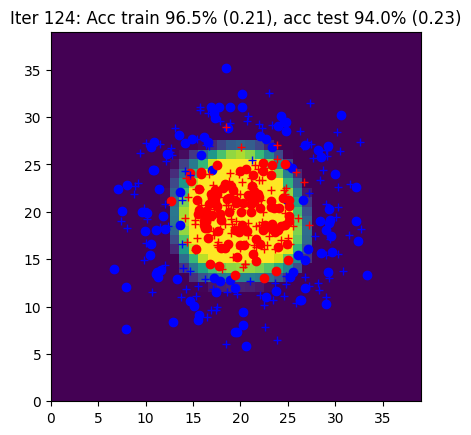

Iter 125: Acc train 96.5% (0.21), acc test 94.0% (0.23)


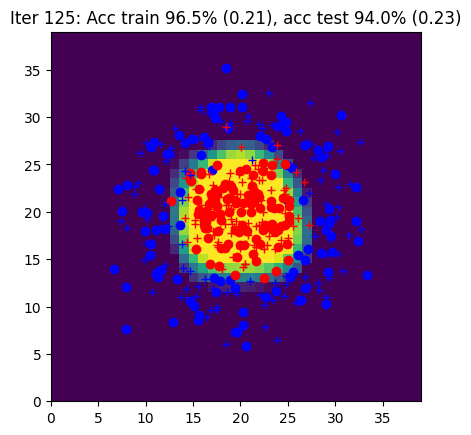

Iter 126: Acc train 96.5% (0.21), acc test 94.0% (0.23)


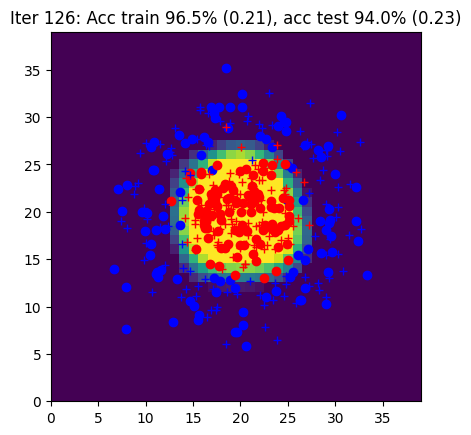

Iter 127: Acc train 96.5% (0.21), acc test 94.0% (0.22)


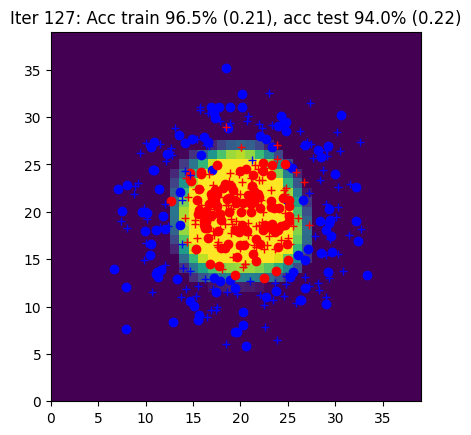

Iter 128: Acc train 96.5% (0.21), acc test 94.0% (0.22)


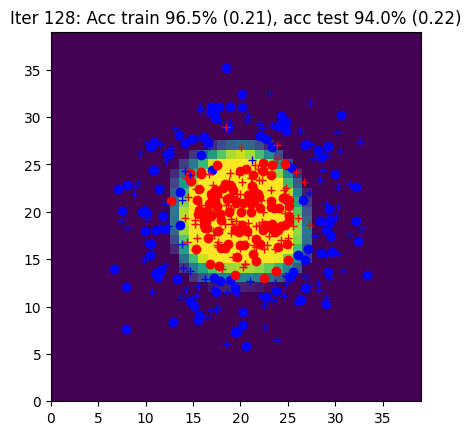

Iter 129: Acc train 96.5% (0.21), acc test 94.0% (0.22)


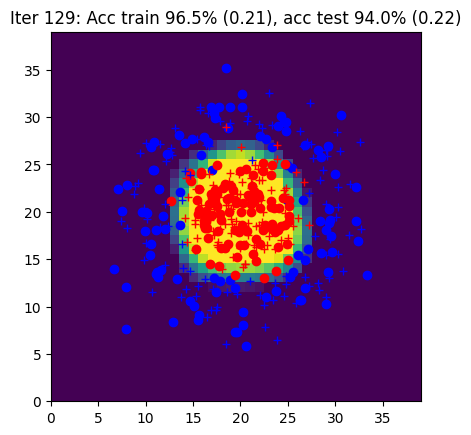

Iter 130: Acc train 96.5% (0.20), acc test 94.0% (0.22)


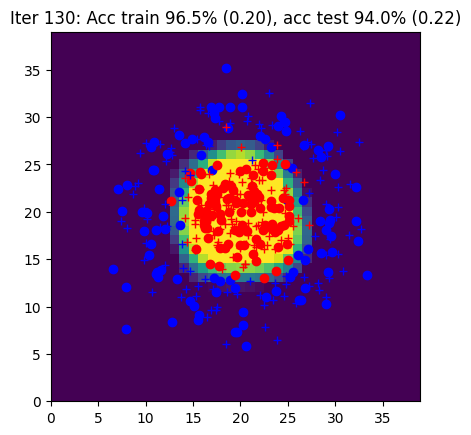

Iter 131: Acc train 96.0% (0.20), acc test 94.0% (0.22)


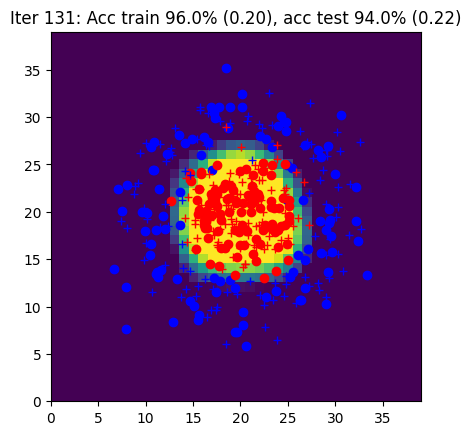

Iter 132: Acc train 96.5% (0.20), acc test 94.0% (0.22)


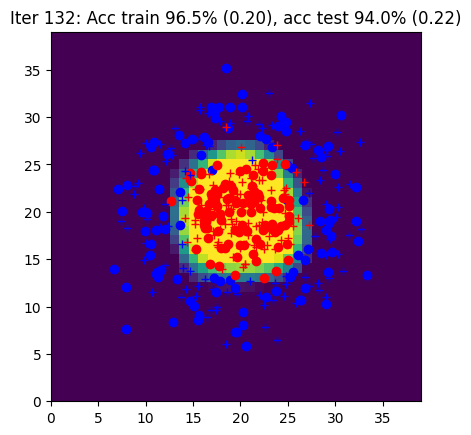

Iter 133: Acc train 96.5% (0.20), acc test 94.0% (0.22)


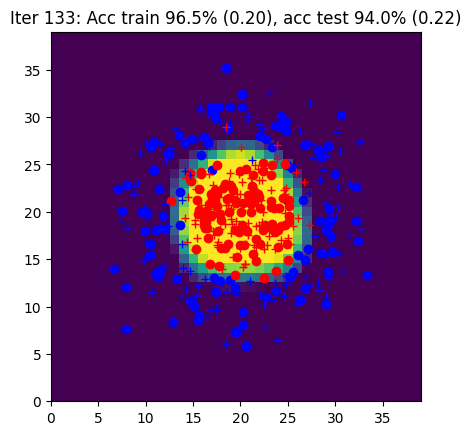

Iter 134: Acc train 96.5% (0.20), acc test 94.0% (0.22)


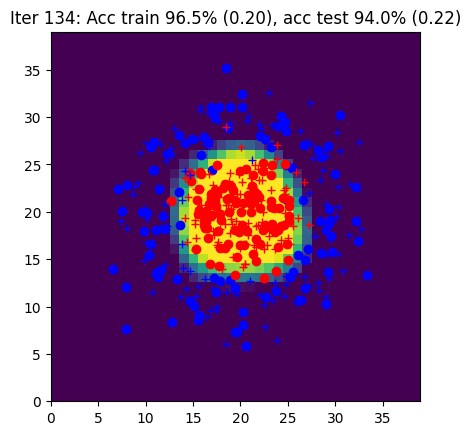

Iter 135: Acc train 96.0% (0.20), acc test 94.0% (0.21)


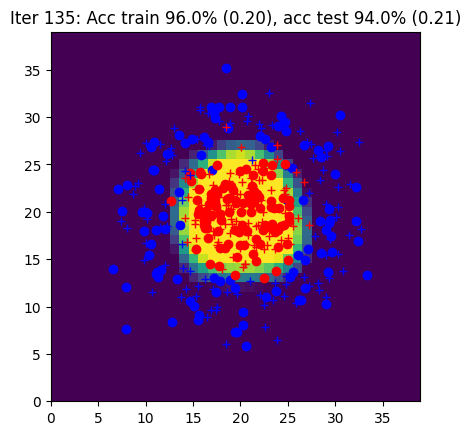

Iter 136: Acc train 96.0% (0.20), acc test 94.5% (0.21)


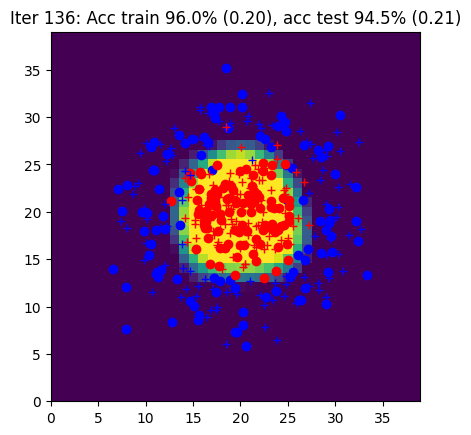

Iter 137: Acc train 96.0% (0.20), acc test 94.0% (0.21)


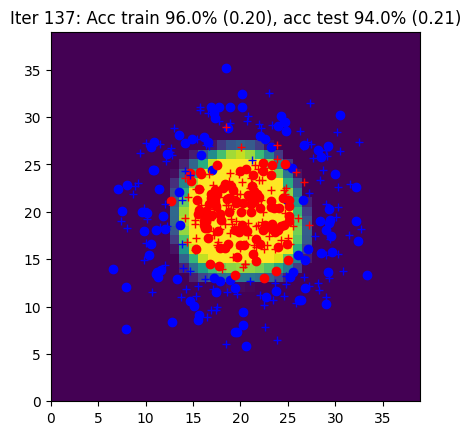

Iter 138: Acc train 96.0% (0.19), acc test 94.5% (0.21)


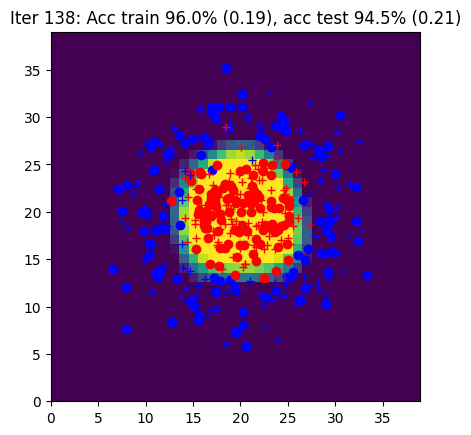

Iter 139: Acc train 96.5% (0.19), acc test 94.5% (0.21)


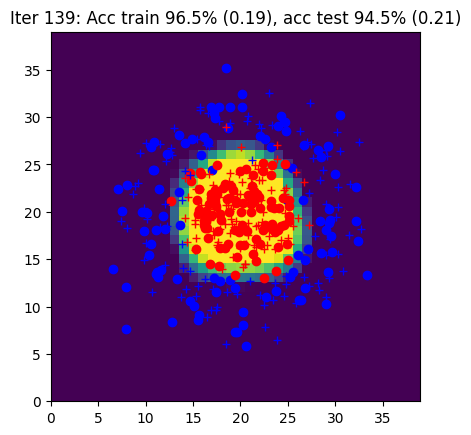

Iter 140: Acc train 96.0% (0.19), acc test 94.0% (0.21)


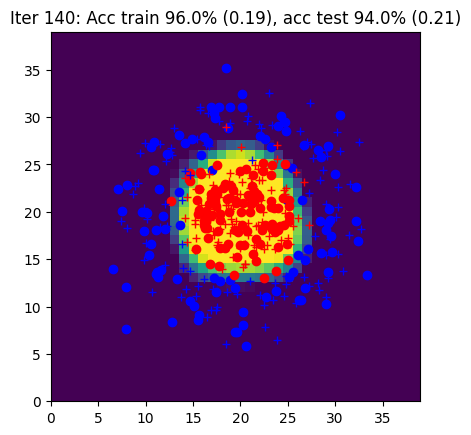

Iter 141: Acc train 96.0% (0.19), acc test 94.5% (0.21)


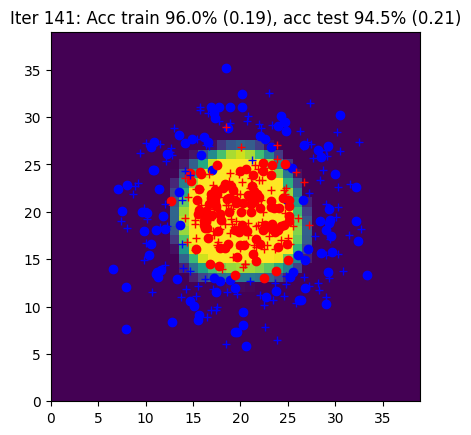

Iter 142: Acc train 96.0% (0.19), acc test 94.5% (0.21)


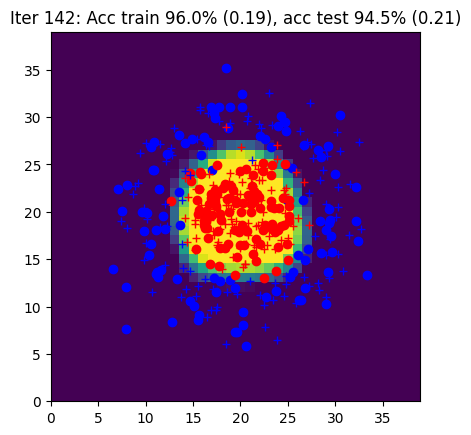

Iter 143: Acc train 96.5% (0.19), acc test 94.5% (0.21)


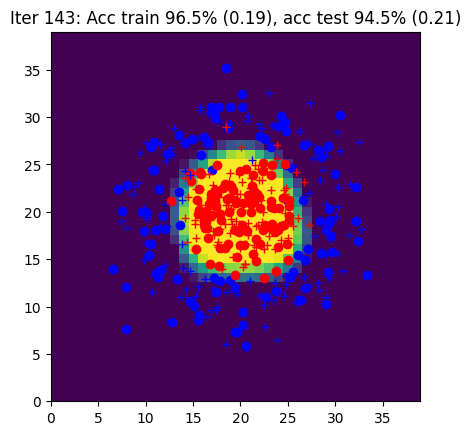

Iter 144: Acc train 96.5% (0.19), acc test 94.5% (0.21)


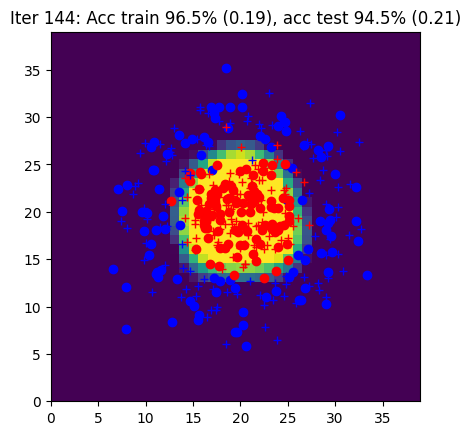

Iter 145: Acc train 96.0% (0.19), acc test 94.0% (0.20)


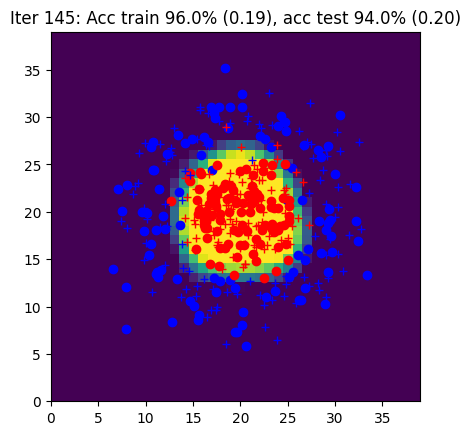

Iter 146: Acc train 96.5% (0.19), acc test 94.5% (0.20)


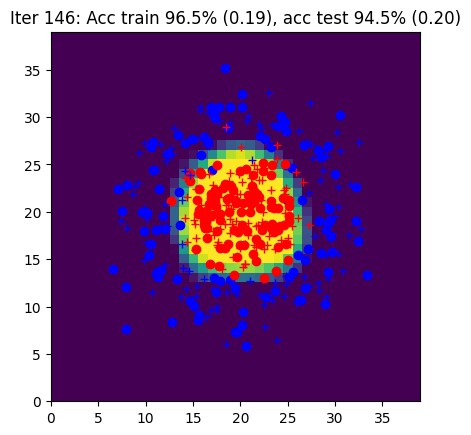

Iter 147: Acc train 96.5% (0.19), acc test 94.5% (0.20)


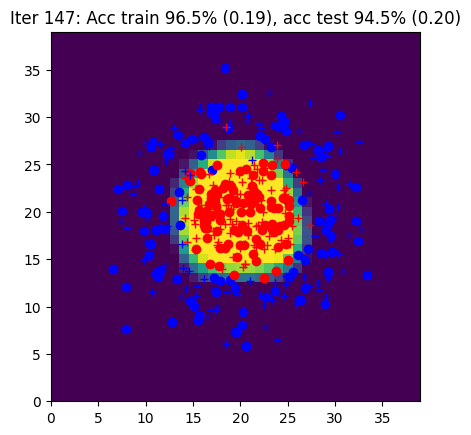

Iter 148: Acc train 96.0% (0.18), acc test 94.5% (0.20)


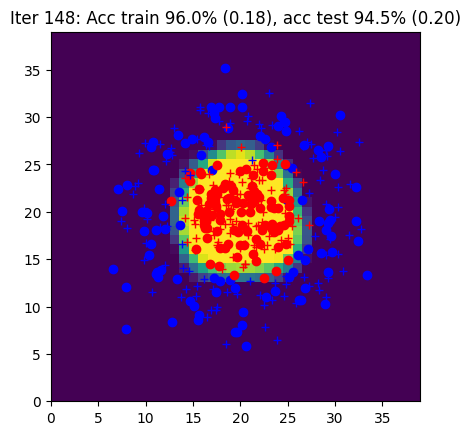

Iter 149: Acc train 96.5% (0.18), acc test 94.5% (0.20)


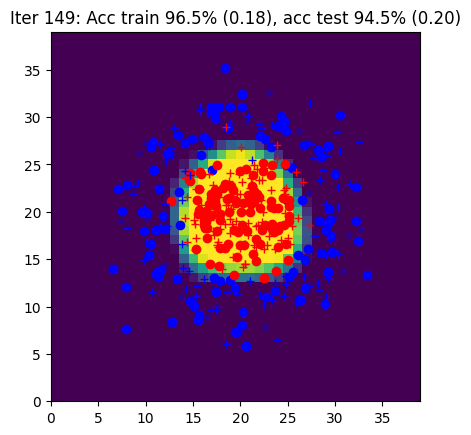

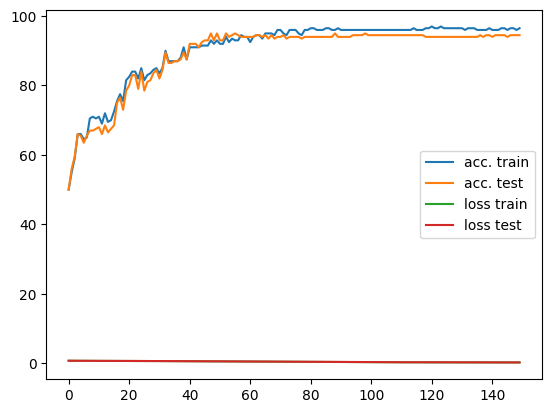

In [ ]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss = init_model(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: loss_accuracy, sgd
        # the forward with the predict method from the model
        # and the backward function with autograd

        Yhat = model(X)
        Y_labels = torch.argmax(Y, dim=1)
        L = loss(Yhat, Y_labels)
        L.backward()
        model = sgd(model, eta)

    ####################
    ##      END        #
    ####################


    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)
    Ygrid = model(data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(torch.nn.Softmax(dim=1)(Ygrid.detach()), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 4 : Simplification of the SGD with `torch.optim`

In [ ]:
def init_model(nx, nh, ny, eta):
    model = torch.nn.Sequential(
        torch.nn.Linear(nx, nh),
        torch.nn.Tanh(),
        torch.nn.Linear(nh, ny)
    )
    loss = torch.nn.CrossEntropyLoss()
    optim = torch.optim.SGD(model.parameters(), lr=eta)
    return model, loss, optim

The `sgd` function is replaced by calling the `optim.zero_grad()` before the backward and `optim.step()` after.

## Algorithme global d'apprentissage (avec autograd, les couches `torch.nn` et `torch.optim`)

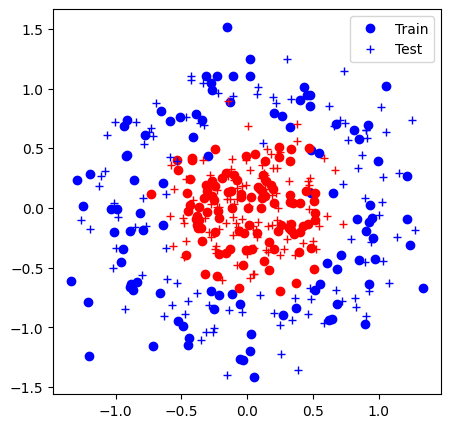

Iter 0: Acc train 52.0% (0.71), acc test 55.5% (0.70)


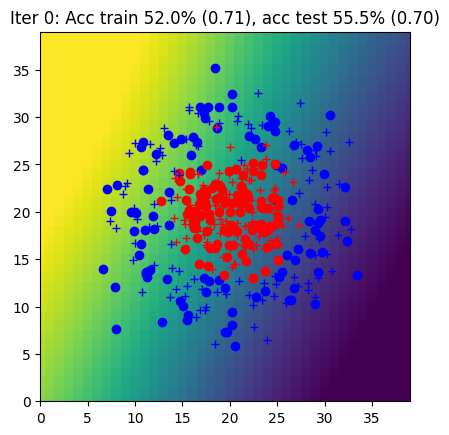

Iter 1: Acc train 56.5% (0.70), acc test 56.5% (0.70)


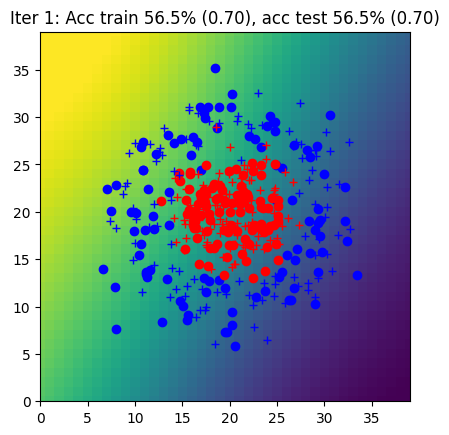

Iter 2: Acc train 57.5% (0.70), acc test 58.5% (0.69)


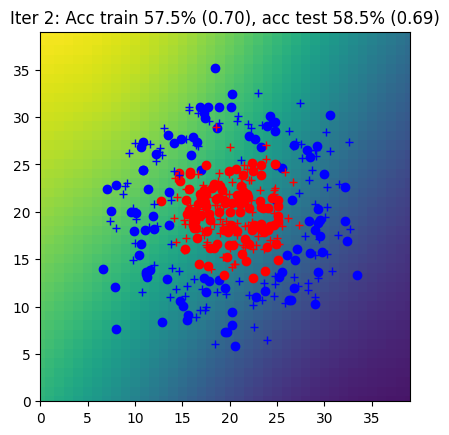

Iter 3: Acc train 55.0% (0.69), acc test 59.5% (0.69)


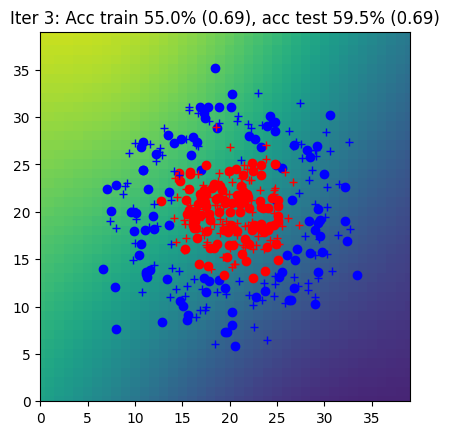

Iter 4: Acc train 58.0% (0.69), acc test 62.0% (0.69)


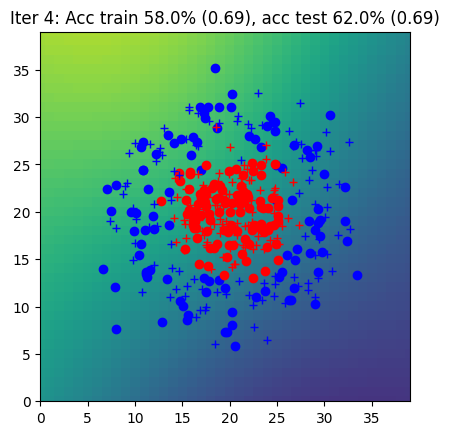

Iter 5: Acc train 59.5% (0.69), acc test 63.5% (0.69)


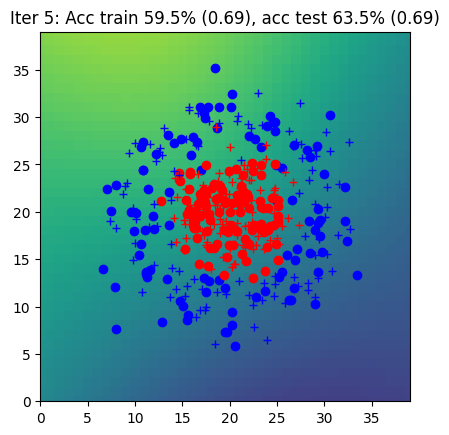

Iter 6: Acc train 60.5% (0.69), acc test 63.5% (0.69)


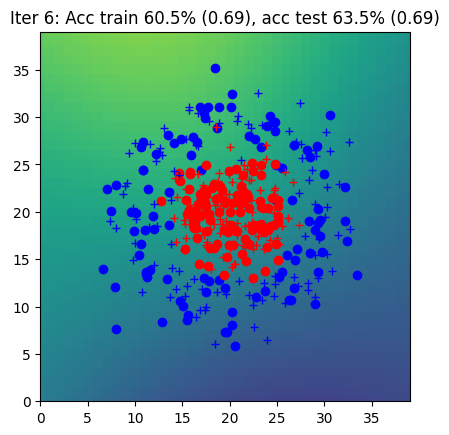

Iter 7: Acc train 61.5% (0.69), acc test 62.5% (0.68)


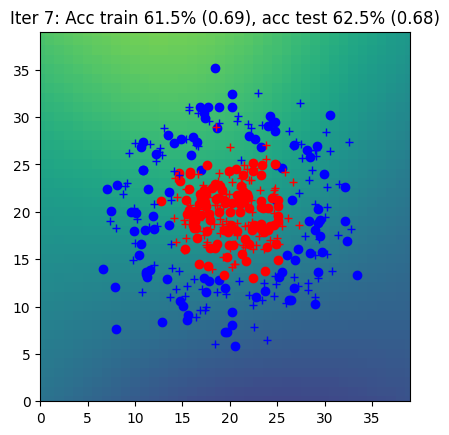

Iter 8: Acc train 66.5% (0.69), acc test 64.5% (0.68)


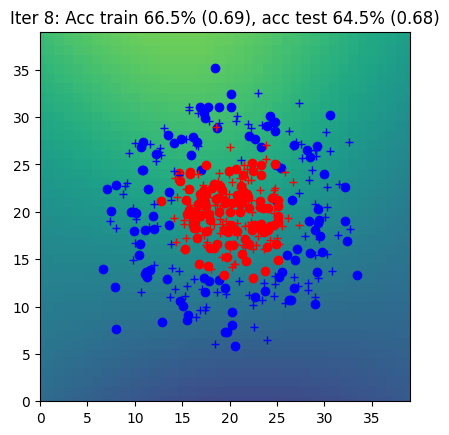

Iter 9: Acc train 65.5% (0.68), acc test 63.5% (0.68)


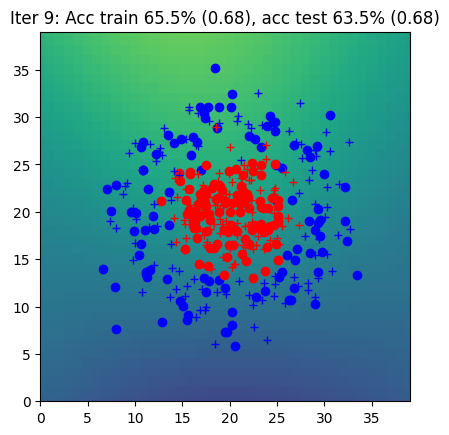

Iter 10: Acc train 66.5% (0.68), acc test 64.0% (0.68)


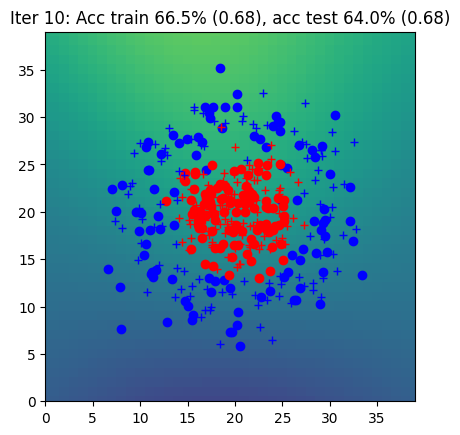

Iter 11: Acc train 66.5% (0.68), acc test 66.5% (0.68)


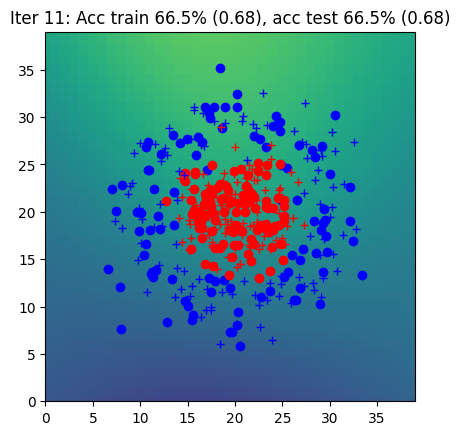

Iter 12: Acc train 67.0% (0.68), acc test 64.0% (0.68)


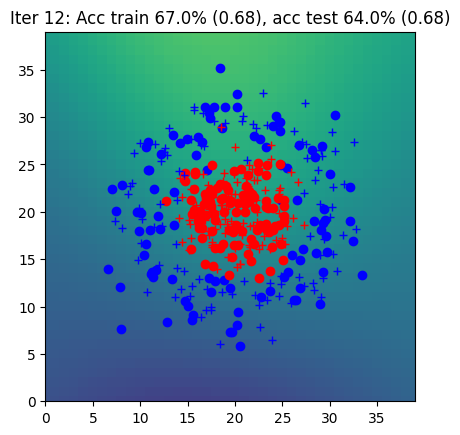

Iter 13: Acc train 69.0% (0.68), acc test 68.5% (0.68)


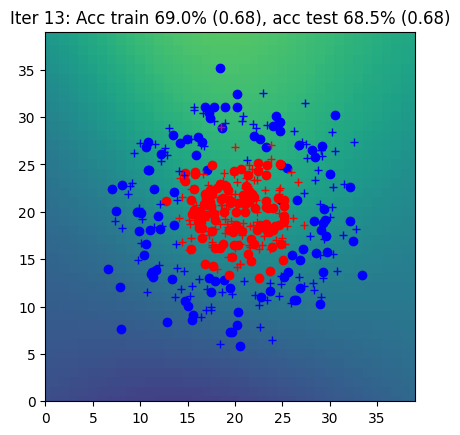

Iter 14: Acc train 68.5% (0.68), acc test 70.5% (0.68)


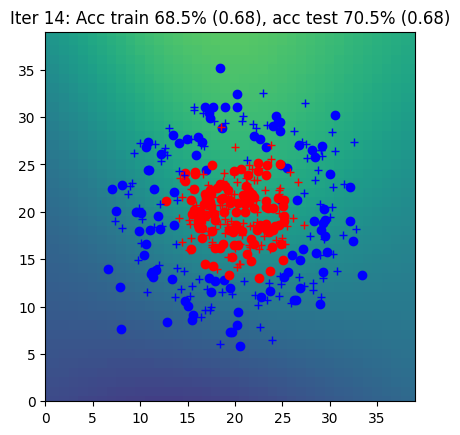

Iter 15: Acc train 69.5% (0.68), acc test 70.0% (0.68)


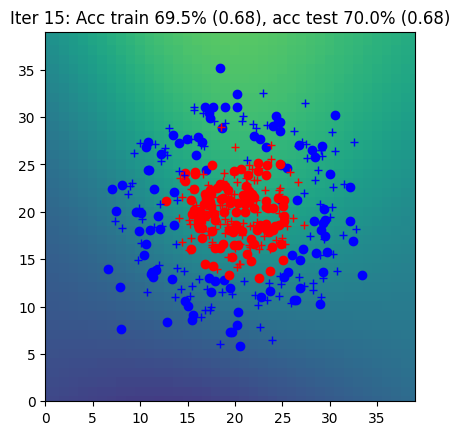

Iter 16: Acc train 68.5% (0.68), acc test 70.0% (0.68)


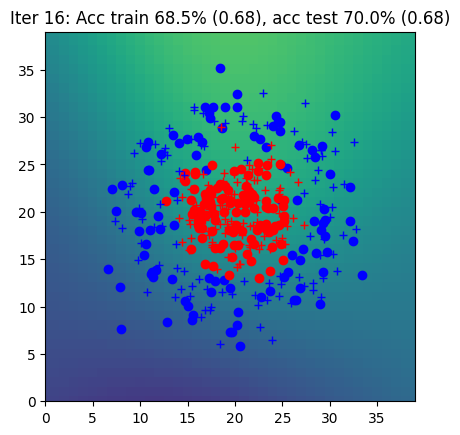

Iter 17: Acc train 69.0% (0.68), acc test 69.5% (0.67)


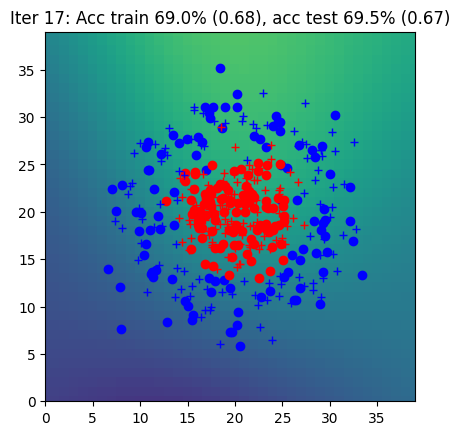

Iter 18: Acc train 69.0% (0.67), acc test 70.0% (0.67)


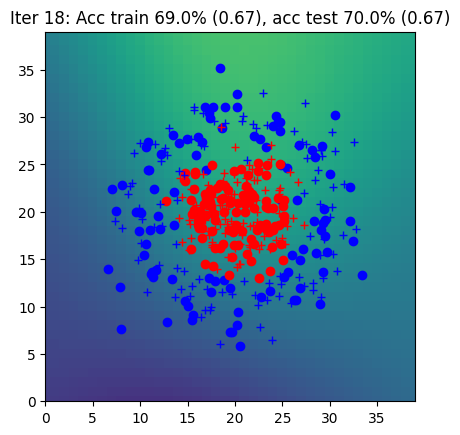

Iter 19: Acc train 69.5% (0.67), acc test 69.5% (0.67)


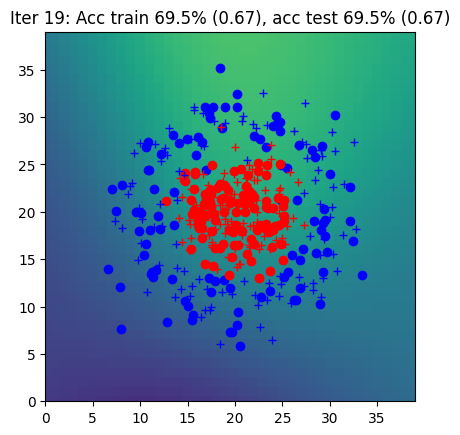

Iter 20: Acc train 71.0% (0.67), acc test 70.5% (0.67)


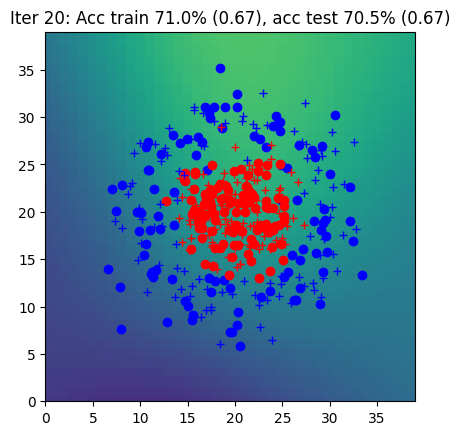

Iter 21: Acc train 71.5% (0.67), acc test 70.5% (0.67)


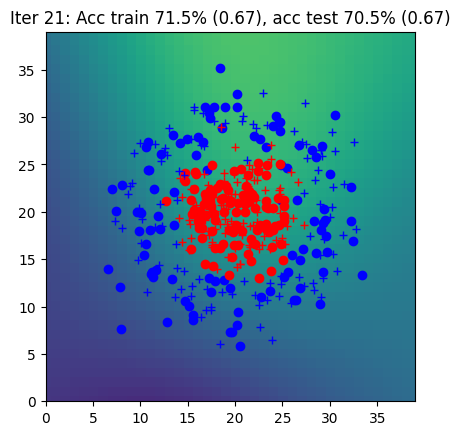

Iter 22: Acc train 71.5% (0.67), acc test 72.5% (0.67)


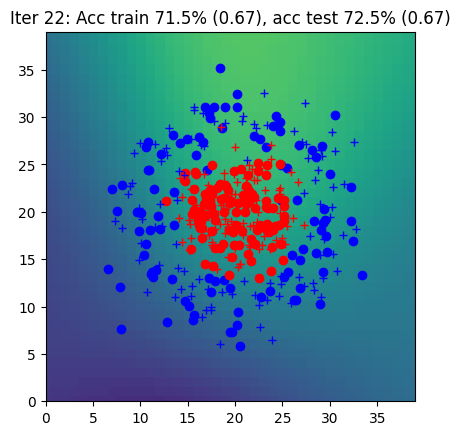

Iter 23: Acc train 71.5% (0.67), acc test 73.5% (0.67)


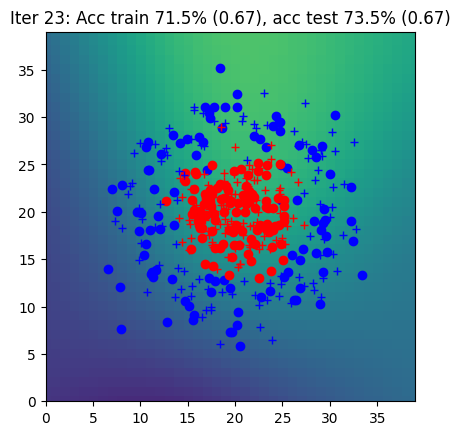

Iter 24: Acc train 72.0% (0.67), acc test 73.5% (0.67)


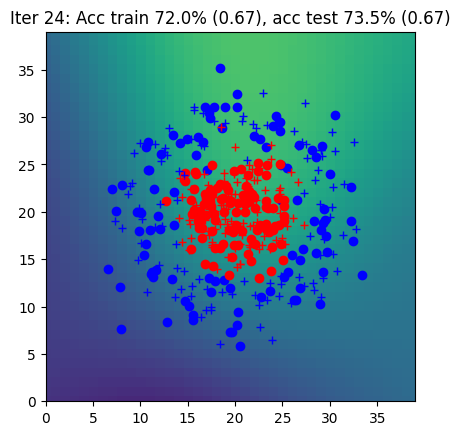

Iter 25: Acc train 73.5% (0.67), acc test 73.0% (0.66)


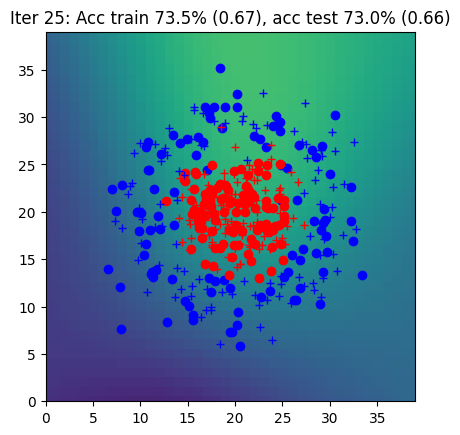

Iter 26: Acc train 73.0% (0.66), acc test 74.5% (0.66)


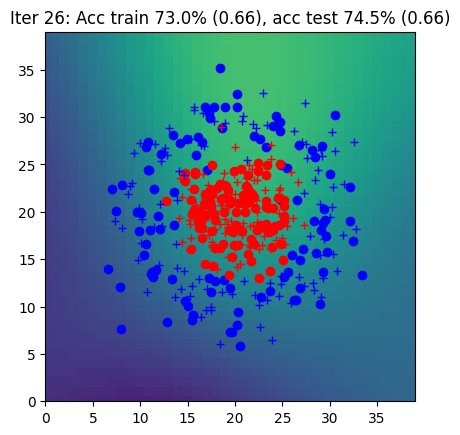

Iter 27: Acc train 74.0% (0.66), acc test 73.5% (0.66)


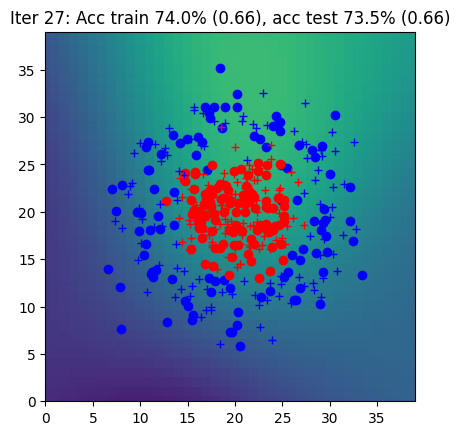

Iter 28: Acc train 74.5% (0.66), acc test 74.5% (0.66)


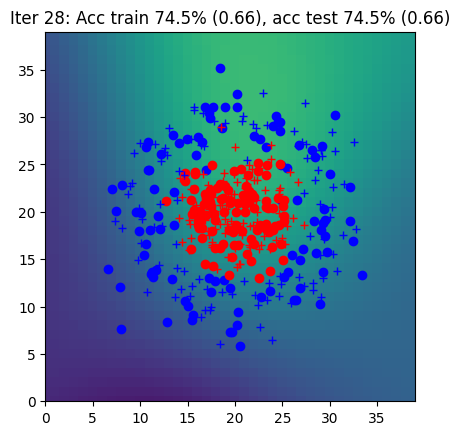

Iter 29: Acc train 73.5% (0.66), acc test 74.5% (0.66)


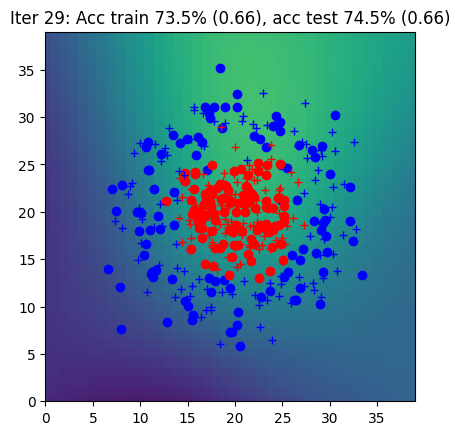

Iter 30: Acc train 74.0% (0.66), acc test 75.5% (0.66)


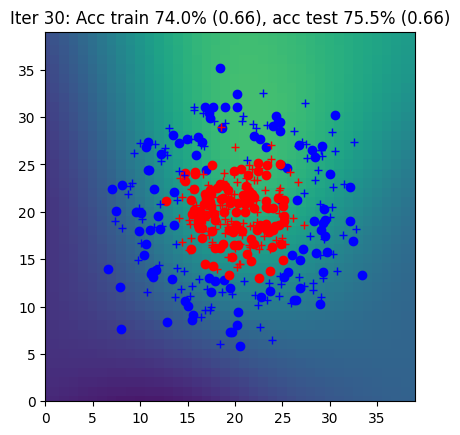

Iter 31: Acc train 74.5% (0.66), acc test 75.5% (0.65)


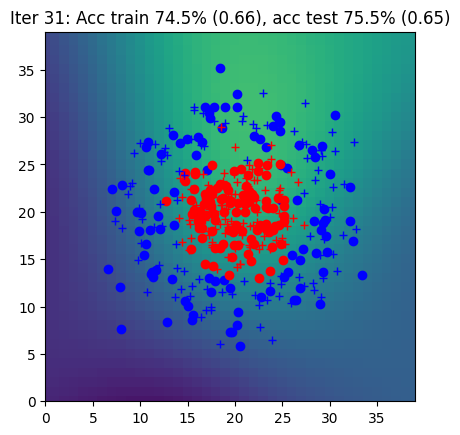

Iter 32: Acc train 74.0% (0.65), acc test 75.5% (0.65)


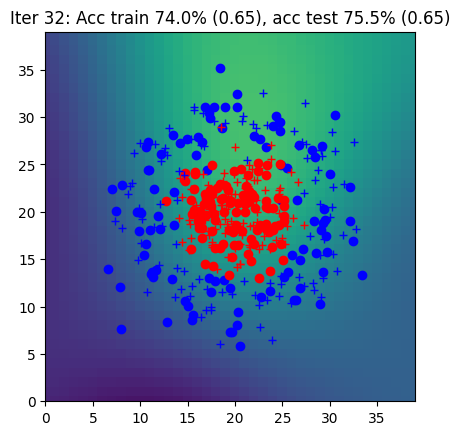

Iter 33: Acc train 75.5% (0.65), acc test 76.0% (0.65)


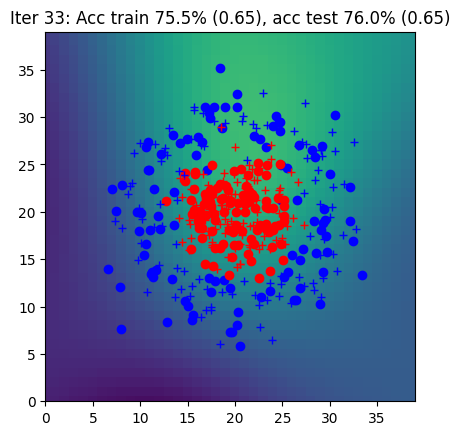

Iter 34: Acc train 76.0% (0.65), acc test 77.0% (0.65)


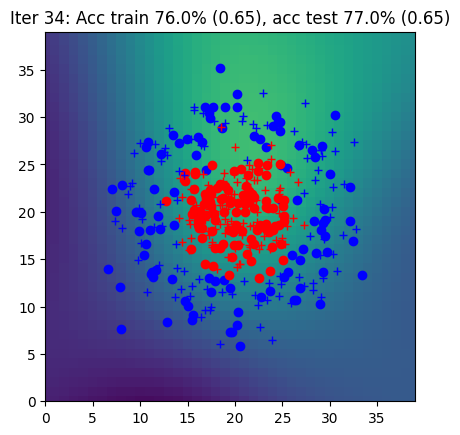

Iter 35: Acc train 76.5% (0.65), acc test 77.5% (0.65)


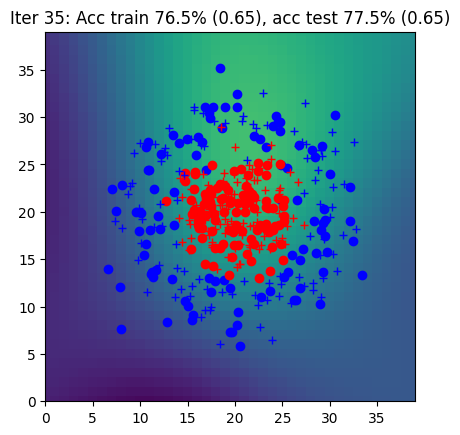

Iter 36: Acc train 78.5% (0.65), acc test 80.0% (0.64)


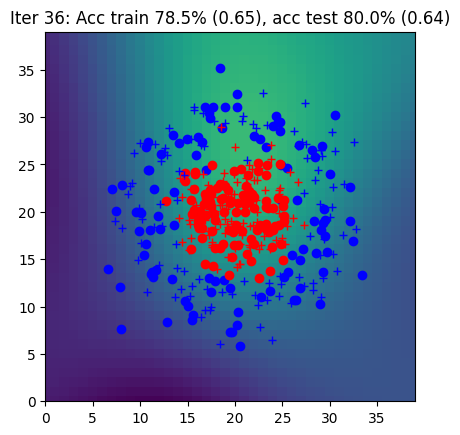

Iter 37: Acc train 77.5% (0.64), acc test 78.5% (0.64)


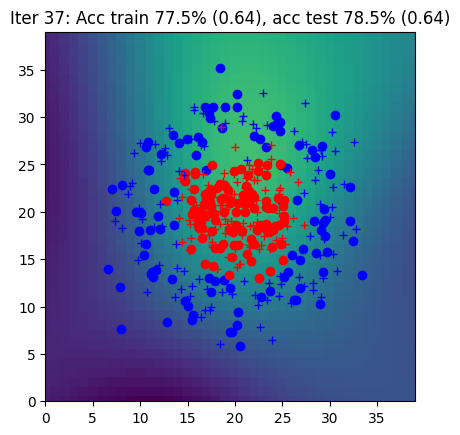

Iter 38: Acc train 79.0% (0.64), acc test 80.0% (0.64)


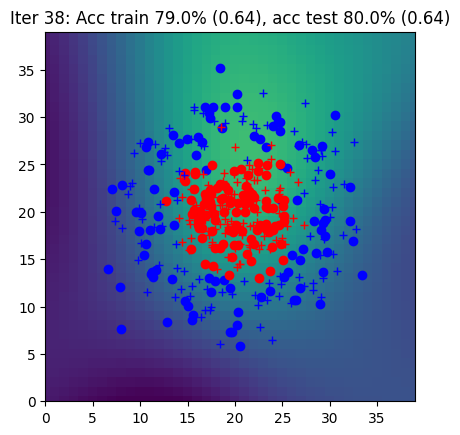

Iter 39: Acc train 79.5% (0.64), acc test 81.0% (0.64)


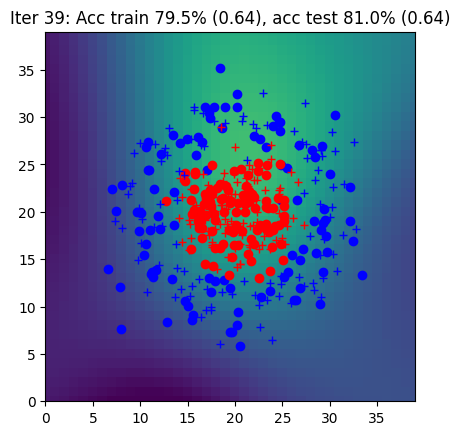

Iter 40: Acc train 80.5% (0.64), acc test 81.5% (0.63)


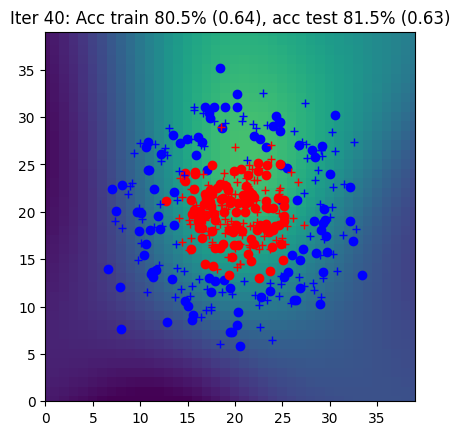

Iter 41: Acc train 79.5% (0.63), acc test 80.0% (0.63)


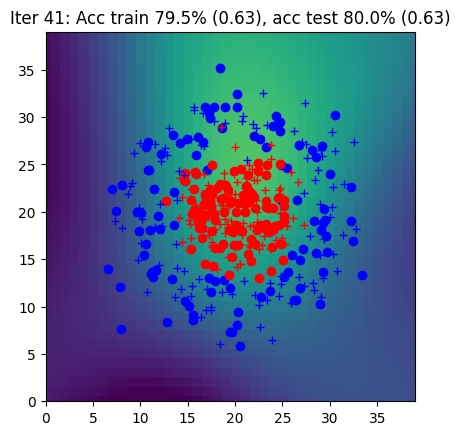

Iter 42: Acc train 80.0% (0.63), acc test 82.5% (0.63)


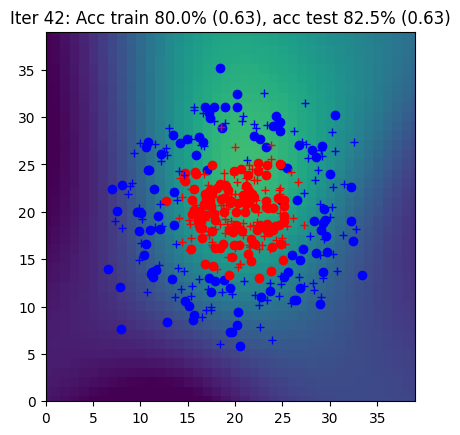

Iter 43: Acc train 80.5% (0.63), acc test 82.0% (0.63)


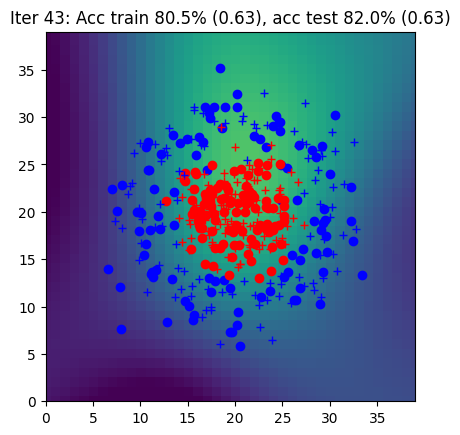

Iter 44: Acc train 81.5% (0.63), acc test 82.5% (0.62)


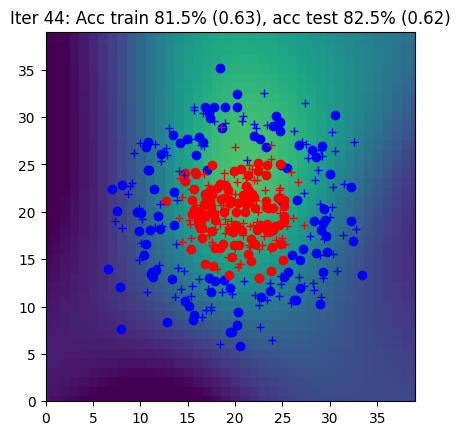

Iter 45: Acc train 82.5% (0.62), acc test 82.5% (0.62)


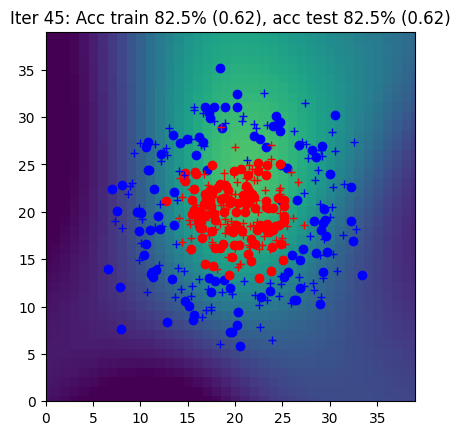

Iter 46: Acc train 83.0% (0.62), acc test 83.0% (0.62)


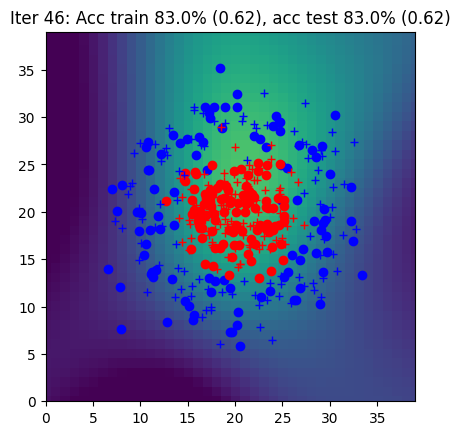

Iter 47: Acc train 79.0% (0.62), acc test 82.0% (0.61)


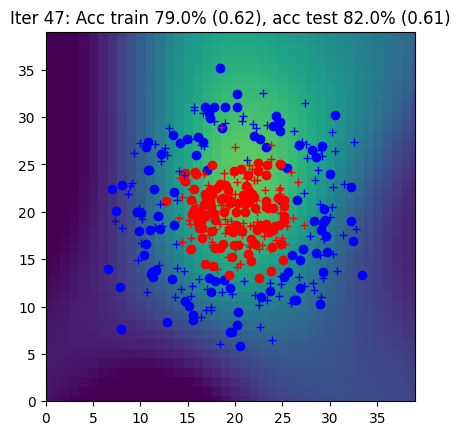

Iter 48: Acc train 80.5% (0.61), acc test 83.5% (0.61)


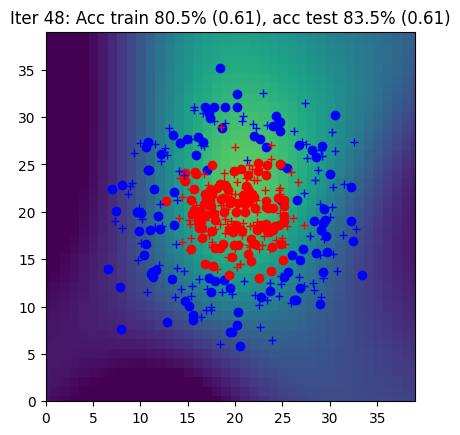

Iter 49: Acc train 83.0% (0.61), acc test 83.0% (0.61)


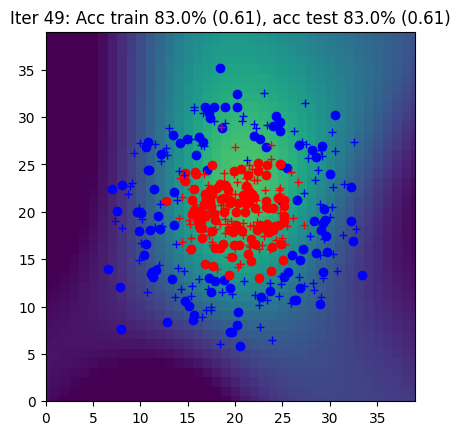

Iter 50: Acc train 81.0% (0.61), acc test 84.5% (0.60)


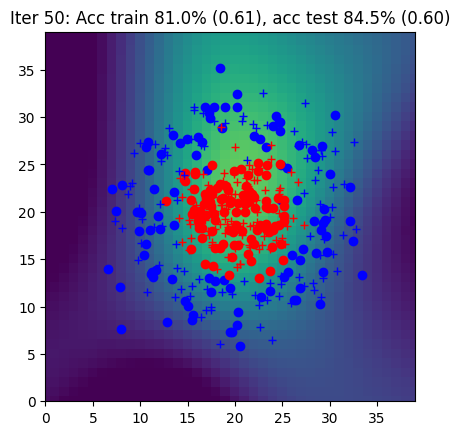

Iter 51: Acc train 83.0% (0.60), acc test 85.0% (0.60)


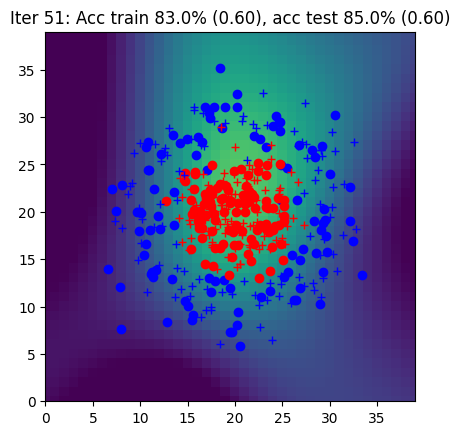

Iter 52: Acc train 83.5% (0.60), acc test 86.5% (0.60)


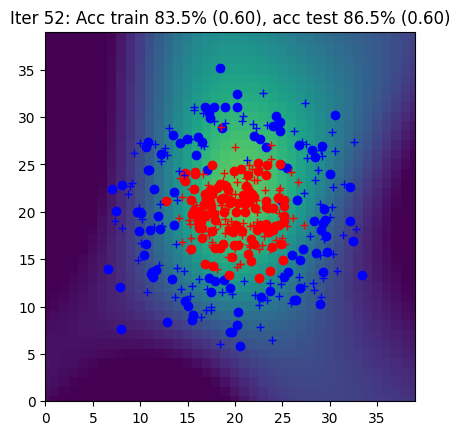

Iter 53: Acc train 83.0% (0.59), acc test 86.5% (0.59)


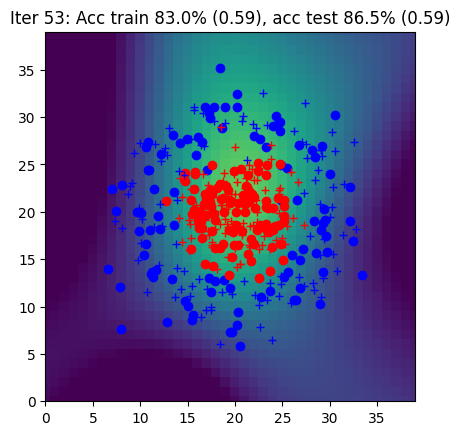

Iter 54: Acc train 83.0% (0.59), acc test 86.5% (0.59)


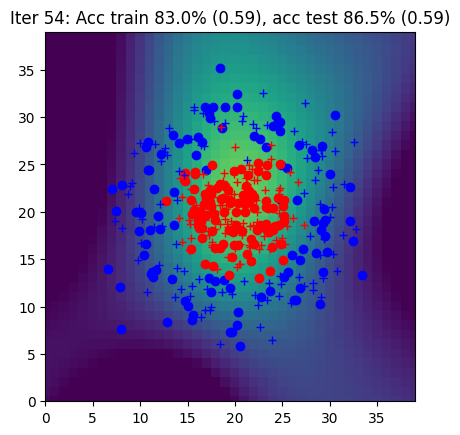

Iter 55: Acc train 83.0% (0.59), acc test 86.5% (0.58)


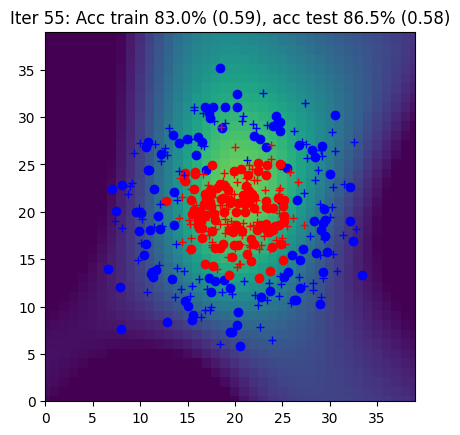

Iter 56: Acc train 83.0% (0.58), acc test 86.5% (0.58)


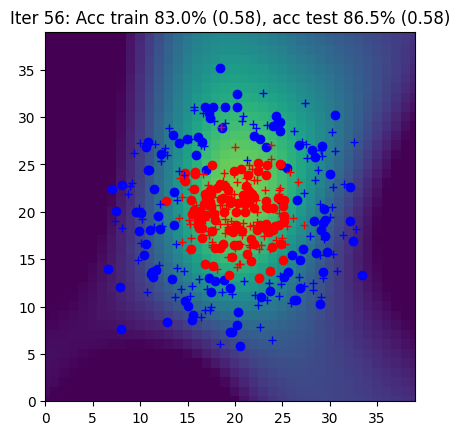

Iter 57: Acc train 83.0% (0.58), acc test 85.0% (0.58)


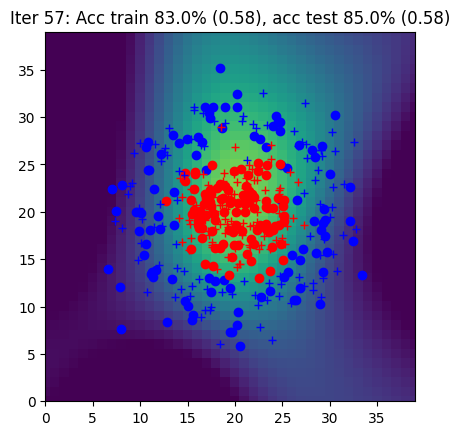

Iter 58: Acc train 83.5% (0.57), acc test 85.0% (0.57)


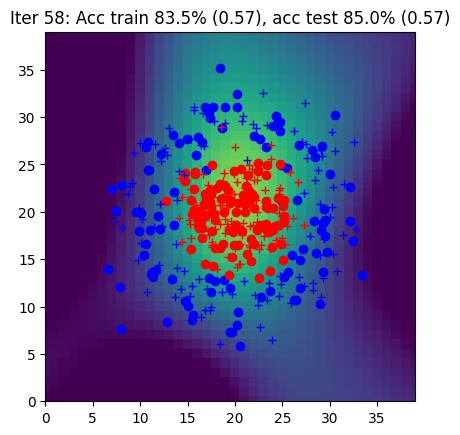

Iter 59: Acc train 84.5% (0.57), acc test 87.0% (0.57)


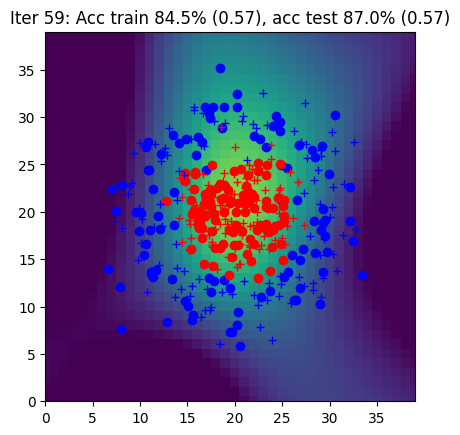

Iter 60: Acc train 84.5% (0.57), acc test 88.5% (0.56)


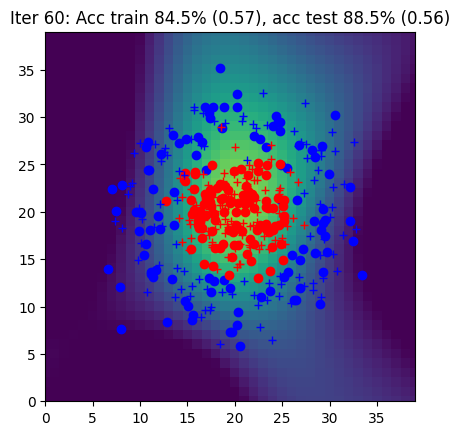

Iter 61: Acc train 84.5% (0.56), acc test 87.5% (0.56)


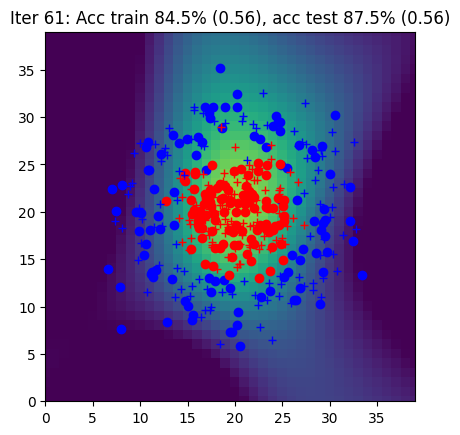

Iter 62: Acc train 84.5% (0.56), acc test 84.5% (0.55)


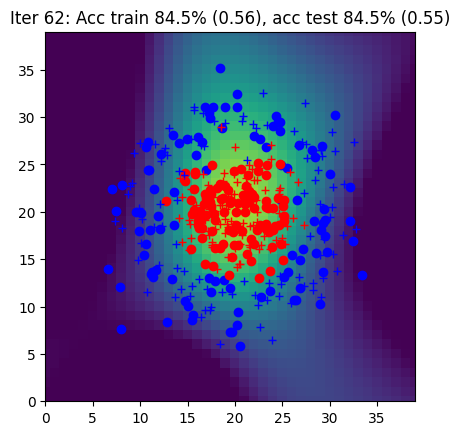

Iter 63: Acc train 85.0% (0.55), acc test 89.0% (0.55)


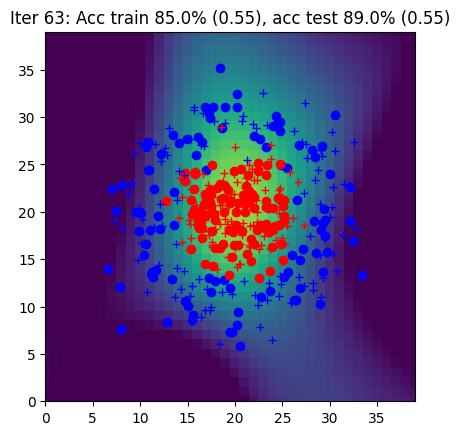

Iter 64: Acc train 84.5% (0.55), acc test 86.0% (0.54)


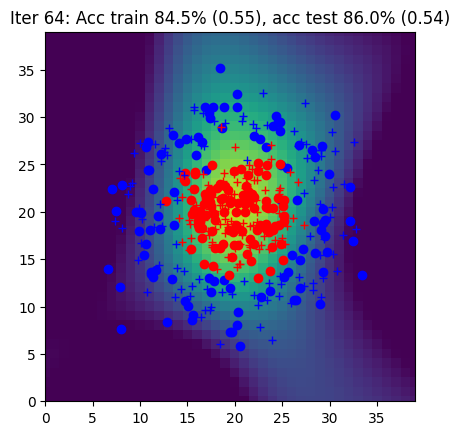

Iter 65: Acc train 84.5% (0.54), acc test 86.5% (0.54)


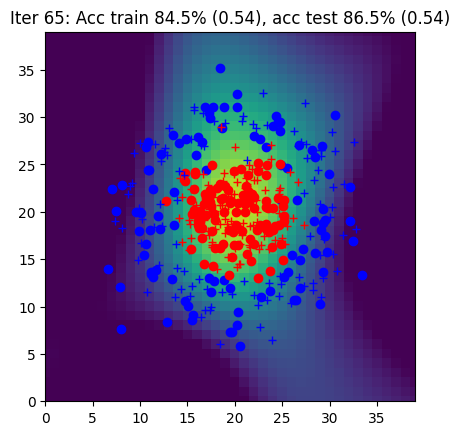

Iter 66: Acc train 85.0% (0.54), acc test 88.0% (0.53)


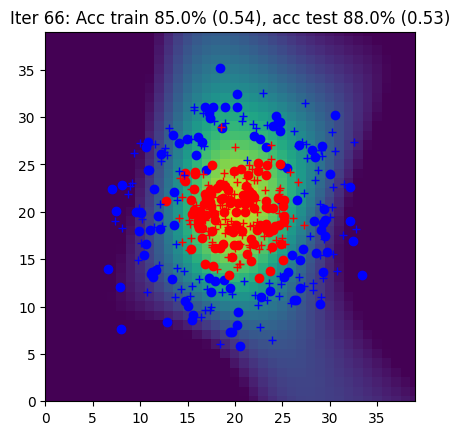

Iter 67: Acc train 83.5% (0.53), acc test 86.0% (0.53)


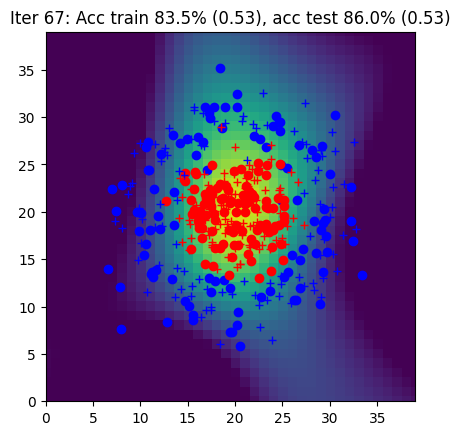

Iter 68: Acc train 85.5% (0.53), acc test 88.0% (0.52)


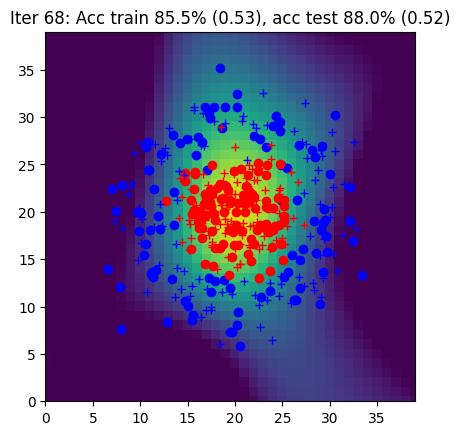

Iter 69: Acc train 86.0% (0.52), acc test 88.0% (0.52)


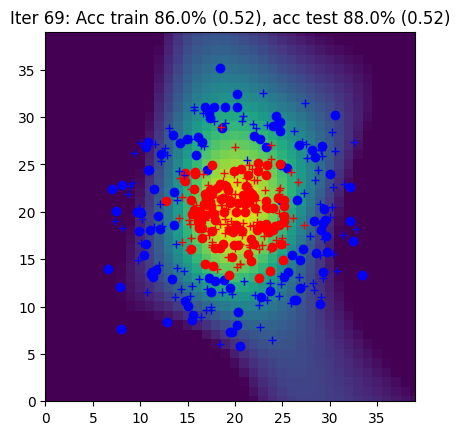

Iter 70: Acc train 88.0% (0.51), acc test 89.0% (0.51)


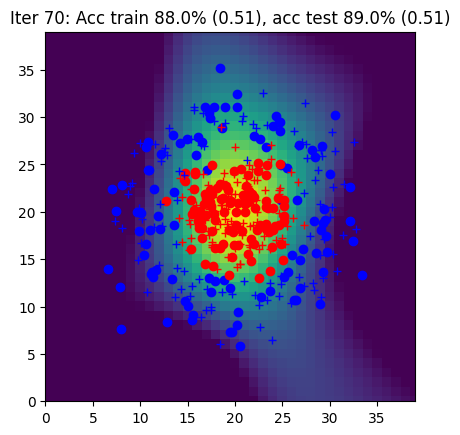

Iter 71: Acc train 88.0% (0.51), acc test 89.5% (0.51)


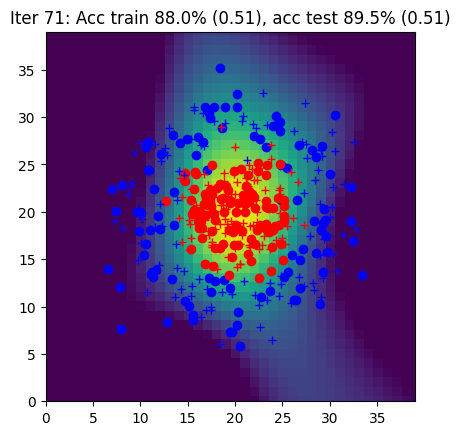

Iter 72: Acc train 91.0% (0.50), acc test 91.0% (0.50)


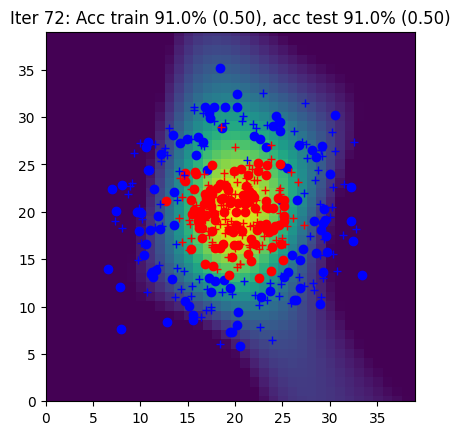

Iter 73: Acc train 91.0% (0.50), acc test 90.5% (0.50)


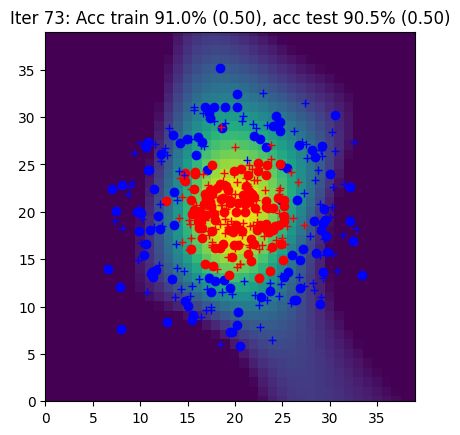

Iter 74: Acc train 91.0% (0.49), acc test 89.5% (0.49)


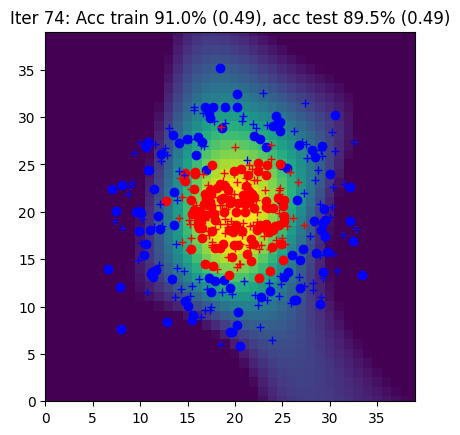

Iter 75: Acc train 91.0% (0.49), acc test 91.5% (0.48)


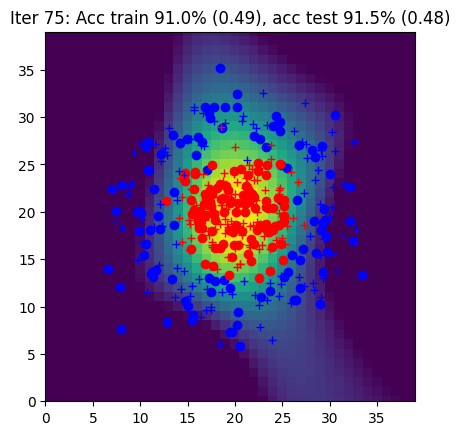

Iter 76: Acc train 91.0% (0.48), acc test 94.0% (0.48)


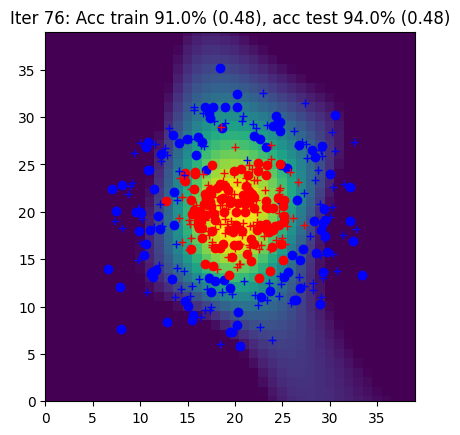

Iter 77: Acc train 91.5% (0.47), acc test 92.0% (0.47)


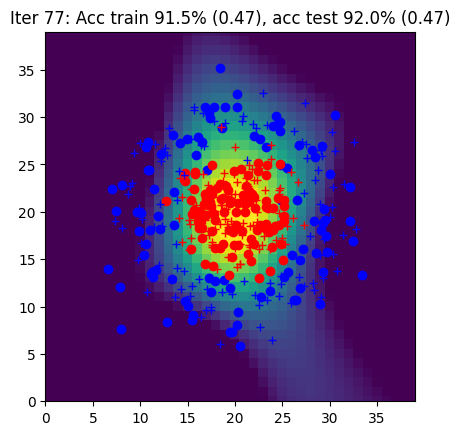

Iter 78: Acc train 91.5% (0.47), acc test 92.0% (0.47)


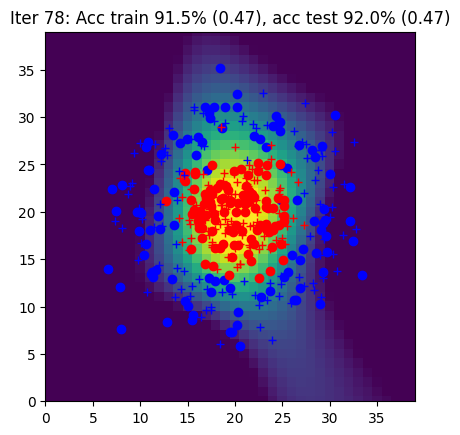

Iter 79: Acc train 91.5% (0.46), acc test 93.5% (0.46)


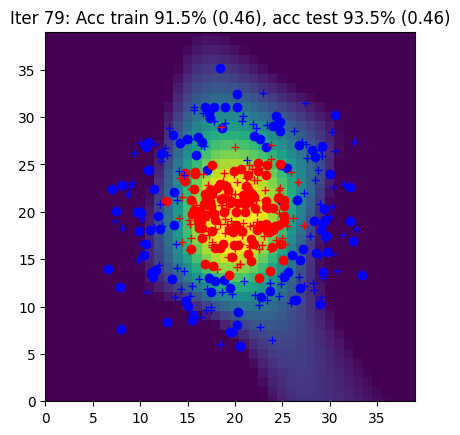

Iter 80: Acc train 91.5% (0.46), acc test 92.5% (0.46)


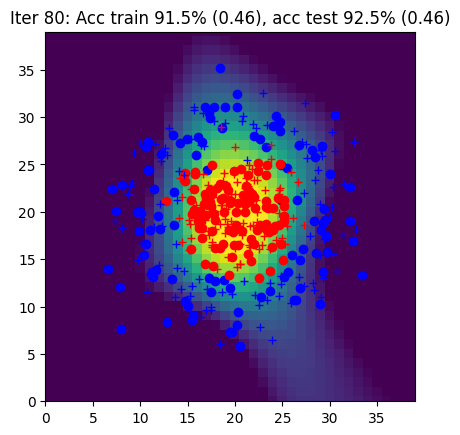

Iter 81: Acc train 91.5% (0.45), acc test 94.0% (0.45)


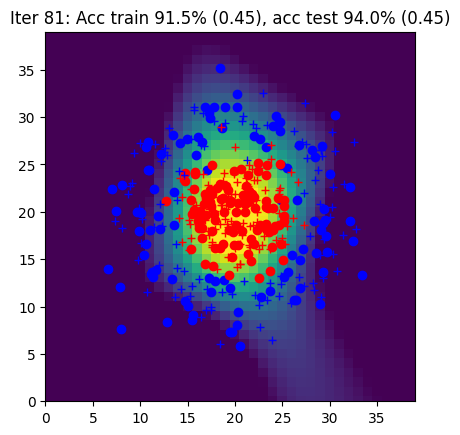

Iter 82: Acc train 91.5% (0.45), acc test 93.0% (0.45)


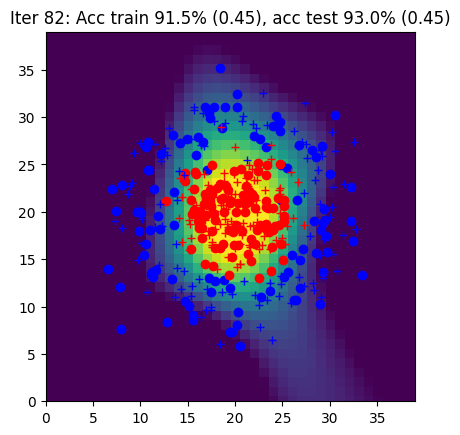

Iter 83: Acc train 90.5% (0.44), acc test 92.5% (0.44)


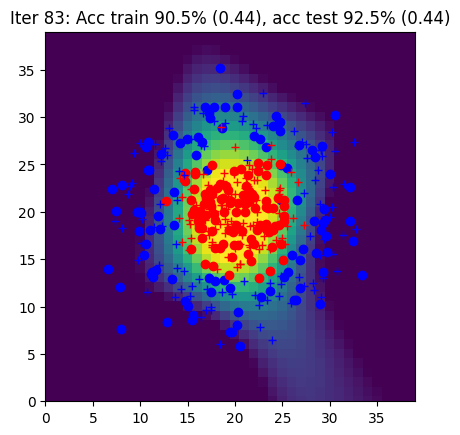

Iter 84: Acc train 92.0% (0.43), acc test 94.5% (0.43)


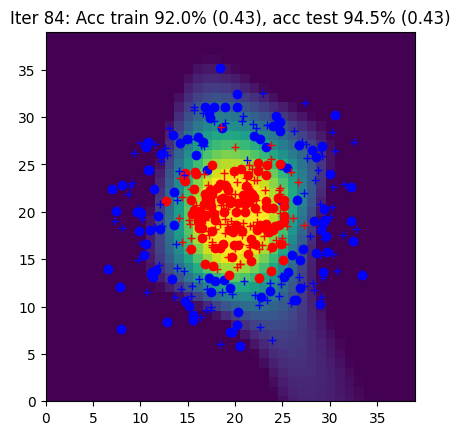

Iter 85: Acc train 93.5% (0.43), acc test 95.0% (0.43)


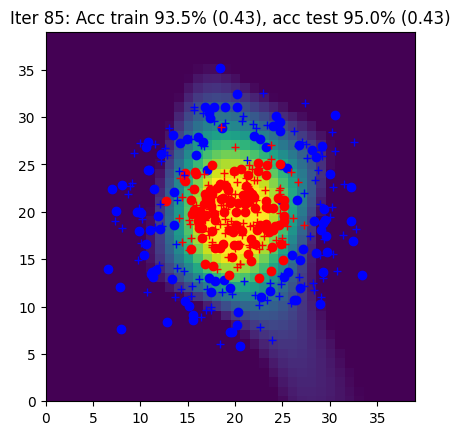

Iter 86: Acc train 91.0% (0.42), acc test 94.0% (0.42)


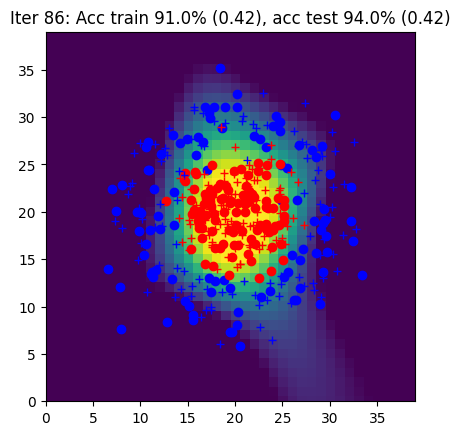

Iter 87: Acc train 93.5% (0.42), acc test 94.0% (0.42)


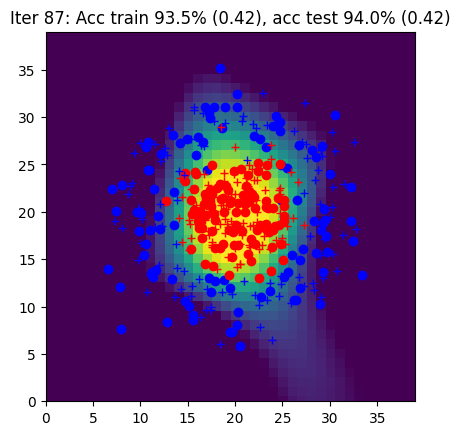

Iter 88: Acc train 93.5% (0.41), acc test 95.0% (0.41)


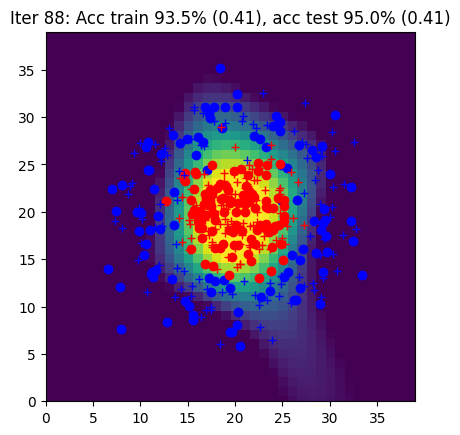

Iter 89: Acc train 93.5% (0.40), acc test 95.0% (0.41)


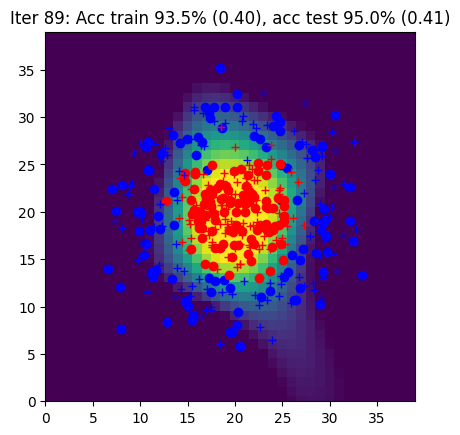

Iter 90: Acc train 93.5% (0.40), acc test 94.0% (0.40)


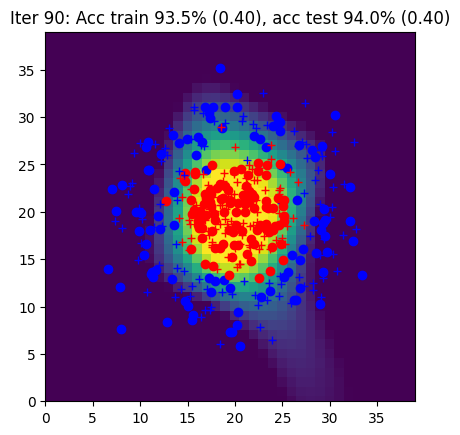

Iter 91: Acc train 94.0% (0.39), acc test 94.0% (0.40)


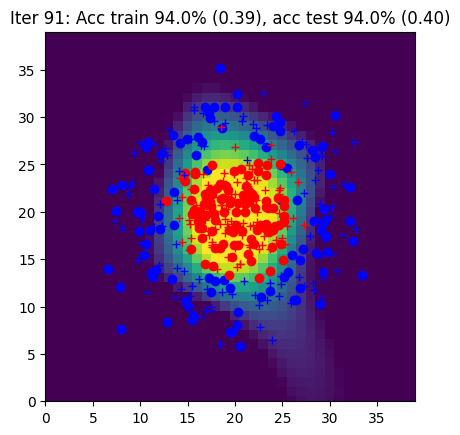

Iter 92: Acc train 93.5% (0.39), acc test 94.0% (0.39)


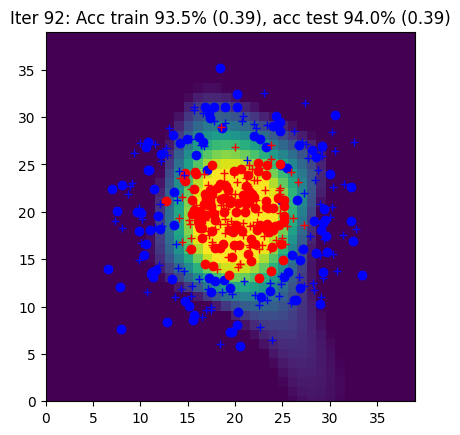

Iter 93: Acc train 93.0% (0.38), acc test 94.5% (0.39)


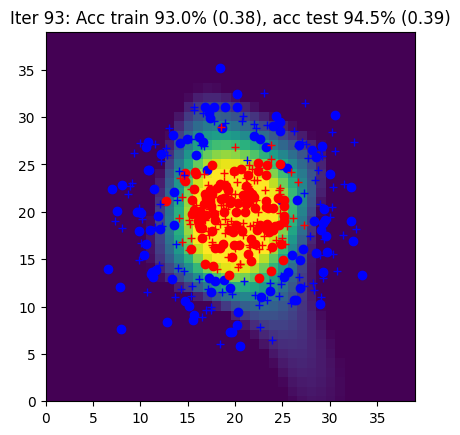

Iter 94: Acc train 93.5% (0.38), acc test 94.0% (0.38)


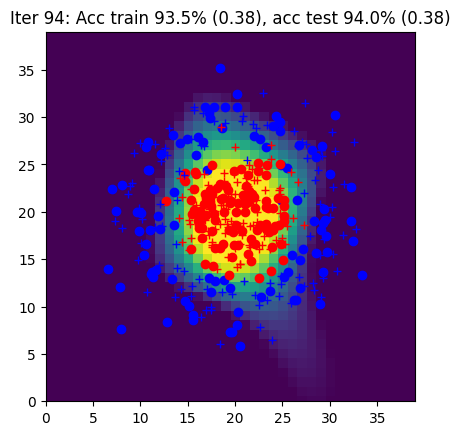

Iter 95: Acc train 93.5% (0.37), acc test 94.0% (0.38)


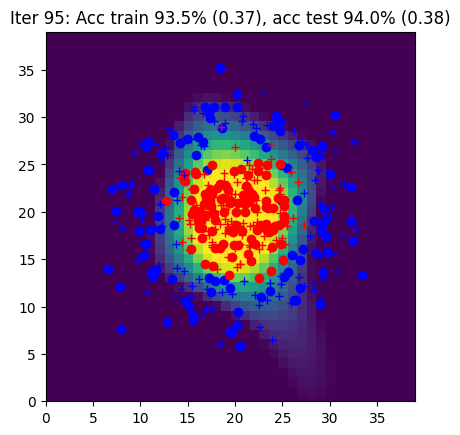

Iter 96: Acc train 93.5% (0.37), acc test 94.0% (0.37)


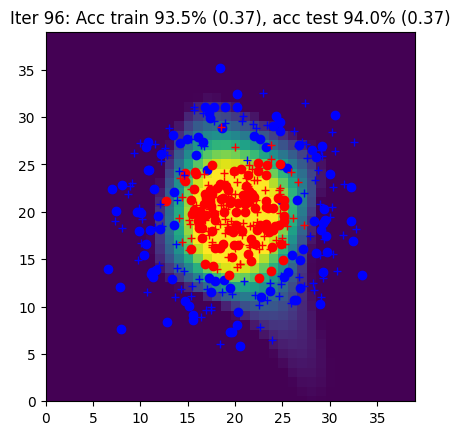

Iter 97: Acc train 95.0% (0.36), acc test 94.0% (0.37)


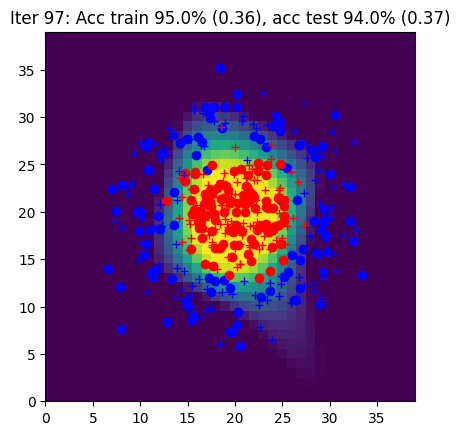

Iter 98: Acc train 95.5% (0.36), acc test 94.5% (0.36)


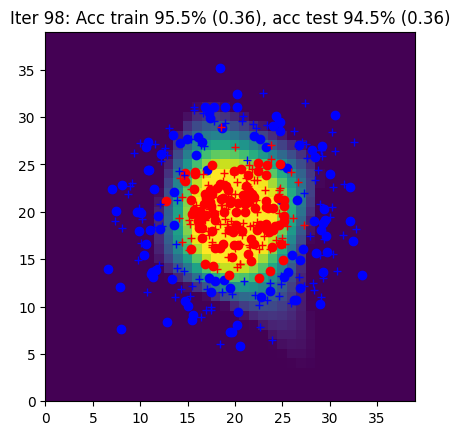

Iter 99: Acc train 93.5% (0.35), acc test 94.0% (0.36)


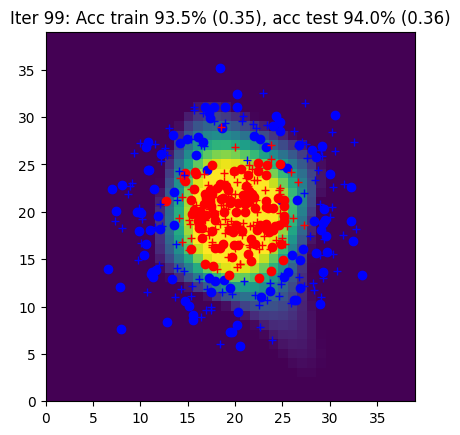

Iter 100: Acc train 95.5% (0.35), acc test 94.0% (0.35)


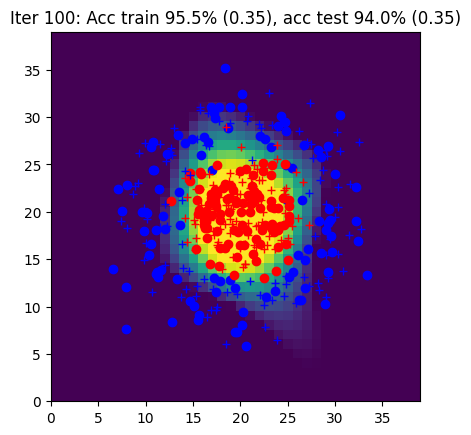

Iter 101: Acc train 95.0% (0.34), acc test 94.0% (0.35)


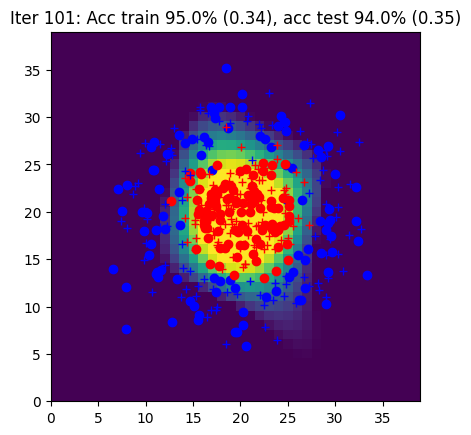

Iter 102: Acc train 95.0% (0.34), acc test 94.5% (0.34)


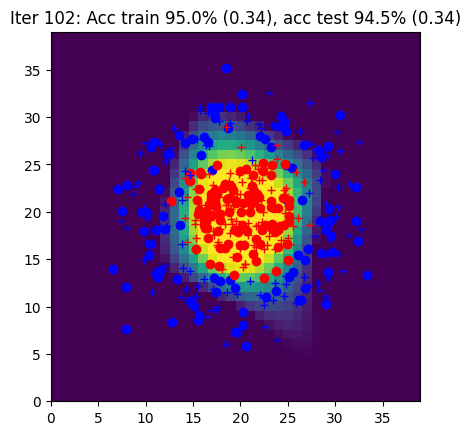

Iter 103: Acc train 94.5% (0.33), acc test 94.0% (0.34)


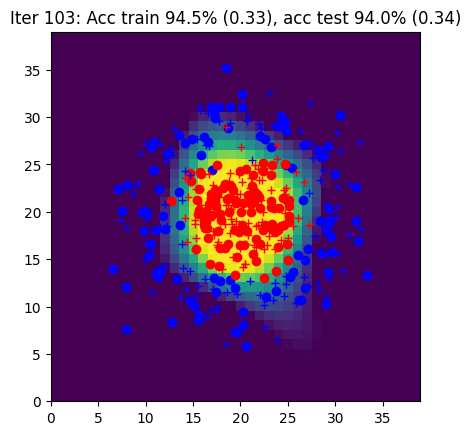

Iter 104: Acc train 94.0% (0.33), acc test 94.0% (0.33)


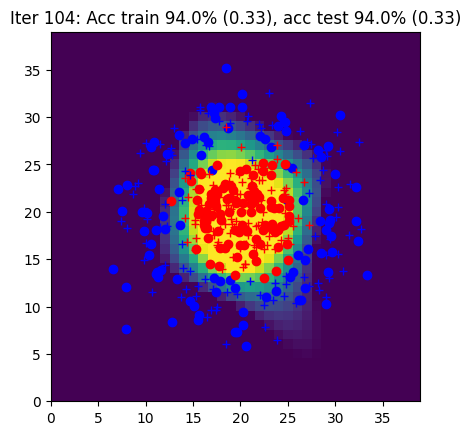

Iter 105: Acc train 95.0% (0.32), acc test 94.5% (0.33)


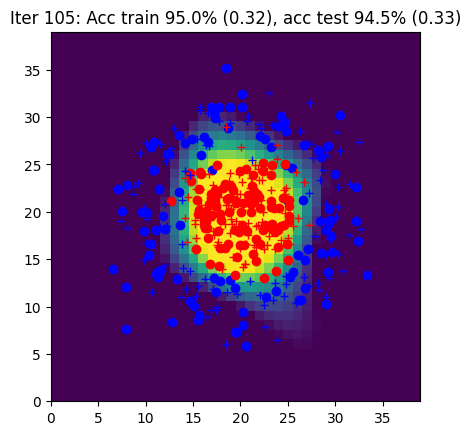

Iter 106: Acc train 93.5% (0.32), acc test 94.5% (0.33)


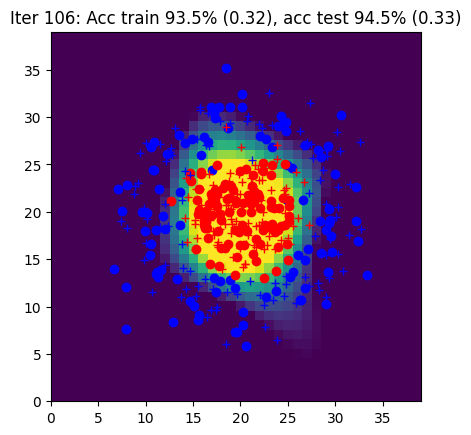

Iter 107: Acc train 95.0% (0.32), acc test 94.0% (0.32)


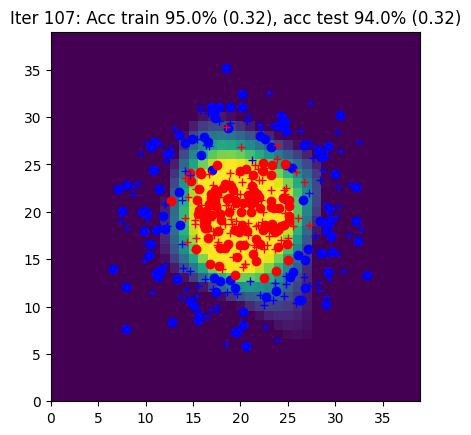

Iter 108: Acc train 94.5% (0.31), acc test 93.5% (0.32)


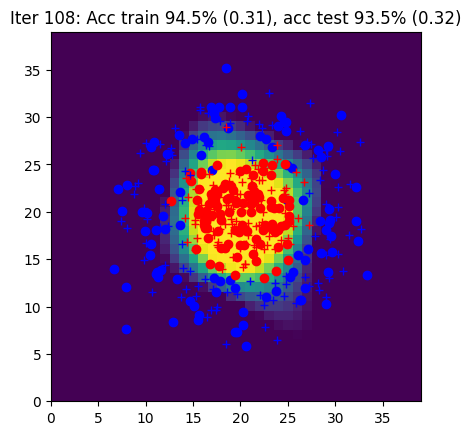

Iter 109: Acc train 96.5% (0.31), acc test 94.5% (0.31)


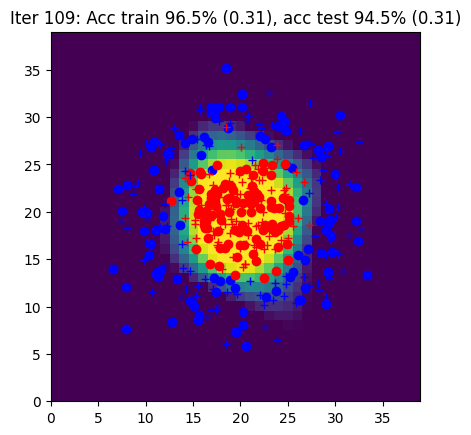

Iter 110: Acc train 95.5% (0.30), acc test 94.5% (0.31)


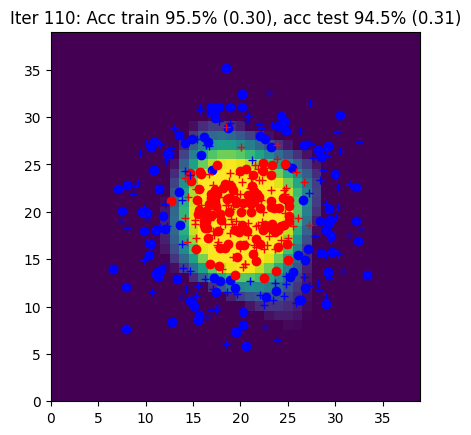

Iter 111: Acc train 96.5% (0.30), acc test 94.0% (0.31)


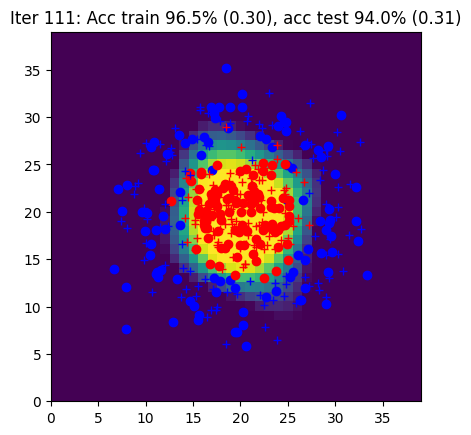

Iter 112: Acc train 96.0% (0.30), acc test 94.0% (0.30)


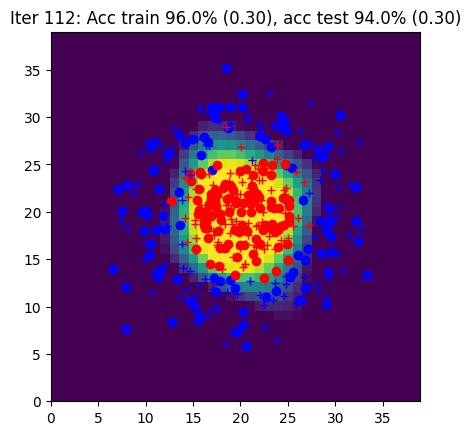

Iter 113: Acc train 96.0% (0.29), acc test 94.5% (0.30)


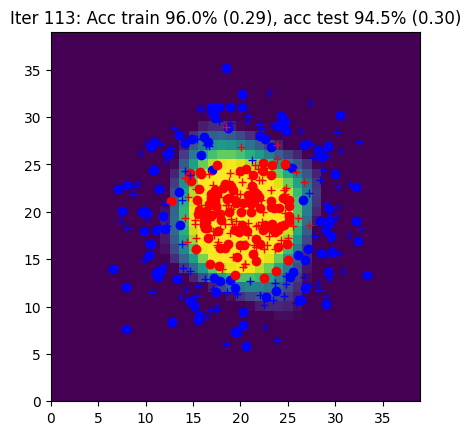

Iter 114: Acc train 96.0% (0.29), acc test 94.0% (0.30)


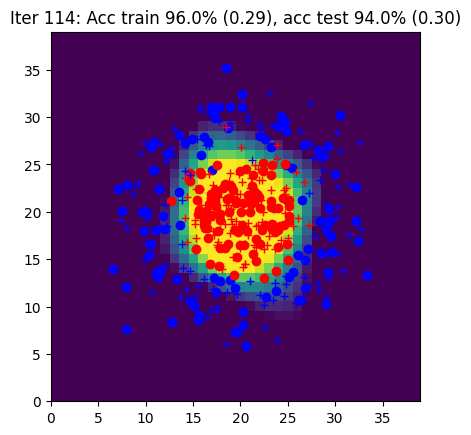

Iter 115: Acc train 95.5% (0.29), acc test 94.0% (0.29)


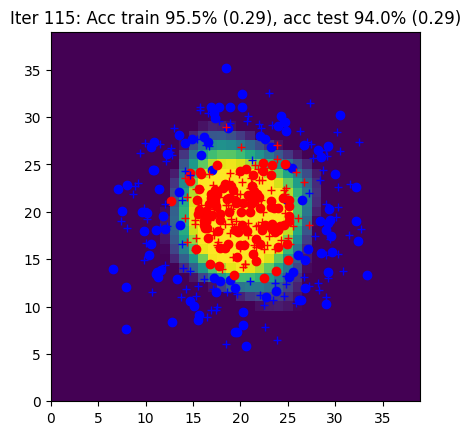

Iter 116: Acc train 96.0% (0.28), acc test 94.5% (0.29)


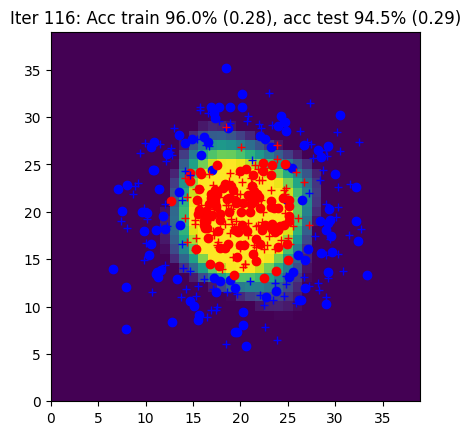

Iter 117: Acc train 96.0% (0.28), acc test 94.0% (0.29)


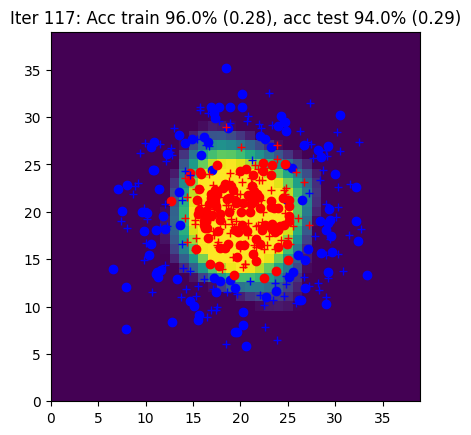

Iter 118: Acc train 96.0% (0.28), acc test 94.5% (0.28)


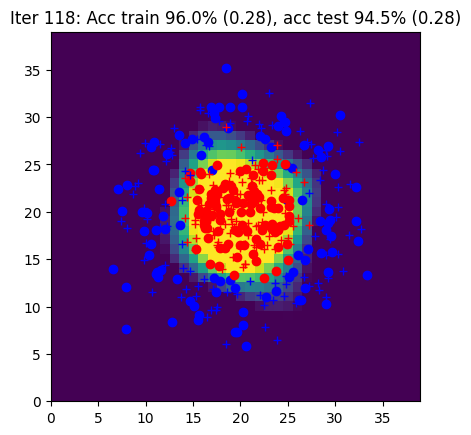

Iter 119: Acc train 96.0% (0.27), acc test 94.5% (0.28)


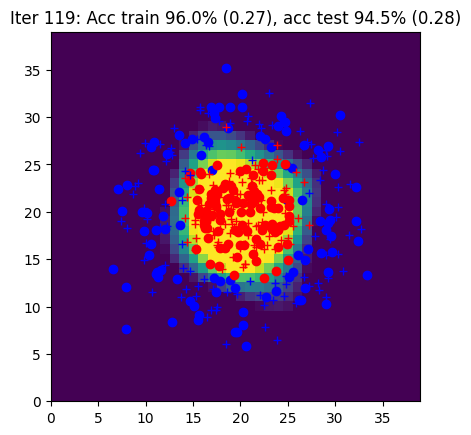

Iter 120: Acc train 96.0% (0.27), acc test 93.5% (0.28)


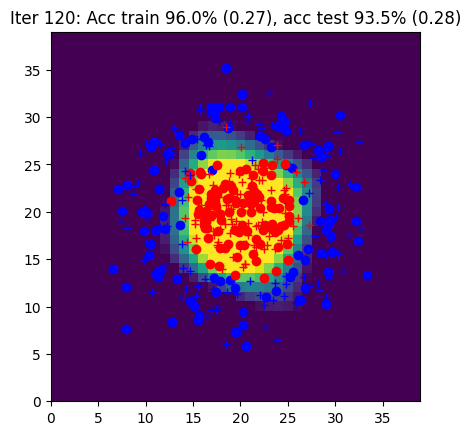

Iter 121: Acc train 96.0% (0.27), acc test 94.5% (0.28)


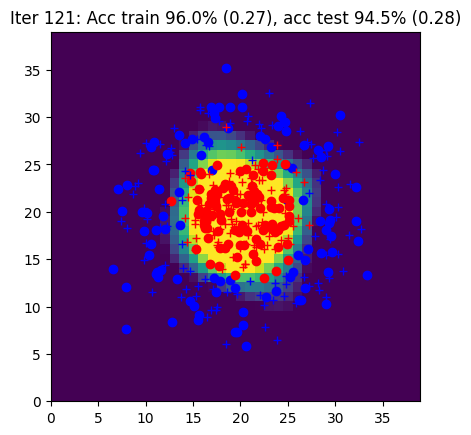

Iter 122: Acc train 95.5% (0.26), acc test 94.5% (0.27)


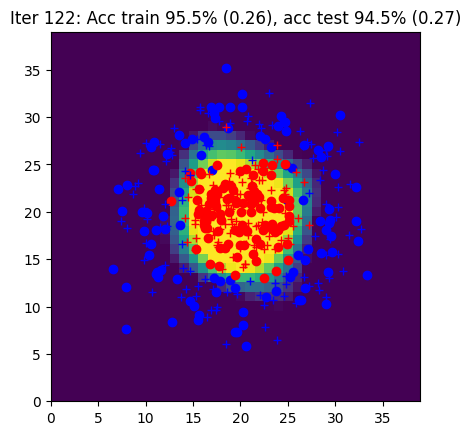

Iter 123: Acc train 96.0% (0.26), acc test 94.5% (0.27)


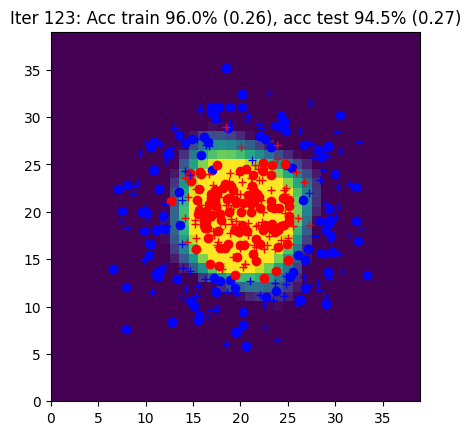

Iter 124: Acc train 96.0% (0.26), acc test 94.5% (0.27)


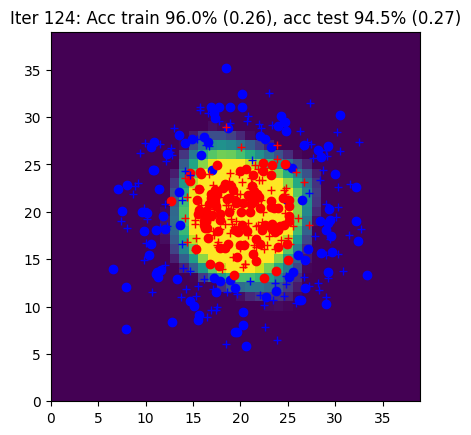

Iter 125: Acc train 96.5% (0.26), acc test 94.0% (0.27)


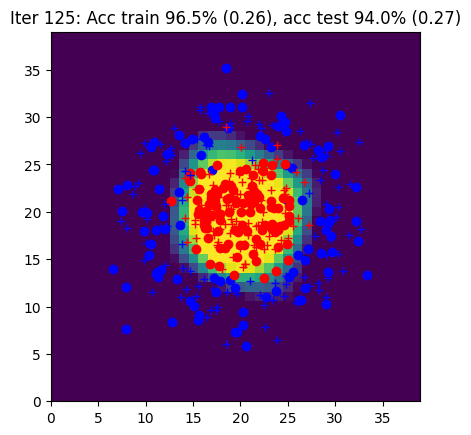

Iter 126: Acc train 95.5% (0.25), acc test 94.0% (0.26)


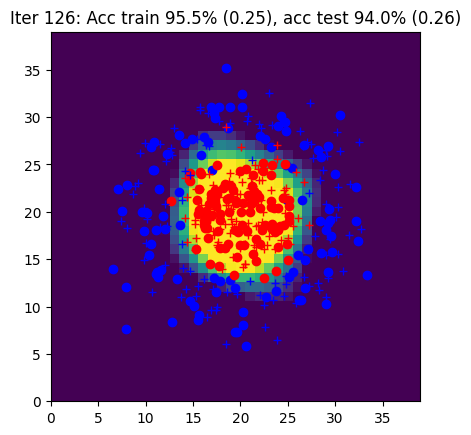

Iter 127: Acc train 95.5% (0.25), acc test 94.5% (0.26)


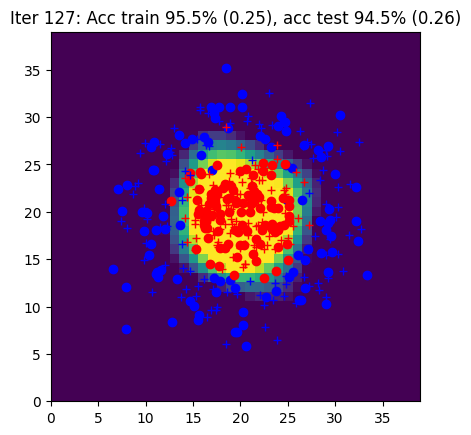

Iter 128: Acc train 95.5% (0.25), acc test 94.0% (0.26)


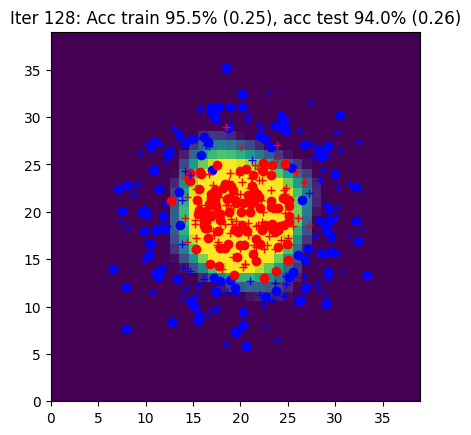

Iter 129: Acc train 96.5% (0.25), acc test 94.0% (0.26)


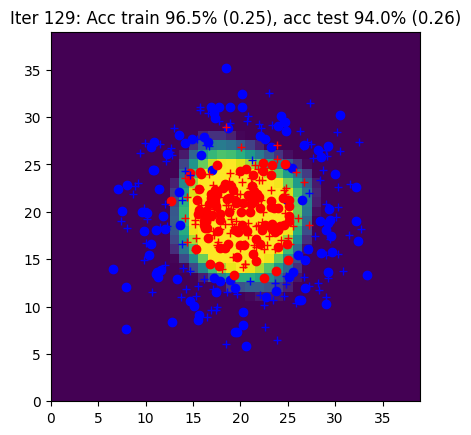

Iter 130: Acc train 96.5% (0.25), acc test 94.0% (0.25)


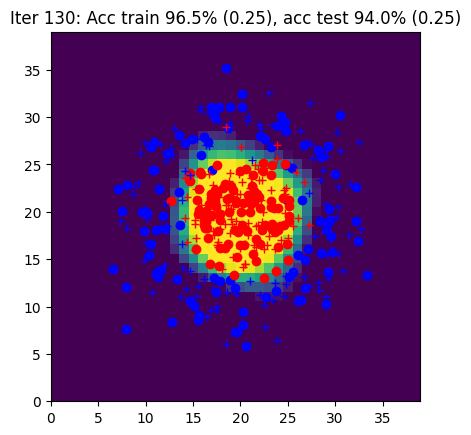

Iter 131: Acc train 96.0% (0.24), acc test 94.0% (0.25)


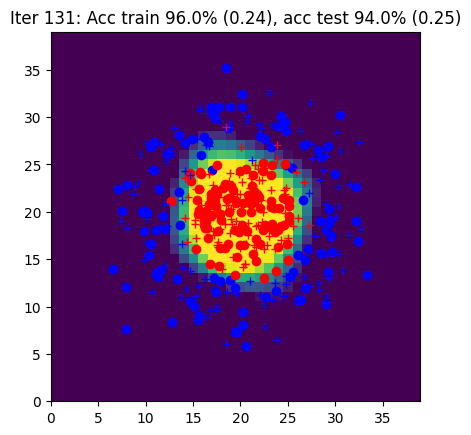

Iter 132: Acc train 95.5% (0.24), acc test 94.5% (0.25)


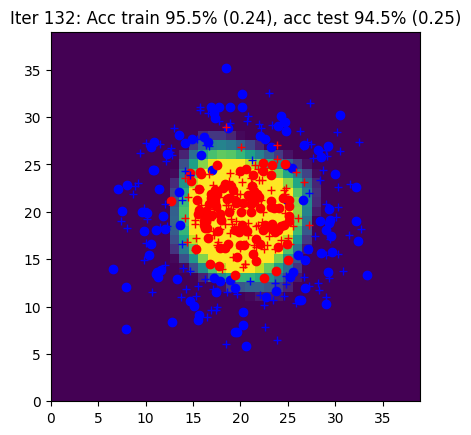

Iter 133: Acc train 96.0% (0.24), acc test 94.5% (0.25)


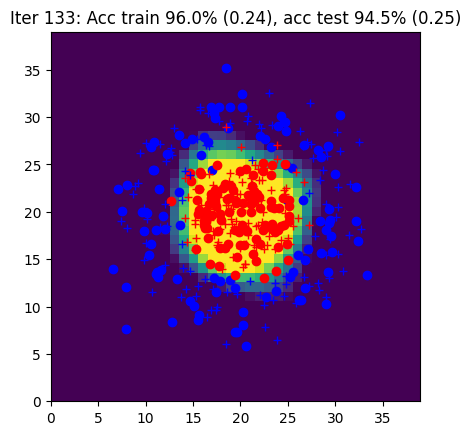

Iter 134: Acc train 96.0% (0.24), acc test 94.0% (0.24)


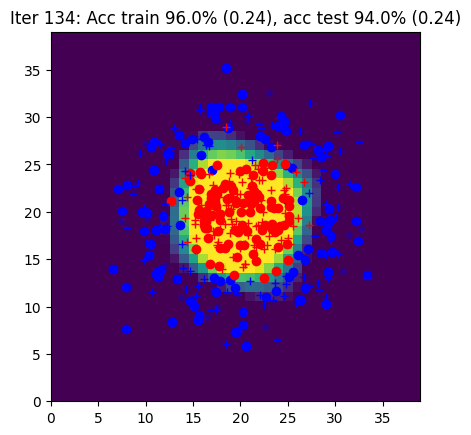

Iter 135: Acc train 96.0% (0.23), acc test 94.5% (0.24)


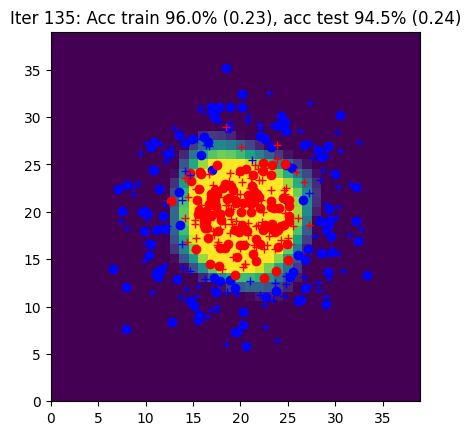

Iter 136: Acc train 96.0% (0.23), acc test 94.5% (0.24)


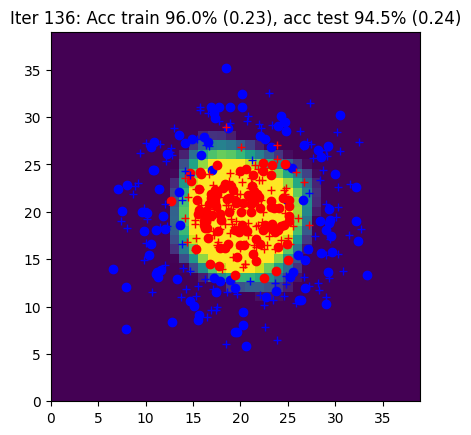

Iter 137: Acc train 96.0% (0.23), acc test 94.5% (0.24)


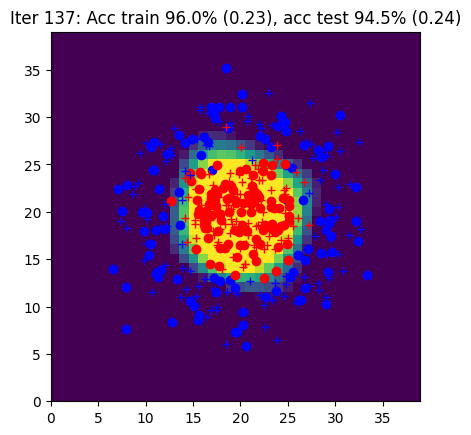

Iter 138: Acc train 96.0% (0.23), acc test 94.5% (0.24)


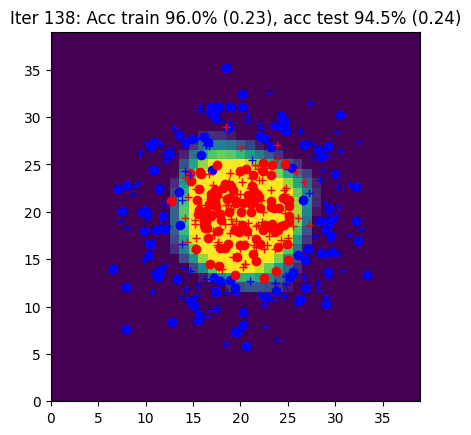

Iter 139: Acc train 96.0% (0.23), acc test 94.5% (0.24)


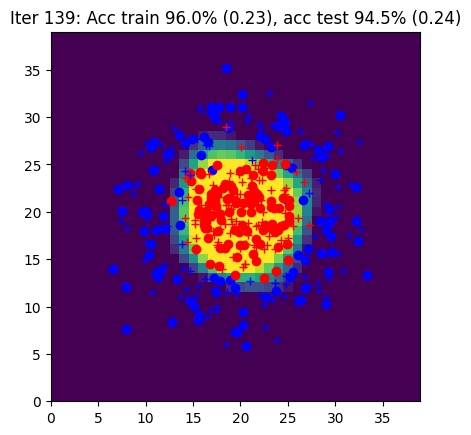

Iter 140: Acc train 95.0% (0.23), acc test 94.5% (0.24)


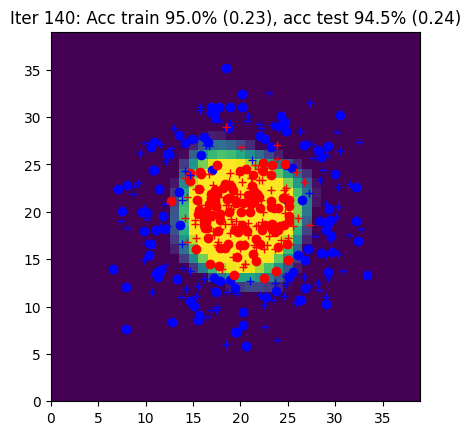

Iter 141: Acc train 95.5% (0.22), acc test 94.5% (0.23)


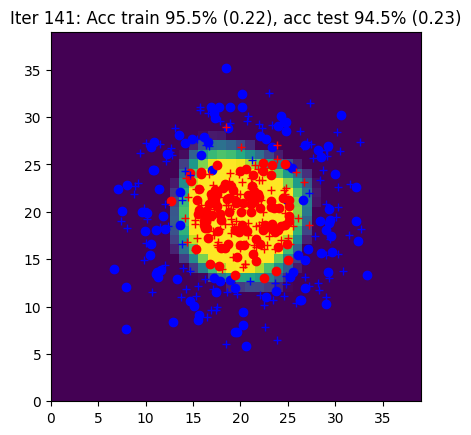

Iter 142: Acc train 96.0% (0.22), acc test 94.0% (0.23)


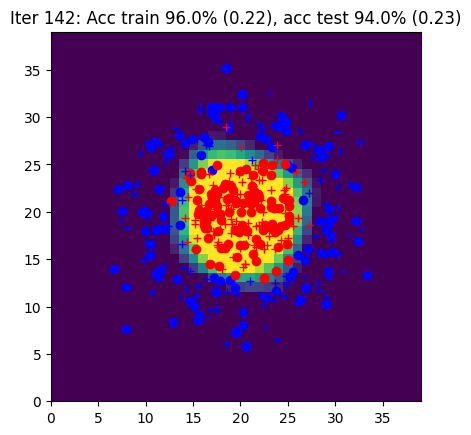

Iter 143: Acc train 96.0% (0.22), acc test 94.5% (0.23)


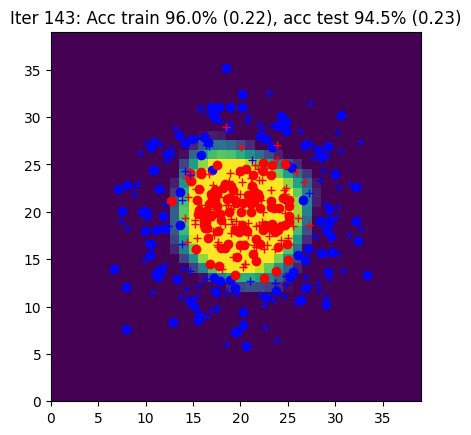

Iter 144: Acc train 96.0% (0.22), acc test 94.5% (0.23)


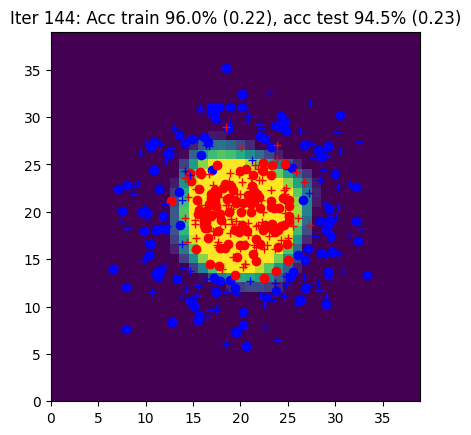

Iter 145: Acc train 96.0% (0.22), acc test 94.5% (0.23)


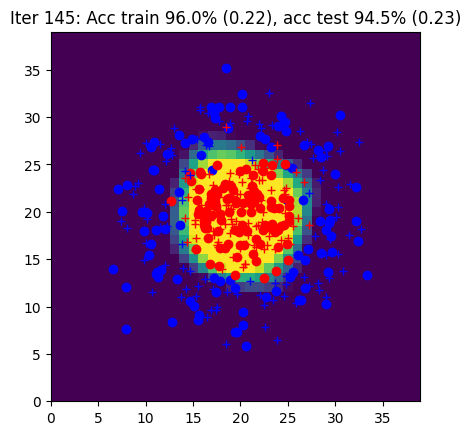

Iter 146: Acc train 96.0% (0.22), acc test 94.5% (0.22)


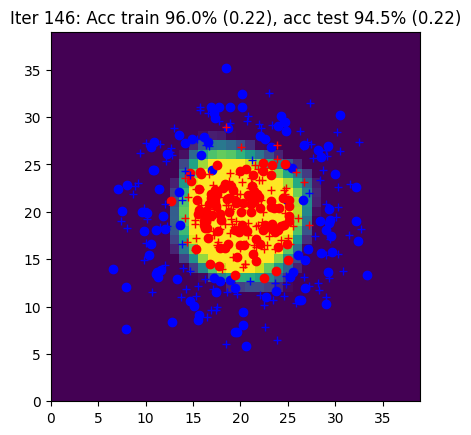

Iter 147: Acc train 96.0% (0.21), acc test 94.5% (0.22)


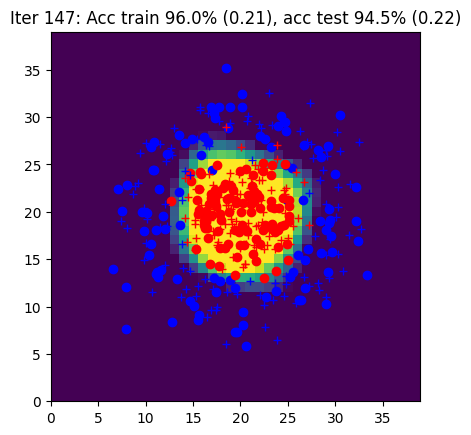

Iter 148: Acc train 96.0% (0.21), acc test 94.5% (0.22)


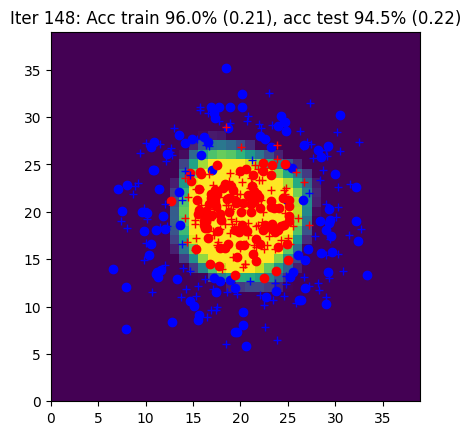

Iter 149: Acc train 96.0% (0.21), acc test 94.5% (0.22)


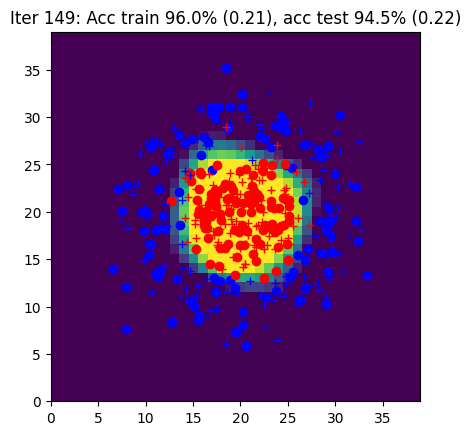

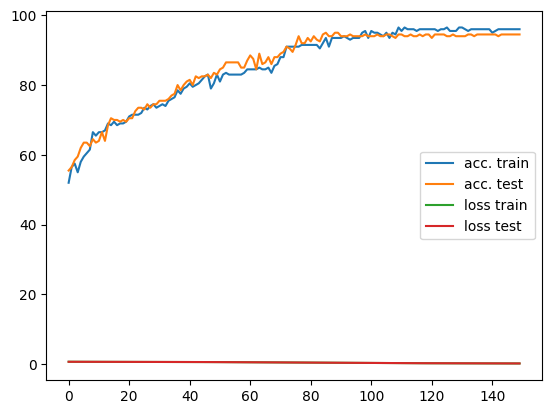

In [ ]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss, optim = init_model(nx, nh, ny, eta)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code  here ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: loss_accuracy
        # the forward with the predict method from the model
        # the backward function with autograd
        # and then an optimization step
        optim.zero_grad()
        Yhat = model(X)
        Y_labels = torch.argmax(Y, dim=1)
        L = loss(Yhat, Y_labels)
        L.backward()
        optim.step()



    ####################
    ##      FIN        #
    ####################


    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)
    Ygrid = model(data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(torch.nn.Softmax(dim=1)(Ygrid.detach()), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 5 : MNIST

Apply the code from previous part code to the MNIST dataset.

Iter 0: Acc train 86.2% (0.51), acc test 87.1% (0.50)
Iter 1: Acc train 86.1% (0.50), acc test 86.3% (0.49)
Iter 2: Acc train 86.9% (0.46), acc test 87.6% (0.44)
Iter 3: Acc train 88.2% (0.39), acc test 88.5% (0.38)
Iter 4: Acc train 87.4% (0.43), acc test 88.1% (0.41)
Iter 5: Acc train 88.2% (0.38), acc test 88.6% (0.37)
Iter 6: Acc train 86.7% (0.44), acc test 87.3% (0.43)
Iter 7: Acc train 88.1% (0.40), acc test 88.2% (0.39)
Iter 8: Acc train 89.1% (0.36), acc test 89.5% (0.36)
Iter 9: Acc train 88.7% (0.38), acc test 89.2% (0.37)
Iter 10: Acc train 88.5% (0.37), acc test 88.6% (0.37)
Iter 11: Acc train 89.4% (0.35), acc test 89.4% (0.35)
Iter 12: Acc train 89.7% (0.35), acc test 89.6% (0.35)
Iter 13: Acc train 88.8% (0.37), acc test 89.0% (0.36)
Iter 14: Acc train 89.9% (0.34), acc test 90.7% (0.32)
Iter 15: Acc train 89.0% (0.36), acc test 89.0% (0.35)
Iter 16: Acc train 89.5% (0.35), acc test 89.8% (0.34)
Iter 17: Acc train 89.4% (0.35), acc test 89.8% (0.33)
Iter 18: Acc train 8

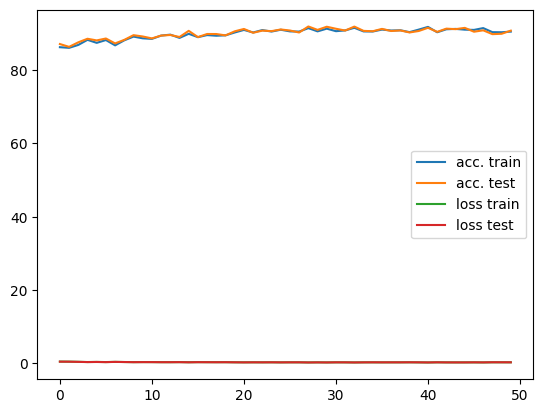

In [ ]:
data = MNISTData()
N = data.Xtrain.shape[0]
Nbatch = 100
nx = data.Xtrain.shape[1]
nh = 100
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss, optim = init_model(nx, nh, ny, eta)

curves = [[],[], [], []]

for iteration in range(50):
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    for j in range(N // Nbatch):
        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        optim.zero_grad()
        Yhat = model(X)
        Y_labels = torch.argmax(Y, dim=1)
        L = loss(Yhat, Y_labels)
        L.backward()
        optim.step()

    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# **Analyse des resultats**

### Differences between the Parts:

All the initial parts (1-4) ultimately achieve the same goal of training a neural network for the Circles dataset the model train well on training dataset then it acheived a good close results in test data (0.95 accuracy) which that it generilizes well, we saw increase in the accuracy across iterations and deacrease in loss and all are leading to similar results. The key difference lies in the level of abstraction and simplification provided by PyTorch's features. Part 5 then demonstrates this abstracted approach on a new dataset (MNIST)

*   **Part 1: Forward and backward passes "by hands"**
    *   **Description:** This section manually implements all aspects of a neural network, including parameter initialization, the forward pass (matrix multiplications, activation functions), the loss calculation, and the *entire backward pass* (manual computation of gradients for each parameter).

*   **Part 2: Simplification of the backward pass with `torch.autograd`**
    *   **Description:** Introduces PyTorch's `autograd` engine. Instead of manually implementing the backward pass, we enable gradient tracking (`requires_grad_()`) for parameters. Calling `L.backward()` automatically computes all necessary gradients. The `sgd_autograd` function then uses these automatically computed gradients for parameter updates and zeros them out.

*   **Part 3: Simplification of the forward pass with `torch.nn`**
    *   **Description:** Leverages PyTorch's `torch.nn` module to define the network architecture. The `init_model` function uses `torch.nn.Sequential` to stack layers like `torch.nn.Linear` and `torch.nn.Tanh`. A standard `torch.nn.CrossEntropyLoss` is used for loss calculation. The `sgd` function still manually updates parameters but iterates through `model.parameters()`.

*   **Part 4: Simplification of the SGD with `torch.optim`**
    *   **Description:** Introduces PyTorch's `torch.optim` module, specifically `torch.optim.SGD`. This completely replaces the custom `sgd` function. Optimization steps are handled by `optim.zero_grad()` to clear old gradients, and `optim.step()` to update parameters based on the computed gradients.

*   **Part 5: MNIST**
    *   **Description:** This part applies the fully abstracted and simplified training procedure developed in Part 4 to the MNIST dataset, which is a more complex dataset compared to the Circles dataset used in previous parts.

# Part 6: Bonus: SVM


Train a SVM model on the Circles dataset.

Ideas :
- First try a linear SVM (sklearn.svm.LinearSVC dans scikit-learn). Does it work well ? Why ?
- Then try more complex kernels (sklearn.svm.SVC). Which one is the best ? why ?
- Does the parameter C of regularization have an impact? Why ?

In [ ]:
# data
data = CirclesData()
Xtrain = data.Xtrain.numpy()
Ytrain = data.Ytrain[:, 0].numpy()

Xgrid = data.Xgrid.numpy()

Xtest = data.Xtest.numpy()
Ytest = data.Ytest[:, 0].numpy()

def plot_svm_predictions(data, predictions):
      plt.figure(2)
      plt.clf()
      plt.imshow(np.reshape(predictions, (40,40)))
      plt.plot(data._Xtrain[data._Ytrain[:,0] == 1,0]*10+20, data._Xtrain[data._Ytrain[:,0] == 1,1]*10+20, 'bo', label="Train")
      plt.plot(data._Xtrain[data._Ytrain[:,1] == 1,0]*10+20, data._Xtrain[data._Ytrain[:,1] == 1,1]*10+20, 'ro')
      plt.plot(data._Xtest[data._Ytest[:,0] == 1,0]*10+20, data._Xtest[data._Ytest[:,0] == 1,1]*10+20, 'b+', label="Test")
      plt.plot(data._Xtest[data._Ytest[:,1] == 1,0]*10+20, data._Xtest[data._Ytest[:,1] == 1,1]*10+20, 'r+')
      plt.xlim(0,39)
      plt.ylim(0,39)
      plt.clim(0.3,0.7)
      plt.draw()
      plt.pause(1e-3)

Linear SVM Accuracy: 53.00%


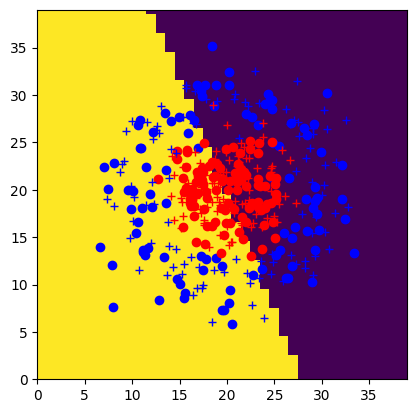

RBF Kernel SVM Accuracy: 94.00%


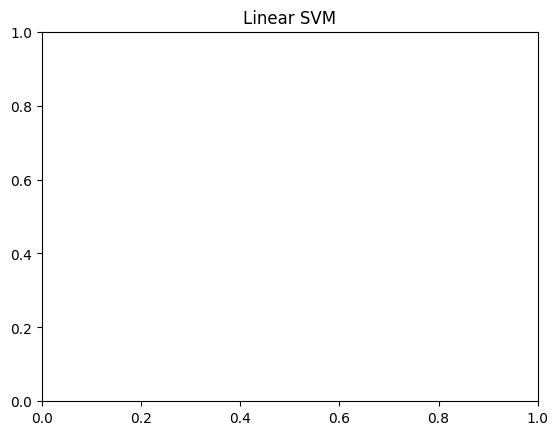

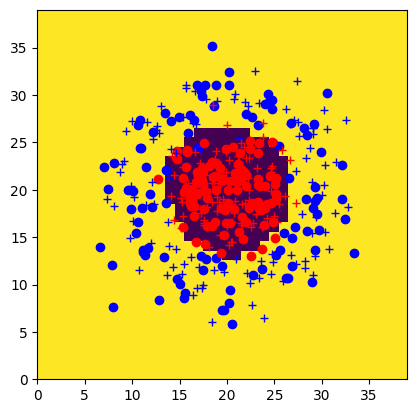

Polynomial Kernel SVM Accuracy: 54.50%


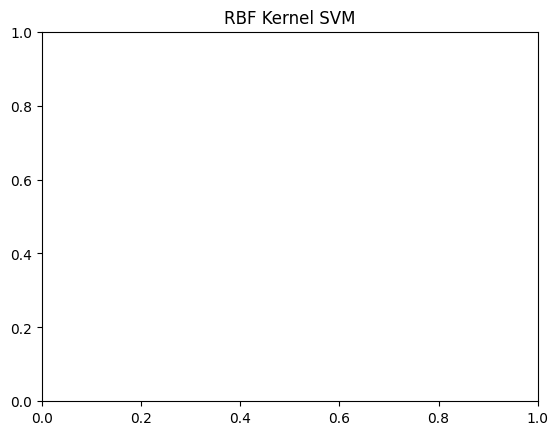

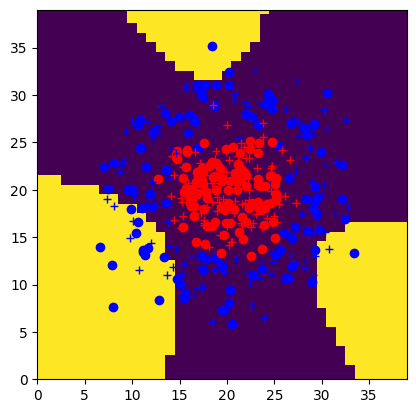

Effect of C parameter on RBF SVM:
C=0.01 -> Accuracy: 95.00%
C=0.1 -> Accuracy: 95.00%
C=1 -> Accuracy: 94.00%
C=10 -> Accuracy: 93.50%
C=100 -> Accuracy: 93.00%


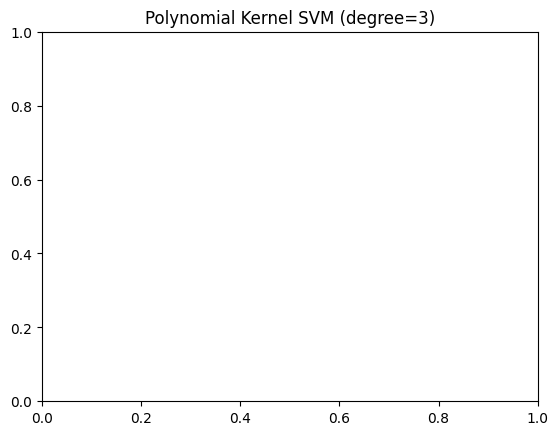

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.svm import LinearSVC, SVC

# Linear SVM
linear_svm = LinearSVC(C=1.0, max_iter=5000)
linear_svm.fit(Xtrain, Ytrain)

Ytest_pred_linear = linear_svm.predict(Xtest)
accuracy_linear = (Ytest_pred_linear == Ytest).mean()
print(f"Linear SVM Accuracy: {100 * accuracy_linear:.2f}%")

Ygrid_pred_linear = linear_svm.predict(Xgrid)
plot_svm_predictions(data, Ygrid_pred_linear)
plt.title("Linear SVM")

# RBF Kernel SVM
svm_rbf = SVC(kernel='rbf', C=1.0, gamma='scale')
svm_rbf.fit(Xtrain, Ytrain)

Ytest_pred_rbf = svm_rbf.predict(Xtest)
accuracy_rbf = (Ytest_pred_rbf == Ytest).mean()
print(f"RBF Kernel SVM Accuracy: {100 * accuracy_rbf:.2f}%")

Ygrid_pred_rbf = svm_rbf.predict(Xgrid)
plot_svm_predictions(data, Ygrid_pred_rbf)
plt.title("RBF Kernel SVM")

# Polynomial Kernel SVM
svm_poly = SVC(kernel='poly', degree=3, C=1.0)
svm_poly.fit(Xtrain, Ytrain)

Ytest_pred_poly = svm_poly.predict(Xtest)
accuracy_poly = (Ytest_pred_poly == Ytest).mean()
print(f"Polynomial Kernel SVM Accuracy: {100 * accuracy_poly:.2f}%")

Ygrid_pred_poly = svm_poly.predict(Xgrid)
plot_svm_predictions(data, Ygrid_pred_poly)
plt.title("Polynomial Kernel SVM (degree=3)")

# Effect of C (Regularization)
print("Effect of C parameter on RBF SVM:")
for C_val in [0.01, 0.1, 1, 10, 100]:
    svm_rbf_C = SVC(kernel='rbf', C=C_val, gamma='scale')
    svm_rbf_C.fit(Xtrain, Ytrain)
    acc = (svm_rbf_C.predict(Xtest) == Ytest).mean()
    print(f"C={C_val} -> Accuracy: {100*acc:.2f}%")


# **Analyse des resultats**

**Linear SVM:** It achieved an accuracy of 53.00%. It does not work well because the Circles dataset is not linearly separable, meaning a straight line cannot effectively divide the two classes.

**More complex kernels:** The RBF kernel SVM achieved an accuracy of 94.00%, the Polynomial kernel SVM (degree=3) achieved 54.50%. The RBF kernel performed the best. This is because the RBF kernel can create a non-linear decision boundary that effectively separates well the dataset.

**Parameter C of regularization:** The parameter C has an impact on the accuracy. As seen from the results, accuracies for different C values were: C=0.01 -> 95.00%, C=0.1 -> 95.00%, C=1 -> 94.00%, C=10 -> 93.50%, C=100 -> 93.00%. A smaller C value (like 0.01 or 0.1) resulted in slightly higher accuracy in this case, suggesting that a bit more regularization (allowing for a wider margin) was beneficial. The parameter C controls the trade-off between achieving a low training error and a low testing error (generalization ability). Smaller C values increase regularization, leading to a wider margin but potentially more training errors. Larger C values decrease regularization, leading to a narrower margin and fewer training errors but can lead to overfitting.